# import numpy as np
import matplotlib.pyplot as plt
from astropy.io import fits
from astropy.stats import SigmaClip
from photutils import Background2D, SExtractorBackground
from pipeline import *
from utils import *

## 1. Read raw datacube and remove background & fringe

In [2]:
Raw_Datacube = Read_Raw_Datacube("/home/qliu/data/A2390F/A2390SEC4.fits",name="A2390SE")
Raw_Datacube.header

SIMPLE  =                    T / Fits standard                                  
BITPIX  =                  -32 / Bits per pixel                                 
NAXIS   =                    3 / Number of axes                                 
NAXIS1  =                 2048 / Axis length                                    
NAXIS2  =                 2064 / Axis length                                    
NAXIS3  =                  150 / Axis length                                    
EXTEND  =                    T / File may contain extensions                    
ORIGIN  = 'NOAO-IRAF FITS Image Kernel July 2003' / FITS file originator        
IRAF-TLM= '2017-11-09T22:07:54' / Time of last modification                     
PROGRAM = 'ORB v3.1.2'         / Thomas Martin: thomas.martin.1@ulaval.ca       
DATE    = '2017-11-09T22:08:47' / Creation date                                 
MASK    = 'False   '                                                            
FILETYPE= 'Calibrated Spectr

In [3]:
Raw_Datacube.hdu[0].shape

(150, 2064, 2048)

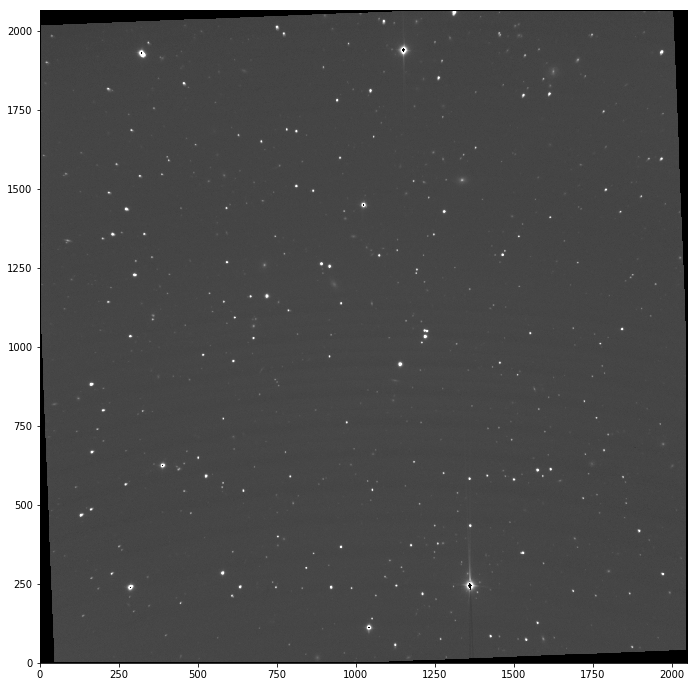

In [4]:
Raw_Datacube.display(Raw_Datacube.raw_stack_field,vmax=100)

In [10]:
Raw_Datacube.save_mask_edge(save_path='/home/qliu/data/A2390F/')

In [5]:
Raw_Datacube.remove_background(save_path='./A2390SE/fig/bkg/', plot=False)

Removing background...Frame: 10
Removing background...Frame: 20
Removing background...Frame: 30
Removing background...Frame: 40
Removing background...Frame: 50
Removing background...Frame: 60


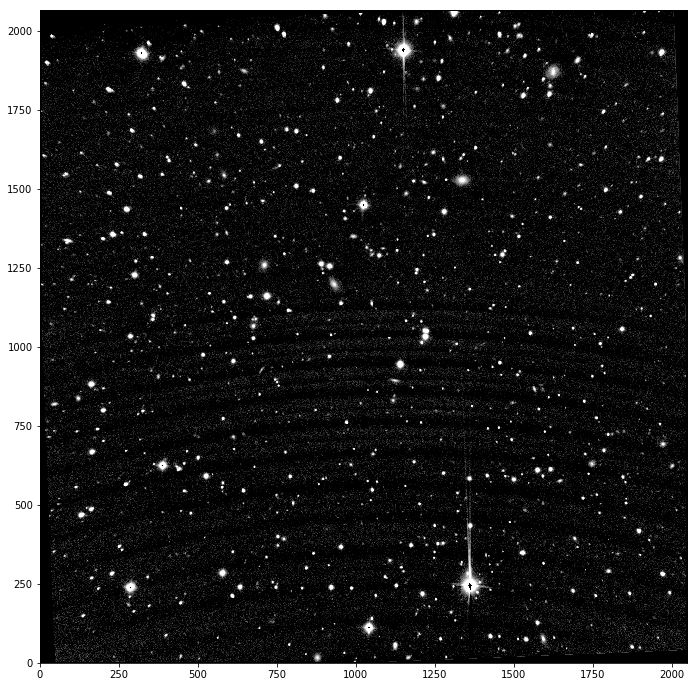

In [6]:
Raw_Datacube.display(Raw_Datacube.datacube_bkg_sub.sum(axis=0), vmax=5)

In [8]:
Raw_Datacube.wavl.shape

(69,)

In [14]:
Raw_Datacube.remove_fringe(skip_frames=range(8,100), save_path='./A2390SE/fig/fringe/', plot=False)

Removing fringe...Frame: 10
Removing fringe...Frame: 20
Removing fringe...Frame: 30
Removing fringe...Frame: 40
Removing fringe...Frame: 50
Removing fringe...Frame: 60


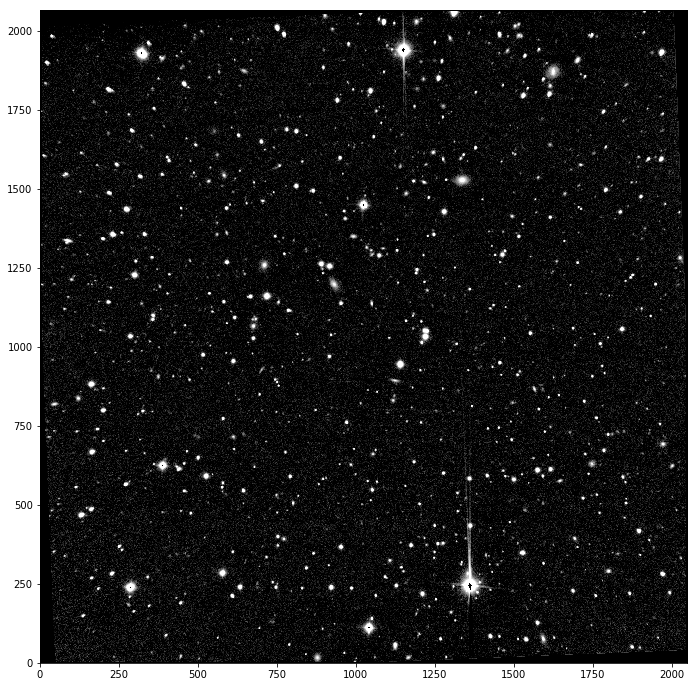

In [9]:
Raw_Datacube.display(Raw_Datacube.stack_field, vmax=5)

In [15]:
Raw_Datacube.save_fits(save_path='/home/qliu/data/A2390F/',suffix="_v2")

Saving background & fringe subtracted datacube and stacked field...


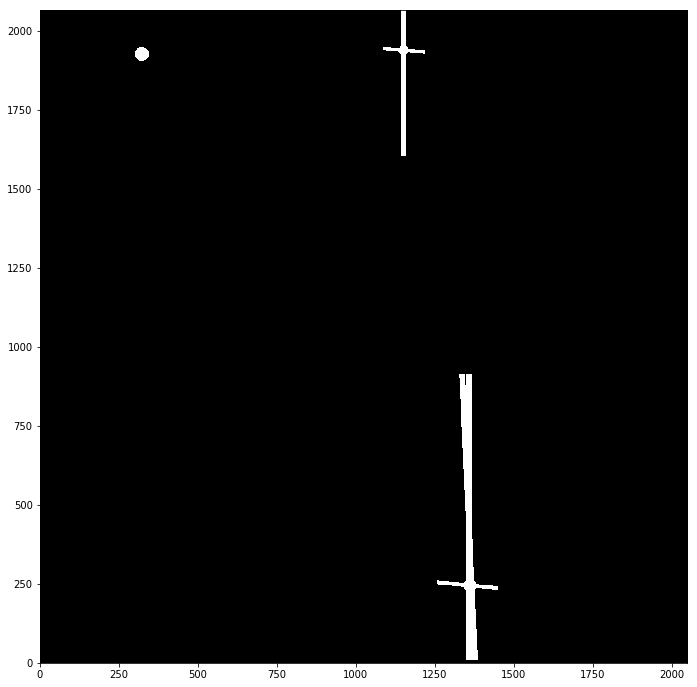

In [13]:
Raw_Datacube.save_weight_map(region_path="./A2390SE/A2390SE.reg", weight=0.01, 
                             save_path = './A2390SE//')
Raw_Datacube.display(Raw_Datacube.mymask,vmax=None)

## 2. Calculate seeing FWHM

In [16]:
Datacube = Read_Datacube("/home/qliu/data/A2390F/A2390SE_cube_v2.fits",name="A2390SE",
                         SE_catalog="./A2390SE/SE_v2//A2390SE_run1.cat")

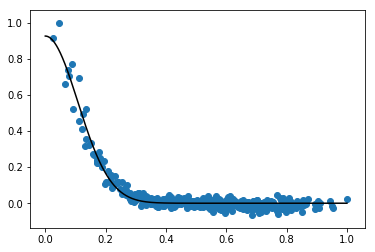

1.199279936221694


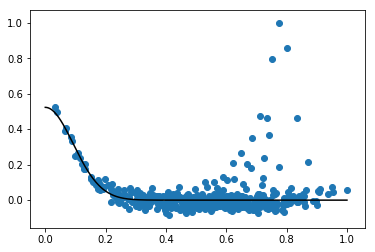

1.0296991199851202


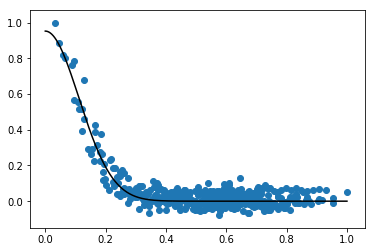

1.234204866630563


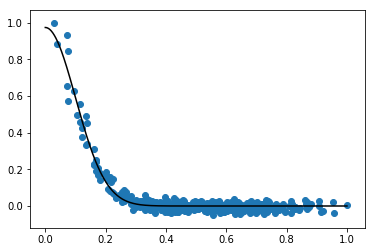

1.1519156121794196


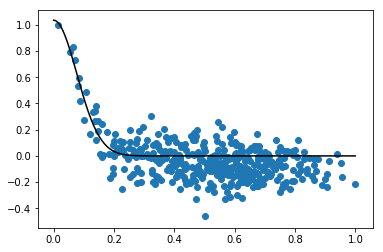

0.8688886646161778


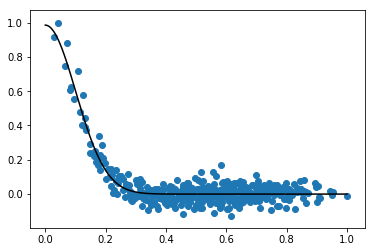

1.120657590750718


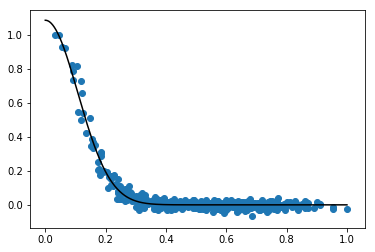

1.234734829042838


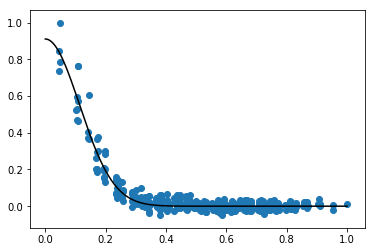

1.280491223669642


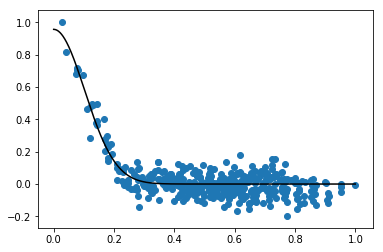

1.1233537074598876


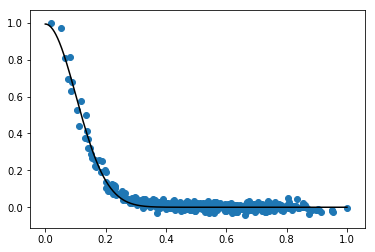

1.138596095365551


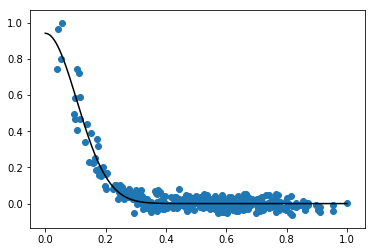

1.185846674236758


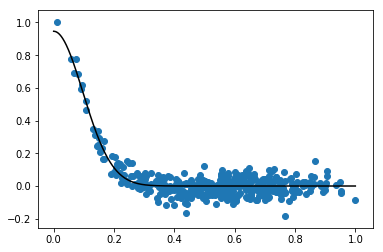

1.0477843284316153


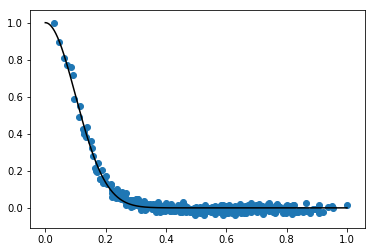

1.1038368641757708


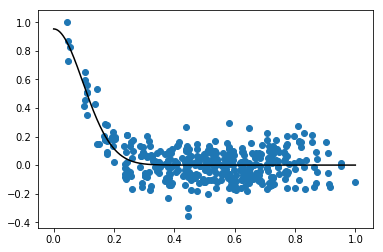

1.0880861750740811


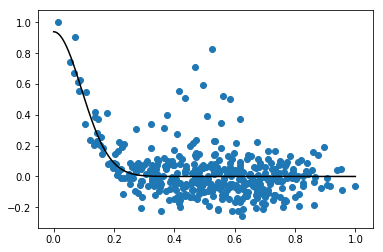

1.043882365307673


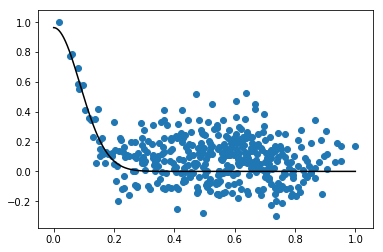

0.9520573330683085


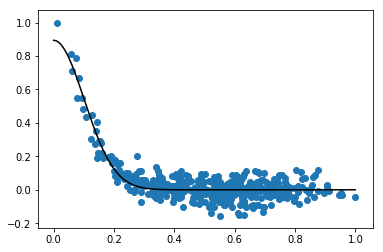

1.133566077170212


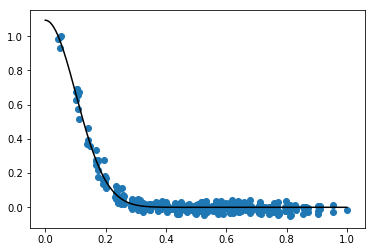

1.1462680898973032


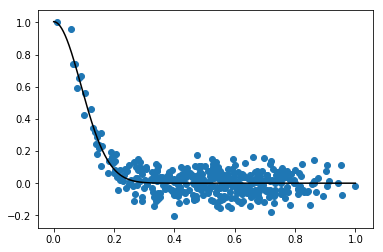

1.0246649685600742


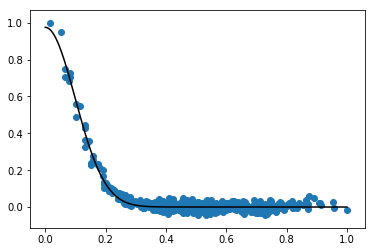

1.1553793322436188


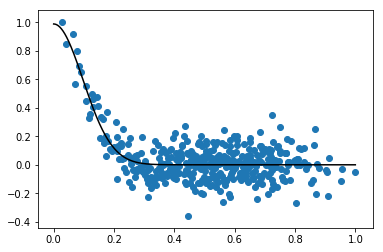

1.1153557666135834


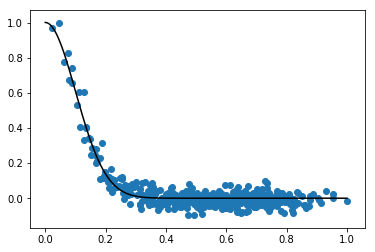

1.1398798834842452


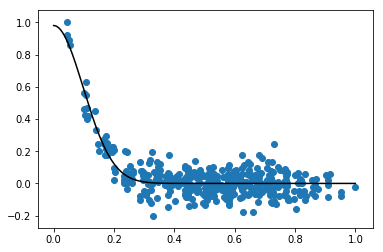

1.0981077008803757


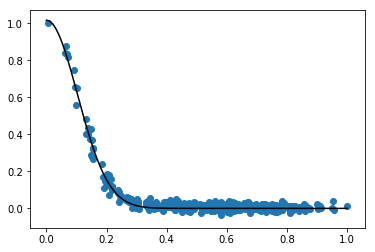

1.1598696196601694


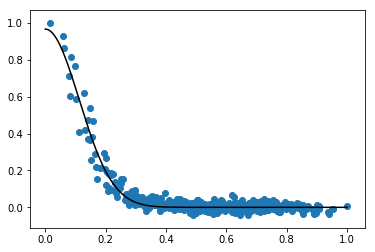

1.218690297408502


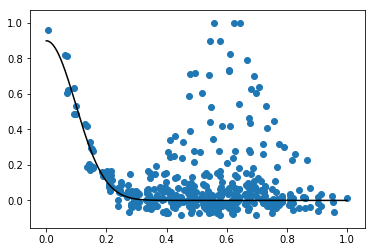

1.0900442409447573


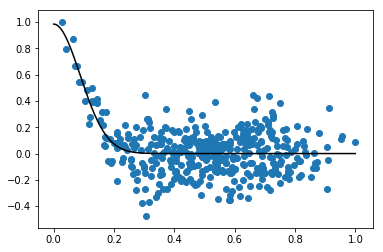

1.0091811661356815


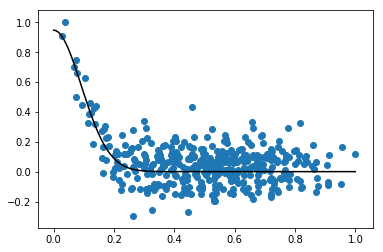

1.0591403477329018


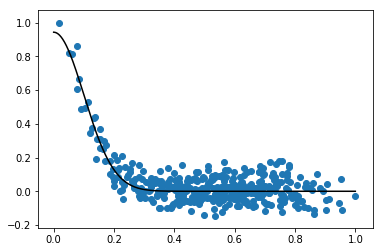

1.119174939807874


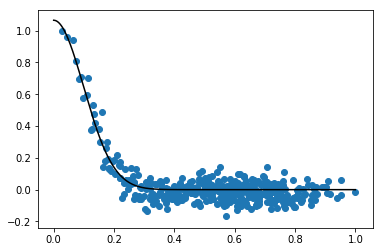

1.093134352227916


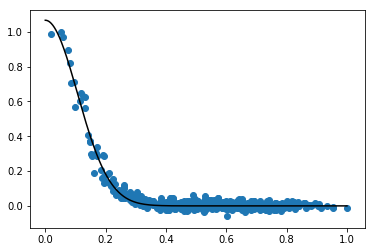

1.203253808953322


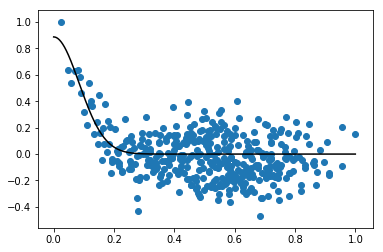

0.9715621108134878


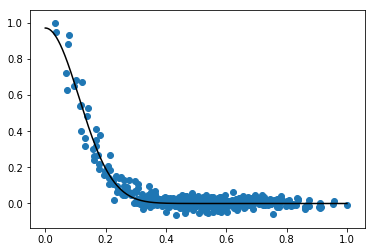

1.2818472144384174


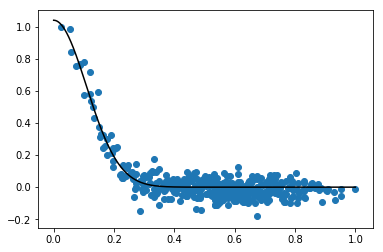

1.19140333680964


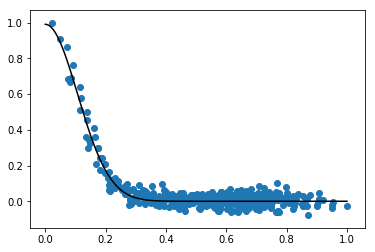

1.165336100624027


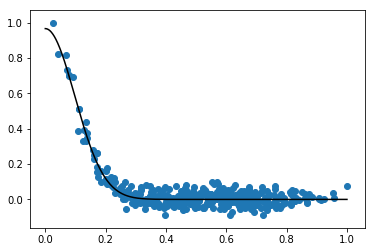

1.1185641081366466


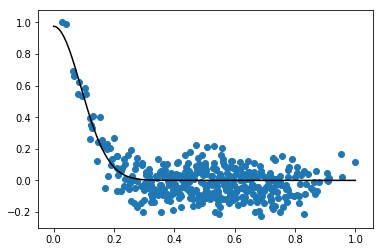

1.038579894817174


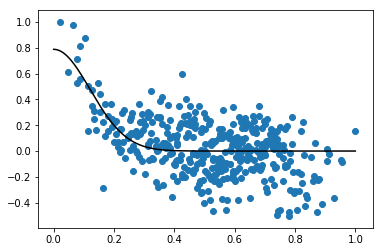

1.371179320303915


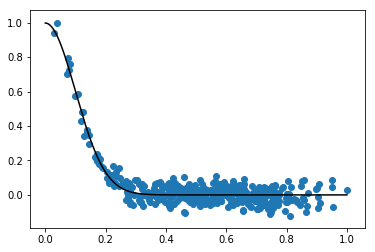

1.0989192158477343


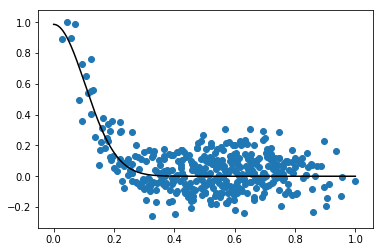

1.160474869595721


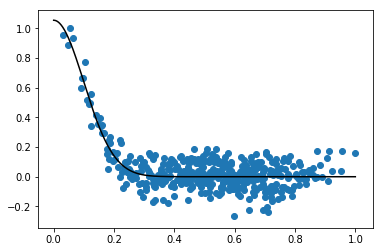

1.127871944784641


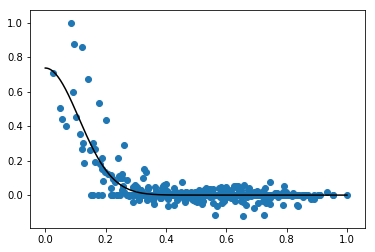

1.247581186346319


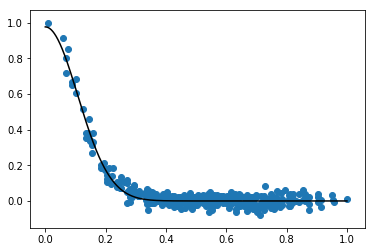

1.2048003649752186


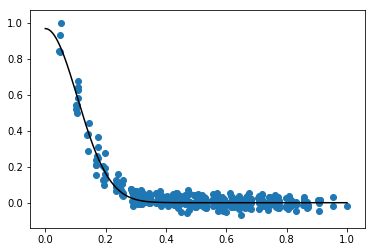

1.1981642451227996


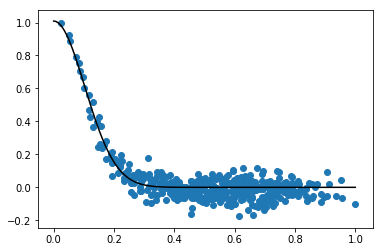

1.1575476084198106


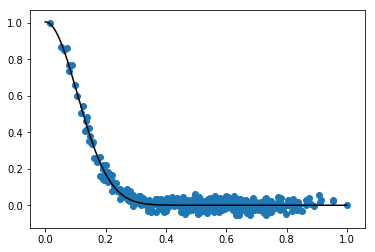

1.237050019247587


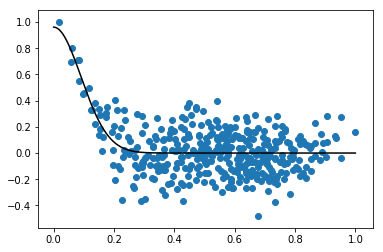

0.988608363025392


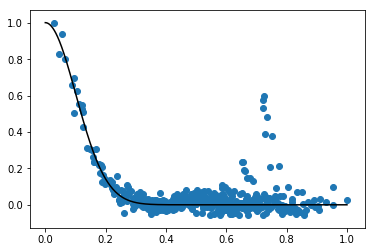

1.1338433114836275


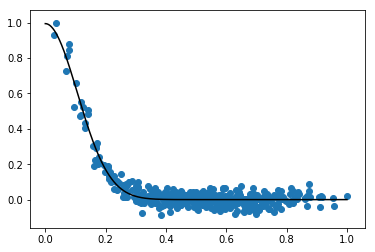

1.2190816594933436


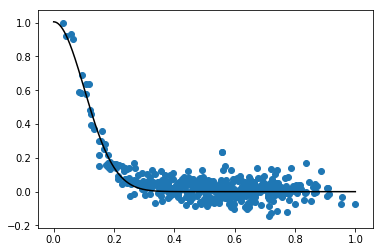

1.1606847719390279


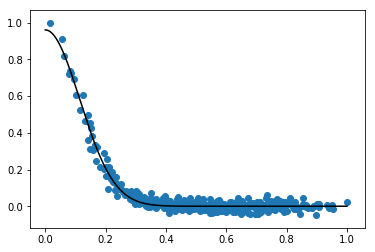

1.2421139079801375


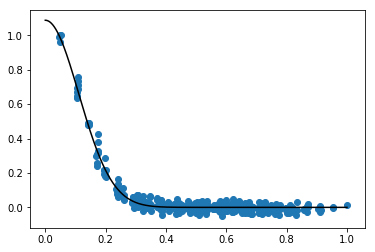

1.2470437467836597


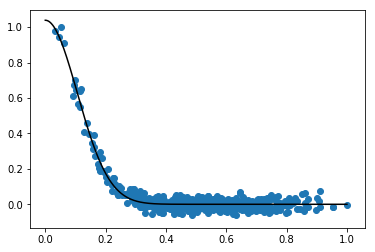

1.2079267191637173


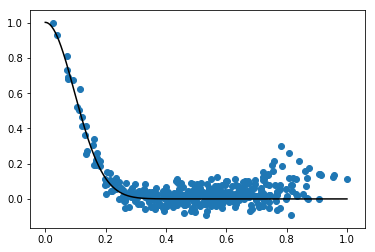

1.1172770287969582


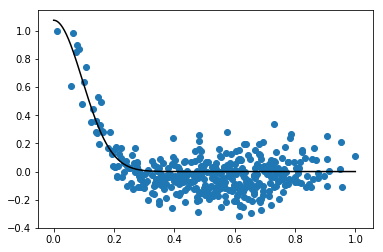

1.0660328153660796


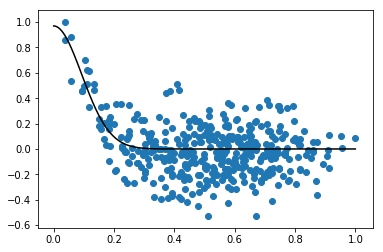

1.0564236013285253


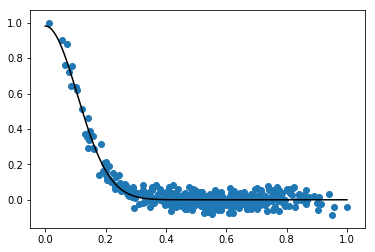

1.1997360510238622


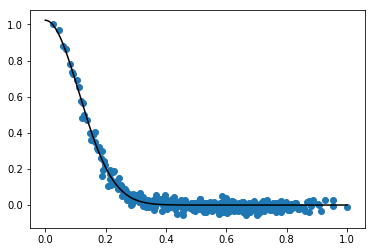

1.2708733185567922


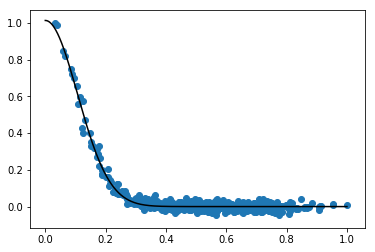

1.219896756173552


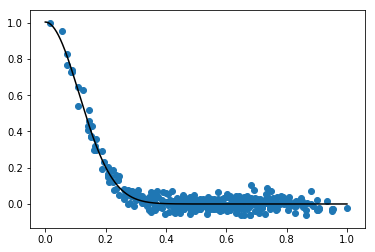

1.2126374420062993


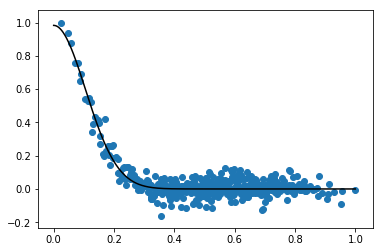

1.1986367089515355


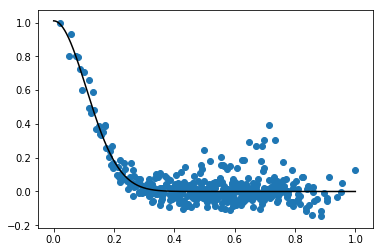

1.2096413652845097


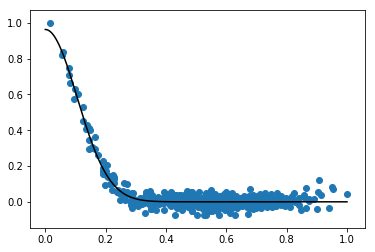

1.1891046437496866


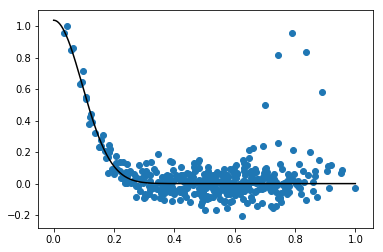

1.0708837780786191


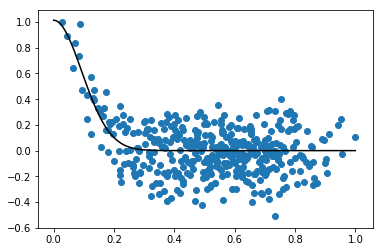

1.0373082868874104


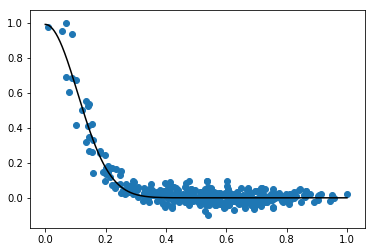

1.2131542454677464


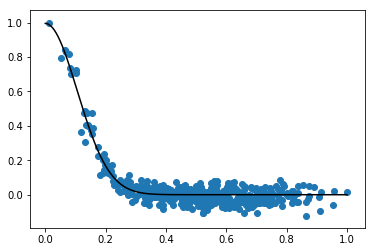

1.2365029482857057


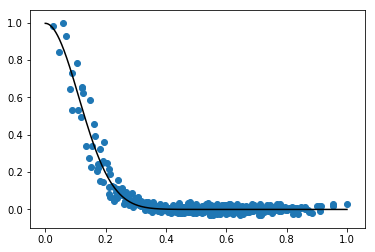

1.2722749397357898


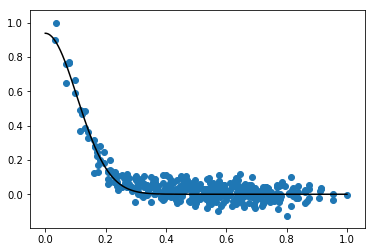

1.2064245933695041


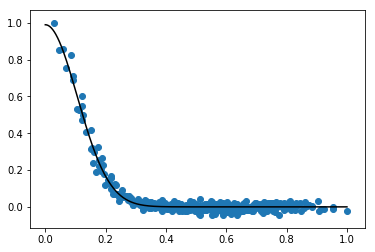

1.200376616224804


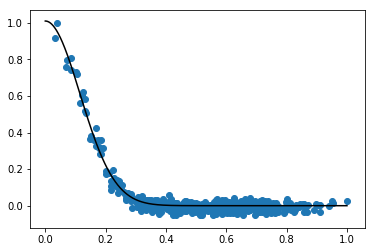

1.2673744311023782


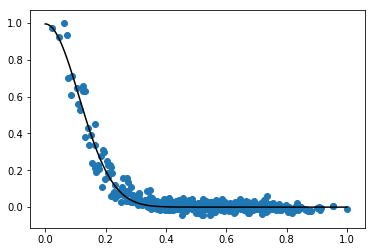

1.286247177214634


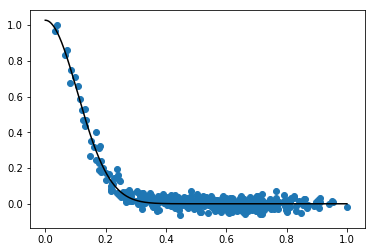

1.1771793664000638


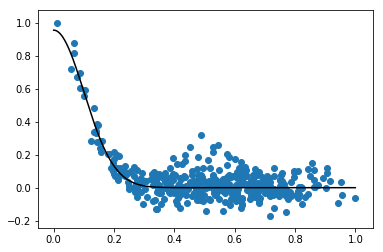

1.1394881596251194


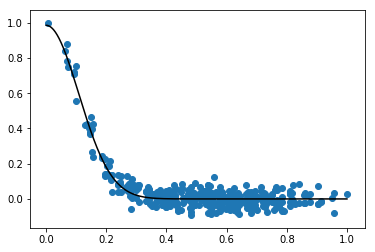

1.2150964957862005


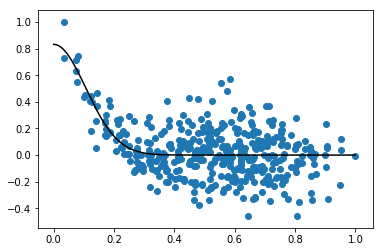

1.1720037739313691


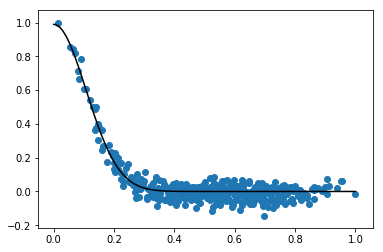

1.2184124023565635


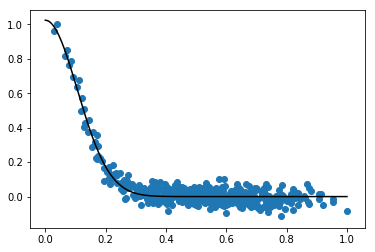

1.2119666231527302


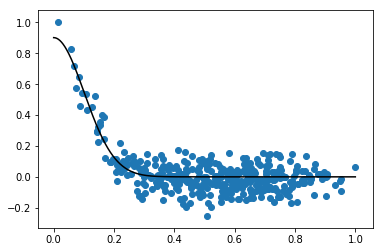

1.0954549778457685


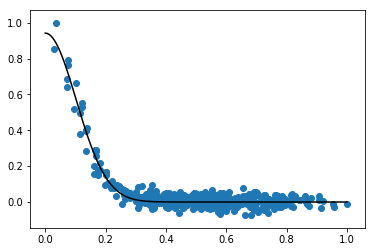

1.1746152650639161


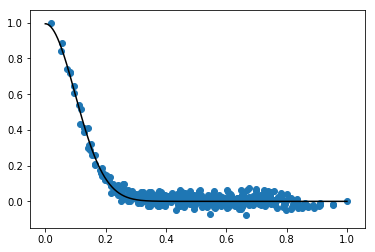

1.1400443209776374


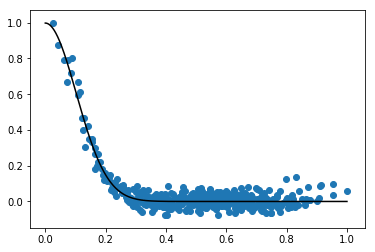

1.1832676471818928


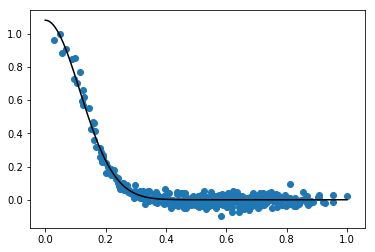

1.2674589697302994


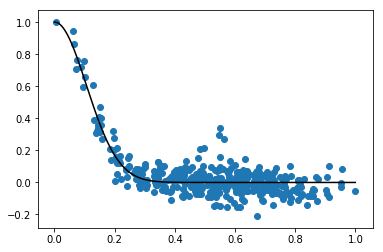

1.1927002460962228


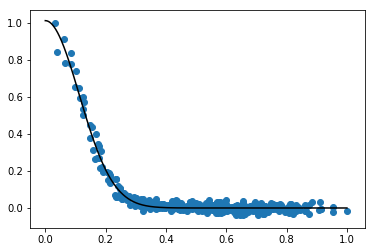

1.2805558244547082


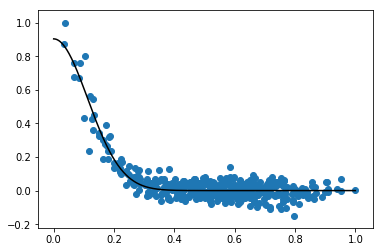

1.245564130190419


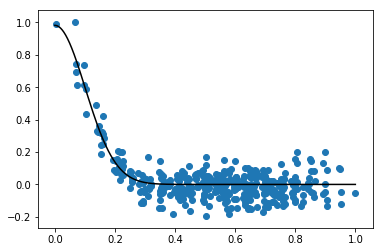

1.0862267232481486


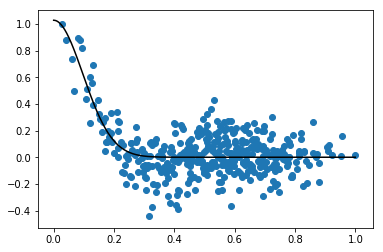

1.10465708612009


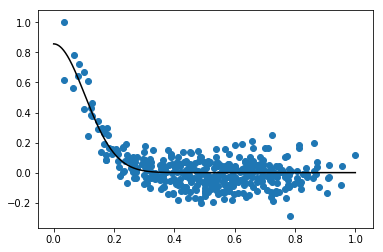

1.1764915437911134


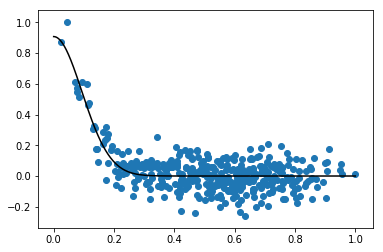

1.0367496388155342


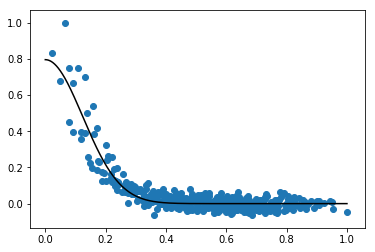

1.354650289448167


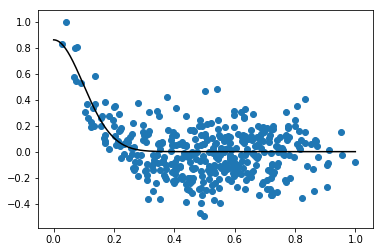

1.1295354894058958


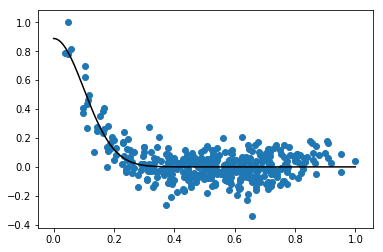

1.1286514474383136


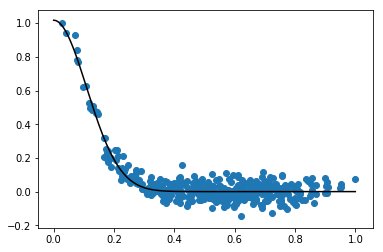

1.2086241274661162


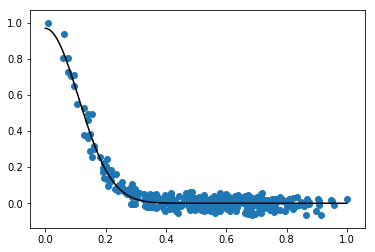

1.237097779034446


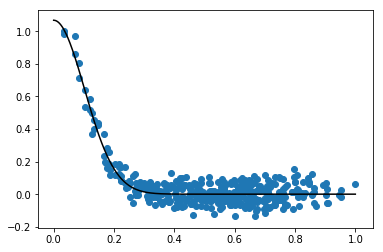

1.125501384135076


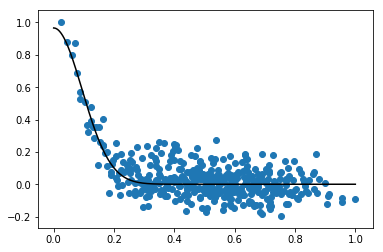

1.0864101613571409


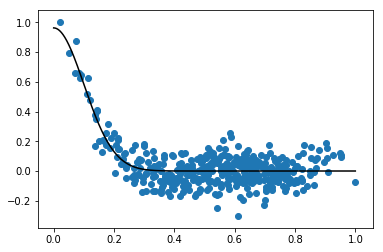

1.090306370721466


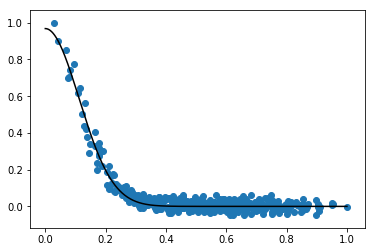

1.2408444249069932


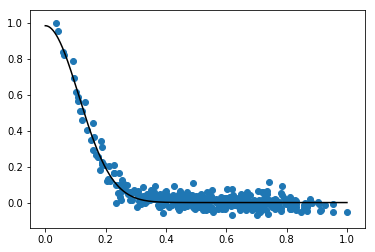

1.2308699427997851


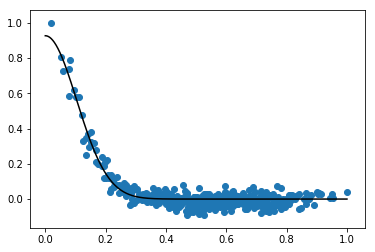

1.166642801353954


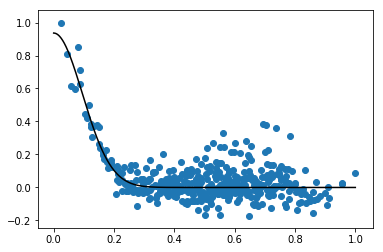

1.097966100563541


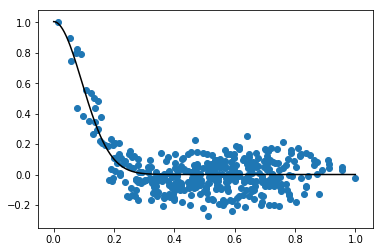

1.0849208360688247


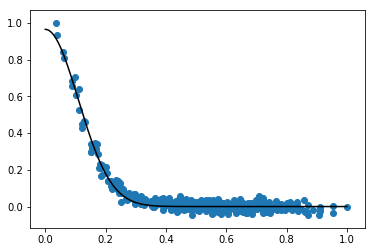

1.2438033141531983


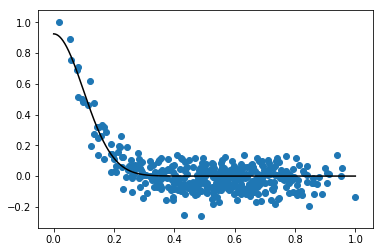

1.1044022977306682


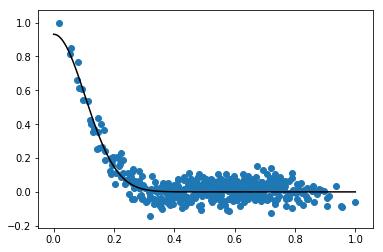

1.1773674640676517


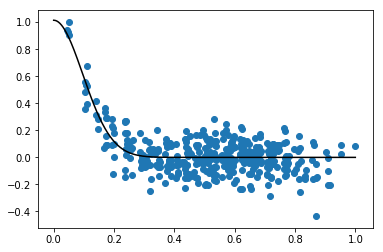

1.081963071179741


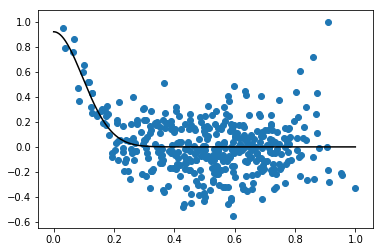

1.0956133799858225


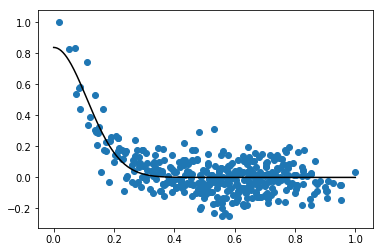

1.1963532707635645


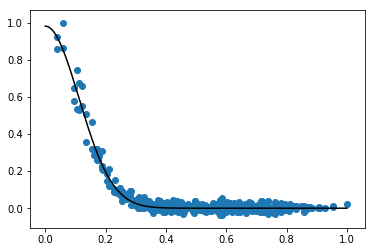

1.2405803029345743


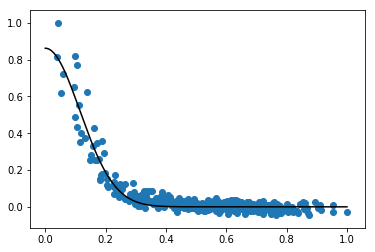

1.297091116339116


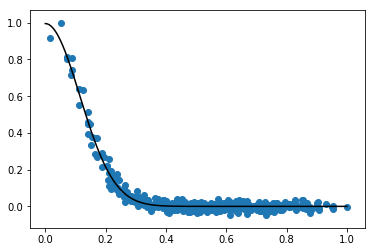

1.2391141407942308


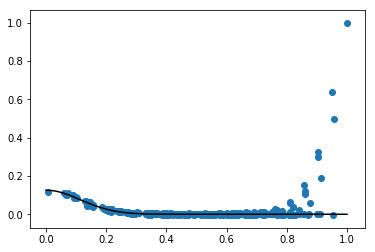

1.2757865827574364


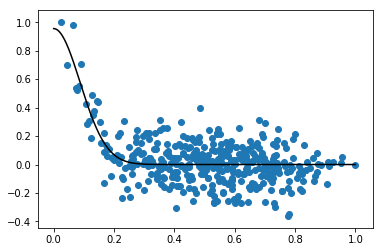

0.9944992334051953


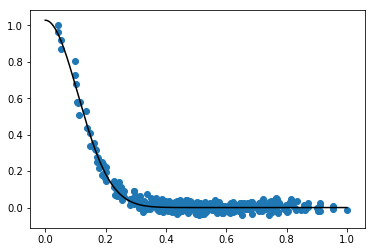

1.2227761674410507


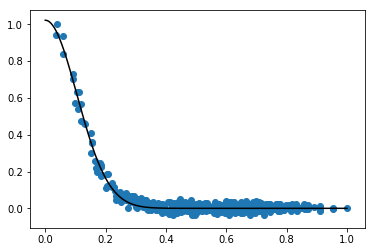

1.1902820281675397


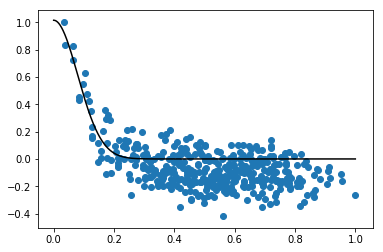

0.9070117437260208


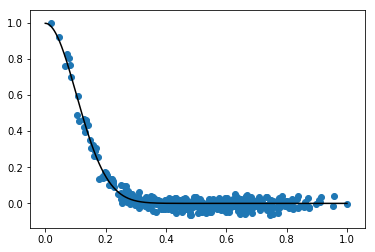

1.1936287868173208


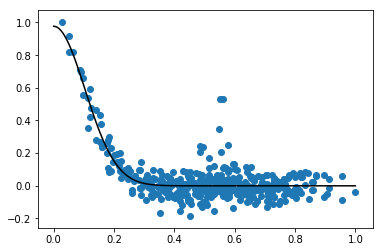

1.187767647538659


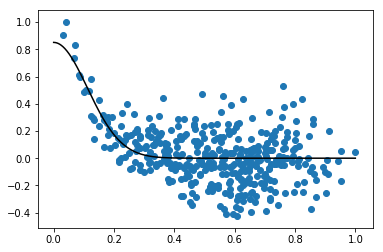

1.2338999714915992


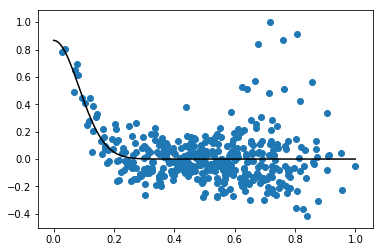

0.9658559989068208


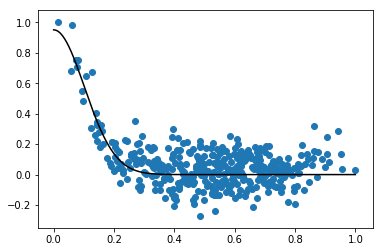

1.1477514049899271


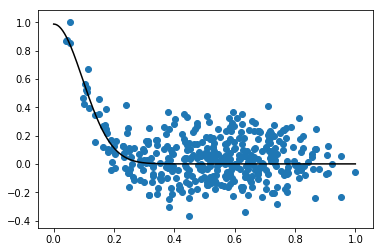

1.0741289207139815


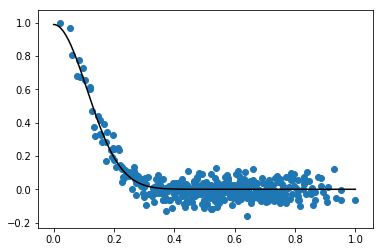

1.2096994515155495


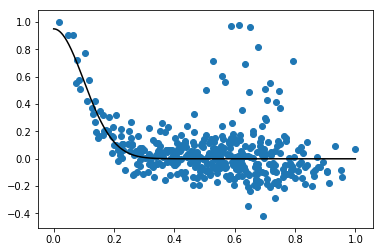

1.125913026985806


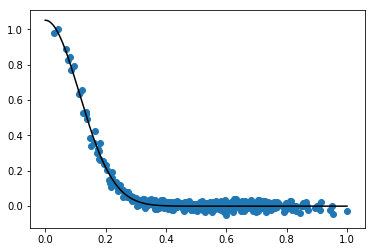

1.2420205089116014


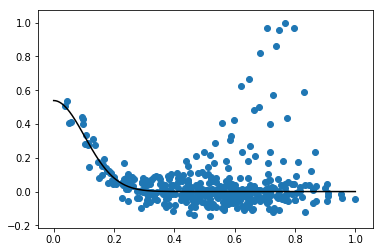

1.167937179667832


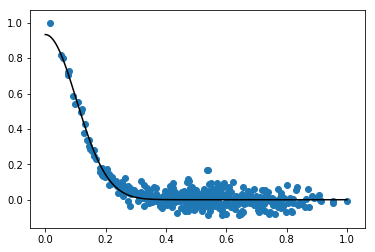

1.195233365463579


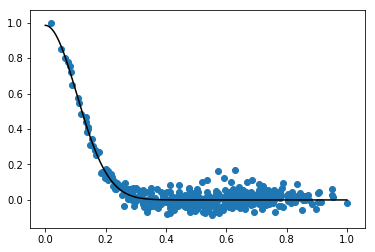

1.1626244399516115


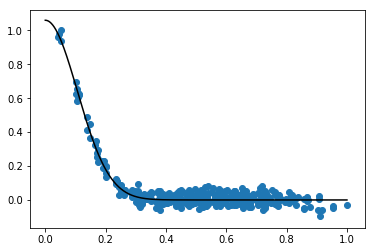

1.1917161082486385


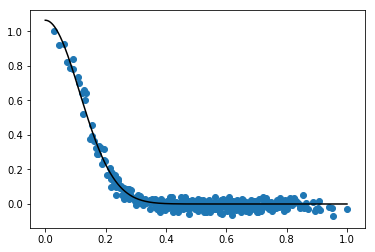

1.2733011098170886


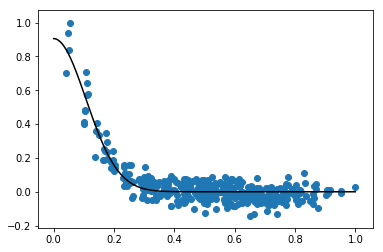

1.2050013996890394


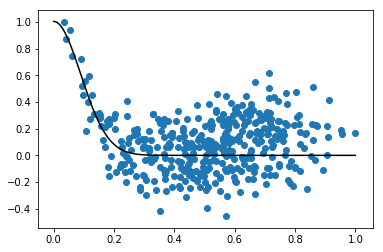

1.020712554198563


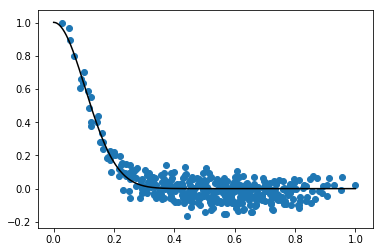

1.170210437670309


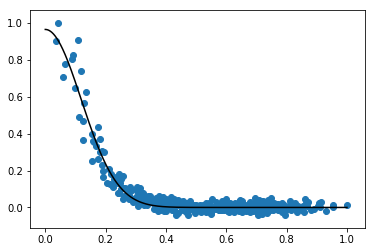

1.3202181938406967
Median seeing FWHM in arcsec: 1.172


In [18]:
Datacube.calculate_seeing(mag_cut=[0.2,0.8], plot=True)

## 3. Spectra Extraction

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from astropy.io import fits
from astropy.stats import SigmaClip
from photutils import Background2D, SExtractorBackground
from pipeline import *
from utils import *
Datacube = Read_Datacube("/home/qliu/data/A2390F/A2390SE_cube_v2.fits",name="A2390SE",
                         SE_catalog="./A2390SE/SE_v2//A2390SE_run2.cat")
Datacube.read_mask('/home/qliu/data/A2390F/Raw_stack_A2390SE_mask.fits')
Datacube.read_seg('./A2390SE/SE_v2//segment_run2.fits')

In [2]:
Datacube.wavl.shape

(69,)

Optimal Aperture: 1.4 Rp, SNR = 11.2816


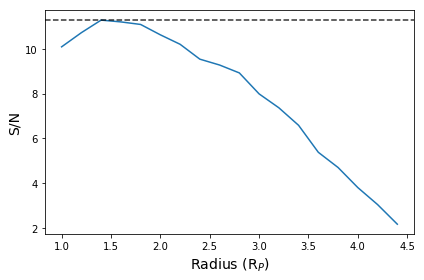

Optimal Aperture: 2.8 Rp, SNR = 4.9284


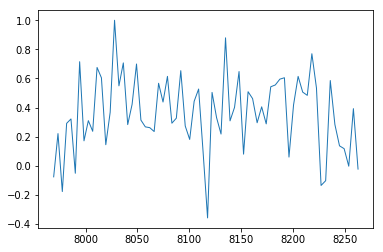

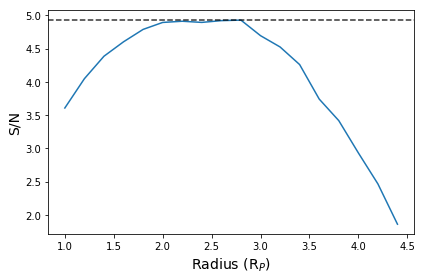

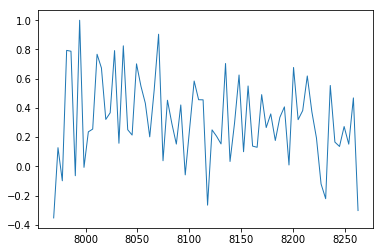

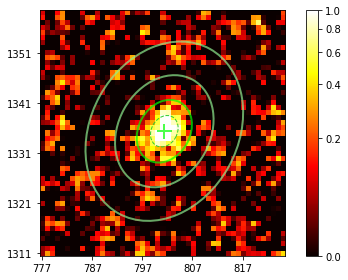

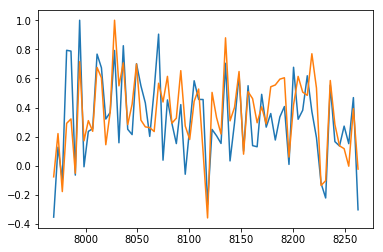

In [3]:
# Example
spec_sky, k_sky, snr_sky, apers_sky = Datacube.spec_extraction(num=1500, ext_type='sky', k1=5., k2=8, 
                                                               print_out=True, plot=True, display=False)
spec_opt, k_opt, snr_opt, apers_opt = Datacube.spec_extraction(num=1500, ext_type='opt', k1=5., k2=8,
                                                               print_out=True, plot=True, display=True)
apers_sky[0].plot(color='limegreen',ls='--')
plt.show()
plt.plot(Datacube.wavl, spec_opt/spec_opt.max())
plt.plot(Datacube.wavl, spec_sky/spec_sky.max())

Optimal Aperture: 1.6 Rp, SNR = 73.9235


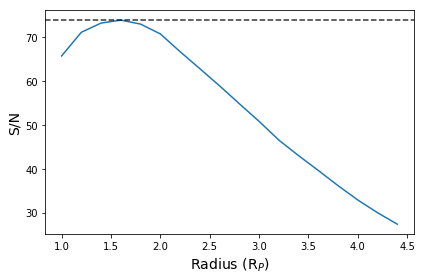

Optimal Aperture: 2.4 Rp, SNR = 20.1824


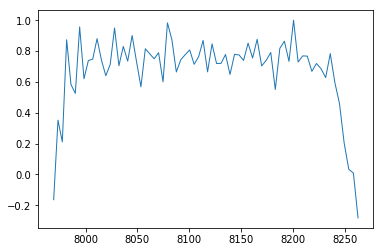

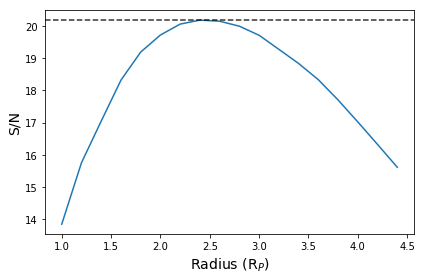

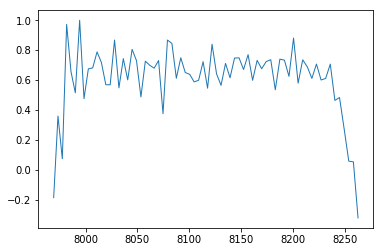

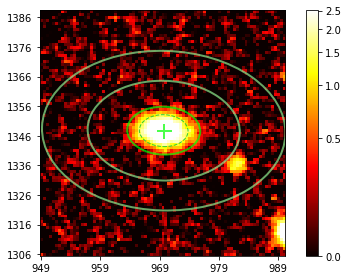

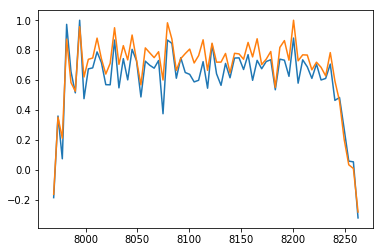

In [28]:
id_BCG = np.argmin((Datacube.Tab_SE["X_IMAGE"]-980)**2 + (Datacube.Tab_SE["Y_IMAGE"]-1315)**2) + 1
spec_sky, k_sky, snr_sky, apers_sky = Datacube.spec_extraction(num=id_BCG, ext_type='sky', k1=5., k2=8, 
                                                               print_out=True, plot=True, display=False)
spec_opt, k_opt, snr_opt, apers_opt = Datacube.spec_extraction(num=id_BCG, ext_type='opt', k1=5., k2=8,
                                                               print_out=True, plot=True, display=True)
apers_sky[0].plot(color='limegreen',ls='--')
plt.show()
plt.plot(Datacube.wavl, spec_opt/spec_opt.max())
plt.plot(Datacube.wavl, spec_sky/spec_sky.max())

In [4]:
# Pipe
Datacube.spec_extraction_all(ks = np.arange(1.,4.,0.1), k1=5., k2=8., save_path='./A2390SE/fig/img_thumb_v2/', display=True)

#1 spectra extracted
#2 spectra extracted
#3 spectra extracted
#4 spectra extracted
#5 spectra extracted
#6 spectra extracted
#7 spectra extracted
#8 spectra extracted
#9 spectra extracted
#10 spectra extracted
#11 spectra extracted
#12 spectra extracted
#13 spectra extracted
#14 spectra extracted
#15 spectra extracted
#16 spectra extracted
#17 spectra extracted
#18 spectra extracted
#19 spectra extracted
#20 spectra extracted
#21 spectra extracted
#22 spectra extracted
#23 spectra extracted
#24 spectra extracted
#25 spectra extracted
#26 spectra extracted
#27 spectra extracted
#28 spectra extracted
#29 spectra extracted
#30 spectra extracted
#31 spectra extracted
#32 spectra extracted
#33 spectra extracted
#34 spectra extracted
#35 spectra extracted
#36 spectra extracted
#37 spectra extracted
#38 spectra extracted
#39 spectra extracted
#40 spectra extracted
#41 spectra extracted
#42 spectra extracted
#43 spectra extracted
#44 spectra extracted
#45 spectra extracted
#46 spectra extract

#363 spectra extracted
#364 spectra extracted
#365 spectra extracted
#366 spectra extracted
#367 spectra extracted
#368 spectra extracted
#369 spectra extracted
#370 spectra extracted
#371 spectra extracted
#372 spectra extracted
#373 spectra extracted
#374 spectra extracted
#375 spectra extracted
#376 spectra extracted
#377 spectra extracted
#378 spectra extracted
#379 spectra extracted
#380 spectra extracted
#381 spectra extracted
#382 spectra extracted
#383 spectra extracted
#384 spectra extracted
#385 spectra extracted
#386 spectra extracted
#387 spectra extracted
#388 spectra extracted
#389 spectra extracted
#390 spectra extracted
#391 spectra extracted
#392 spectra extracted
#393 spectra extracted
#394 spectra extracted
#395 spectra extracted
#396 spectra extracted
#397 spectra extracted
#398 spectra extracted
#399 spectra extracted
#400 spectra extracted
#401 spectra extracted
#402 spectra extracted
#403 spectra extracted
#404 spectra extracted
#405 spectra extracted
#406 spectr

#720 spectra extracted
#721 spectra extracted
#722 spectra extracted
#723 spectra extracted
#724 spectra extracted
#725 spectra extracted
#726 spectra extracted
#727 spectra extracted
#728 spectra extracted
#729 spectra extracted
#730 spectra extracted
#731 spectra extracted
#732 spectra extracted
#733 spectra extracted
#734 spectra extracted
#735 spectra extracted
#736 spectra extracted
#737 spectra extracted
#738 spectra extracted
#739 spectra extracted
#740 spectra extracted
#741 spectra extracted
#742 spectra extracted
#743 spectra extracted
#744 spectra extracted
#745 spectra extracted
#746 spectra extracted
#747 spectra extracted
#748 spectra extracted
#749 spectra extracted
#750 spectra extracted
#751 spectra extracted
#752 spectra extracted
#753 spectra extracted
#754 spectra extracted
#755 spectra extracted
#756 spectra extracted
#757 spectra extracted
#758 spectra extracted
#759 spectra extracted
#760 spectra extracted
#761 spectra extracted
#762 spectra extracted
#763 spectr

#1074 spectra extracted
#1075 spectra extracted
#1076 spectra extracted
#1077 spectra extracted
#1078 spectra extracted
#1079 spectra extracted
#1080 spectra extracted
#1081 spectra extracted
#1082 spectra extracted
#1083 spectra extracted
#1084 spectra extracted
#1085 spectra extracted
#1086 spectra extracted
#1087 spectra extracted
#1088 spectra extracted
#1089 spectra extracted
#1090 spectra extracted
#1091 spectra extracted
#1092 spectra extracted
#1093 spectra extracted
#1094 spectra extracted
#1095 spectra extracted
#1096 spectra extracted
#1097 spectra extracted
#1098 spectra extracted
#1099 spectra extracted
#1100 spectra extracted
#1101 spectra extracted
#1102 spectra extracted
#1103 spectra extracted
#1104 spectra extracted
#1105 spectra extracted
#1106 spectra extracted
#1107 spectra extracted
#1108 spectra extracted
#1109 spectra extracted
#1110 spectra extracted
#1111 spectra extracted
#1112 spectra extracted
#1113 spectra extracted
#1114 spectra extracted
#1115 spectra ex

#1417 spectra extracted
#1418 spectra extracted
#1419 spectra extracted
#1420 spectra extracted
#1421 spectra extracted
#1422 spectra extracted
#1423 spectra extracted
#1424 spectra extracted
#1425 spectra extracted
#1426 spectra extracted
#1427 spectra extracted
#1428 spectra extracted
#1429 spectra extracted
#1430 spectra extracted
#1431 spectra extracted
#1432 spectra extracted
#1433 spectra extracted
#1434 spectra extracted
#1435 spectra extracted
#1436 spectra extracted
#1437 spectra extracted
#1438 spectra extracted
#1439 spectra extracted
#1440 spectra extracted
#1441 spectra extracted
#1442 spectra extracted
#1443 spectra extracted
#1444 spectra extracted
#1445 spectra extracted
#1446 spectra extracted
#1447 spectra extracted
#1448 spectra extracted
#1449 spectra extracted
#1450 spectra extracted
#1451 spectra extracted
#1452 spectra extracted
#1453 spectra extracted
#1454 spectra extracted
#1455 spectra extracted
#1456 spectra extracted
#1457 spectra extracted
#1458 spectra ex

#1759 spectra extracted
#1760 spectra extracted
#1761 spectra extracted
#1762 spectra extracted
#1763 spectra extracted
#1764 spectra extracted
#1765 spectra extracted
#1766 spectra extracted
#1767 spectra extracted
#1768 spectra extracted
#1769 spectra extracted
#1770 spectra extracted


In [5]:
# Pipe
Datacube.fit_continuum_all(model='GP', plot=True, save_path='./A2390SE/fig/fit_cont_v2/')

#1 spectra continuum fitted
#2 spectra continuum fitted
#3 spectra continuum fitted
#4 spectra continuum fitted
#5 spectra continuum fitted
#6 spectra continuum fitted
#7 spectra continuum fitted
#8 spectra continuum fitted
#9 spectra continuum fitted
#10 spectra continuum fitted
#11 spectra continuum fitted
#12 spectra continuum fitted
#13 spectra continuum fitted
#14 spectra continuum fitted
#15 spectra continuum fitted
#16 spectra continuum fitted
#17 spectra continuum fitted
#18 spectra continuum fitted
#19 spectra continuum fitted
#20 spectra continuum fitted
#21 spectra continuum fitted
#22 spectra continuum fitted
#23 spectra continuum fitted
#24 spectra continuum fitted
#25 spectra continuum fitted
#26 spectra continuum fitted
#27 spectra continuum fitted
#28 spectra continuum fitted
#29 spectra continuum fitted
#30 spectra continuum fitted
#31 spectra continuum fitted
#32 spectra continuum fitted
#33 spectra continuum fitted
#34 spectra continuum fitted
#35 spectra continuum f

#279 spectra continuum fitted
#280 spectra continuum fitted
#281 spectra continuum fitted
#282 spectra continuum fitted
#283 spectra continuum fitted
#284 spectra continuum fitted
#285 spectra continuum fitted
#286 spectra continuum fitted
#287 spectra continuum fitted
#288 spectra continuum fitted
#289 spectra continuum fitted
#290 spectra continuum fitted
#291 spectra continuum fitted
#292 spectra continuum fitted
#293 spectra continuum fitted
#294 spectra continuum fitted
#295 spectra continuum fitted
#296 spectra continuum fitted
#297 spectra continuum fitted
#298 spectra continuum fitted
#299 spectra continuum fitted
#300 spectra continuum fitted
#301 spectra continuum fitted
#302 spectra continuum fitted
#303 spectra continuum fitted
#304 spectra continuum fitted
#305 spectra continuum fitted
#306 spectra continuum fitted
#307 spectra continuum fitted
#308 spectra continuum fitted
#309 spectra continuum fitted
#310 spectra continuum fitted
#311 spectra continuum fitted
#312 spect

#554 spectra continuum fitted
#555 spectra continuum fitted
#556 spectra continuum fitted
#557 spectra continuum fitted
#558 spectra continuum fitted
#559 spectra continuum fitted
#560 spectra continuum fitted
#561 spectra continuum fitted
#562 spectra continuum fitted
#563 spectra continuum fitted
#564 spectra continuum fitted
#565 spectra continuum fitted
#566 spectra continuum fitted
#567 spectra continuum fitted
#568 spectra continuum fitted
#569 spectra continuum fitted
#570 spectra continuum fitted
#571 spectra continuum fitted
#572 spectra continuum fitted
#573 spectra continuum fitted
#574 spectra continuum fitted
#575 spectra continuum fitted
#576 spectra continuum fitted
#577 spectra continuum fitted
#578 spectra continuum fitted
#579 spectra continuum fitted
#580 spectra continuum fitted
#581 spectra continuum fitted
#582 spectra continuum fitted
#583 spectra continuum fitted
#584 spectra continuum fitted
#585 spectra continuum fitted
#586 spectra continuum fitted
#587 spect

#828 spectra continuum fitted
#829 spectra continuum fitted
#830 spectra continuum fitted
#831 spectra continuum fitted
#832 spectra continuum fitted
#833 spectra continuum fitted
#834 spectra continuum fitted
#835 spectra continuum fitted
#836 spectra continuum fitted
#837 spectra continuum fitted
#838 spectra continuum fitted
#839 spectra continuum fitted
#840 spectra continuum fitted
#841 spectra continuum fitted
#842 spectra continuum fitted
#843 spectra continuum fitted
#844 spectra continuum fitted
#845 spectra continuum fitted
#846 spectra continuum fitted
#847 spectra continuum fitted
#848 spectra continuum fitted
#849 spectra continuum fitted
#850 spectra continuum fitted
#851 spectra continuum fitted
#852 spectra continuum fitted
#853 spectra continuum fitted
#854 spectra continuum fitted
#855 spectra continuum fitted
#856 spectra continuum fitted
#857 spectra continuum fitted
#858 spectra continuum fitted
#859 spectra continuum fitted
#860 spectra continuum fitted
#861 spect

#1099 spectra continuum fitted
#1100 spectra continuum fitted
#1101 spectra continuum fitted
#1102 spectra continuum fitted
#1103 spectra continuum fitted
#1104 spectra continuum fitted
#1105 spectra continuum fitted
#1106 spectra continuum fitted
#1107 spectra continuum fitted
#1108 spectra continuum fitted
#1109 spectra continuum fitted
#1110 spectra continuum fitted
#1111 spectra continuum fitted
#1112 spectra continuum fitted
#1113 spectra continuum fitted
#1114 spectra continuum fitted
#1115 spectra continuum fitted
#1116 spectra continuum fitted
#1117 spectra continuum fitted
#1118 spectra continuum fitted
#1119 spectra continuum fitted
#1120 spectra continuum fitted
#1121 spectra continuum fitted
#1122 spectra continuum fitted
#1123 spectra continuum fitted
#1124 spectra continuum fitted
#1125 spectra continuum fitted
#1126 spectra continuum fitted
#1127 spectra continuum fitted
#1128 spectra continuum fitted
#1129 spectra continuum fitted
#1130 spectra continuum fitted
#1131 sp

#1364 spectra continuum fitted
#1365 spectra continuum fitted
#1366 spectra continuum fitted
#1367 spectra continuum fitted
#1368 spectra continuum fitted
#1369 spectra continuum fitted
#1370 spectra continuum fitted
#1371 spectra continuum fitted
#1372 spectra continuum fitted
#1373 spectra continuum fitted
#1374 spectra continuum fitted
#1375 spectra continuum fitted
#1376 spectra continuum fitted
#1377 spectra continuum fitted
#1378 spectra continuum fitted
#1379 spectra continuum fitted
#1380 spectra continuum fitted
#1381 spectra continuum fitted
#1382 spectra continuum fitted
#1383 spectra continuum fitted
#1384 spectra continuum fitted
#1385 spectra continuum fitted
#1386 spectra continuum fitted
#1387 spectra continuum fitted
#1388 spectra continuum fitted
#1389 spectra continuum fitted
#1390 spectra continuum fitted
#1391 spectra continuum fitted
#1392 spectra continuum fitted
#1393 spectra continuum fitted
#1394 spectra continuum fitted
#1395 spectra continuum fitted
#1396 sp

#1630 spectra continuum fitted
#1631 spectra continuum fitted
#1632 spectra continuum fitted
#1633 spectra continuum fitted
#1634 spectra continuum fitted
#1635 spectra continuum fitted
#1636 spectra continuum fitted
#1637 spectra continuum fitted
#1638 spectra continuum fitted
#1639 spectra continuum fitted
#1640 spectra continuum fitted
#1641 spectra continuum fitted
#1642 spectra continuum fitted
#1643 spectra continuum fitted
#1644 spectra continuum fitted
#1645 spectra continuum fitted
#1646 spectra continuum fitted
#1647 spectra continuum fitted
#1648 spectra continuum fitted
#1649 spectra continuum fitted
#1650 spectra continuum fitted
#1651 spectra continuum fitted
#1652 spectra continuum fitted
#1653 spectra continuum fitted
#1654 spectra continuum fitted
#1655 spectra continuum fitted
#1656 spectra continuum fitted
#1657 spectra continuum fitted
#1658 spectra continuum fitted
#1659 spectra continuum fitted
#1660 spectra continuum fitted
#1661 spectra continuum fitted
#1662 sp

In [6]:
Datacube.save_spec_plot(save_path='./A2390SE/fig/spec_v2/')
Datacube.save_spec_fits(save_path='./A2390SE/', suffix="_v3")

## Cross-correlation

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from astropy.io import fits
from astropy.stats import SigmaClip
from photutils import Background2D, SExtractorBackground
from pipeline import *
from utils import *

Datacube = Read_Datacube("/home/qliu/data/A2390F/A2390SE_cube_v2.fits", name="A2390SE", z0=0.228, 
                         SE_catalog="./A2390SE/SE_v2//A2390SE_run2.cat")
Datacube.read_mask('/home/qliu/data/A2390F/Raw_stack_A2390SE_mask.fits')
Datacube.read_seg('./A2390SE/SE_v2//segment_run2.fits')
Datacube.read_spec('./A2390SE/A2390SE-spec_v3.fits')

In [2]:
# Datacube.generate_template(n_ratio=20, n_stddev=15, n_intp=2, sigma=4, ratio_range = (1.2, 9),
#                            temp_type="Ha-NII", ratio_prior="uniform", temp_model='gauss')
# Datacube.generate_template(n_ratio=8, n_stddev=15, n_intp=2, sigma=4, ratio_range = (2., 4.),
#                            temp_type="Hb-OIII", ratio_prior="uniform", temp_model='gauss')
Datacube.generate_template(n_ratio=50, n_stddev=10, n_intp=2, sigma=4, ratio_range = (1., 8),
                           temp_type="Ha-NII", ratio_prior="uniform", temp_model='gauss')
Datacube.generate_template(n_ratio=8, n_stddev=10, n_intp=2, sigma=4, ratio_range = (2., 4.),
                           temp_type="Hb-OIII", ratio_prior="uniform", temp_model='gauss')
Datacube.generate_template(n_ratio=8, n_stddev=10, n_intp=2, sigma=4,
                           temp_type="OII", ratio_prior="uniform", temp_model='gauss')

Template: Ha-NII_gauss  Total Number: 500
Template: Hb-OIII_gauss  Total Number: 80
Template: OII_gauss  Total Number: 10


Best z: 0.22487619019713073 Best sigma: 1.8341303394555193
Peak wavl 8040.631801364043
SE Object #349  z: 0.225  Peak R: 2.143  Detction S/N: 13.845 Peak S/N: 8.747


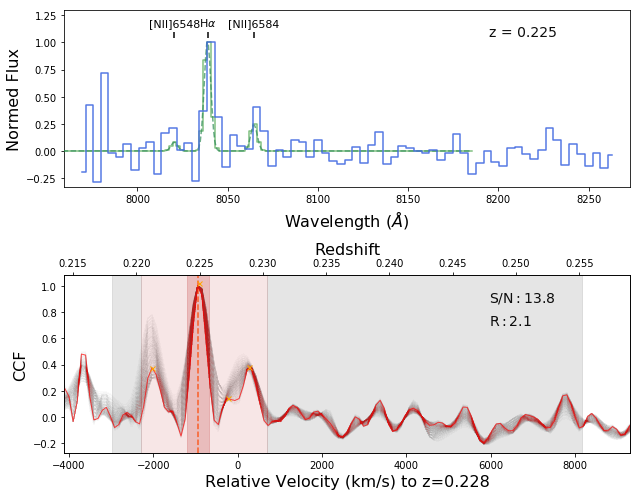

In [3]:
ccs, rv, z_ccs, Rs, SNRs, SNR_ps, Flage = Datacube.cross_correlation(349, temp_type="Ha-NII", temp_model="gauss")

Best z: 0.637317380011432 Best sigma: 4.297651573767348
Peak wavl 8198.209070566827
SE Object #1746  z: 0.637  Peak R: 4.691  Detction S/N: 9.557 Peak S/N: 9.557


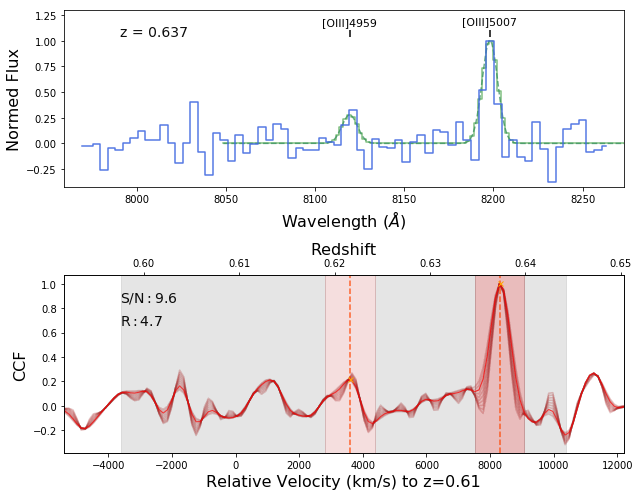

In [3]:
ccs, rv, z_ccs, Rs, SNRs, SNR_ps, Flage = Datacube.cross_correlation(1746, temp_type="Hb-OIII", edge=30, temp_model="gauss")

Best z: 0.24913916448001533 Best sigma: 2.889925154160589
Peak wavl 8198.209070566827
SE Object #1746  z: 0.249  Peak R: 3.199  Detction S/N: 9.418 Peak S/N: 8.890


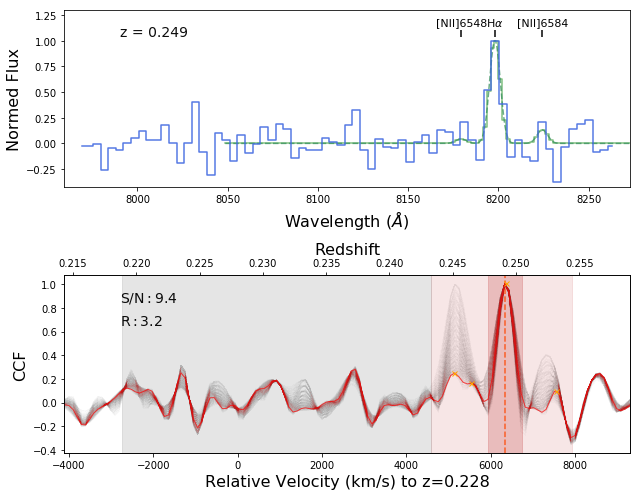

In [4]:
ccs, rv, z_ccs, Rs, SNRs, SNR_ps, Flage = Datacube.cross_correlation(1746, temp_type="Ha-NII", edge=30, temp_model="gauss")

In [5]:
Datacube.cross_correlation_all(temp_type="Ha-NII", temp_model="gauss")  #new library

SE Object #1  z: 0.244  Peak R: 2.221  Detction S/N: 4.481 Peak S/N: 3.585
SE Object #2  z: 0.249  Peak R: 5.366  Detction S/N: 5.968 Peak S/N: 4.705
SE Object #3  z: 0.254  Peak R: 2.572  Detction S/N: 3.048 Peak S/N: 2.562
SE Object #4  z: 0.223  Peak R: 3.677  Detction S/N: 5.313 Peak S/N: 4.689
SE Object #5  z: 0.221  Peak R: 1.948  Detction S/N: 7.018 Peak S/N: 4.644
SE Object #6  z: 0.223  Peak R: 1.724  Detction S/N: 10.374 Peak S/N: 3.897
SE Object #7  z: 0.234  Peak R: 3.421  Detction S/N: 12.588 Peak S/N: 10.770
SE Object #8  z: 0.233  Peak R: 2.081  Detction S/N: 2.371 Peak S/N: 2.098
SE Object #9  z: 0.227  Peak R: 1.722  Detction S/N: 2.508 Peak S/N: 2.278
SE Object #10  z: 0.229  Peak R: 2.230  Detction S/N: 8.533 Peak S/N: 4.404
SE Object #11  z: 0.228  Peak R: 2.855  Detction S/N: 12.952 Peak S/N: 7.835
SE Object #12  z: 0.234  Peak R: 1.209  Detction S/N: 1.867 Peak S/N: 2.063
SE Object #13  z: 0.223  Peak R: 2.942  Detction S/N: 2.586 Peak S/N: 2.412
SE Object #14  z:

SE Object #109  z: 0.222  Peak R: 6.543  Detction S/N: 3.080 Peak S/N: 2.976
SE Object #110  z: 0.254  Peak R: 5.107  Detction S/N: 3.150 Peak S/N: 3.340
SE Object #111  z: 0.250  Peak R: 3.495  Detction S/N: 3.269 Peak S/N: 3.429
SE Object #112  z: 0.222  Peak R: 7.751  Detction S/N: 2.679 Peak S/N: 2.489
SE Object #113  z: 0.251  Peak R: 1.876  Detction S/N: 2.641 Peak S/N: 2.560
SE Object #114  z: 0.234  Peak R: 9.505  Detction S/N: 3.247 Peak S/N: 2.957
SE Object #115  z: 0.244  Peak R: 5.390  Detction S/N: 4.331 Peak S/N: 3.748
SE Object #116  z: 0.228  Peak R: 2.773  Detction S/N: 5.454 Peak S/N: 5.165
SE Object #117  z: 0.231  Peak R: 2.854  Detction S/N: 3.480 Peak S/N: 2.948
SE Object #118  z: 0.219  Peak R: 4.503  Detction S/N: 3.870 Peak S/N: 3.475
SE Object #119  z: 0.232  Peak R: 6.825  Detction S/N: 2.878 Peak S/N: 3.198
SE Object #120  z: 0.250  Peak R: 7.977  Detction S/N: 2.775 Peak S/N: 2.645
SE Object #121  z: 0.239  Peak R: 1.812  Detction S/N: 3.027 Peak S/N: 3.015

SE Object #216  z: 0.236  Peak R: 7.456  Detction S/N: 2.897 Peak S/N: 2.607
SE Object #217  z: 0.223  Peak R: 7.040  Detction S/N: 3.219 Peak S/N: 3.154
SE Object #218  z: 0.229  Peak R: 1.684  Detction S/N: 5.202 Peak S/N: 4.962
SE Object #219  z: 0.223  Peak R: 1.643  Detction S/N: 5.392 Peak S/N: 4.194
SE Object #220  z: 0.249  Peak R: 1.700  Detction S/N: 2.945 Peak S/N: 2.925
SE Object #221  z: 0.230  Peak R: 2.875  Detction S/N: 5.825 Peak S/N: 3.364
SE Object #222  z: 0.237  Peak R: 2.132  Detction S/N: 4.907 Peak S/N: 5.334
SE Object #223  z: 0.231  Peak R: 1.353  Detction S/N: 4.086 Peak S/N: 3.707
SE Object #224  z: 0.219  Peak R: 2.600  Detction S/N: 4.003 Peak S/N: 4.105
SE Object #225  z: 0.222  Peak R: 6.974  Detction S/N: 3.808 Peak S/N: 3.446
SE Object #226  z: 0.228  Peak R: 8.778  Detction S/N: 3.492 Peak S/N: 3.855
SE Object #227  z: 0.254  Peak R: 2.363  Detction S/N: 2.545 Peak S/N: 2.496
SE Object #228  z: 0.219  Peak R: 3.871  Detction S/N: 3.903 Peak S/N: 3.715

SE Object #323  z: 0.248  Peak R: 3.022  Detction S/N: 2.654 Peak S/N: 2.503
SE Object #324  z: 0.251  Peak R: 8.630  Detction S/N: 3.583 Peak S/N: 3.150
SE Object #325  z: 0.223  Peak R: 2.133  Detction S/N: 2.724 Peak S/N: 2.512
SE Object #326  z: 0.228  Peak R: 3.226  Detction S/N: 2.547 Peak S/N: 2.638
SE Object #327  z: 0.223  Peak R: 3.811  Detction S/N: 5.297 Peak S/N: 4.140
SE Object #328  z: 0.235  Peak R: 6.677  Detction S/N: 3.157 Peak S/N: 2.972
SE Object #329  z: 0.239  Peak R: 1.645  Detction S/N: 2.929 Peak S/N: 3.114
SE Object #330  z: 0.220  Peak R: 8.709  Detction S/N: 2.460 Peak S/N: 2.585
SE Object #331  z: 0.232  Peak R: 8.879  Detction S/N: 2.519 Peak S/N: 2.566
SE Object #332  z: 0.238  Peak R: 2.028  Detction S/N: 4.686 Peak S/N: 4.306
SE Object #333  z: 0.249  Peak R: 1.807  Detction S/N: 2.885 Peak S/N: 2.796
SE Object #334  z: 0.219  Peak R: 5.375  Detction S/N: 3.774 Peak S/N: 4.081
SE Object #335  z: 0.250  Peak R: 2.446  Detction S/N: 2.518 Peak S/N: 2.255

SE Object #430  z: 0.234  Peak R: 3.472  Detction S/N: 4.734 Peak S/N: 4.772
SE Object #431  z: 0.254  Peak R: 3.625  Detction S/N: 2.707 Peak S/N: 2.910
SE Object #432  z: 0.249  Peak R: 1.863  Detction S/N: 4.223 Peak S/N: 4.192
SE Object #433  z: 0.241  Peak R: 2.265  Detction S/N: 4.338 Peak S/N: 3.097
SE Object #434  z: 0.252  Peak R: 6.787  Detction S/N: 3.592 Peak S/N: 3.457
SE Object #435  z: 0.222  Peak R: 4.168  Detction S/N: 9.737 Peak S/N: 7.898
SE Object #436  z: 0.227  Peak R: 1.418  Detction S/N: 3.285 Peak S/N: 3.209
SE Object #437  z: 0.219  Peak R: 5.774  Detction S/N: 5.569 Peak S/N: 5.590
SE Object #438  z: 0.237  Peak R: 1.316  Detction S/N: 1.169 Peak S/N: 1.252
SE Object #439  z: 0.228  Peak R: 1.093  Detction S/N: 4.241 Peak S/N: 3.022
SE Object #440  z: 0.220  Peak R: 2.535  Detction S/N: 5.199 Peak S/N: 5.047
SE Object #441  z: 0.227  Peak R: 6.131  Detction S/N: 2.348 Peak S/N: 2.233
SE Object #442  z: 0.233  Peak R: 1.092  Detction S/N: 9.022 Peak S/N: 3.826

SE Object #537  z: 0.222  Peak R: 1.881  Detction S/N: 4.443 Peak S/N: 4.193
SE Object #538  z: 0.227  Peak R: 2.551  Detction S/N: 2.663 Peak S/N: 2.774
SE Object #539  z: 0.244  Peak R: 4.055  Detction S/N: 5.104 Peak S/N: 5.455
SE Object #540  z: 0.224  Peak R: 2.549  Detction S/N: 3.084 Peak S/N: 3.149
SE Object #541  z: 0.221  Peak R: 2.390  Detction S/N: 3.210 Peak S/N: 2.973
SE Object #542  z: 0.254  Peak R: 8.417  Detction S/N: 2.757 Peak S/N: 2.401
SE Object #543  z: 0.232  Peak R: 3.785  Detction S/N: 2.690 Peak S/N: 2.496
SE Object #544  z: 0.229  Peak R: 1.204  Detction S/N: 4.225 Peak S/N: 3.689
SE Object #545  z: 0.219  Peak R: 1.474  Detction S/N: 2.075 Peak S/N: 2.004
SE Object #546  z: 0.219  Peak R: 2.740  Detction S/N: 3.945 Peak S/N: 3.950
SE Object #547  z: 0.235  Peak R: 1.297  Detction S/N: 3.554 Peak S/N: 2.860
SE Object #548  z: 0.252  Peak R: 4.990  Detction S/N: 2.975 Peak S/N: 2.876
SE Object #549  z: 0.221  Peak R: 1.000  Detction S/N: 3.094 Peak S/N: 3.114

SE Object #644  z: 0.231  Peak R: 1.640  Detction S/N: 2.446 Peak S/N: 2.455
SE Object #645  z: 0.224  Peak R: 1.627  Detction S/N: 3.219 Peak S/N: 3.235
SE Object #646  z: 0.234  Peak R: 4.169  Detction S/N: 3.724 Peak S/N: 3.732
SE Object #647  z: 0.221  Peak R: 3.735  Detction S/N: 2.229 Peak S/N: 2.330
SE Object #648  z: 0.229  Peak R: 1.454  Detction S/N: 4.988 Peak S/N: 4.185
SE Object #649  z: 0.224  Peak R: 1.526  Detction S/N: 1.873 Peak S/N: 1.817
SE Object #650  z: 0.220  Peak R: 2.080  Detction S/N: 5.379 Peak S/N: 4.940
SE Object #651  z: 0.220  Peak R: 1.940  Detction S/N: 2.487 Peak S/N: 2.559
SE Object #652  z: 0.220  Peak R: 2.606  Detction S/N: 2.619 Peak S/N: 2.754
SE Object #653  z: 0.232  Peak R: 2.571  Detction S/N: 3.428 Peak S/N: 3.680
SE Object #654  z: 0.236  Peak R: 3.811  Detction S/N: 1.972 Peak S/N: 2.053
SE Object #655  z: 0.235  Peak R: 1.436  Detction S/N: 2.568 Peak S/N: 1.805
SE Object #656  z: 0.251  Peak R: 3.435  Detction S/N: 3.343 Peak S/N: 3.360

SE Object #751  z: 0.226  Peak R: 2.843  Detction S/N: 3.095 Peak S/N: 2.905
SE Object #752  z: 0.220  Peak R: 2.045  Detction S/N: 4.628 Peak S/N: 4.162
SE Object #753  z: 0.230  Peak R: 3.878  Detction S/N: 3.012 Peak S/N: 3.163
SE Object #754  z: 0.253  Peak R: 3.763  Detction S/N: 2.266 Peak S/N: 2.274
SE Object #755  z: 0.229  Peak R: 1.620  Detction S/N: 5.833 Peak S/N: 5.303
SE Object #756  z: 0.225  Peak R: 3.927  Detction S/N: 16.427 Peak S/N: 11.738
SE Object #757  z: 0.219  Peak R: 1.744  Detction S/N: 5.732 Peak S/N: 5.125
SE Object #758  z: 0.243  Peak R: 2.110  Detction S/N: 2.359 Peak S/N: 2.394
SE Object #759  z: 0.247  Peak R: 8.303  Detction S/N: 3.108 Peak S/N: 3.494
SE Object #760  z: 0.241  Peak R: 2.287  Detction S/N: 3.648 Peak S/N: 3.214
SE Object #761  z: 0.219  Peak R: 6.641  Detction S/N: 2.591 Peak S/N: 2.759
SE Object #762  z: 0.234  Peak R: 1.739  Detction S/N: 2.226 Peak S/N: 2.310
SE Object #763  z: 0.219  Peak R: 6.665  Detction S/N: 5.200 Peak S/N: 5.1

SE Object #858  z: 0.250  Peak R: 3.762  Detction S/N: 2.577 Peak S/N: 2.426
SE Object #859  z: 0.235  Peak R: 1.884  Detction S/N: 2.474 Peak S/N: 2.449
SE Object #860  z: 0.242  Peak R: 6.030  Detction S/N: 2.885 Peak S/N: 3.297
SE Object #861  z: 0.223  Peak R: 2.290  Detction S/N: 2.725 Peak S/N: 2.586
SE Object #862  z: 0.227  Peak R: 9.075  Detction S/N: 2.560 Peak S/N: 2.369
SE Object #863  z: 0.220  Peak R: 1.118  Detction S/N: 4.318 Peak S/N: 3.053
SE Object #864  z: 0.236  Peak R: 4.331  Detction S/N: 2.994 Peak S/N: 2.629
SE Object #865  z: 0.219  Peak R: 1.760  Detction S/N: 4.524 Peak S/N: 4.173
SE Object #866  z: 0.222  Peak R: 1.135  Detction S/N: 2.153 Peak S/N: 1.869
SE Object #867  z: 0.238  Peak R: 1.000  Detction S/N: 2.465 Peak S/N: 2.494
SE Object #868  z: 0.234  Peak R: 1.791  Detction S/N: 3.417 Peak S/N: 3.083
SE Object #869  z: 0.230  Peak R: 2.531  Detction S/N: 4.121 Peak S/N: 3.231
SE Object #870  z: 0.227  Peak R: 1.184  Detction S/N: 3.775 Peak S/N: 2.861

SE Object #965  z: 0.220  Peak R: 1.540  Detction S/N: 13.767 Peak S/N: 4.538
SE Object #966  z: 0.229  Peak R: 1.896  Detction S/N: 2.794 Peak S/N: 2.166
SE Object #967  z: 0.250  Peak R: 6.126  Detction S/N: 2.038 Peak S/N: 1.822
SE Object #968  z: 0.219  Peak R: 3.666  Detction S/N: 6.123 Peak S/N: 6.461
SE Object #969  z: 0.225  Peak R: 4.807  Detction S/N: 3.793 Peak S/N: 3.037
SE Object #970  z: 0.252  Peak R: 2.477  Detction S/N: 2.854 Peak S/N: 3.081
SE Object #971  z: 0.220  Peak R: 2.942  Detction S/N: 2.393 Peak S/N: 2.371
SE Object #972  z: 0.250  Peak R: 8.420  Detction S/N: 4.775 Peak S/N: 4.477
SE Object #973  z: 0.251  Peak R: 5.962  Detction S/N: 3.788 Peak S/N: 3.794
SE Object #974  z: 0.234  Peak R: 1.141  Detction S/N: 4.804 Peak S/N: 2.686
SE Object #975  z: 0.237  Peak R: 7.839  Detction S/N: 4.105 Peak S/N: 4.573
SE Object #976  z: 0.230  Peak R: 6.316  Detction S/N: 3.481 Peak S/N: 2.812
SE Object #977  z: 0.229  Peak R: 1.555  Detction S/N: 2.462 Peak S/N: 2.09

SE Object #1071  z: 0.240  Peak R: 6.923  Detction S/N: 4.096 Peak S/N: 4.067
SE Object #1072  z: 0.250  Peak R: 5.317  Detction S/N: 3.006 Peak S/N: 2.649
SE Object #1073  z: 0.232  Peak R: 3.683  Detction S/N: 4.554 Peak S/N: 3.869
SE Object #1074  z: 0.227  Peak R: 2.161  Detction S/N: 1.181 Peak S/N: 1.247
SE Object #1075  z: 0.246  Peak R: 4.670  Detction S/N: 1.964 Peak S/N: 2.062
SE Object #1076  z: 0.232  Peak R: 2.512  Detction S/N: 2.672 Peak S/N: 2.295
SE Object #1077  z: 0.221  Peak R: 1.592  Detction S/N: 3.036 Peak S/N: 2.967
SE Object #1078  z: 0.254  Peak R: 3.268  Detction S/N: 3.024 Peak S/N: 3.119
SE Object #1079  z: 0.236  Peak R: 2.601  Detction S/N: 4.295 Peak S/N: 3.470
SE Object #1080  z: 0.248  Peak R: 2.605  Detction S/N: 1.234 Peak S/N: 1.336
SE Object #1081  z: 0.239  Peak R: 1.871  Detction S/N: 2.923 Peak S/N: 3.093
SE Object #1082  z: 0.225  Peak R: 3.038  Detction S/N: 3.751 Peak S/N: 3.963
SE Object #1083  z: 0.239  Peak R: 3.320  Detction S/N: 2.619 Pe

SE Object #1177  z: 0.237  Peak R: 2.454  Detction S/N: 2.791 Peak S/N: 2.884
SE Object #1178  z: 0.252  Peak R: 6.248  Detction S/N: 2.131 Peak S/N: 1.981
SE Object #1179  z: 0.228  Peak R: 4.439  Detction S/N: 1.390 Peak S/N: 1.117
SE Object #1180  z: 0.221  Peak R: 1.450  Detction S/N: 4.987 Peak S/N: 3.835
SE Object #1181  z: 0.225  Peak R: 2.066  Detction S/N: 3.932 Peak S/N: 3.853
SE Object #1182  z: 0.241  Peak R: 4.262  Detction S/N: 2.326 Peak S/N: 2.221
SE Object #1183  z: 0.224  Peak R: 1.690  Detction S/N: 4.778 Peak S/N: 3.544
SE Object #1184  z: 0.237  Peak R: 5.640  Detction S/N: 4.147 Peak S/N: 3.113
SE Object #1185  z: 0.237  Peak R: 8.540  Detction S/N: 1.485 Peak S/N: 1.713
SE Object #1186  z: 0.221  Peak R: 7.170  Detction S/N: 2.702 Peak S/N: 2.690
SE Object #1187  z: 0.223  Peak R: 2.907  Detction S/N: 1.560 Peak S/N: 1.724
SE Object #1188  z: 0.251  Peak R: 8.021  Detction S/N: 3.095 Peak S/N: 3.000
SE Object #1189  z: 0.234  Peak R: 2.371  Detction S/N: 3.997 Pe

SE Object #1282  z: 0.228  Peak R: 6.019  Detction S/N: 3.193 Peak S/N: 3.064
SE Object #1283  z: 0.249  Peak R: 8.590  Detction S/N: 3.178 Peak S/N: 3.254
SE Object #1284  z: 0.240  Peak R: 5.621  Detction S/N: 1.778 Peak S/N: 1.907
SE Object #1285  z: 0.252  Peak R: 8.102  Detction S/N: 1.928 Peak S/N: 2.002
SE Object #1286  z: 0.232  Peak R: 4.453  Detction S/N: 3.128 Peak S/N: 3.282
SE Object #1287  z: 0.245  Peak R: 9.005  Detction S/N: 3.675 Peak S/N: 3.839
SE Object #1288  z: 0.225  Peak R: 1.290  Detction S/N: 3.348 Peak S/N: 2.907
SE Object #1289  z: 0.243  Peak R: 2.185  Detction S/N: 2.283 Peak S/N: 2.443
SE Object #1290  z: 0.240  Peak R: 4.925  Detction S/N: 4.409 Peak S/N: 3.490
SE Object #1291  z: 0.223  Peak R: 1.904  Detction S/N: 3.847 Peak S/N: 3.784
SE Object #1292  z: 0.251  Peak R: 1.760  Detction S/N: 3.711 Peak S/N: 3.697
SE Object #1293  z: 0.239  Peak R: 5.340  Detction S/N: 2.985 Peak S/N: 2.450
SE Object #1294  z: 0.221  Peak R: 2.165  Detction S/N: 5.438 Pe

SE Object #1387  z: 0.220  Peak R: 3.176  Detction S/N: 2.123 Peak S/N: 1.898
SE Object #1388  z: 0.231  Peak R: 8.358  Detction S/N: 2.357 Peak S/N: 2.176
SE Object #1389  z: 0.223  Peak R: 2.845  Detction S/N: 3.397 Peak S/N: 3.156
SE Object #1390  z: 0.228  Peak R: 1.601  Detction S/N: 3.741 Peak S/N: 3.103
SE Object #1391  z: 0.243  Peak R: 2.374  Detction S/N: 1.771 Peak S/N: 1.957
SE Object #1392  z: 0.233  Peak R: 9.304  Detction S/N: 3.751 Peak S/N: 3.934
SE Object #1393  z: 0.230  Peak R: 8.250  Detction S/N: 3.065 Peak S/N: 2.820
SE Object #1394  z: 0.226  Peak R: 2.177  Detction S/N: 3.539 Peak S/N: 3.805
SE Object #1395  z: 0.220  Peak R: 1.625  Detction S/N: 2.501 Peak S/N: 2.453
SE Object #1396  z: 0.243  Peak R: 8.787  Detction S/N: 3.428 Peak S/N: 3.557
SE Object #1397  z: 0.224  Peak R: 1.979  Detction S/N: 2.273 Peak S/N: 2.293
SE Object #1398  z: 0.243  Peak R: 4.145  Detction S/N: 2.743 Peak S/N: 2.344
SE Object #1399  z: 0.237  Peak R: 4.941  Detction S/N: 3.620 Pe

SE Object #1493  z: 0.236  Peak R: 8.136  Detction S/N: 3.789 Peak S/N: 4.062
SE Object #1494  z: 0.224  Peak R: 2.742  Detction S/N: 3.157 Peak S/N: 2.989
SE Object #1495  z: 0.225  Peak R: 1.400  Detction S/N: 4.881 Peak S/N: 3.861
SE Object #1496  z: 0.237  Peak R: 2.160  Detction S/N: 3.502 Peak S/N: 3.507
SE Object #1497  z: 0.249  Peak R: 1.972  Detction S/N: 3.205 Peak S/N: 3.203
SE Object #1498  z: 0.225  Peak R: 1.286  Detction S/N: 3.464 Peak S/N: 2.573
SE Object #1499  z: 0.226  Peak R: 2.087  Detction S/N: 13.872 Peak S/N: 5.957
SE Object #1500  z: 0.221  Peak R: 1.464  Detction S/N: 3.040 Peak S/N: 3.159
SE Object #1501  z: 0.226  Peak R: 3.659  Detction S/N: 3.350 Peak S/N: 3.206
SE Object #1502  z: 0.241  Peak R: 2.998  Detction S/N: 3.433 Peak S/N: 3.933
SE Object #1503  z: 0.225  Peak R: 8.743  Detction S/N: 5.166 Peak S/N: 5.056
SE Object #1504  z: 0.225  Peak R: 2.752  Detction S/N: 3.660 Peak S/N: 2.853
SE Object #1505  z: 0.220  Peak R: 1.768  Detction S/N: 4.157 P

SE Object #1598  z: 0.221  Peak R: 1.312  Detction S/N: 2.907 Peak S/N: 2.775
SE Object #1599  z: 0.224  Peak R: 1.000  Detction S/N: 4.906 Peak S/N: 3.386
SE Object #1600  z: 0.224  Peak R: 3.510  Detction S/N: 3.209 Peak S/N: 3.228
SE Object #1601  z: 0.224  Peak R: 9.117  Detction S/N: 3.320 Peak S/N: 3.239
SE Object #1602  z: 0.220  Peak R: 3.335  Detction S/N: 4.129 Peak S/N: 4.050
SE Object #1603  z: 0.250  Peak R: 1.184  Detction S/N: 1.571 Peak S/N: 1.731
SE Object #1604  z: 0.224  Peak R: 3.345  Detction S/N: 3.837 Peak S/N: 2.880
SE Object #1605  z: 0.221  Peak R: 1.212  Detction S/N: 2.817 Peak S/N: 2.267
SE Object #1606  z: 0.225  Peak R: 1.391  Detction S/N: 3.481 Peak S/N: 2.839
SE Object #1607  z: 0.237  Peak R: 1.987  Detction S/N: 3.855 Peak S/N: 3.217
SE Object #1608  z: 0.222  Peak R: 1.824  Detction S/N: 5.736 Peak S/N: 5.052
SE Object #1609  z: 0.225  Peak R: 6.333  Detction S/N: 3.393 Peak S/N: 3.447
SE Object #1610  z: 0.239  Peak R: 1.687  Detction S/N: 3.149 Pe

SE Object #1704  z: 0.238  Peak R: 2.060  Detction S/N: 4.857 Peak S/N: 4.944
SE Object #1705  z: 0.220  Peak R: 1.371  Detction S/N: 6.852 Peak S/N: 4.212
SE Object #1706  z: 0.219  Peak R: 1.494  Detction S/N: 8.603 Peak S/N: 5.568
SE Object #1707  z: 0.226  Peak R: 2.067  Detction S/N: 30.582 Peak S/N: 4.342
SE Object #1708  z: 0.220  Peak R: 2.358  Detction S/N: 1.584 Peak S/N: 1.673
SE Object #1709  z: 0.219  Peak R: 3.115  Detction S/N: 6.812 Peak S/N: 5.288
SE Object #1710  z: 0.243  Peak R: 5.945  Detction S/N: 5.250 Peak S/N: 4.427
SE Object #1711  z: 0.235  Peak R: 2.342  Detction S/N: 2.834 Peak S/N: 3.262
SE Object #1712  z: 0.245  Peak R: 3.156  Detction S/N: 7.740 Peak S/N: 7.672
SE Object #1713  z: 0.230  Peak R: 2.689  Detction S/N: 1.894 Peak S/N: 2.257
SE Object #1714  z: 0.230  Peak R: 1.764  Detction S/N: 2.804 Peak S/N: 2.796
SE Object #1715  z: 0.243  Peak R: 7.022  Detction S/N: 2.774 Peak S/N: 2.373
SE Object #1716  z: 0.220  Peak R: 3.100  Detction S/N: 14.044 

In [6]:
Datacube.save_cc_fits(save_path='./A2390SE/', suffix="v4")

Saving cross-correlation results for A2390SE using Ha-NII_gauss templates


In [7]:
Datacube.cross_correlation_all(temp_type="Hb-OIII", temp_model="gauss")  #new library

SE Object #1  z: 0.637  Peak R: 2.517  Detction S/N: 3.895 Peak S/N: 3.895
SE Object #2  z: 0.638  Peak R: 2.701  Detction S/N: 4.832 Peak S/N: 4.832
SE Object #3  z: 0.644  Peak R: 3.300  Detction S/N: 2.760 Peak S/N: 2.760
SE Object #4  z: 0.602  Peak R: 1.720  Detction S/N: 3.401 Peak S/N: 3.401
SE Object #5  z: 0.601  Peak R: 1.980  Detction S/N: 4.538 Peak S/N: 4.538
SE Object #6  z: 0.599  Peak R: 8.101  Detction S/N: 4.826 Peak S/N: 4.826
SE Object #7  z: 0.617  Peak R: 5.166  Detction S/N: 10.454 Peak S/N: 10.454
SE Object #8  z: 0.617  Peak R: 1.690  Detction S/N: 2.474 Peak S/N: 2.474
SE Object #9  z: 0.616  Peak R: 1.356  Detction S/N: 2.394 Peak S/N: 2.394
SE Object #10  z: 0.617  Peak R: 1.468  Detction S/N: 3.036 Peak S/N: 3.036
SE Object #11  z: 0.611  Peak R: 1.000  Detction S/N: 4.987 Peak S/N: 4.987
SE Object #12  z: 0.617  Peak R: 3.625  Detction S/N: 2.199 Peak S/N: 2.199
SE Object #13  z: 0.618  Peak R: 1.161  Detction S/N: 2.920 Peak S/N: 2.920
SE Object #14  z: 0

SE Object #109  z: 0.640  Peak R: 3.151  Detction S/N: 2.947 Peak S/N: 2.947
SE Object #110  z: 0.644  Peak R: 4.455  Detction S/N: 3.025 Peak S/N: 3.025
SE Object #111  z: 0.639  Peak R: 3.263  Detction S/N: 3.526 Peak S/N: 3.526
SE Object #112  z: 0.602  Peak R: 1.581  Detction S/N: 2.733 Peak S/N: 2.733
SE Object #113  z: 0.632  Peak R: 1.950  Detction S/N: 2.362 Peak S/N: 2.362
SE Object #114  z: 0.617  Peak R: 1.556  Detction S/N: 2.674 Peak S/N: 2.674
SE Object #115  z: 0.631  Peak R: 3.334  Detction S/N: 3.214 Peak S/N: 3.214
SE Object #116  z: 0.609  Peak R: 3.857  Detction S/N: 4.423 Peak S/N: 4.423
SE Object #117  z: 0.619  Peak R: 3.161  Detction S/N: 2.511 Peak S/N: 2.511
SE Object #118  z: 0.598  Peak R: 2.652  Detction S/N: 3.631 Peak S/N: 3.631
SE Object #119  z: 0.615  Peak R: 8.751  Detction S/N: 2.778 Peak S/N: 2.778
SE Object #120  z: 0.639  Peak R: 7.412  Detction S/N: 2.429 Peak S/N: 2.429
SE Object #121  z: 0.624  Peak R: 1.000  Detction S/N: 2.868 Peak S/N: 2.868

SE Object #326  z: 0.610  Peak R: 1.000  Detction S/N: 3.094 Peak S/N: 3.094
SE Object #327  z: 0.602  Peak R: 1.862  Detction S/N: 3.189 Peak S/N: 3.189
SE Object #328  z: 0.618  Peak R: 3.468  Detction S/N: 2.887 Peak S/N: 2.887
SE Object #329  z: 0.630  Peak R: 1.142  Detction S/N: 2.805 Peak S/N: 2.805
SE Object #330  z: 0.615  Peak R: 1.338  Detction S/N: 2.416 Peak S/N: 2.416
SE Object #331  z: 0.599  Peak R: 1.000  Detction S/N: 2.842 Peak S/N: 2.842
SE Object #332  z: 0.628  Peak R: 1.000  Detction S/N: 3.485 Peak S/N: 3.485
SE Object #333  z: 0.643  Peak R: 1.356  Detction S/N: 2.468 Peak S/N: 2.468
SE Object #334  z: 0.617  Peak R: 4.784  Detction S/N: 3.219 Peak S/N: 3.219
SE Object #335  z: 0.614  Peak R: 5.784  Detction S/N: 2.581 Peak S/N: 2.581
SE Object #336  z: 0.627  Peak R: 2.078  Detction S/N: 3.020 Peak S/N: 3.020
SE Object #337  z: 0.605  Peak R: 5.155  Detction S/N: 2.753 Peak S/N: 2.753
SE Object #338  z: 0.609  Peak R: 4.273  Detction S/N: 3.484 Peak S/N: 3.484

SE Object #436  z: 0.609  Peak R: 1.000  Detction S/N: 3.225 Peak S/N: 3.225
SE Object #437  z: 0.598  Peak R: 9.414  Detction S/N: 5.143 Peak S/N: 5.143
SE Object #438  z: 0.621  Peak R: 6.679  Detction S/N: 1.282 Peak S/N: 1.282
SE Object #439  z: 0.599  Peak R: 2.227  Detction S/N: 3.232 Peak S/N: 3.232
SE Object #440  z: 0.602  Peak R: 2.370  Detction S/N: 2.311 Peak S/N: 2.311
SE Object #441  z: 0.605  Peak R: 1.388  Detction S/N: 2.216 Peak S/N: 2.216
SE Object #442  z: 0.617  Peak R: 3.582  Detction S/N: 4.420 Peak S/N: 4.420
SE Object #443  z: 0.606  Peak R: 9.053  Detction S/N: 7.036 Peak S/N: 7.036
SE Object #444  z: 0.642  Peak R: 2.216  Detction S/N: 2.903 Peak S/N: 2.903
SE Object #445  z: 0.634  Peak R: 1.837  Detction S/N: 2.945 Peak S/N: 2.945
SE Object #446  z: 0.628  Peak R: 1.950  Detction S/N: 1.999 Peak S/N: 1.999
SE Object #447  z: 0.631  Peak R: 3.186  Detction S/N: 2.747 Peak S/N: 2.747
SE Object #448  z: 0.618  Peak R: 7.230  Detction S/N: 2.258 Peak S/N: 2.258

SE Object #545  z: 0.623  Peak R: 5.234  Detction S/N: 2.103 Peak S/N: 2.103
SE Object #546  z: 0.613  Peak R: 1.681  Detction S/N: 2.930 Peak S/N: 2.930
SE Object #547  z: 0.619  Peak R: 1.881  Detction S/N: 3.228 Peak S/N: 3.228
SE Object #548  z: 0.614  Peak R: 1.509  Detction S/N: 2.430 Peak S/N: 2.430
SE Object #549  z: 0.600  Peak R: 1.295  Detction S/N: 2.770 Peak S/N: 2.770
SE Object #550  z: 0.642  Peak R: 2.592  Detction S/N: 2.938 Peak S/N: 2.938
SE Object #551  z: 0.625  Peak R: 9.370  Detction S/N: 3.188 Peak S/N: 3.188
SE Object #552  z: 0.599  Peak R: 2.114  Detction S/N: 1.531 Peak S/N: 1.531
SE Object #553  z: 0.598  Peak R: 1.405  Detction S/N: 3.475 Peak S/N: 3.475
SE Object #554  z: 0.603  Peak R: 1.000  Detction S/N: 4.067 Peak S/N: 4.067
SE Object #555  z: 0.621  Peak R: 2.720  Detction S/N: 2.286 Peak S/N: 2.286
SE Object #556  z: 0.603  Peak R: 1.188  Detction S/N: 2.456 Peak S/N: 2.456
SE Object #557  z: 0.610  Peak R: 1.000  Detction S/N: 4.213 Peak S/N: 4.213

SE Object #653  z: 0.615  Peak R: 2.400  Detction S/N: 2.560 Peak S/N: 2.560
SE Object #654  z: 0.636  Peak R: 2.181  Detction S/N: 2.476 Peak S/N: 2.476
SE Object #655  z: 0.625  Peak R: 1.981  Detction S/N: 2.207 Peak S/N: 2.207
SE Object #656  z: 0.630  Peak R: 2.794  Detction S/N: 2.192 Peak S/N: 2.192
SE Object #657  z: 0.609  Peak R: 1.109  Detction S/N: 2.245 Peak S/N: 2.245
SE Object #658  z: 0.642  Peak R: 1.855  Detction S/N: 2.157 Peak S/N: 2.157
SE Object #659  z: 0.610  Peak R: 4.118  Detction S/N: 3.000 Peak S/N: 3.000
SE Object #660  z: 0.625  Peak R: 2.187  Detction S/N: 2.623 Peak S/N: 2.623
SE Object #661  z: 0.614  Peak R: 1.425  Detction S/N: 2.745 Peak S/N: 2.745
SE Object #662  z: 0.639  Peak R: 2.041  Detction S/N: 2.768 Peak S/N: 2.768
SE Object #663  z: 0.606  Peak R: 3.803  Detction S/N: 3.328 Peak S/N: 3.328
SE Object #664  z: 0.599  Peak R: 5.348  Detction S/N: 2.750 Peak S/N: 2.750
SE Object #665  z: 0.611  Peak R: 3.311  Detction S/N: 2.250 Peak S/N: 2.250

SE Object #762  z: 0.599  Peak R: 2.070  Detction S/N: 2.643 Peak S/N: 2.643
SE Object #763  z: 0.610  Peak R: 1.540  Detction S/N: 2.561 Peak S/N: 2.561
SE Object #764  z: 0.598  Peak R: 1.605  Detction S/N: 2.661 Peak S/N: 2.661
SE Object #765  z: 0.621  Peak R: 1.000  Detction S/N: 2.141 Peak S/N: 2.141
SE Object #766  z: 0.603  Peak R: 8.770  Detction S/N: 3.629 Peak S/N: 3.629
SE Object #767  z: 0.611  Peak R: 1.000  Detction S/N: 3.478 Peak S/N: 3.478
SE Object #768  z: 0.617  Peak R: 1.891  Detction S/N: 3.720 Peak S/N: 3.720
SE Object #769  z: 0.621  Peak R: 2.582  Detction S/N: 2.149 Peak S/N: 2.149
SE Object #770  z: 0.642  Peak R: 6.712  Detction S/N: 2.079 Peak S/N: 2.079
SE Object #771  z: 0.599  Peak R: 2.731  Detction S/N: 3.123 Peak S/N: 3.123
SE Object #772  z: 0.633  Peak R: 1.501  Detction S/N: 2.325 Peak S/N: 2.325
SE Object #773  z: 0.601  Peak R: 9.095  Detction S/N: 2.025 Peak S/N: 2.025
SE Object #774  z: 0.609  Peak R: 1.959  Detction S/N: 2.476 Peak S/N: 2.476

SE Object #870  z: 0.601  Peak R: 1.176  Detction S/N: 2.705 Peak S/N: 2.705
SE Object #871  z: 0.607  Peak R: 1.000  Detction S/N: 5.075 Peak S/N: 5.075
SE Object #872  z: 0.602  Peak R: 1.648  Detction S/N: 5.049 Peak S/N: 5.049
SE Object #873  z: 0.601  Peak R: 2.454  Detction S/N: 3.115 Peak S/N: 3.115
SE Object #874  z: 0.639  Peak R: 1.536  Detction S/N: 2.730 Peak S/N: 2.730
SE Object #875  z: 0.604  Peak R: 1.429  Detction S/N: 2.972 Peak S/N: 2.972
SE Object #876  z: 0.599  Peak R: 2.398  Detction S/N: 2.761 Peak S/N: 2.761
SE Object #877  z: 0.610  Peak R: 8.185  Detction S/N: 2.963 Peak S/N: 2.963
SE Object #878  z: 0.606  Peak R: 2.362  Detction S/N: 2.051 Peak S/N: 2.051
SE Object #879  z: 0.605  Peak R: 1.108  Detction S/N: 2.230 Peak S/N: 2.230
SE Object #880  z: 0.598  Peak R: 1.000  Detction S/N: 4.276 Peak S/N: 4.276
SE Object #881  z: 0.625  Peak R: 8.223  Detction S/N: 1.184 Peak S/N: 1.184
SE Object #882  z: 0.598  Peak R: 2.716  Detction S/N: 2.969 Peak S/N: 2.969

SE Object #980  z: 0.624  Peak R: 1.658  Detction S/N: 2.784 Peak S/N: 2.784
SE Object #981  z: 0.622  Peak R: 2.667  Detction S/N: 2.728 Peak S/N: 2.728
SE Object #982  z: 0.613  Peak R: 1.568  Detction S/N: 2.833 Peak S/N: 2.833
SE Object #983  z: 0.598  Peak R: 2.206  Detction S/N: 3.314 Peak S/N: 3.314
SE Object #984  z: 0.598  Peak R: 2.281  Detction S/N: 2.580 Peak S/N: 2.580
SE Object #985  z: 0.622  Peak R: 8.863  Detction S/N: 3.392 Peak S/N: 3.392
SE Object #986  z: 0.626  Peak R: 1.515  Detction S/N: 2.847 Peak S/N: 2.847
SE Object #987  z: 0.615  Peak R: 3.237  Detction S/N: 3.203 Peak S/N: 3.203
SE Object #988  z: 0.644  Peak R: 2.868  Detction S/N: 5.544 Peak S/N: 5.544
SE Object #989  z: 0.598  Peak R: 1.000  Detction S/N: 2.923 Peak S/N: 2.923
SE Object #990  z: 0.603  Peak R: 1.575  Detction S/N: 4.997 Peak S/N: 4.997
SE Object #991  z: 0.604  Peak R: 1.299  Detction S/N: 2.320 Peak S/N: 2.320
SE Object #992  z: 0.614  Peak R: 1.613  Detction S/N: 2.949 Peak S/N: 2.949

SE Object #1088  z: 0.604  Peak R: 2.403  Detction S/N: 2.370 Peak S/N: 2.370
SE Object #1089  z: 0.623  Peak R: 3.306  Detction S/N: 2.963 Peak S/N: 2.963
SE Object #1090  z: 0.643  Peak R: 6.794  Detction S/N: 3.132 Peak S/N: 3.132
SE Object #1091  z: 0.619  Peak R: 1.461  Detction S/N: 3.598 Peak S/N: 3.598
SE Object #1092  z: 0.642  Peak R: 1.780  Detction S/N: 2.537 Peak S/N: 2.537
SE Object #1093  z: 0.602  Peak R: 1.557  Detction S/N: 2.782 Peak S/N: 2.782
SE Object #1094  z: 0.622  Peak R: 1.977  Detction S/N: 2.412 Peak S/N: 2.412
SE Object #1095  z: 0.615  Peak R: 1.698  Detction S/N: 3.025 Peak S/N: 3.025
SE Object #1096  z: 0.607  Peak R: 1.303  Detction S/N: 1.590 Peak S/N: 1.590
SE Object #1097  z: 0.617  Peak R: 3.181  Detction S/N: 4.114 Peak S/N: 4.114
SE Object #1098  z: 0.633  Peak R: 2.451  Detction S/N: 3.012 Peak S/N: 3.012
SE Object #1099  z: 0.620  Peak R: 1.680  Detction S/N: 3.632 Peak S/N: 3.632
SE Object #1100  z: 0.614  Peak R: 3.695  Detction S/N: 2.454 Pe

SE Object #1194  z: 0.600  Peak R: 1.226  Detction S/N: 2.275 Peak S/N: 2.275
SE Object #1195  z: 0.639  Peak R: 7.810  Detction S/N: 3.126 Peak S/N: 3.126
SE Object #1196  z: 0.605  Peak R: 2.541  Detction S/N: 1.978 Peak S/N: 1.978
SE Object #1197  z: 0.598  Peak R: 6.855  Detction S/N: 2.772 Peak S/N: 2.772
SE Object #1198  z: 0.628  Peak R: 1.661  Detction S/N: 2.347 Peak S/N: 2.347
SE Object #1199  z: 0.622  Peak R: 4.765  Detction S/N: 2.980 Peak S/N: 2.980
SE Object #1200  z: 0.644  Peak R: 2.213  Detction S/N: 4.270 Peak S/N: 4.270
SE Object #1201  z: 0.609  Peak R: 1.271  Detction S/N: 2.695 Peak S/N: 2.695
SE Object #1202  z: 0.616  Peak R: 1.801  Detction S/N: 3.238 Peak S/N: 3.238
SE Object #1203  z: 0.611  Peak R: 1.000  Detction S/N: 2.643 Peak S/N: 2.643
SE Object #1204  z: 0.626  Peak R: 1.003  Detction S/N: 2.259 Peak S/N: 2.259
SE Object #1205  z: 0.610  Peak R: 3.156  Detction S/N: 2.939 Peak S/N: 2.939
SE Object #1206  z: 0.630  Peak R: 1.668  Detction S/N: 2.729 Pe

SE Object #1299  z: 0.602  Peak R: 3.509  Detction S/N: 2.254 Peak S/N: 2.254
SE Object #1300  z: 0.612  Peak R: 1.000  Detction S/N: 2.119 Peak S/N: 2.119
SE Object #1301  z: 0.618  Peak R: 1.000  Detction S/N: 3.303 Peak S/N: 3.303
SE Object #1302  z: 0.598  Peak R: 8.149  Detction S/N: 2.336 Peak S/N: 2.336
SE Object #1303  z: 0.603  Peak R: 1.383  Detction S/N: 5.363 Peak S/N: 5.363
SE Object #1304  z: 0.633  Peak R: 1.429  Detction S/N: 1.822 Peak S/N: 1.822
SE Object #1305  z: 0.632  Peak R: 3.733  Detction S/N: 2.715 Peak S/N: 2.715
SE Object #1306  z: 0.610  Peak R: 2.195  Detction S/N: 2.927 Peak S/N: 2.927
SE Object #1307  z: 0.614  Peak R: 1.584  Detction S/N: 3.034 Peak S/N: 3.034
SE Object #1308  z: 0.607  Peak R: 3.593  Detction S/N: 3.552 Peak S/N: 3.552
SE Object #1309  z: 0.598  Peak R: 1.103  Detction S/N: 2.260 Peak S/N: 2.260
SE Object #1310  z: 0.642  Peak R: 1.829  Detction S/N: 5.296 Peak S/N: 5.296
SE Object #1311  z: 0.627  Peak R: 3.665  Detction S/N: 2.758 Pe

SE Object #1405  z: 0.612  Peak R: 1.000  Detction S/N: 2.933 Peak S/N: 2.933
SE Object #1406  z: 0.633  Peak R: 1.909  Detction S/N: 2.977 Peak S/N: 2.977
SE Object #1407  z: 0.639  Peak R: 3.341  Detction S/N: 3.190 Peak S/N: 3.190
SE Object #1408  z: 0.644  Peak R: 3.767  Detction S/N: 3.606 Peak S/N: 3.606
SE Object #1409  z: 0.626  Peak R: 9.586  Detction S/N: 2.854 Peak S/N: 2.854
SE Object #1410  z: 0.618  Peak R: 1.000  Detction S/N: 3.105 Peak S/N: 3.105
SE Object #1411  z: 0.630  Peak R: 3.021  Detction S/N: 2.918 Peak S/N: 2.918
SE Object #1412  z: 0.633  Peak R: 1.856  Detction S/N: 4.403 Peak S/N: 4.403
SE Object #1413  z: 0.600  Peak R: 1.173  Detction S/N: 2.399 Peak S/N: 2.399
SE Object #1414  z: 0.613  Peak R: 1.159  Detction S/N: 2.675 Peak S/N: 2.675
SE Object #1415  z: 0.601  Peak R: 1.264  Detction S/N: 2.349 Peak S/N: 2.349
SE Object #1416  z: 0.601  Peak R: 3.186  Detction S/N: 4.721 Peak S/N: 4.721
SE Object #1417  z: 0.614  Peak R: 1.739  Detction S/N: 3.637 Pe

SE Object #1618  z: 0.630  Peak R: 2.424  Detction S/N: 3.100 Peak S/N: 3.100
SE Object #1619  z: 0.630  Peak R: 1.000  Detction S/N: 2.576 Peak S/N: 2.576
SE Object #1620  z: 0.614  Peak R: 1.000  Detction S/N: 4.989 Peak S/N: 4.989
SE Object #1621  z: 0.601  Peak R: 1.061  Detction S/N: 3.100 Peak S/N: 3.100
SE Object #1622  z: 0.611  Peak R: 1.000  Detction S/N: 4.561 Peak S/N: 4.561
SE Object #1623  z: 0.629  Peak R: 9.634  Detction S/N: 3.082 Peak S/N: 3.082
SE Object #1624  z: 0.598  Peak R: 3.649  Detction S/N: 2.224 Peak S/N: 2.224
SE Object #1625  z: 0.615  Peak R: 1.771  Detction S/N: 2.558 Peak S/N: 2.558
SE Object #1626  z: 0.621  Peak R: 2.574  Detction S/N: 2.694 Peak S/N: 2.694
SE Object #1627  z: 0.633  Peak R: 8.265  Detction S/N: 3.582 Peak S/N: 3.582
SE Object #1628  z: 0.614  Peak R: 4.219  Detction S/N: 3.859 Peak S/N: 3.859
SE Object #1629  z: 0.603  Peak R: 1.457  Detction S/N: 6.348 Peak S/N: 6.348
SE Object #1630  z: 0.613  Peak R: 1.000  Detction S/N: 3.165 Pe

SE Object #1726  z: 0.604  Peak R: 1.168  Detction S/N: 4.546 Peak S/N: 4.546
SE Object #1727  z: 0.620  Peak R: 1.755  Detction S/N: 2.649 Peak S/N: 2.649
SE Object #1728  z: 0.622  Peak R: 2.631  Detction S/N: 3.479 Peak S/N: 3.479
SE Object #1729  z: 0.605  Peak R: 1.959  Detction S/N: 3.590 Peak S/N: 3.590
SE Object #1730  z: 0.598  Peak R: 1.000  Detction S/N: 5.321 Peak S/N: 5.321
SE Object #1731  z: 0.598  Peak R: 8.849  Detction S/N: 6.263 Peak S/N: 6.263
SE Object #1732  z: 0.598  Peak R: 3.440  Detction S/N: 5.577 Peak S/N: 5.577
SE Object #1733  z: 0.604  Peak R: 1.126  Detction S/N: 4.267 Peak S/N: 4.267
SE Object #1734  z: 0.638  Peak R: 1.000  Detction S/N: 3.067 Peak S/N: 3.067
SE Object #1735  z: 0.605  Peak R: 9.727  Detction S/N: 3.633 Peak S/N: 3.633
SE Object #1736  z: 0.598  Peak R: 3.208  Detction S/N: 3.999 Peak S/N: 3.999
SE Object #1737  z: 0.630  Peak R: 1.227  Detction S/N: 2.418 Peak S/N: 2.418
SE Object #1738  z: 0.598  Peak R: 4.123  Detction S/N: 6.020 Pe

In [8]:
Datacube.save_cc_fits(save_path='./A2390SE/', suffix="v4")

Saving cross-correlation results for A2390SE using Hb-OIII_gauss templates


In [9]:
Datacube.cross_correlation_all(temp_type="OII", temp_model="gauss")  #new library

SE Object #1  z: 1.200  Peak R: 1.000  Detction S/N: 3.539 Peak S/N: 3.539
SE Object #2  z: 1.200  Peak R: 1.000  Detction S/N: 4.500 Peak S/N: 4.500
SE Object #3  z: 1.209  Peak R: 1.000  Detction S/N: 3.006 Peak S/N: 3.006
SE Object #4  z: 1.153  Peak R: 1.000  Detction S/N: 3.644 Peak S/N: 3.644
SE Object #5  z: 1.151  Peak R: 1.000  Detction S/N: 4.749 Peak S/N: 4.749
SE Object #6  z: 1.149  Peak R: 1.000  Detction S/N: 5.455 Peak S/N: 5.455
SE Object #7  z: 1.172  Peak R: 1.000  Detction S/N: 11.803 Peak S/N: 11.803
SE Object #8  z: 1.153  Peak R: 1.000  Detction S/N: 3.357 Peak S/N: 3.357
SE Object #9  z: 1.160  Peak R: 1.000  Detction S/N: 2.353 Peak S/N: 2.353
SE Object #10  z: 1.165  Peak R: 1.000  Detction S/N: 3.434 Peak S/N: 3.434
SE Object #11  z: 1.163  Peak R: 1.000  Detction S/N: 7.927 Peak S/N: 7.927
SE Object #12  z: 1.173  Peak R: 1.000  Detction S/N: 2.408 Peak S/N: 2.408
SE Object #13  z: 1.153  Peak R: 1.000  Detction S/N: 2.596 Peak S/N: 2.596
SE Object #14  z: 1

SE Object #142  z: 1.148  Peak R: 1.000  Detction S/N: 3.371 Peak S/N: 3.371
SE Object #143  z: 1.161  Peak R: 1.000  Detction S/N: 4.283 Peak S/N: 4.283
SE Object #144  z: 1.149  Peak R: 1.000  Detction S/N: 0.937 Peak S/N: 0.937
SE Object #145  z: 1.148  Peak R: 1.000  Detction S/N: 3.238 Peak S/N: 3.238
SE Object #146  z: 1.204  Peak R: 1.000  Detction S/N: 2.597 Peak S/N: 2.597
SE Object #147  z: 1.209  Peak R: 1.000  Detction S/N: 3.399 Peak S/N: 3.399
SE Object #148  z: 1.163  Peak R: 1.000  Detction S/N: 2.769 Peak S/N: 2.769
SE Object #149  z: 1.170  Peak R: 1.000  Detction S/N: 2.828 Peak S/N: 2.828
SE Object #150  z: 1.150  Peak R: 1.000  Detction S/N: 2.575 Peak S/N: 2.575
SE Object #151  z: 1.182  Peak R: 1.000  Detction S/N: 2.660 Peak S/N: 2.660
SE Object #152  z: 1.180  Peak R: 1.000  Detction S/N: 2.790 Peak S/N: 2.790
SE Object #153  z: 1.162  Peak R: 1.000  Detction S/N: 3.243 Peak S/N: 3.243
SE Object #154  z: 1.204  Peak R: 1.000  Detction S/N: 3.803 Peak S/N: 3.803

SE Object #295  z: 1.205  Peak R: 1.000  Detction S/N: 3.250 Peak S/N: 3.250
SE Object #296  z: 1.184  Peak R: 1.000  Detction S/N: 3.083 Peak S/N: 3.083
SE Object #297  z: 1.156  Peak R: 1.000  Detction S/N: 2.737 Peak S/N: 2.737
SE Object #298  z: 1.155  Peak R: 1.000  Detction S/N: 2.693 Peak S/N: 2.693
SE Object #299  z: 1.159  Peak R: 1.000  Detction S/N: 2.919 Peak S/N: 2.919
SE Object #300  z: 1.148  Peak R: 1.000  Detction S/N: 2.232 Peak S/N: 2.232
SE Object #301  z: 1.146  Peak R: 1.000  Detction S/N: 2.832 Peak S/N: 2.832
SE Object #302  z: 1.182  Peak R: 1.000  Detction S/N: 4.540 Peak S/N: 4.540
SE Object #303  z: 1.165  Peak R: 1.000  Detction S/N: 12.372 Peak S/N: 12.372
SE Object #304  z: 1.170  Peak R: 1.000  Detction S/N: 3.511 Peak S/N: 3.511
SE Object #305  z: 1.153  Peak R: 1.000  Detction S/N: 2.605 Peak S/N: 2.605
SE Object #306  z: 1.156  Peak R: 1.000  Detction S/N: 2.993 Peak S/N: 2.993
SE Object #307  z: 1.151  Peak R: 1.000  Detction S/N: 4.279 Peak S/N: 4.2

SE Object #435  z: 1.151  Peak R: 1.000  Detction S/N: 8.095 Peak S/N: 8.095
SE Object #436  z: 1.161  Peak R: 1.000  Detction S/N: 3.176 Peak S/N: 3.176
SE Object #437  z: 1.146  Peak R: 1.000  Detction S/N: 5.882 Peak S/N: 5.882
SE Object #438  z: 1.178  Peak R: 1.000  Detction S/N: 1.174 Peak S/N: 1.174
SE Object #439  z: 1.148  Peak R: 1.000  Detction S/N: 3.284 Peak S/N: 3.284
SE Object #440  z: 1.146  Peak R: 1.000  Detction S/N: 3.019 Peak S/N: 3.019
SE Object #441  z: 1.156  Peak R: 1.000  Detction S/N: 2.556 Peak S/N: 2.556
SE Object #442  z: 1.172  Peak R: 1.000  Detction S/N: 4.308 Peak S/N: 4.308
SE Object #443  z: 1.157  Peak R: 1.000  Detction S/N: 8.451 Peak S/N: 8.451
SE Object #444  z: 1.206  Peak R: 1.000  Detction S/N: 2.899 Peak S/N: 2.899
SE Object #445  z: 1.196  Peak R: 1.000  Detction S/N: 2.587 Peak S/N: 2.587
SE Object #446  z: 1.149  Peak R: 1.000  Detction S/N: 2.092 Peak S/N: 2.092
SE Object #447  z: 1.191  Peak R: 1.000  Detction S/N: 3.366 Peak S/N: 3.366

SE Object #555  z: 1.178  Peak R: 1.000  Detction S/N: 2.367 Peak S/N: 2.367
SE Object #556  z: 1.164  Peak R: 1.000  Detction S/N: 2.478 Peak S/N: 2.478
SE Object #557  z: 1.152  Peak R: 1.000  Detction S/N: 2.713 Peak S/N: 2.713
SE Object #558  z: 1.186  Peak R: 1.000  Detction S/N: 2.728 Peak S/N: 2.728
SE Object #559  z: 1.197  Peak R: 1.000  Detction S/N: 2.820 Peak S/N: 2.820
SE Object #560  z: 1.164  Peak R: 1.000  Detction S/N: 2.966 Peak S/N: 2.966
SE Object #561  z: 1.150  Peak R: 1.000  Detction S/N: 2.892 Peak S/N: 2.892
SE Object #562  z: 1.187  Peak R: 1.000  Detction S/N: 3.459 Peak S/N: 3.459
SE Object #563  z: 1.189  Peak R: 1.000  Detction S/N: 2.779 Peak S/N: 2.779
SE Object #564  z: 1.162  Peak R: 1.000  Detction S/N: 4.121 Peak S/N: 4.121
SE Object #565  z: 1.146  Peak R: 1.000  Detction S/N: 4.551 Peak S/N: 4.551
SE Object #566  z: 1.192  Peak R: 1.000  Detction S/N: 3.134 Peak S/N: 3.134
SE Object #567  z: 1.189  Peak R: 1.000  Detction S/N: 2.842 Peak S/N: 2.842

SE Object #677  z: 1.181  Peak R: 1.000  Detction S/N: 2.469 Peak S/N: 2.469
SE Object #678  z: 1.156  Peak R: 1.000  Detction S/N: 2.930 Peak S/N: 2.930
SE Object #679  z: 1.157  Peak R: 1.000  Detction S/N: 3.259 Peak S/N: 3.259
SE Object #680  z: 1.182  Peak R: 1.000  Detction S/N: 2.301 Peak S/N: 2.301
SE Object #681  z: 1.167  Peak R: 1.000  Detction S/N: 3.353 Peak S/N: 3.353
SE Object #682  z: 1.171  Peak R: 1.000  Detction S/N: 3.497 Peak S/N: 3.497
SE Object #683  z: 1.147  Peak R: 1.000  Detction S/N: 4.195 Peak S/N: 4.195
SE Object #684  z: 1.164  Peak R: 1.000  Detction S/N: 3.436 Peak S/N: 3.436
SE Object #685  z: 1.147  Peak R: 1.000  Detction S/N: 3.340 Peak S/N: 3.340
SE Object #686  z: 1.193  Peak R: 1.000  Detction S/N: 2.408 Peak S/N: 2.408
SE Object #687  z: 1.149  Peak R: 1.000  Detction S/N: 3.260 Peak S/N: 3.260
SE Object #688  z: 1.151  Peak R: 1.000  Detction S/N: 3.574 Peak S/N: 3.574
SE Object #689  z: 1.167  Peak R: 1.000  Detction S/N: 3.259 Peak S/N: 3.259

SE Object #800  z: 1.175  Peak R: 1.000  Detction S/N: 3.289 Peak S/N: 3.289
SE Object #801  z: 1.172  Peak R: 1.000  Detction S/N: 2.768 Peak S/N: 2.768
SE Object #802  z: 1.148  Peak R: 1.000  Detction S/N: 3.843 Peak S/N: 3.843
SE Object #803  z: 1.164  Peak R: 1.000  Detction S/N: 5.429 Peak S/N: 5.429
SE Object #804  z: 1.186  Peak R: 1.000  Detction S/N: 2.755 Peak S/N: 2.755
SE Object #805  z: 1.168  Peak R: 1.000  Detction S/N: 2.480 Peak S/N: 2.480
SE Object #806  z: 1.148  Peak R: 1.000  Detction S/N: 2.815 Peak S/N: 2.815
SE Object #807  z: 1.174  Peak R: 1.000  Detction S/N: 3.052 Peak S/N: 3.052
SE Object #808  z: 1.156  Peak R: 1.000  Detction S/N: 2.681 Peak S/N: 2.681
SE Object #809  z: 1.193  Peak R: 1.000  Detction S/N: 3.963 Peak S/N: 3.963
SE Object #810  z: 1.170  Peak R: 1.000  Detction S/N: 2.840 Peak S/N: 2.840
SE Object #811  z: 1.151  Peak R: 1.000  Detction S/N: 1.845 Peak S/N: 1.845
SE Object #812  z: 1.148  Peak R: 1.000  Detction S/N: 2.849 Peak S/N: 2.849

SE Object #915  z: 1.200  Peak R: 1.000  Detction S/N: 2.389 Peak S/N: 2.389
SE Object #916  z: 1.150  Peak R: 1.000  Detction S/N: 3.149 Peak S/N: 3.149
SE Object #917  z: 1.152  Peak R: 1.000  Detction S/N: 2.351 Peak S/N: 2.351
SE Object #918  z: 1.208  Peak R: 1.000  Detction S/N: 1.956 Peak S/N: 1.956
SE Object #919  z: 1.203  Peak R: 1.000  Detction S/N: 3.437 Peak S/N: 3.437
SE Object #920  z: 1.152  Peak R: 1.000  Detction S/N: 3.293 Peak S/N: 3.293
SE Object #921  z: 1.163  Peak R: 1.000  Detction S/N: 3.786 Peak S/N: 3.786
SE Object #922  z: 1.146  Peak R: 1.000  Detction S/N: 6.426 Peak S/N: 6.426
SE Object #923  z: 1.147  Peak R: 1.000  Detction S/N: 4.505 Peak S/N: 4.505
SE Object #924  z: 1.148  Peak R: 1.000  Detction S/N: 2.731 Peak S/N: 2.731
SE Object #925  z: 1.148  Peak R: 1.000  Detction S/N: 4.275 Peak S/N: 4.275
SE Object #926  z: 1.147  Peak R: 1.000  Detction S/N: 4.501 Peak S/N: 4.501
SE Object #927  z: 1.148  Peak R: 1.000  Detction S/N: 3.317 Peak S/N: 3.317

SE Object #1052  z: 1.157  Peak R: 1.000  Detction S/N: 4.765 Peak S/N: 4.765
SE Object #1053  z: 1.163  Peak R: 1.000  Detction S/N: 2.289 Peak S/N: 2.289
SE Object #1054  z: 1.174  Peak R: 1.000  Detction S/N: 3.010 Peak S/N: 3.010
SE Object #1055  z: 1.149  Peak R: 1.000  Detction S/N: 3.190 Peak S/N: 3.190
SE Object #1056  z: 1.184  Peak R: 1.000  Detction S/N: 2.251 Peak S/N: 2.251
SE Object #1057  z: 1.171  Peak R: 1.000  Detction S/N: 3.125 Peak S/N: 3.125
SE Object #1058  z: 1.163  Peak R: 1.000  Detction S/N: 2.328 Peak S/N: 2.328
SE Object #1059  z: 1.190  Peak R: 1.000  Detction S/N: 2.732 Peak S/N: 2.732
SE Object #1060  z: 1.181  Peak R: 1.000  Detction S/N: 3.645 Peak S/N: 3.645
SE Object #1061  z: 1.171  Peak R: 1.000  Detction S/N: 3.847 Peak S/N: 3.847
SE Object #1062  z: 1.172  Peak R: 1.000  Detction S/N: 3.247 Peak S/N: 3.247
SE Object #1063  z: 1.183  Peak R: 1.000  Detction S/N: 2.629 Peak S/N: 2.629
SE Object #1064  z: 1.182  Peak R: 1.000  Detction S/N: 2.809 Pe

SE Object #1188  z: 1.203  Peak R: 1.000  Detction S/N: 3.483 Peak S/N: 3.483
SE Object #1189  z: 1.173  Peak R: 1.000  Detction S/N: 3.636 Peak S/N: 3.636
SE Object #1190  z: 1.181  Peak R: 1.000  Detction S/N: 2.738 Peak S/N: 2.738
SE Object #1191  z: 1.174  Peak R: 1.000  Detction S/N: 2.708 Peak S/N: 2.708
SE Object #1192  z: 1.148  Peak R: 1.000  Detction S/N: 2.860 Peak S/N: 2.860
SE Object #1193  z: 1.175  Peak R: 1.000  Detction S/N: 3.050 Peak S/N: 3.050
SE Object #1194  z: 1.150  Peak R: 1.000  Detction S/N: 3.184 Peak S/N: 3.184
SE Object #1195  z: 1.203  Peak R: 1.000  Detction S/N: 3.267 Peak S/N: 3.267
SE Object #1196  z: 1.157  Peak R: 1.000  Detction S/N: 2.039 Peak S/N: 2.039
SE Object #1197  z: 1.147  Peak R: 1.000  Detction S/N: 2.776 Peak S/N: 2.776
SE Object #1198  z: 1.188  Peak R: 1.000  Detction S/N: 3.102 Peak S/N: 3.102
SE Object #1199  z: 1.179  Peak R: 1.000  Detction S/N: 3.004 Peak S/N: 3.004
SE Object #1200  z: 1.209  Peak R: 1.000  Detction S/N: 3.731 Pe

SE Object #1321  z: 1.184  Peak R: 1.000  Detction S/N: 4.527 Peak S/N: 4.527
SE Object #1322  z: 1.190  Peak R: 1.000  Detction S/N: 2.617 Peak S/N: 2.617
SE Object #1323  z: 1.159  Peak R: 1.000  Detction S/N: 3.633 Peak S/N: 3.633
SE Object #1324  z: 1.188  Peak R: 1.000  Detction S/N: 2.931 Peak S/N: 2.931
SE Object #1325  z: 1.194  Peak R: 1.000  Detction S/N: 2.113 Peak S/N: 2.113
SE Object #1326  z: 1.151  Peak R: 1.000  Detction S/N: 2.660 Peak S/N: 2.660
SE Object #1327  z: 1.152  Peak R: 1.000  Detction S/N: 3.130 Peak S/N: 3.130
SE Object #1328  z: 1.155  Peak R: 1.000  Detction S/N: 2.627 Peak S/N: 2.627
SE Object #1329  z: 1.202  Peak R: 1.000  Detction S/N: 19.765 Peak S/N: 19.765
SE Object #1330  z: 1.205  Peak R: 1.000  Detction S/N: 3.010 Peak S/N: 3.010
SE Object #1331  z: 1.177  Peak R: 1.000  Detction S/N: 3.426 Peak S/N: 3.426
SE Object #1332  z: 1.189  Peak R: 1.000  Detction S/N: 3.718 Peak S/N: 3.718
SE Object #1333  z: 1.151  Peak R: 1.000  Detction S/N: 2.676 

SE Object #1449  z: 1.165  Peak R: 1.000  Detction S/N: 2.931 Peak S/N: 2.931
SE Object #1450  z: 1.200  Peak R: 1.000  Detction S/N: 2.286 Peak S/N: 2.286
SE Object #1451  z: 1.147  Peak R: 1.000  Detction S/N: 4.594 Peak S/N: 4.594
SE Object #1452  z: 1.171  Peak R: 1.000  Detction S/N: 2.316 Peak S/N: 2.316
SE Object #1453  z: 1.165  Peak R: 1.000  Detction S/N: 3.121 Peak S/N: 3.121
SE Object #1454  z: 1.161  Peak R: 1.000  Detction S/N: 2.508 Peak S/N: 2.508
SE Object #1455  z: 1.209  Peak R: 1.000  Detction S/N: 2.876 Peak S/N: 2.876
SE Object #1456  z: 1.209  Peak R: 1.000  Detction S/N: 3.931 Peak S/N: 3.931
SE Object #1457  z: 1.172  Peak R: 1.000  Detction S/N: 3.448 Peak S/N: 3.448
SE Object #1458  z: 1.155  Peak R: 1.000  Detction S/N: 3.120 Peak S/N: 3.120
SE Object #1459  z: 1.190  Peak R: 1.000  Detction S/N: 2.807 Peak S/N: 2.807
SE Object #1460  z: 1.163  Peak R: 1.000  Detction S/N: 2.570 Peak S/N: 2.570
SE Object #1461  z: 1.146  Peak R: 1.000  Detction S/N: 3.327 Pe

SE Object #1561  z: 1.204  Peak R: 1.000  Detction S/N: 3.059 Peak S/N: 3.059
SE Object #1562  z: 1.208  Peak R: 1.000  Detction S/N: 4.862 Peak S/N: 4.862
SE Object #1563  z: 1.151  Peak R: 1.000  Detction S/N: 2.733 Peak S/N: 2.733
SE Object #1564  z: 1.149  Peak R: 1.000  Detction S/N: 3.343 Peak S/N: 3.343
SE Object #1565  z: 1.157  Peak R: 1.000  Detction S/N: 14.853 Peak S/N: 14.853
SE Object #1566  z: 1.146  Peak R: 1.000  Detction S/N: 2.463 Peak S/N: 2.463
SE Object #1567  z: 1.164  Peak R: 1.000  Detction S/N: 2.897 Peak S/N: 2.897
SE Object #1568  z: 1.166  Peak R: 1.000  Detction S/N: 4.508 Peak S/N: 4.508
SE Object #1569  z: 1.192  Peak R: 1.000  Detction S/N: 2.950 Peak S/N: 2.950
SE Object #1570  z: 1.167  Peak R: 1.000  Detction S/N: 2.047 Peak S/N: 2.047
SE Object #1571  z: 1.207  Peak R: 1.000  Detction S/N: 6.102 Peak S/N: 6.102
SE Object #1572  z: 1.155  Peak R: 1.000  Detction S/N: 2.188 Peak S/N: 2.188
SE Object #1573  z: 1.151  Peak R: 1.000  Detction S/N: 2.509 

SE Object #1668  z: 1.151  Peak R: 1.000  Detction S/N: 2.949 Peak S/N: 2.949
SE Object #1669  z: 1.209  Peak R: 1.000  Detction S/N: 4.114 Peak S/N: 4.114
SE Object #1670  z: 1.187  Peak R: 1.000  Detction S/N: 2.149 Peak S/N: 2.149
SE Object #1671  z: 1.198  Peak R: 1.000  Detction S/N: 3.046 Peak S/N: 3.046
SE Object #1672  z: 1.167  Peak R: 1.000  Detction S/N: 2.762 Peak S/N: 2.762
SE Object #1673  z: 1.148  Peak R: 1.000  Detction S/N: 4.003 Peak S/N: 4.003
SE Object #1674  z: 1.171  Peak R: 1.000  Detction S/N: 2.460 Peak S/N: 2.460
SE Object #1675  z: 1.149  Peak R: 1.000  Detction S/N: 2.567 Peak S/N: 2.567
SE Object #1676  z: 1.181  Peak R: 1.000  Detction S/N: 2.879 Peak S/N: 2.879
SE Object #1677  z: 1.177  Peak R: 1.000  Detction S/N: 3.073 Peak S/N: 3.073
SE Object #1678  z: 1.174  Peak R: 1.000  Detction S/N: 2.938 Peak S/N: 2.938
SE Object #1679  z: 1.156  Peak R: 1.000  Detction S/N: 2.960 Peak S/N: 2.960
SE Object #1680  z: 1.156  Peak R: 1.000  Detction S/N: 2.878 Pe

In [10]:
Datacube.save_cc_fits(save_path='./A2390SE/', suffix="v4")

Saving cross-correlation results for A2390SE using OII_gauss templates


/home/qliu/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: invalid value encountered in log10
  This is separate from the ipykernel package so we can avoid doing imports until
/home/qliu/anaconda3/lib/python3.6/site-packages/astropy/table/column.py:965: RuntimeWarning: invalid value encountered in less
  return getattr(self.data, op)(other)


518

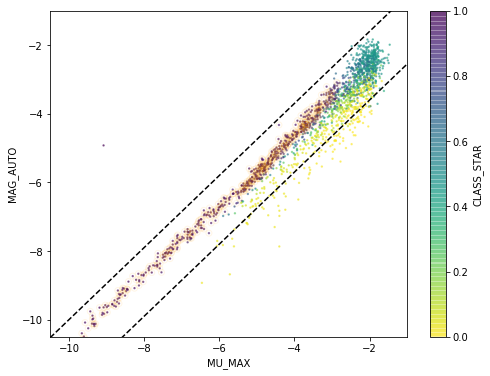

In [11]:
# Star cond
plt.figure(figsize=(8,6))
mag_auto = -2.5*np.log10(Datacube.Tab_SE["FLUX_AUTO"])
plt.scatter(Datacube.Tab_SE["MU_MAX"], mag_auto,
            c = Datacube.Tab_SE["CLASS_STAR"], s=2, cmap='viridis_r', alpha=0.5)

xx = np.linspace(-10.5,-1,100)
plt.plot(xx, 1.05*xx-1.5, 'k--', xx, 1.05*xx+0.5, 'k--')
plt.xlabel("MU_MAX")
plt.ylabel("MAG_AUTO")
plt.xlim(-10.5,-1.)
plt.ylim(-10.5,-1.)
cb = plt.colorbar()
cb.set_label("CLASS_STAR")

star_cond = ((abs(mag_auto-1.05*Datacube.Tab_SE["MU_MAX"]  + 0.5))<1) & (Datacube.Tab_SE['CLASS_STAR']>0.9)
plt.scatter(Datacube.Tab_SE["MU_MAX"][star_cond], mag_auto[star_cond],facecolors='none',color='orange',alpha=0.1)
np.sum(star_cond)

In [12]:
Y_pix, X_pix = np.indices(Datacube.mask_edge.shape)
dist_edge = np.array([np.sqrt((X_pix[~Datacube.mask_edge]-gal["X_IMAGE"])**2 + \
                              (Y_pix[~Datacube.mask_edge]-gal["Y_IMAGE"])**2).min() \
                      for gal in Datacube.Tab_SE])

86
109
8.627997153665145
5.939170249500874


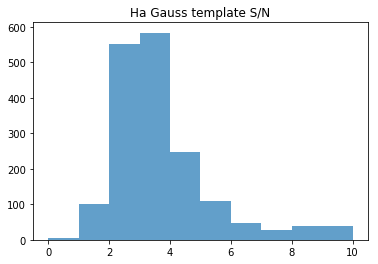

In [15]:
# Gaussian library Ha template (New CC method)
inds_best_Ha = np.argmax(Datacube.CC_Rs_Temps['Ha-NII_gauss'], axis=1)
SNR_best_Ha = np.array([Datacube.CC_SNRs_Temps['Ha-NII_gauss'][i,j] for i,j in enumerate(inds_best_Ha)])
SNRp_best_Ha = np.array([Datacube.CC_SNR_ps_Temps['Ha-NII_gauss'][i,j] for i,j in enumerate(inds_best_Ha)])
flage = Datacube.CC_flag_edge_Temps['OII_gauss']

# Gaussian library Hb template (New CC method)
inds_best_OII = np.argmax(Datacube.CC_Rs_Temps['OII_gauss'], axis=1)
SNR_best_OII = np.array([Datacube.CC_SNRs_Temps['OII_gauss'][i,j] for i,j in enumerate(inds_best_OII)])

plt.hist(SNR_best_Ha,range=[0,10],bins=np.array([0,1,2,3,4,5,6,7,8,10]),alpha=0.7)
plt.title("Ha Gauss template S/N")

# Ha > 8 or OII>5
cond0 = (SNR_best_Ha>8) & (dist_edge>5) & (flage==0)  & (SNR_best_OII>3) 
cond2 = (SNR_best_Ha>5) & (SNR_best_Ha<8) & (dist_edge>5) & (~star_cond) & (flage==0)  & (SNR_best_OII>3)  

print(np.sum(cond0))
print(np.sum(cond2))

print(np.percentile(SNR_best_Ha, 95))
print(np.percentile(SNR_best_Ha, 90))

86
Best z: 0.2202452319137477 Best sigma: 3.5937883639639687
Peak wavl 8011.162381502847
SE Object #6  z: 0.220  Peak R: 2.083  Detction S/N: 7.298 Peak S/N: 4.876


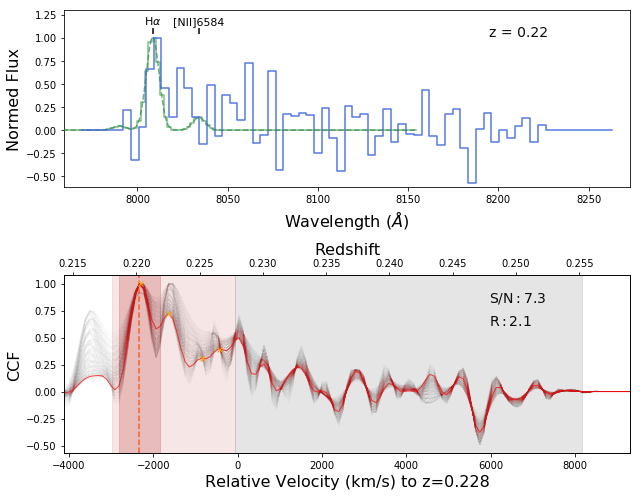

Best z: 0.2337288970300751 Best sigma: 2.889925154160589
Peak wavl 8095.648630191456
SE Object #7  z: 0.234  Peak R: 3.428  Detction S/N: 12.746 Peak S/N: 10.952


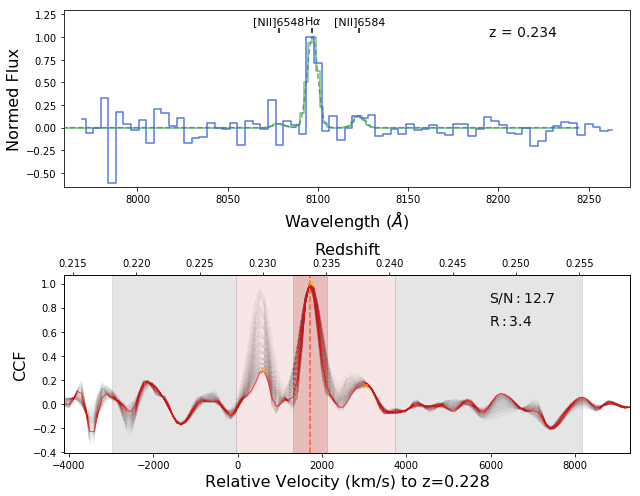

Best z: 0.22946648262902783 Best sigma: 1.8341303394555193
Peak wavl 8070.209625806931
SE Object #10  z: 0.229  Peak R: 2.274  Detction S/N: 6.622 Peak S/N: 5.779


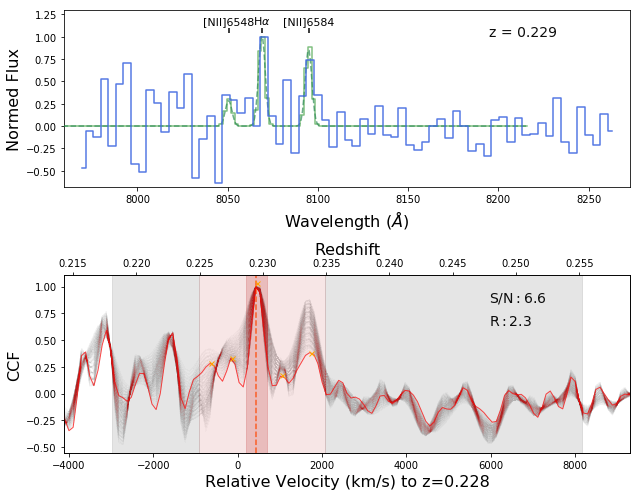

Best z: 0.22848284853647843 Best sigma: 4.6495831786690385
Peak wavl 8061.747733906723
SE Object #11  z: 0.228  Peak R: 2.870  Detction S/N: 11.272 Peak S/N: 7.586


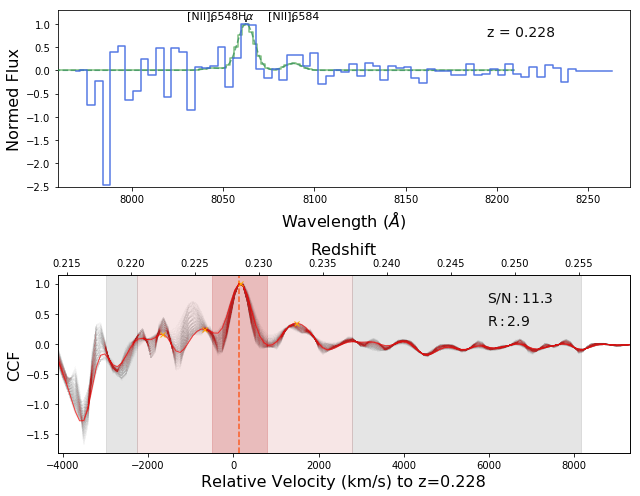

Best z: 0.2219233076545938 Best sigma: 5.0015147835707285
Peak wavl 7990.178945898085
SE Object #27  z: 0.222  Peak R: 2.360  Detction S/N: 9.467 Peak S/N: 4.865


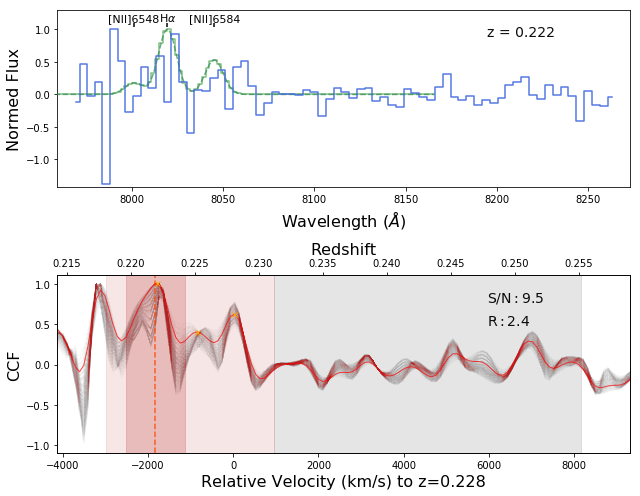

Best z: 0.22125401163758524 Best sigma: 4.297651573767348
Peak wavl 8015.365676684849
SE Object #30  z: 0.221  Peak R: 4.529  Detction S/N: 21.823 Peak S/N: 12.432


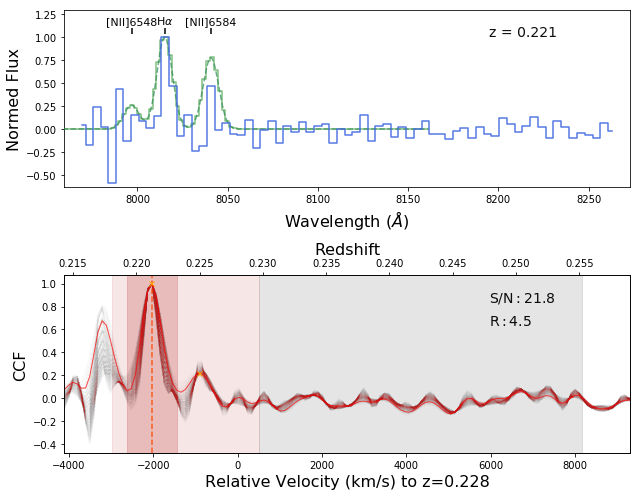

Best z: 0.22815497050562863 Best sigma: 3.5937883639639687
Peak wavl 8061.747733906723
SE Object #64  z: 0.228  Peak R: 5.543  Detction S/N: 39.521 Peak S/N: 17.641


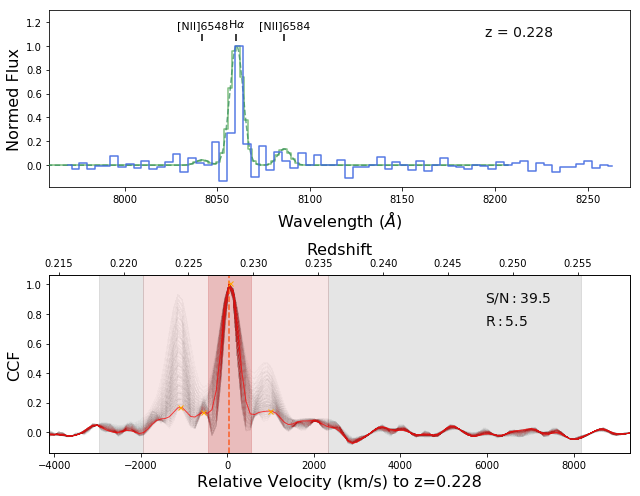

Best z: 0.23267814884356602 Best sigma: 5.0015147835707285
Peak wavl 8091.403234253834
SE Object #86  z: 0.233  Peak R: 2.902  Detction S/N: 10.791 Peak S/N: 8.471


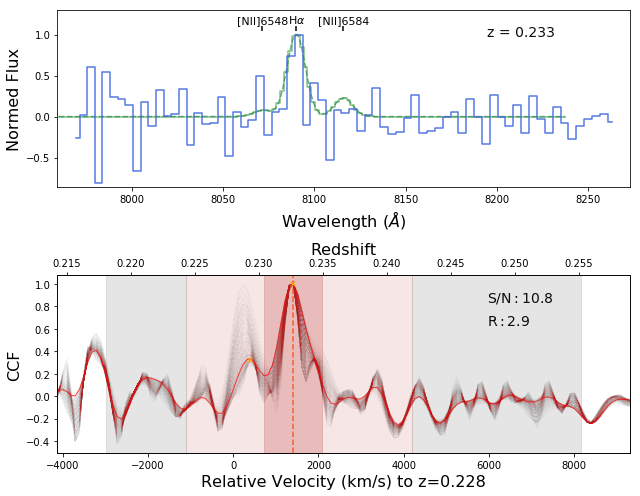

Best z: 0.22907149050421832 Best sigma: 2.1860619443572094
Peak wavl 8065.9775702019615
SE Object #89  z: 0.229  Peak R: 3.316  Detction S/N: 18.674 Peak S/N: 10.997


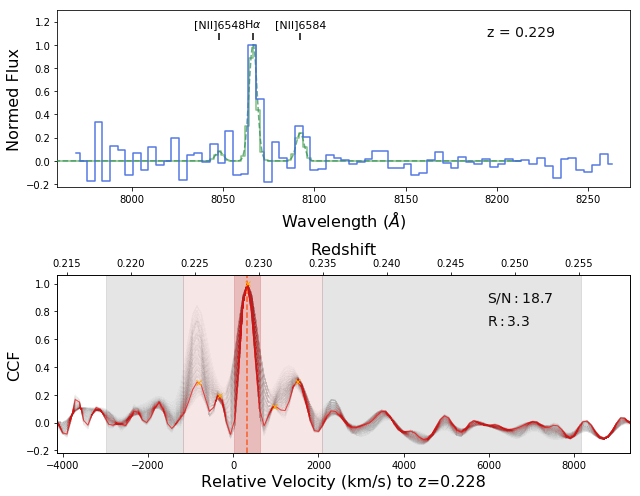

Best z: 0.2258598242896801 Best sigma: 5.0015147835707285
Peak wavl 8074.443901886031
SE Object #95  z: 0.226  Peak R: 1.216  Detction S/N: 8.779 Peak S/N: 4.502


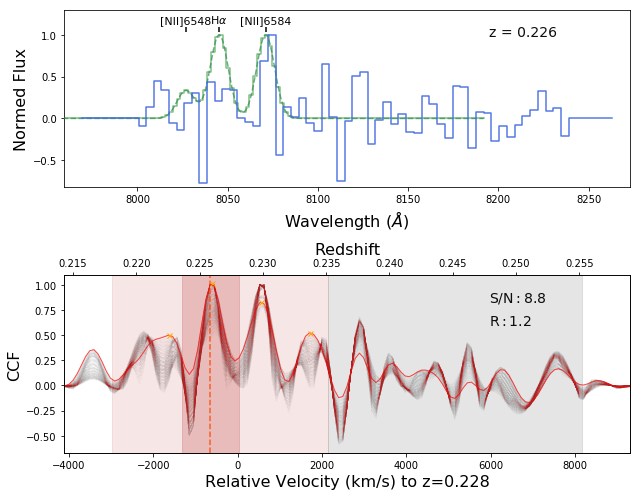

Best z: 0.22415332004147145 Best sigma: 5.0015147835707285
Peak wavl 8015.365676684849
SE Object #98  z: 0.224  Peak R: 1.002  Detction S/N: 9.657 Peak S/N: 2.958


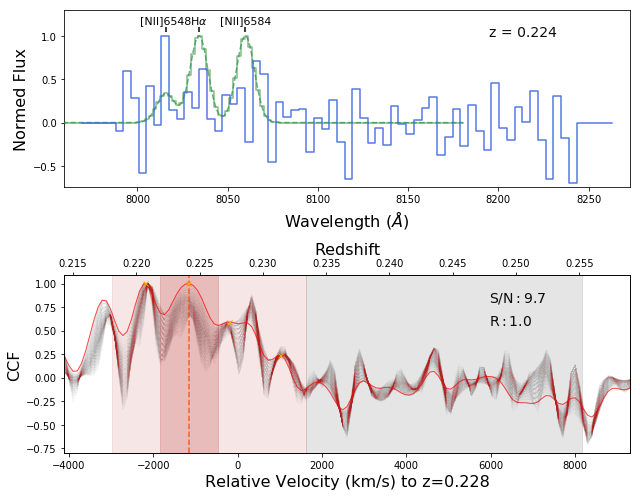

Best z: 0.219962429334306 Best sigma: 5.0015147835707285
Peak wavl 8006.961290548477
SE Object #142  z: 0.220  Peak R: 1.116  Detction S/N: 12.498 Peak S/N: 3.486


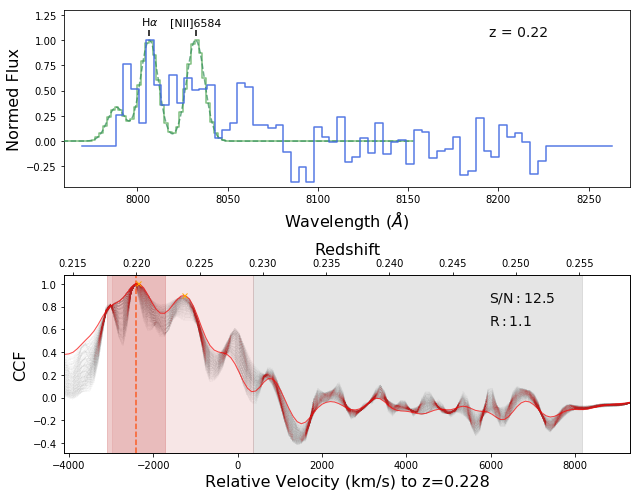

Best z: 0.22939936853506812 Best sigma: 5.0015147835707285
Peak wavl 8070.209625806931
SE Object #156  z: 0.229  Peak R: 4.281  Detction S/N: 8.028 Peak S/N: 4.428


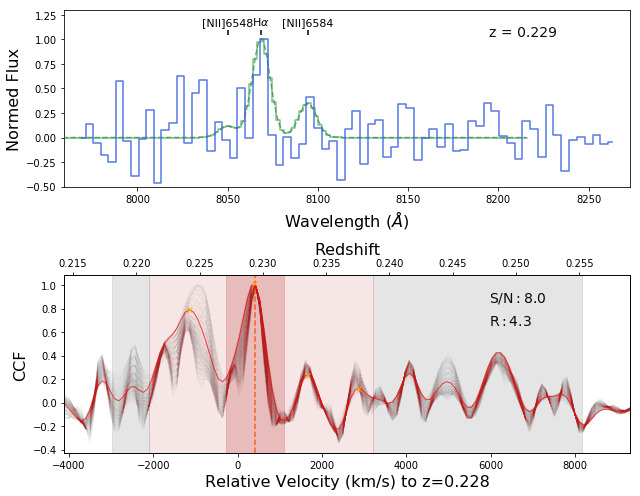

Best z: 0.22415332004147145 Best sigma: 5.0015147835707285
Peak wavl 8006.961290548477
SE Object #164  z: 0.224  Peak R: 1.003  Detction S/N: 9.289 Peak S/N: 3.352


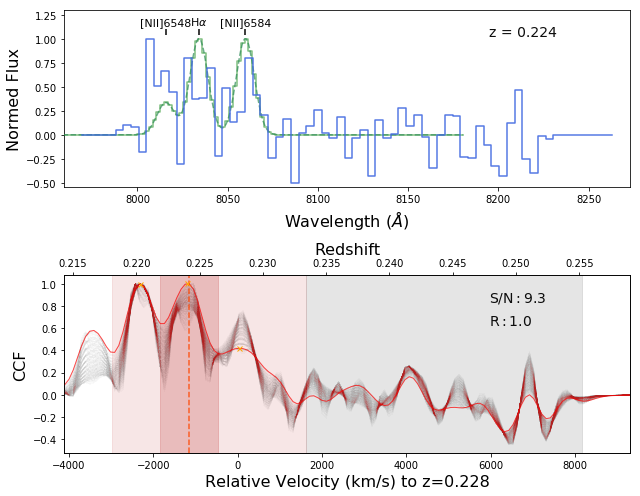

Best z: 0.22225038695234223 Best sigma: 2.889925154160589
Peak wavl 8023.778884358352
SE Object #170  z: 0.222  Peak R: 5.246  Detction S/N: 10.463 Peak S/N: 8.708


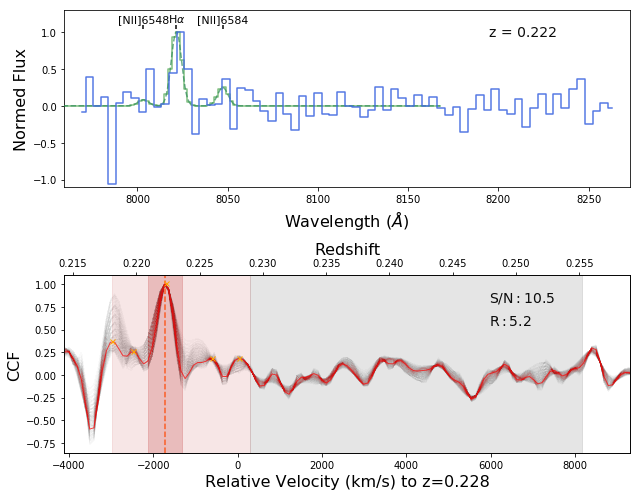

Best z: 0.2202452319137477 Best sigma: 5.0015147835707285
Peak wavl 8011.162381502847
SE Object #183  z: 0.220  Peak R: 1.370  Detction S/N: 9.272 Peak S/N: 4.214


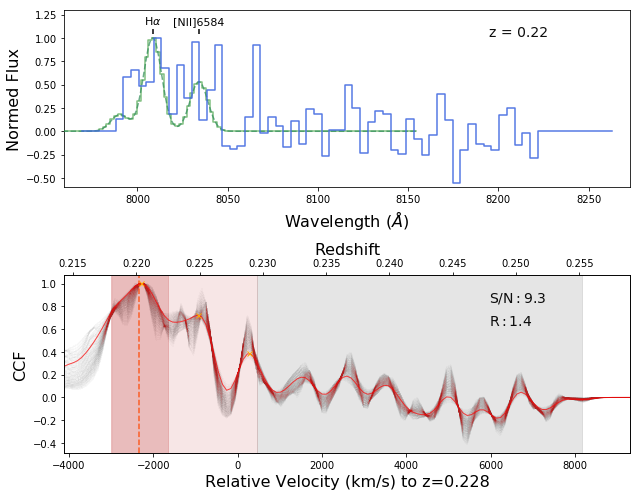

Best z: 0.22125401163758524 Best sigma: 5.0015147835707285
Peak wavl 8011.162381502847
SE Object #187  z: 0.221  Peak R: 1.280  Detction S/N: 15.446 Peak S/N: 4.442


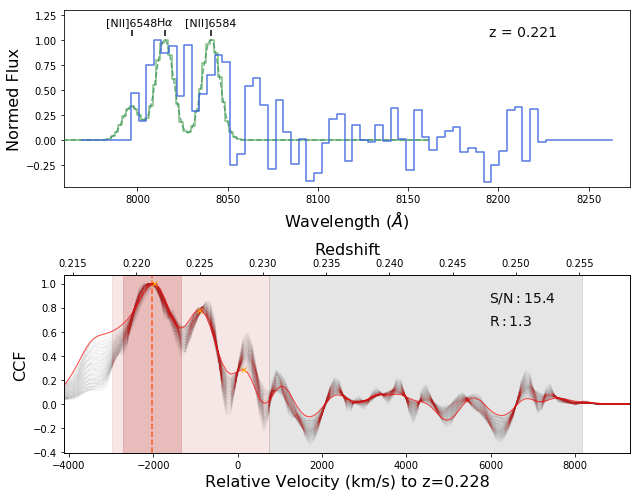

Best z: 0.23071088065846726 Best sigma: 2.537993549258899
Peak wavl 8078.680399604328
SE Object #192  z: 0.231  Peak R: 3.065  Detction S/N: 28.443 Peak S/N: 12.679


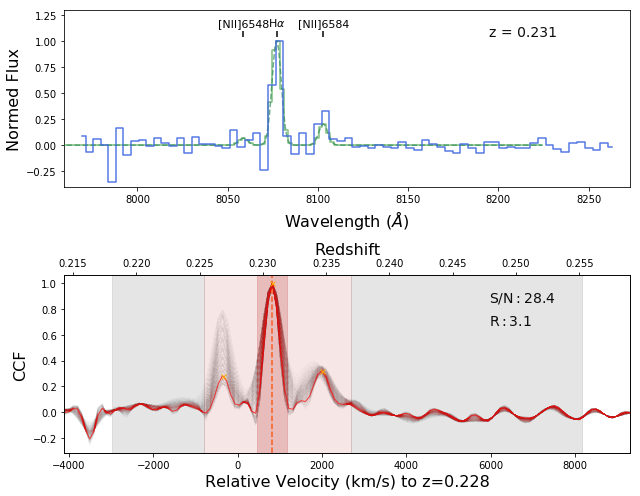

Best z: 0.22389255610458136 Best sigma: 4.297651573767348
Peak wavl 8032.20092282838
SE Object #206  z: 0.224  Peak R: 8.211  Detction S/N: 12.333 Peak S/N: 10.279


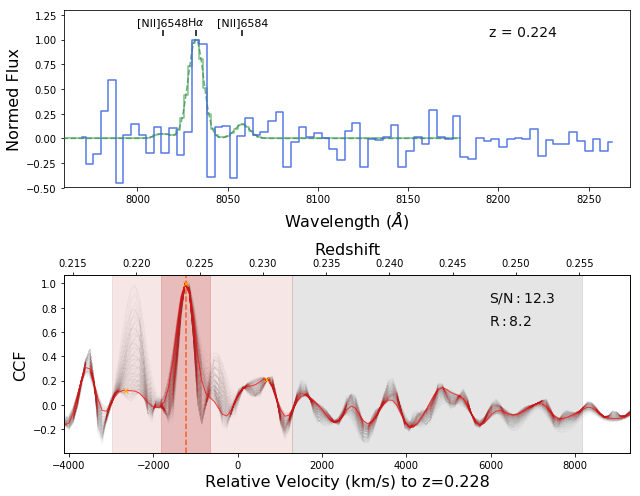

Best z: 0.22743210034996936 Best sigma: 2.1860619443572094
Peak wavl 8057.520115757371
SE Object #245  z: 0.227  Peak R: 2.411  Detction S/N: 18.230 Peak S/N: 9.399


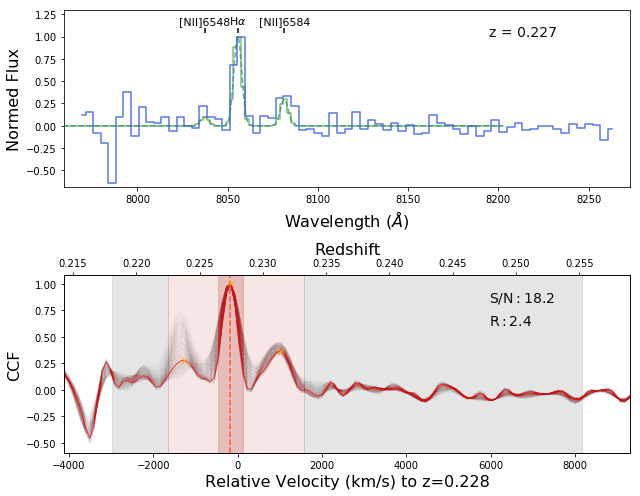

Best z: 0.22287840550784246 Best sigma: 2.1860619443572094
Peak wavl 8027.988799164701
SE Object #251  z: 0.223  Peak R: 5.456  Detction S/N: 14.635 Peak S/N: 11.286


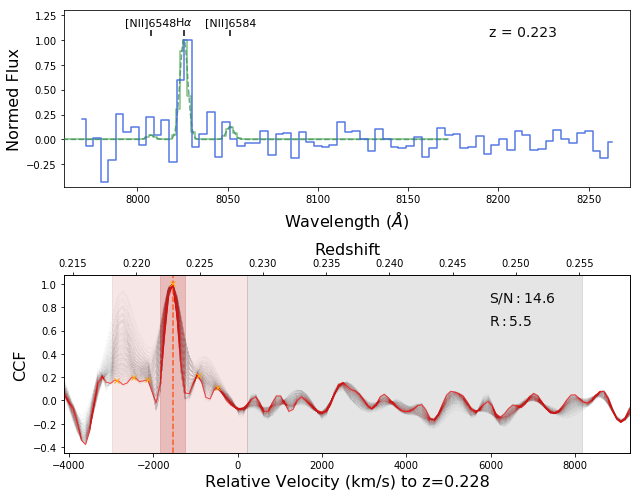

Best z: 0.22225038695234223 Best sigma: 5.0015147835707285
Peak wavl 8049.071529244185
SE Object #257  z: 0.222  Peak R: 1.528  Detction S/N: 8.516 Peak S/N: 3.597


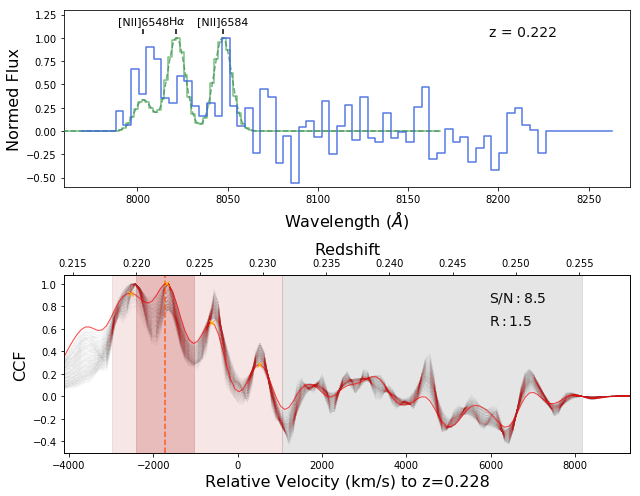

Best z: 0.22382544201062166 Best sigma: 3.241856759062279
Peak wavl 8032.20092282838
SE Object #286  z: 0.224  Peak R: 3.985  Detction S/N: 11.970 Peak S/N: 7.713


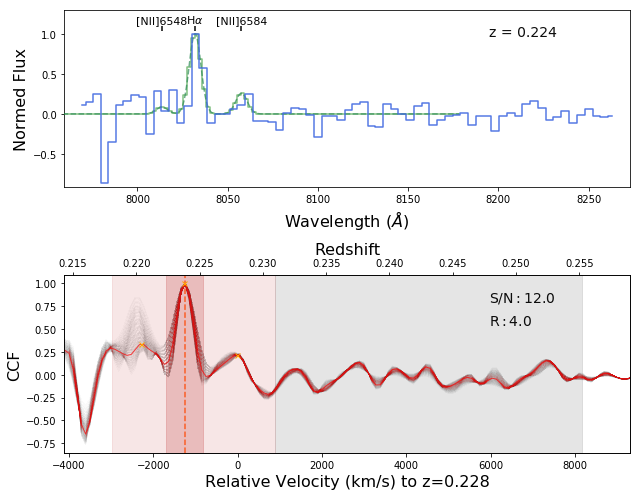

Best z: 0.2297272465659179 Best sigma: 4.297651573767348
Peak wavl 8070.209625806931
SE Object #303  z: 0.230  Peak R: 3.073  Detction S/N: 18.156 Peak S/N: 9.788


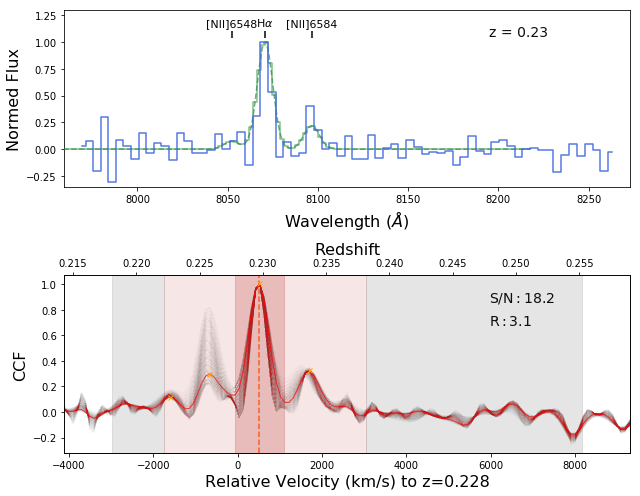

Best z: 0.22487619019713073 Best sigma: 1.8341303394555193
Peak wavl 8040.631801364043
SE Object #349  z: 0.225  Peak R: 2.143  Detction S/N: 13.845 Peak S/N: 8.747


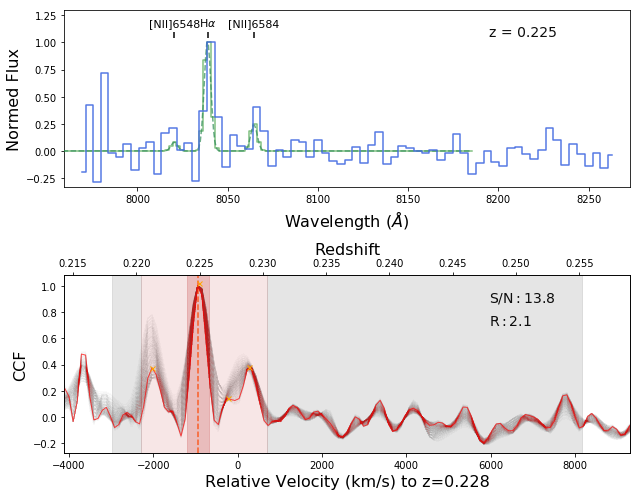

Best z: 0.22422043413543116 Best sigma: 2.1860619443572094
Peak wavl 8036.4152565082995
SE Object #355  z: 0.224  Peak R: 8.733  Detction S/N: 12.486 Peak S/N: 11.225


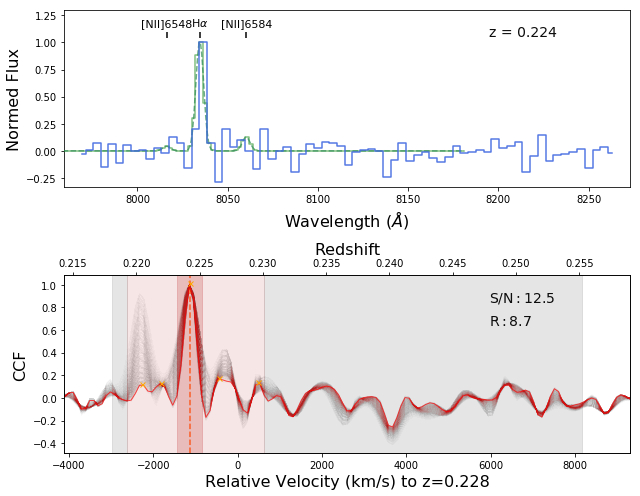

Best z: 0.2196097424852952 Best sigma: 5.0015147835707285
Peak wavl 8011.162381502847
SE Object #371  z: 0.220  Peak R: 1.198  Detction S/N: 12.846 Peak S/N: 3.928


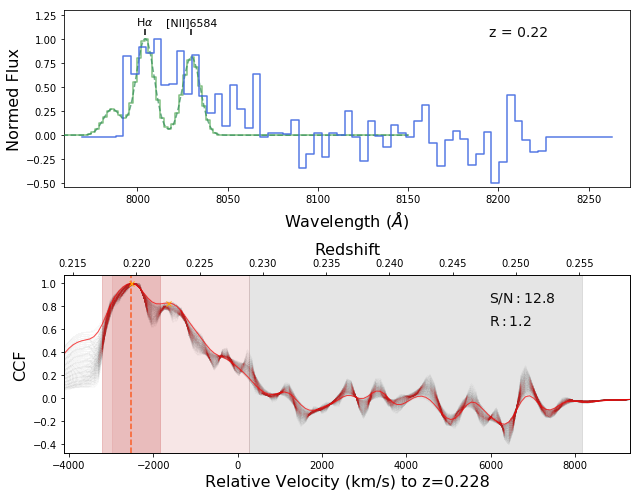

Best z: 0.2202452319137477 Best sigma: 1.8341303394555193
Peak wavl 8011.162381502847
SE Object #410  z: 0.220  Peak R: 4.181  Detction S/N: 10.259 Peak S/N: 9.603


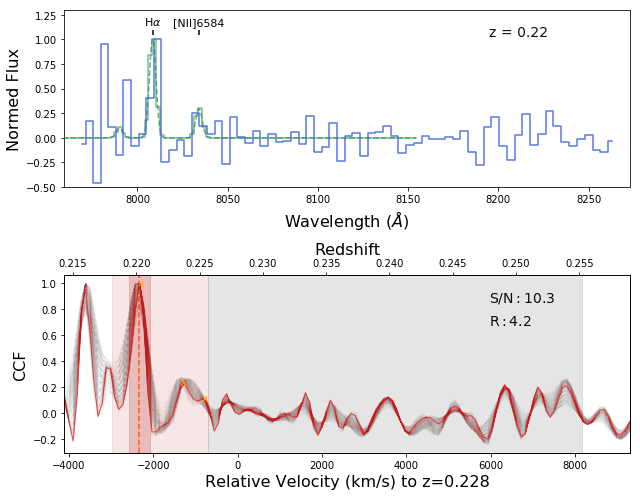

Best z: 0.22155248412727294 Best sigma: 3.241856759062279
Peak wavl 8019.571177250968
SE Object #435  z: 0.222  Peak R: 4.114  Detction S/N: 9.495 Peak S/N: 7.391


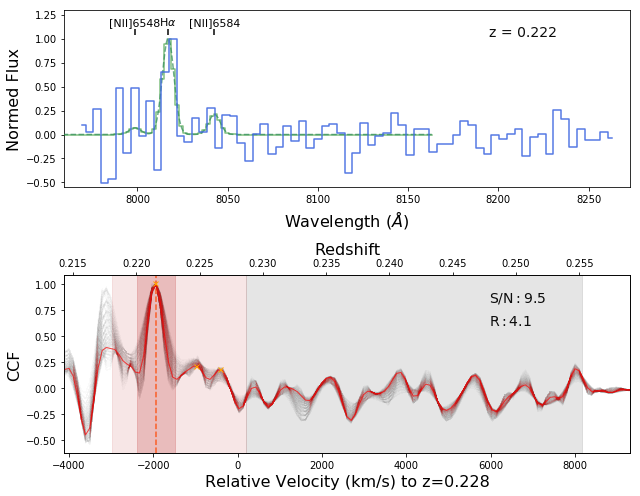

Best z: 0.2336617829361154 Best sigma: 4.6495831786690385
Peak wavl 8095.648630191456
SE Object #442  z: 0.234  Peak R: 1.099  Detction S/N: 7.995 Peak S/N: 3.935


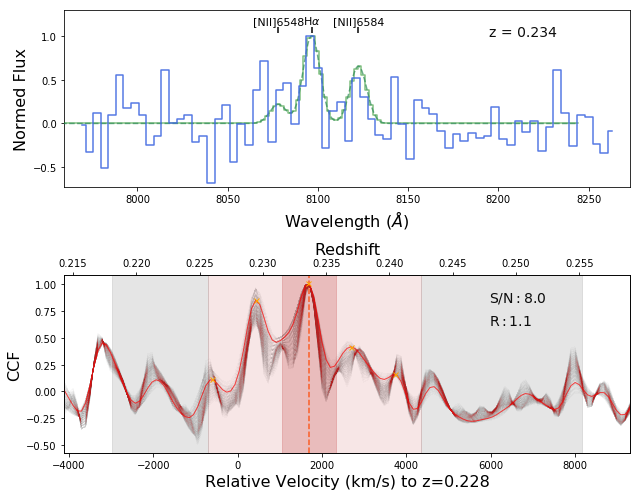

Best z: 0.22487619019713073 Best sigma: 1.8341303394555193
Peak wavl 8040.631801364043
SE Object #443  z: 0.225  Peak R: 3.041  Detction S/N: 9.664 Peak S/N: 7.914


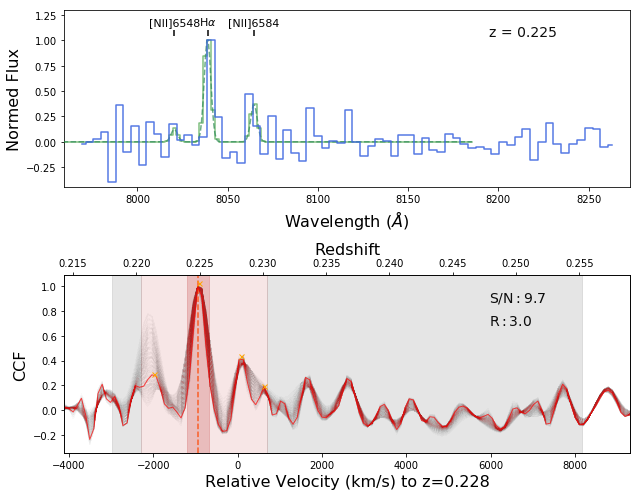

Best z: 0.22356467807373157 Best sigma: 1.8341303394555193
Peak wavl 8032.20092282838
SE Object #451  z: 0.224  Peak R: 3.365  Detction S/N: 10.902 Peak S/N: 9.791


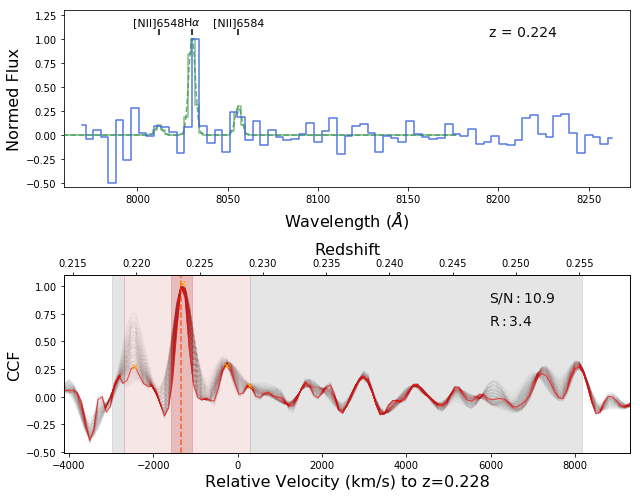

Best z: 0.234317538997815 Best sigma: 2.889925154160589
Peak wavl 8099.896253602639
SE Object #516  z: 0.234  Peak R: 6.950  Detction S/N: 11.920 Peak S/N: 6.373


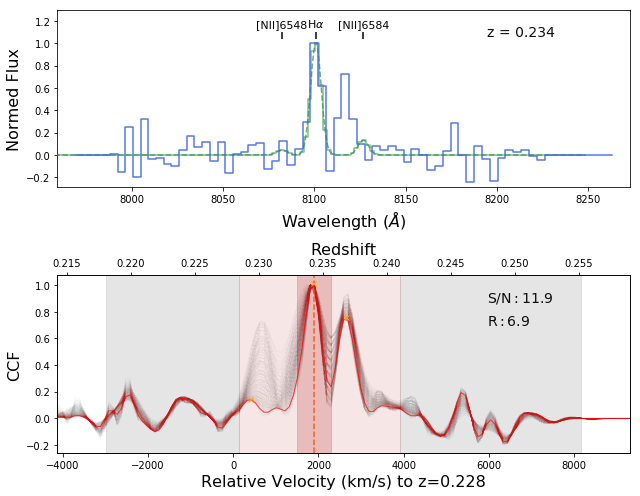

Best z: 0.21991648458103655 Best sigma: 1.8341303394555193
Peak wavl 8006.961290548477
SE Object #520  z: 0.220  Peak R: 3.230  Detction S/N: 29.383 Peak S/N: 15.935


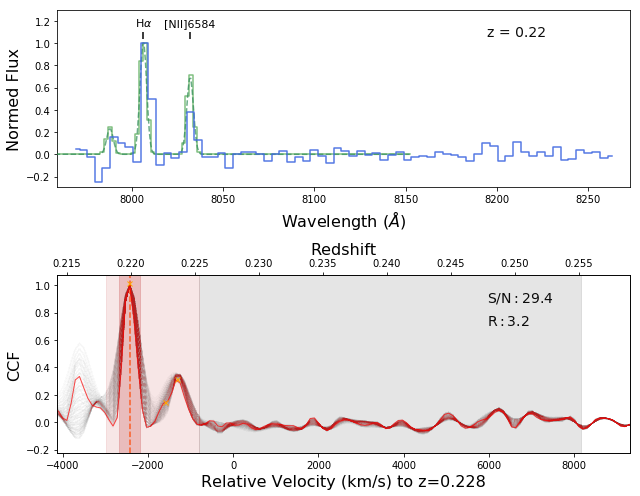

Best z: 0.246516140233217 Best sigma: 3.241856759062279
Peak wavl 8181.025876450399
SE Object #533  z: 0.247  Peak R: 9.088  Detction S/N: 8.482 Peak S/N: 9.179


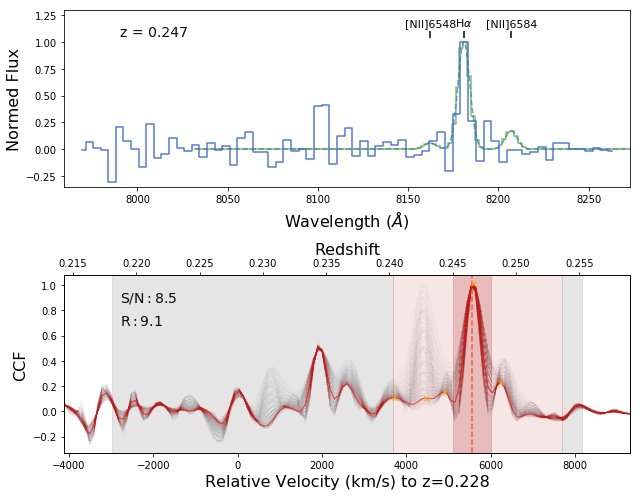

Best z: 0.2340567750609249 Best sigma: 3.5937883639639687
Peak wavl 8099.896253602639
SE Object #535  z: 0.234  Peak R: 4.826  Detction S/N: 8.963 Peak S/N: 4.919


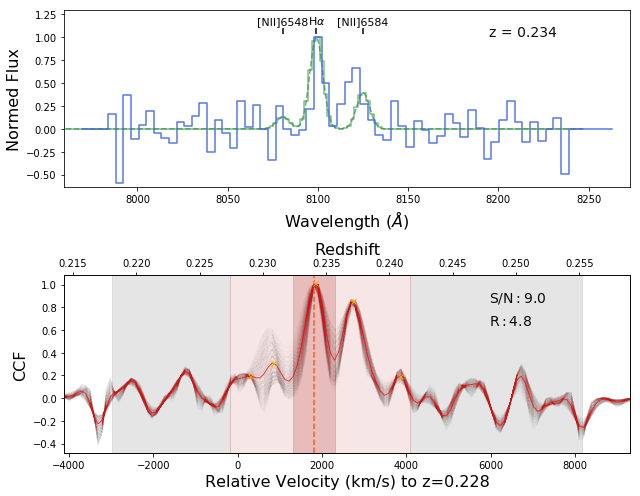

Best z: 0.22480907610317102 Best sigma: 5.0015147835707285
Peak wavl 8061.747733906723
SE Object #659  z: 0.225  Peak R: 1.188  Detction S/N: 9.625 Peak S/N: 3.238


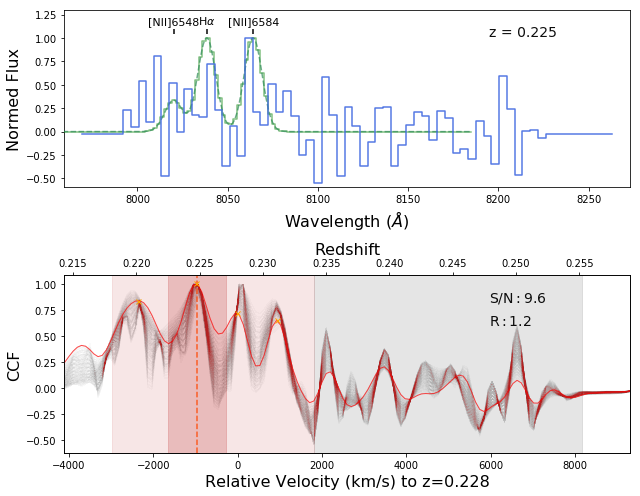

Best z: 0.2202452319137477 Best sigma: 5.0015147835707285
Peak wavl 8006.961290548477
SE Object #666  z: 0.220  Peak R: 1.845  Detction S/N: 11.758 Peak S/N: 5.519


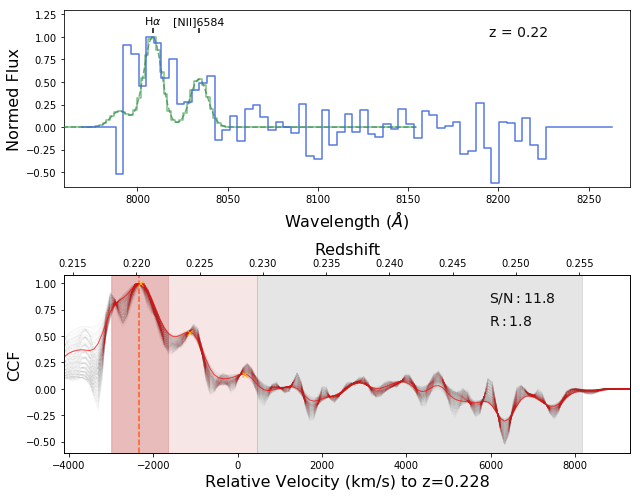

Best z: 0.22287840550784246 Best sigma: 5.0015147835707285
Peak wavl 8006.961290548477
SE Object #711  z: 0.223  Peak R: 1.793  Detction S/N: 10.107 Peak S/N: 4.705


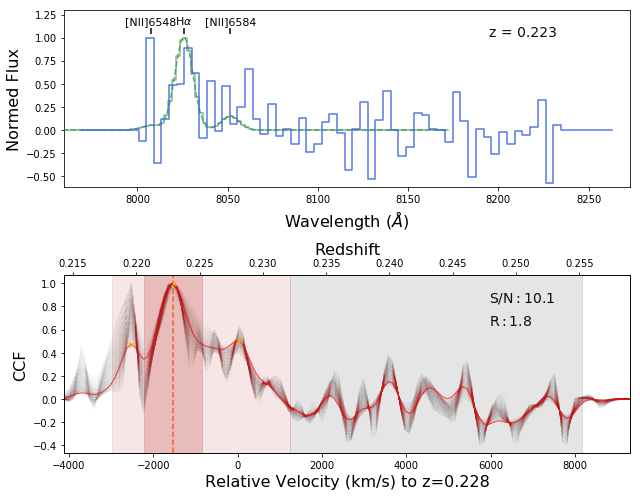

Best z: 0.22059598448342865 Best sigma: 5.0015147835707285
Peak wavl 7994.3712314950135
SE Object #724  z: 0.221  Peak R: 1.626  Detction S/N: 10.525 Peak S/N: 4.787


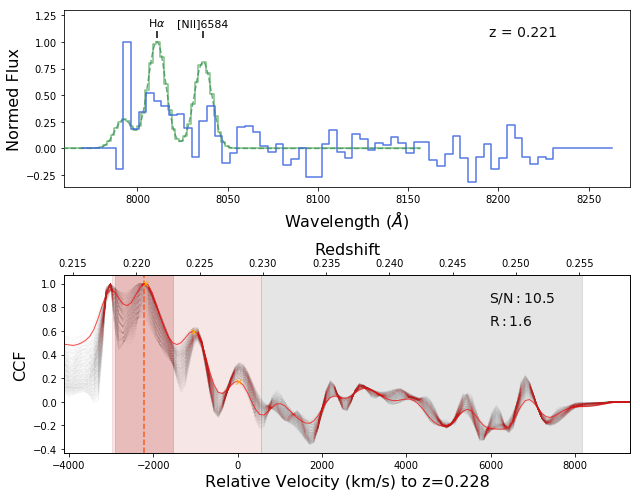

Best z: 0.22874361247336852 Best sigma: 2.1860619443572094
Peak wavl 8065.9775702019615
SE Object #727  z: 0.229  Peak R: 4.382  Detction S/N: 11.616 Peak S/N: 11.189


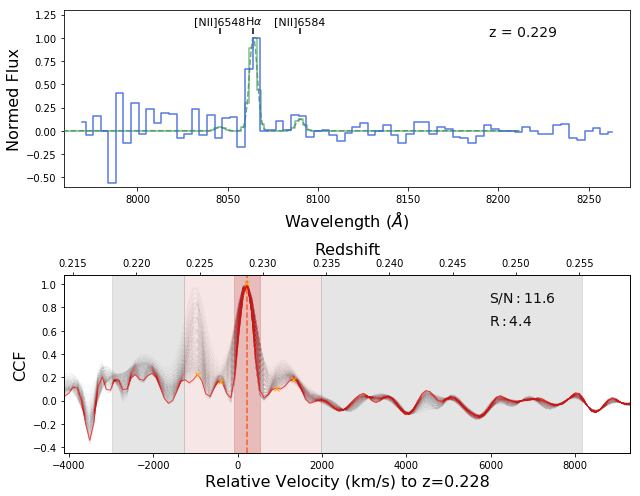

Best z: 0.23504040915347427 Best sigma: 4.297651573767348
Peak wavl 8104.1461056560665
SE Object #734  z: 0.235  Peak R: 3.895  Detction S/N: 35.129 Peak S/N: 13.612


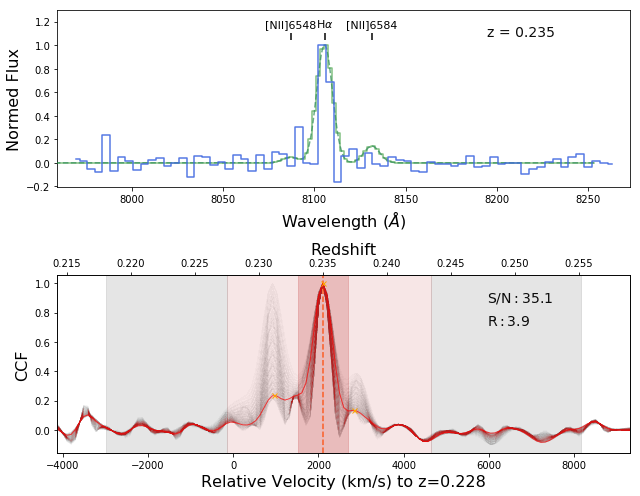

Best z: 0.2202452319137477 Best sigma: 1.8341303394555193
Peak wavl 7981.800968913782
SE Object #736  z: 0.220  Peak R: 4.234  Detction S/N: 11.097 Peak S/N: 10.253


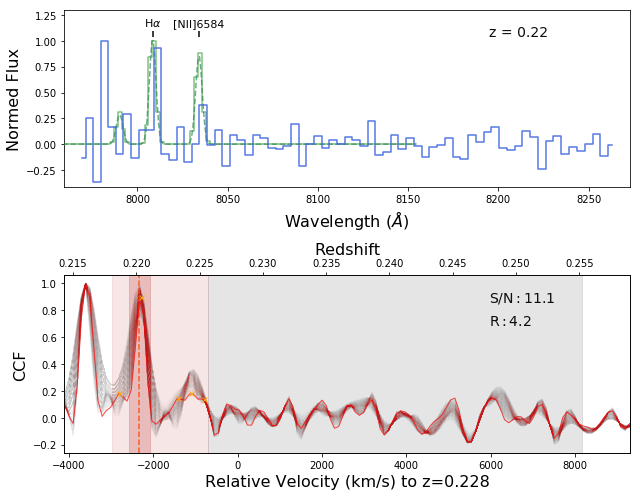

Best z: 0.22513695413402082 Best sigma: 2.1860619443572094
Peak wavl 8040.631801364043
SE Object #756  z: 0.225  Peak R: 3.896  Detction S/N: 15.831 Peak S/N: 11.774


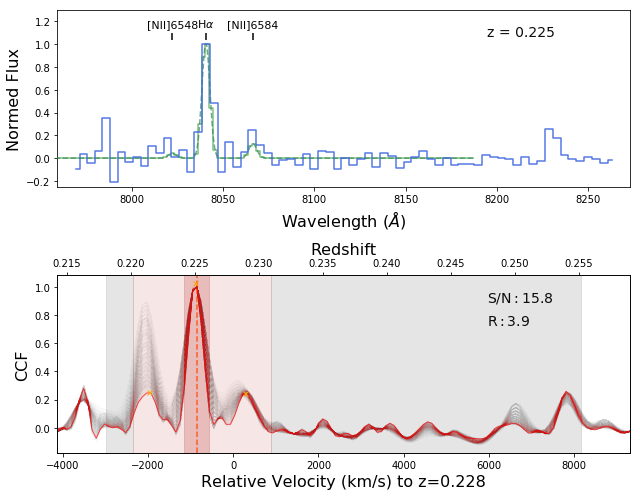

Best z: 0.2189442444581863 Best sigma: 3.945719968865659
Peak wavl 7998.565716699551
SE Object #922  z: 0.219  Peak R: 4.902  Detction S/N: 10.828 Peak S/N: 6.188


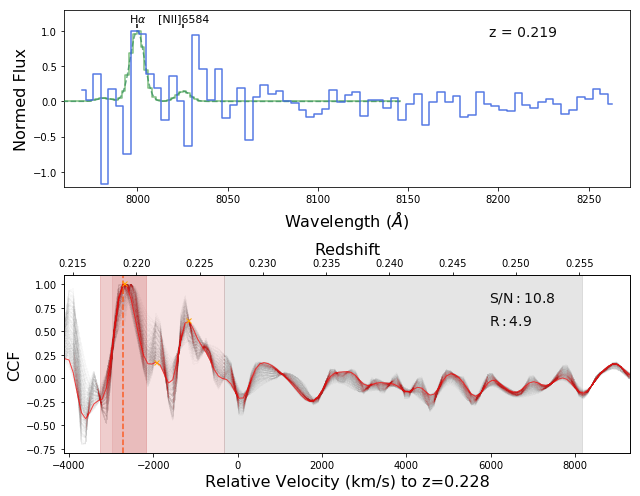

Best z: 0.2189442444581863 Best sigma: 4.297651573767348
Peak wavl 8032.20092282838
SE Object #932  z: 0.219  Peak R: 2.145  Detction S/N: 9.779 Peak S/N: 4.953


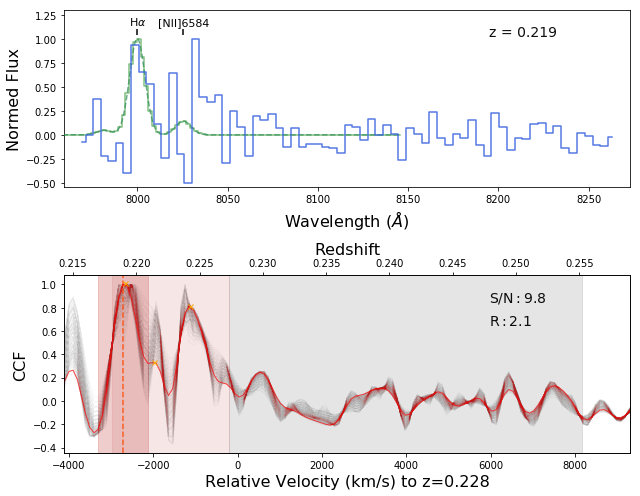

Best z: 0.2261877023205299 Best sigma: 5.0015147835707285
Peak wavl 8049.071529244185
SE Object #946  z: 0.226  Peak R: 1.739  Detction S/N: 10.791 Peak S/N: 3.819


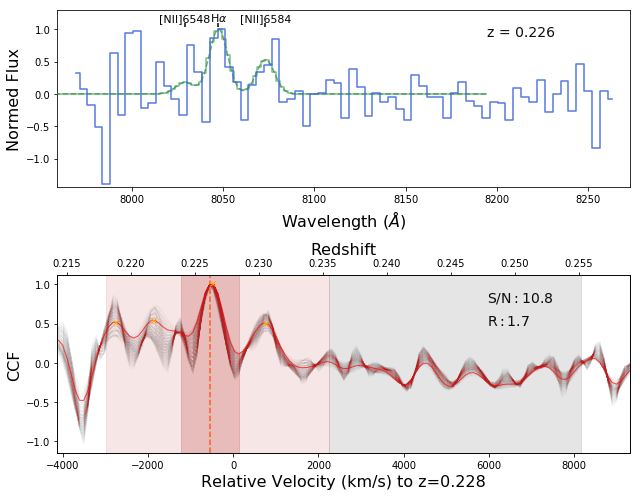

Best z: 0.22054563868276528 Best sigma: 5.0015147835707285
Peak wavl 8019.571177250968
SE Object #949  z: 0.221  Peak R: 1.275  Detction S/N: 15.446 Peak S/N: 4.508


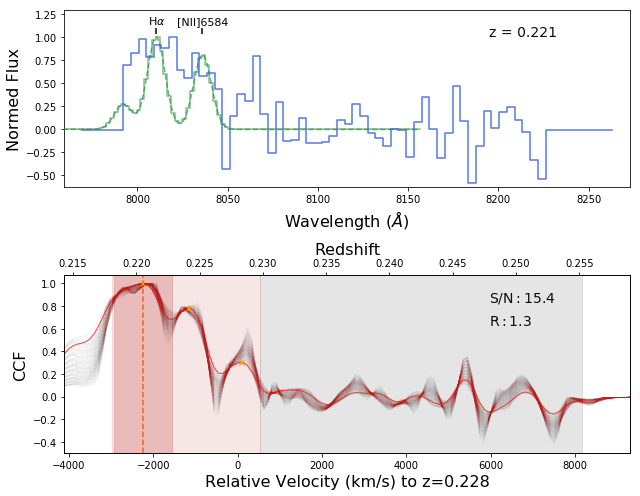

Best z: 0.21991648458103655 Best sigma: 5.0015147835707285
Peak wavl 8002.762402665817
SE Object #965  z: 0.220  Peak R: 1.544  Detction S/N: 13.940 Peak S/N: 4.500


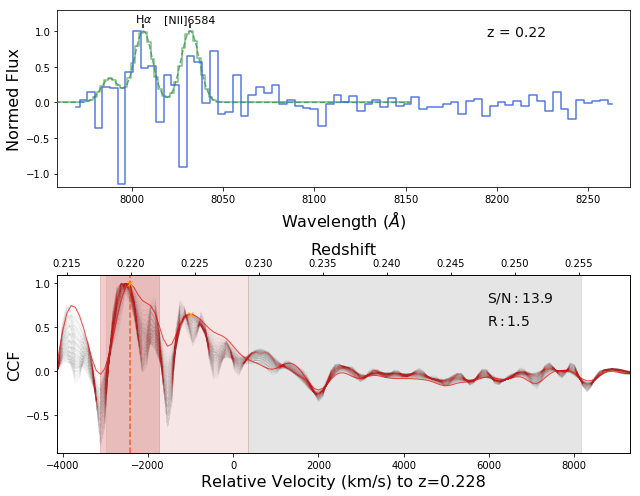

Best z: 0.21991648458103655 Best sigma: 5.0015147835707285
Peak wavl 8002.762402665817
SE Object #995  z: 0.220  Peak R: 1.249  Detction S/N: 10.608 Peak S/N: 4.134


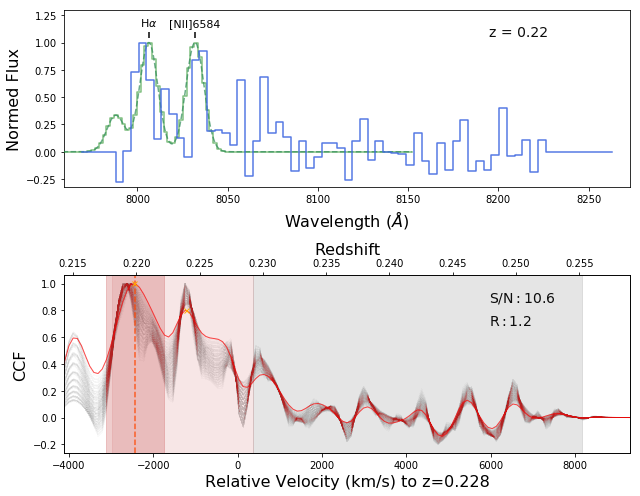

Best z: 0.2301222386907274 Best sigma: 4.297651573767348
Peak wavl 8074.443901886031
SE Object #1028  z: 0.230  Peak R: 5.142  Detction S/N: 26.993 Peak S/N: 13.269


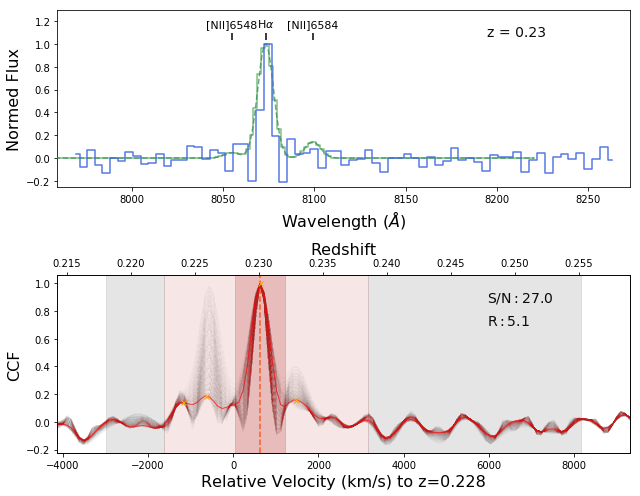

Best z: 0.23110587278327677 Best sigma: 5.0015147835707285
Peak wavl 8078.680399604328
SE Object #1029  z: 0.231  Peak R: 5.361  Detction S/N: 15.129 Peak S/N: 13.857


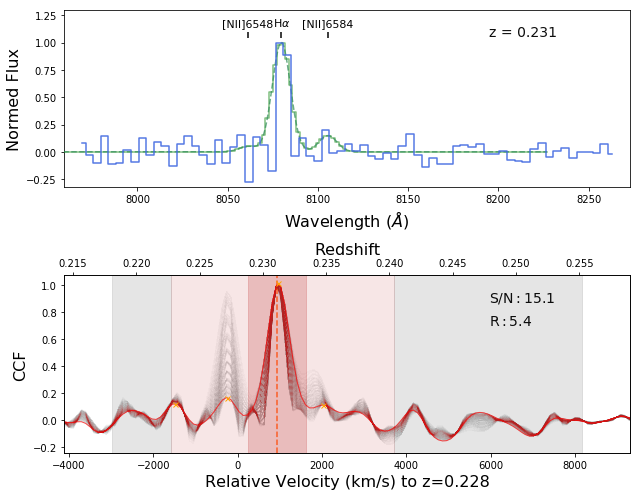

Best z: 0.2196097424852952 Best sigma: 5.0015147835707285
Peak wavl 7998.565716699551
SE Object #1030  z: 0.220  Peak R: 3.468  Detction S/N: 8.594 Peak S/N: 7.051


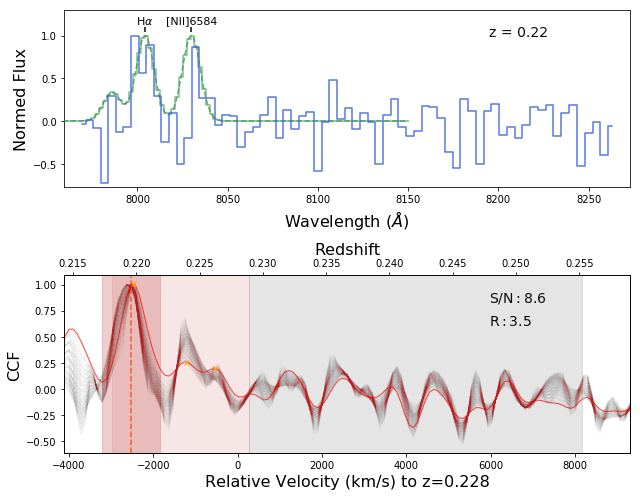

Best z: 0.2517400003942137 Best sigma: 1.8341303394555193
Peak wavl 8215.428355775559
SE Object #1252  z: 0.252  Peak R: 4.441  Detction S/N: 17.831 Peak S/N: 12.839


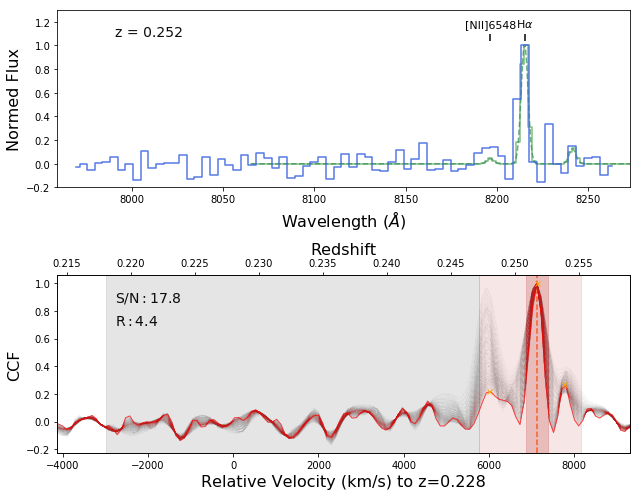

Best z: 0.2517400003942137 Best sigma: 3.5937883639639687
Peak wavl 8215.428355775559
SE Object #1270  z: 0.252  Peak R: 4.932  Detction S/N: 110.058 Peak S/N: 23.306


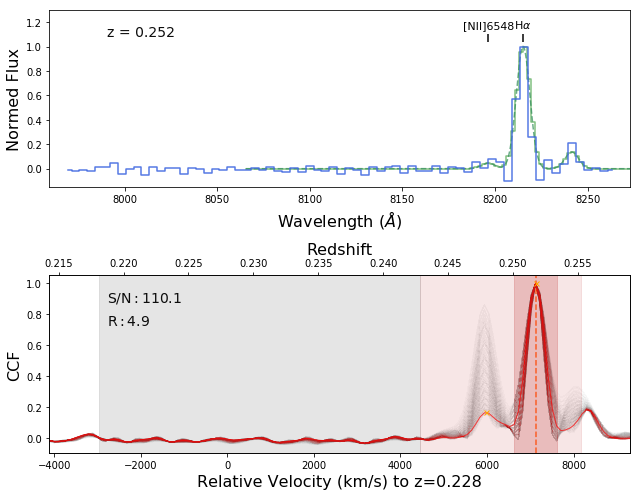

Best z: 0.2257927101957204 Best sigma: 3.945719968865659
Peak wavl 8044.850558555739
SE Object #1281  z: 0.226  Peak R: 3.800  Detction S/N: 41.757 Peak S/N: 14.606


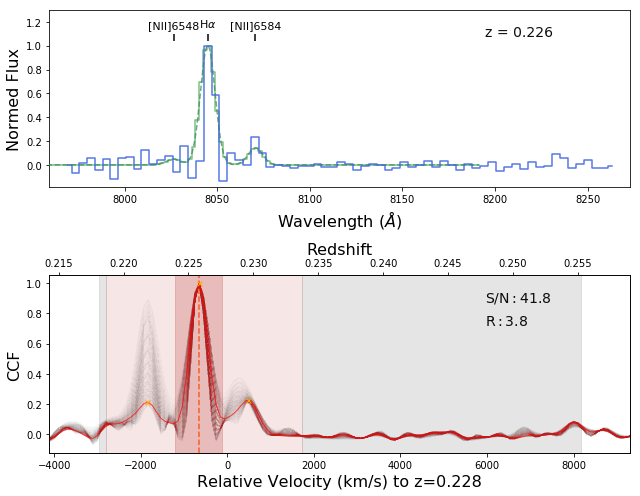

Best z: 0.2504140790136442 Best sigma: 2.889925154160589
Peak wavl 8206.81419705059
SE Object #1329  z: 0.250  Peak R: 4.594  Detction S/N: 28.097 Peak S/N: 16.463


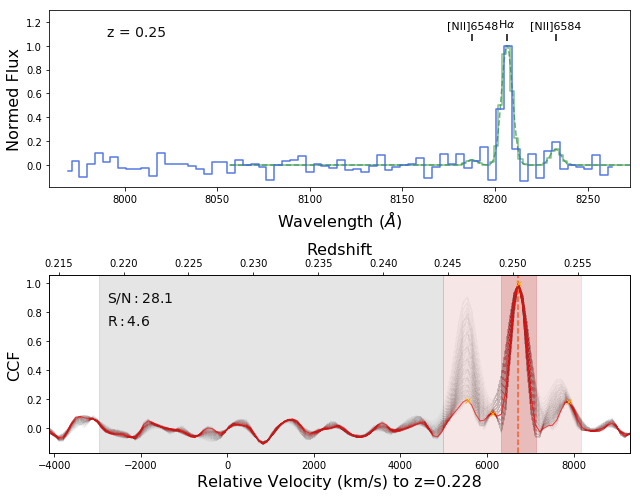

Best z: 0.2196097424852952 Best sigma: 5.0015147835707285
Peak wavl 8002.762402665817
SE Object #1359  z: 0.220  Peak R: 1.850  Detction S/N: 8.405 Peak S/N: 5.683


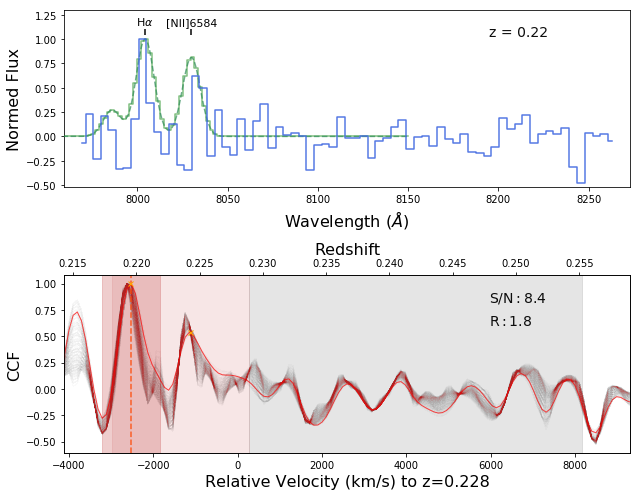

Best z: 0.22259066939227254 Best sigma: 5.0015147835707285
Peak wavl 8027.988799164701
SE Object #1371  z: 0.223  Peak R: 2.153  Detction S/N: 9.355 Peak S/N: 7.416


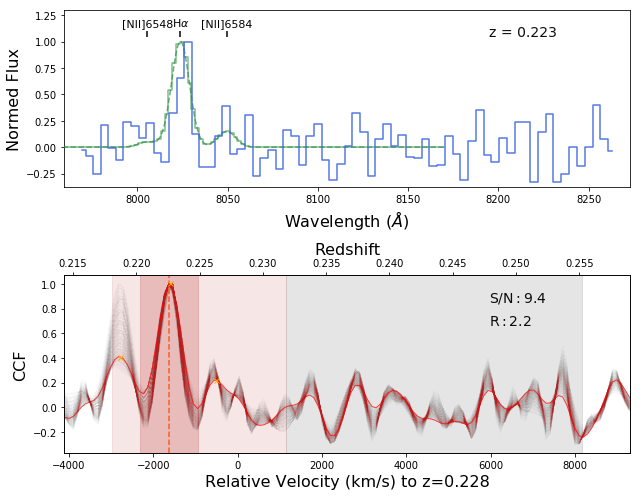

Best z: 0.22349756397977186 Best sigma: 5.0015147835707285
Peak wavl 8032.20092282838
SE Object #1385  z: 0.223  Peak R: 3.421  Detction S/N: 8.133 Peak S/N: 8.142


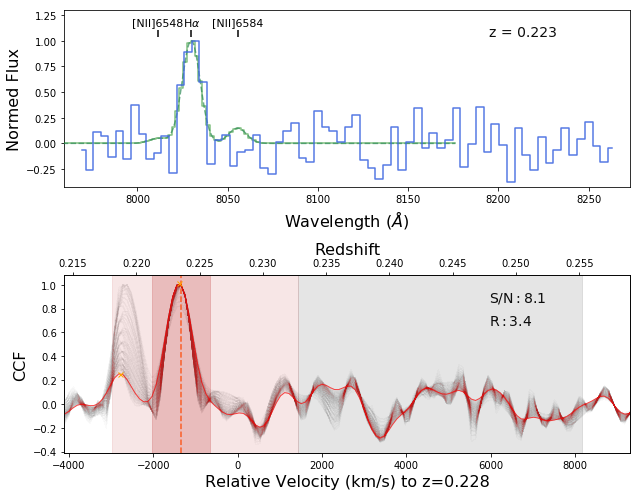

Best z: 0.2254648321648706 Best sigma: 4.297651573767348
Peak wavl 8044.850558555739
SE Object #1437  z: 0.225  Peak R: 2.177  Detction S/N: 27.086 Peak S/N: 8.408


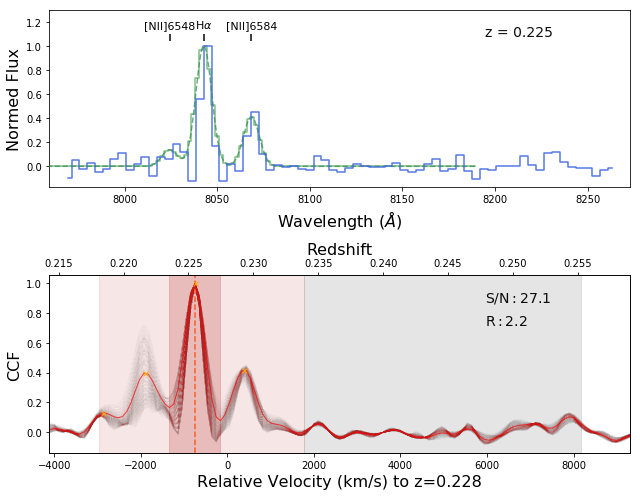

Best z: 0.23897494552367177 Best sigma: 5.0015147835707285
Peak wavl 8133.957570313864
SE Object #1478  z: 0.239  Peak R: 4.895  Detction S/N: 8.926 Peak S/N: 9.394


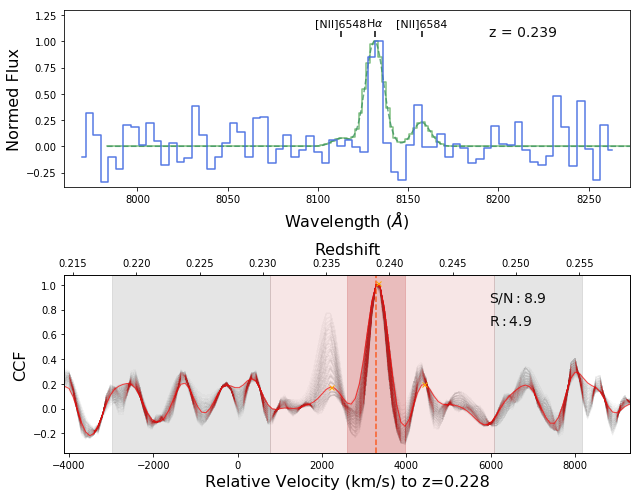

Best z: 0.2258598242896801 Best sigma: 1.8341303394555193
Peak wavl 8044.850558555739
SE Object #1499  z: 0.226  Peak R: 2.082  Detction S/N: 10.584 Peak S/N: 6.957


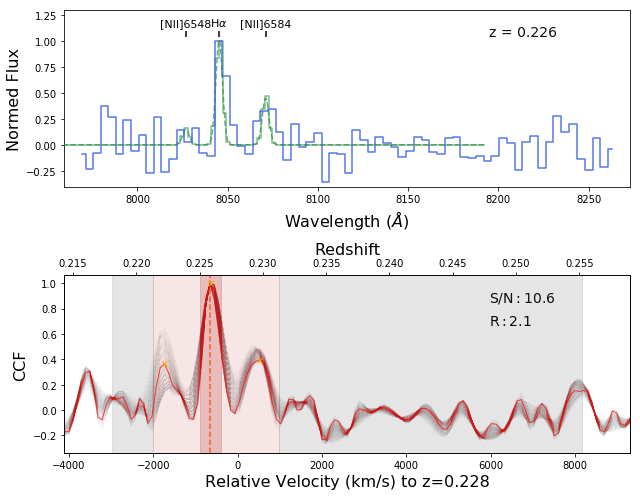

Best z: 0.2261205882265702 Best sigma: 4.6495831786690385
Peak wavl 8049.071529244185
SE Object #1515  z: 0.226  Peak R: 5.539  Detction S/N: 8.529 Peak S/N: 8.105


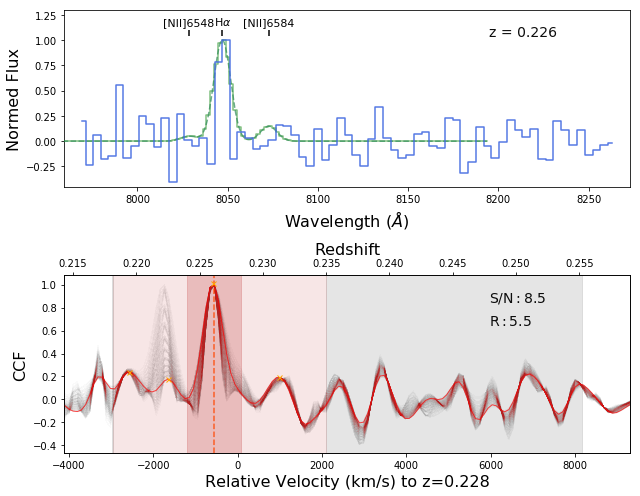

Best z: 0.22415332004147145 Best sigma: 2.1860619443572094
Peak wavl 8032.20092282838
SE Object #1557  z: 0.224  Peak R: 2.235  Detction S/N: 7.694 Peak S/N: 5.441


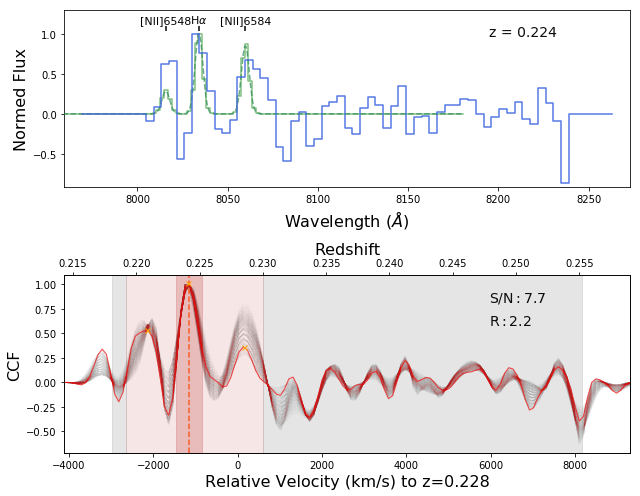

Best z: 0.22487619019713073 Best sigma: 3.241856759062279
Peak wavl 8040.631801364043
SE Object #1565  z: 0.225  Peak R: 4.627  Detction S/N: 18.342 Peak S/N: 12.826


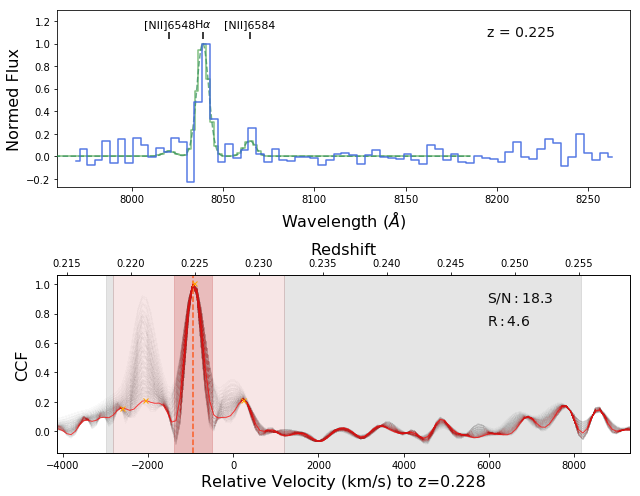

Best z: 0.22218903853319397 Best sigma: 2.537993549258899
Peak wavl 7990.178945898085
SE Object #1631  z: 0.222  Peak R: 1.623  Detction S/N: 8.853 Peak S/N: 4.070


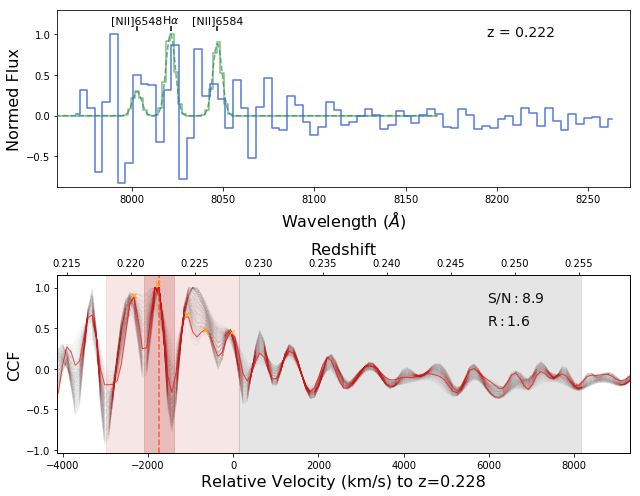

Best z: 0.21991648458103655 Best sigma: 5.0015147835707285
Peak wavl 7981.800968913782
SE Object #1692  z: 0.220  Peak R: 1.423  Detction S/N: 9.241 Peak S/N: 4.155


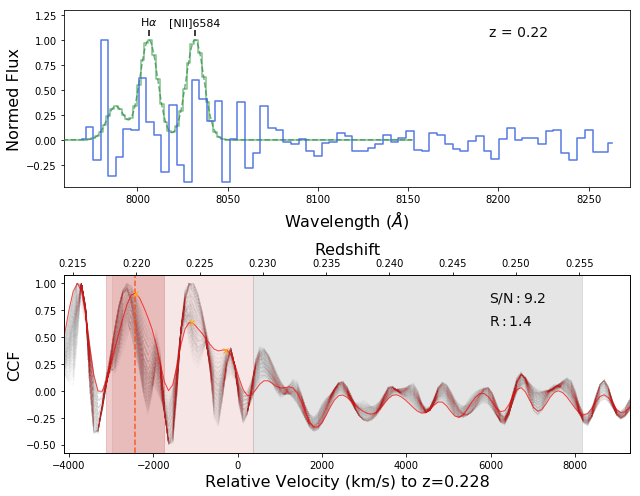

Best z: 0.21991648458103655 Best sigma: 5.0015147835707285
Peak wavl 8002.762402665817
SE Object #1706  z: 0.220  Peak R: 1.519  Detction S/N: 8.280 Peak S/N: 4.879


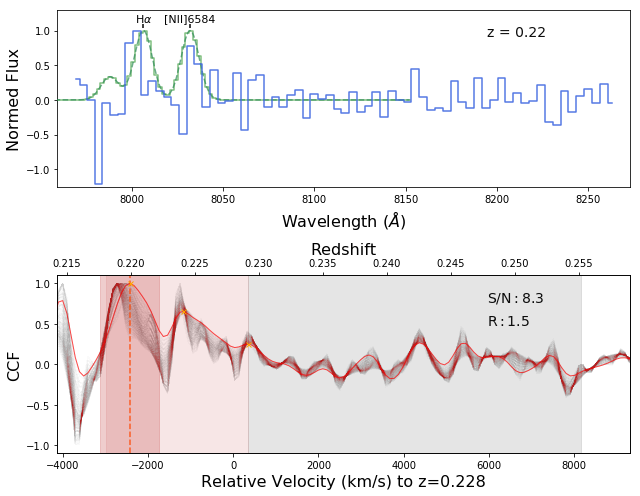

Best z: 0.2258598242896801 Best sigma: 5.0015147835707285
Peak wavl 8044.850558555739
SE Object #1707  z: 0.226  Peak R: 2.057  Detction S/N: 30.948 Peak S/N: 4.307


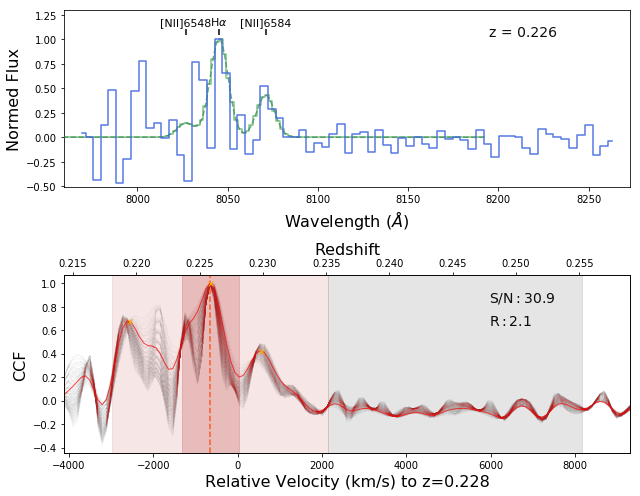

Best z: 0.2196097424852952 Best sigma: 5.0015147835707285
Peak wavl 8032.20092282838
SE Object #1716  z: 0.220  Peak R: 3.105  Detction S/N: 14.110 Peak S/N: 8.986


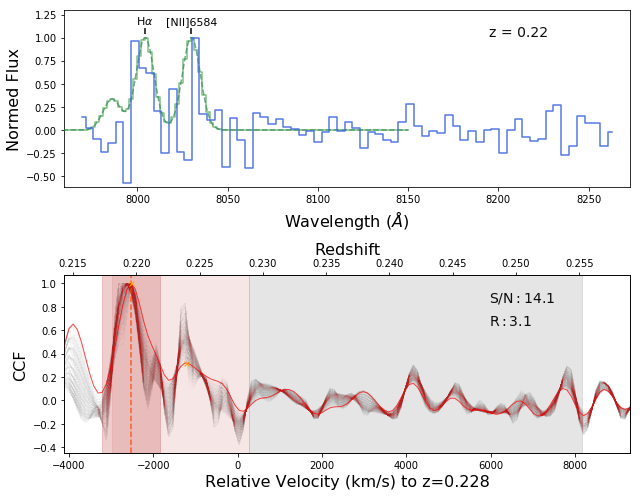

Best z: 0.21991648458103655 Best sigma: 5.0015147835707285
Peak wavl 8032.20092282838
SE Object #1718  z: 0.220  Peak R: 1.255  Detction S/N: 8.616 Peak S/N: 3.552


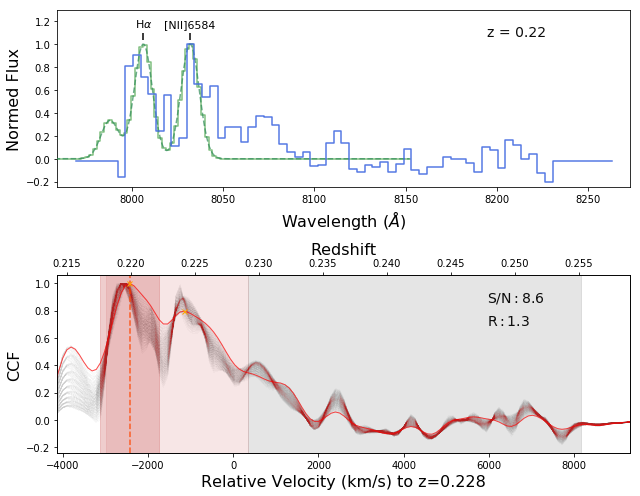

Best z: 0.21928346192064813 Best sigma: 4.6495831786690385
Peak wavl 8002.762402665817
SE Object #1731  z: 0.219  Peak R: 2.890  Detction S/N: 9.186 Peak S/N: 6.738


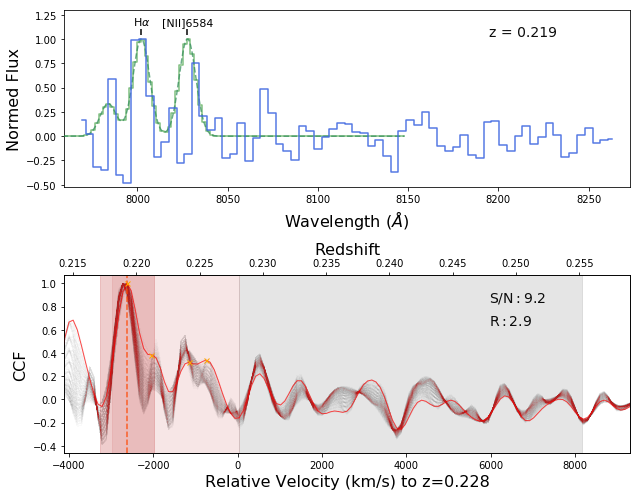

Best z: 0.22389255610458136 Best sigma: 2.537993549258899
Peak wavl 8032.20092282838
SE Object #1733  z: 0.224  Peak R: 2.244  Detction S/N: 7.539 Peak S/N: 3.656


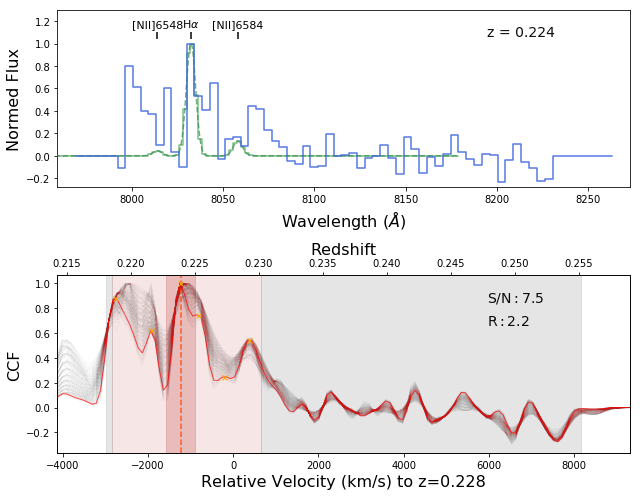

Best z: 0.2186358343274822 Best sigma: 2.1860619443572094
Peak wavl 7998.565716699551
SE Object #1738  z: 0.219  Peak R: 1.898  Detction S/N: 9.609 Peak S/N: 5.865


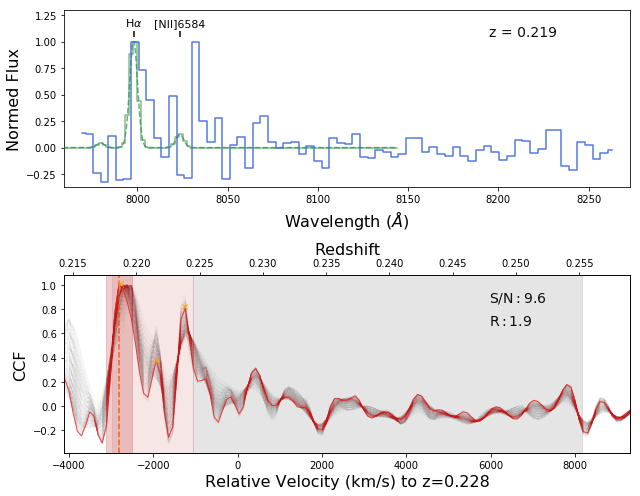

Best z: 0.2196097424852952 Best sigma: 5.0015147835707285
Peak wavl 8032.20092282838
SE Object #1739  z: 0.220  Peak R: 1.475  Detction S/N: 9.130 Peak S/N: 4.190


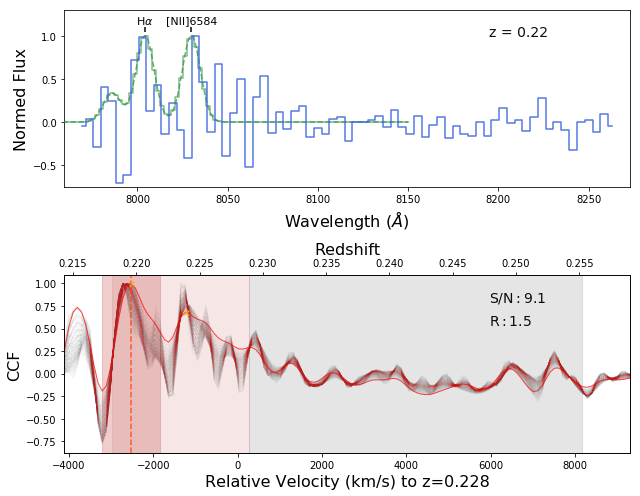

Best z: 0.219962429334306 Best sigma: 5.0015147835707285
Peak wavl 8032.20092282838
SE Object #1742  z: 0.220  Peak R: 1.431  Detction S/N: 12.011 Peak S/N: 4.679


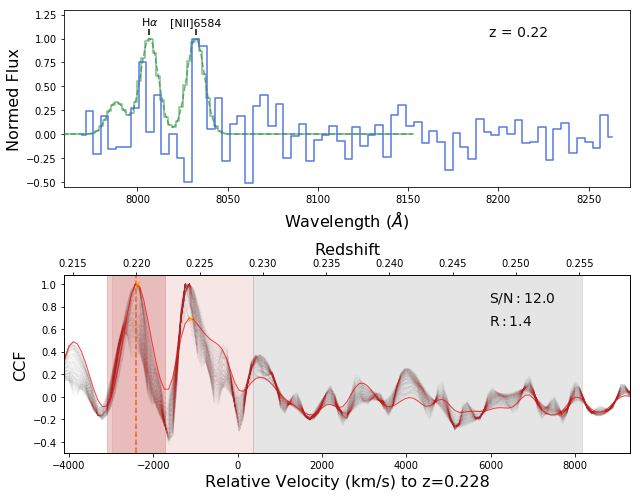

Best z: 0.24913916448001533 Best sigma: 2.889925154160589
Peak wavl 8198.209070566827
SE Object #1746  z: 0.249  Peak R: 3.190  Detction S/N: 9.522 Peak S/N: 8.647


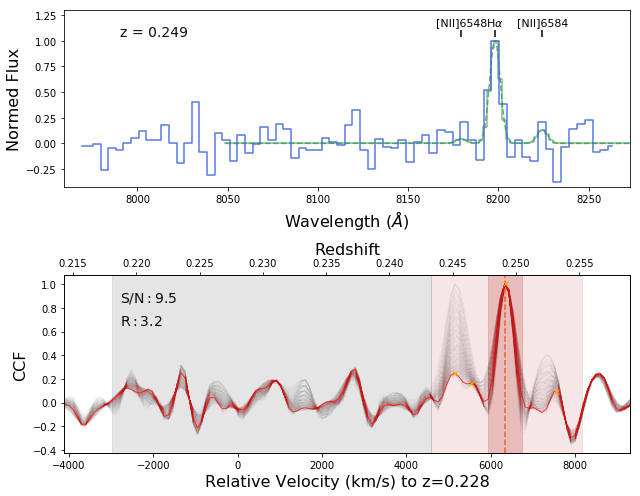

Best z: 0.21928346192064813 Best sigma: 4.297651573767348
Peak wavl 8002.762402665817
SE Object #1752  z: 0.219  Peak R: 1.786  Detction S/N: 10.327 Peak S/N: 5.613


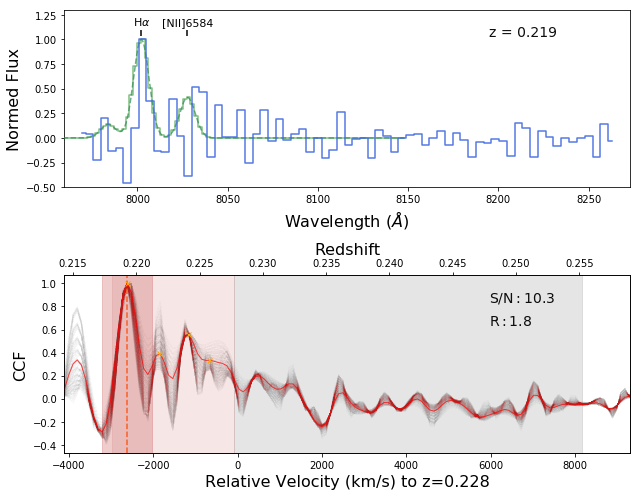

Best z: 0.2189442444581863 Best sigma: 3.945719968865659
Peak wavl 8032.20092282838
SE Object #1753  z: 0.219  Peak R: 3.007  Detction S/N: 9.736 Peak S/N: 5.140


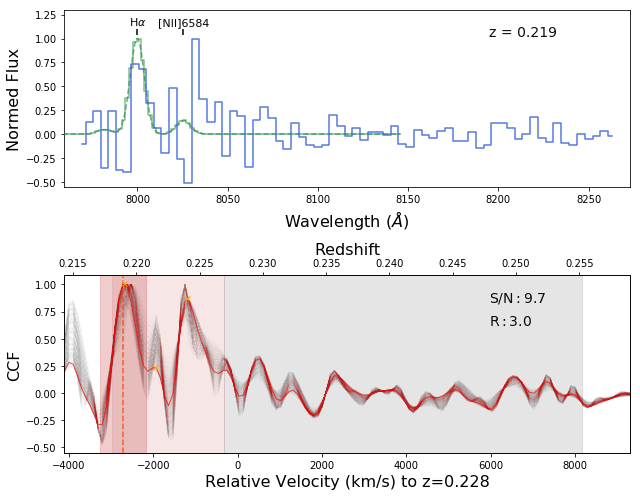

Best z: 0.2196097424852952 Best sigma: 5.0015147835707285
Peak wavl 8032.20092282838
SE Object #1754  z: 0.220  Peak R: 1.665  Detction S/N: 18.583 Peak S/N: 6.483


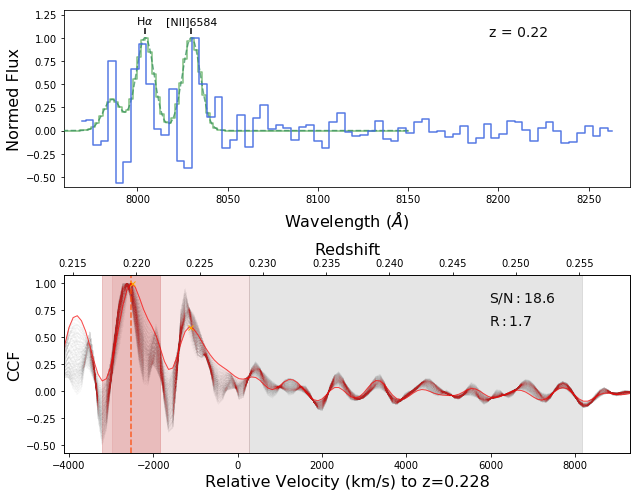

Best z: 0.21928346192064813 Best sigma: 5.0015147835707285
Peak wavl 8002.762402665817
SE Object #1756  z: 0.219  Peak R: 1.767  Detction S/N: 16.588 Peak S/N: 6.524


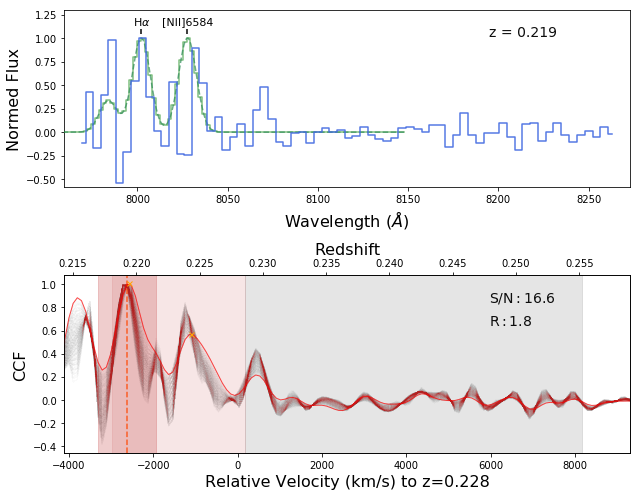

Best z: 0.2202452319137477 Best sigma: 5.0015147835707285
Peak wavl 8032.20092282838
SE Object #1761  z: 0.220  Peak R: 1.713  Detction S/N: 9.383 Peak S/N: 4.775


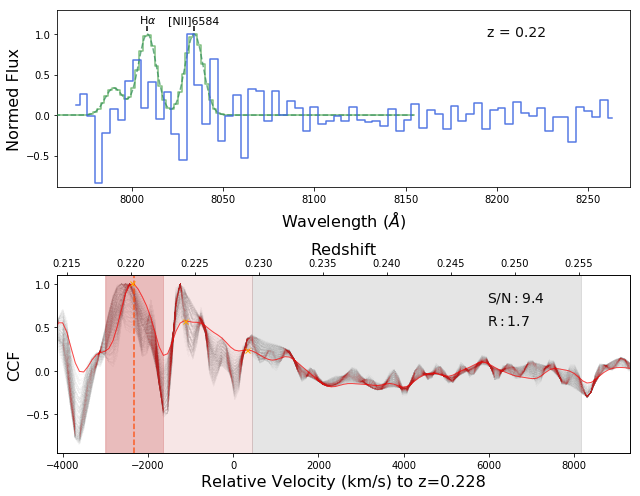

Best z: 0.2254648321648706 Best sigma: 5.0015147835707285
Peak wavl 7981.800968913782
SE Object #1763  z: 0.225  Peak R: 1.597  Detction S/N: 9.512 Peak S/N: 3.490


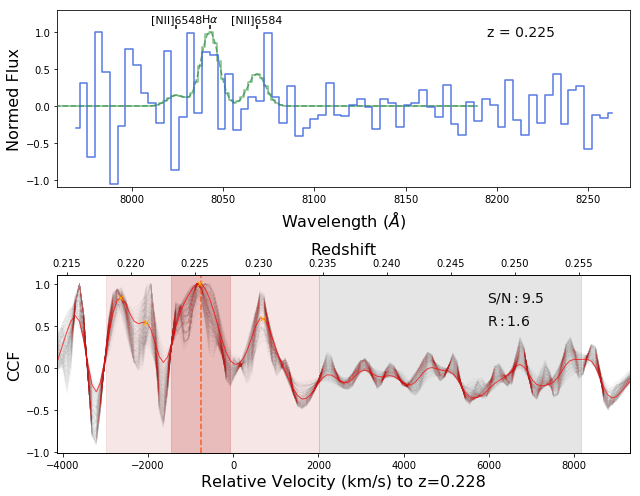

Best z: 0.22059598448342865 Best sigma: 5.0015147835707285
Peak wavl 8032.20092282838
SE Object #1764  z: 0.221  Peak R: 1.202  Detction S/N: 9.150 Peak S/N: 3.418


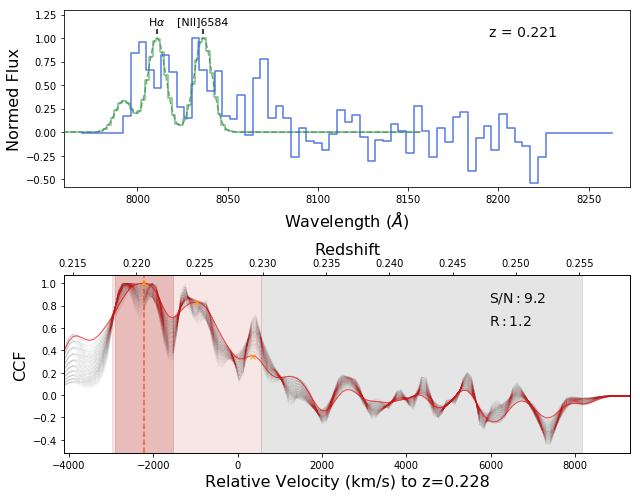

Best z: 0.2265155803513797 Best sigma: 5.0015147835707285
Peak wavl 8053.294714590728
SE Object #1770  z: 0.227  Peak R: 2.310  Detction S/N: 12.945 Peak S/N: 3.944


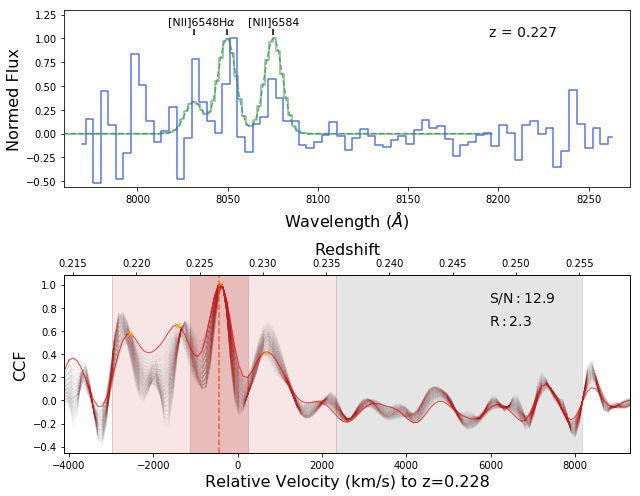

In [16]:
cond = cond0
print(np.sum(cond))
for j, (cc_num) in enumerate(Datacube.cc_nums[cond]):
    ccs, rv, z_ccs, Rs, SNRs, SNR_ps, flage = Datacube.cross_correlation(cc_num, 
                                                                             temp_type="Ha-NII", temp_model="gauss")
    plt.savefig("./A2390SE/fig/xcorr_v4/SNa/CC#%d.png"%(cc_num), dpi=100)
    plt.show()
    plt.close()

22


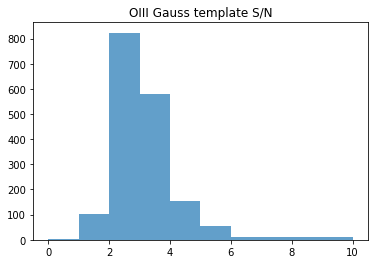

In [17]:
# Gaussian library Hb template (New CC method)
inds_best_Hb = np.argmax(Datacube.CC_Rs_Temps['Hb-OIII_gauss'], axis=1)
SNR_best_Hb = np.array([Datacube.CC_SNRs_Temps['Hb-OIII_gauss'][i,j] for i,j in enumerate(inds_best_Hb)])

plt.hist(SNR_best_Hb,range=[0,10],bins=np.array([0,1,2,3,4,5,6,7,8,10]),alpha=0.7)
plt.title("OIII Gauss template S/N")

cond_b = (SNR_best_Hb>5) & (SNR_best_Hb>SNR_best_Ha) & (SNR_best_OII>3) & (dist_edge>5) & (~star_cond) & (flage==0) 

print(np.sum(cond_b))

22
S/N Ha: 5.019500158290358
Best z: 0.6158288288184304 Best sigma: 4.297651573767348
Peak wavl 8091.403234253834
SE Object #56  z: 0.616  Peak R: 1.000  Detction S/N: 5.266 Peak S/N: 5.266


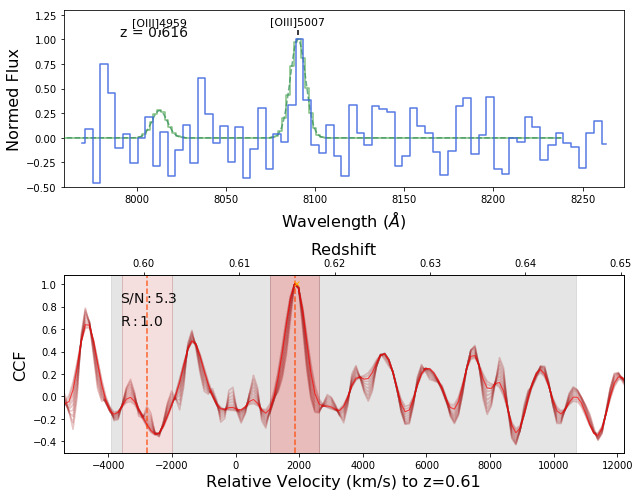

S/N Ha: 5.3353110160627315
Best z: 0.5990547600472889 Best sigma: 5.0015147835707285
Peak wavl 8006.961290548477
SE Object #208  z: 0.599  Peak R: 3.393  Detction S/N: 5.249 Peak S/N: 5.249


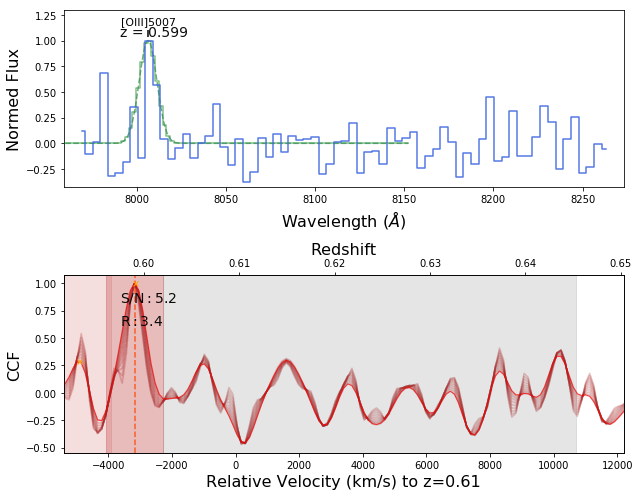

S/N Ha: 4.907177727912061
Best z: 0.6214158521286107 Best sigma: 5.0015147835707285
Peak wavl 8006.961290548477
SE Object #222  z: 0.621  Peak R: 2.014  Detction S/N: 6.941 Peak S/N: 6.941


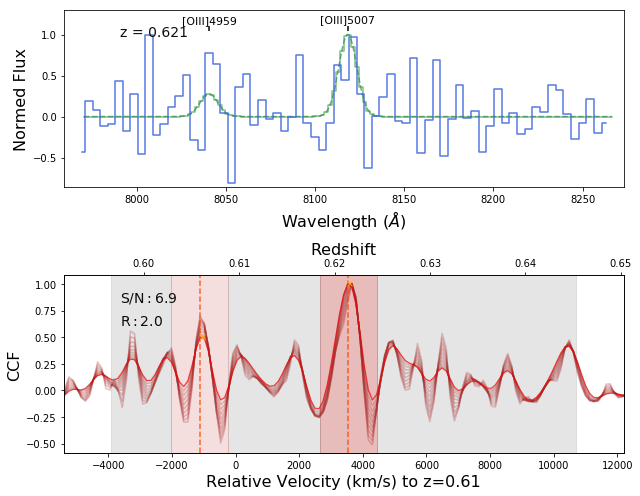

S/N Ha: 5.125368994242896
Best z: 0.6205563100808907 Best sigma: 3.241856759062279
Peak wavl 8112.652500367617
SE Object #236  z: 0.621  Peak R: 1.889  Detction S/N: 6.555 Peak S/N: 6.555


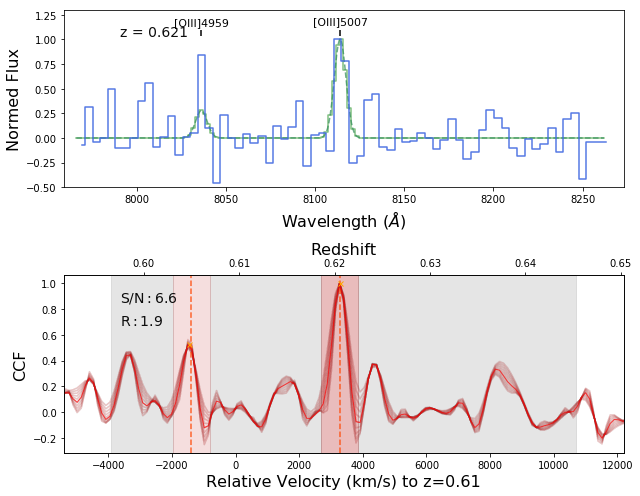

S/N Ha: 3.4202907935396247
Best z: 0.6205563100808907 Best sigma: 2.537993549258899
Peak wavl 8112.652500367617
SE Object #351  z: 0.621  Peak R: 1.743  Detction S/N: 5.031 Peak S/N: 5.031


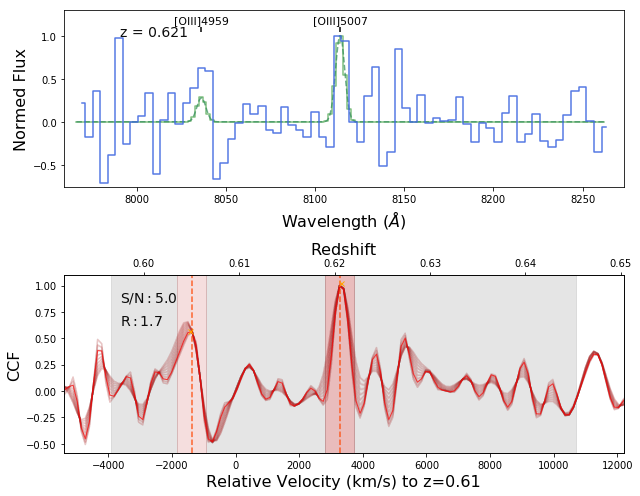

S/N Ha: 8.293154376725752
Best z: 0.6338792118205517 Best sigma: 2.1860619443572094
Peak wavl 8181.025876450399
SE Object #533  z: 0.634  Peak R: 2.235  Detction S/N: 10.055 Peak S/N: 10.055


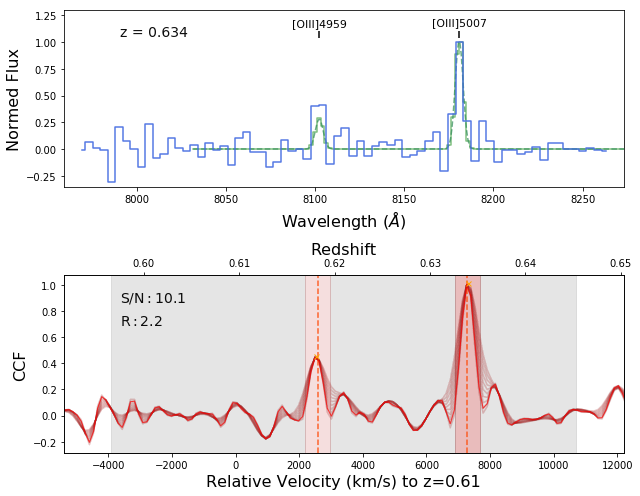

S/N Ha: 5.104112057012672
Best z: 0.6312334715834319 Best sigma: 5.0015147835707285
Peak wavl 8168.162120130756
SE Object #539  z: 0.631  Peak R: 4.731  Detction S/N: 5.498 Peak S/N: 5.498


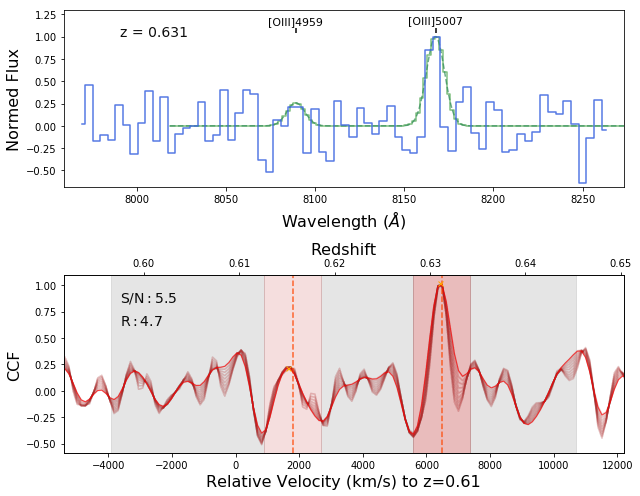

S/N Ha: 4.0920742073749485
Best z: 0.6093822634605298 Best sigma: 5.0015147835707285
Peak wavl 7981.800968913782
SE Object #564  z: 0.609  Peak R: 1.000  Detction S/N: 6.458 Peak S/N: 6.458


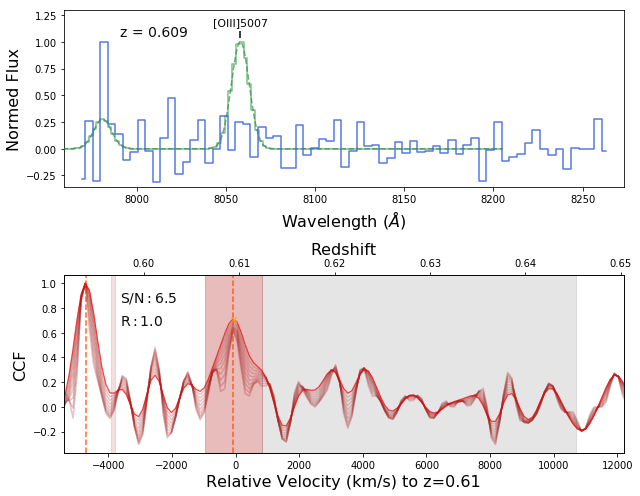

S/N Ha: 4.2904302026442
Best z: 0.5968624415689006 Best sigma: 3.5937883639639687
Peak wavl 7994.3712314950135
SE Object #614  z: 0.597  Peak R: 3.125  Detction S/N: 5.294 Peak S/N: 5.294


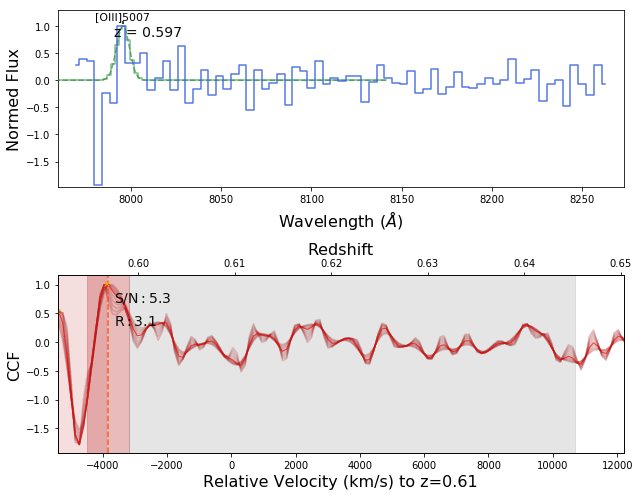

S/N Ha: 7.445862895873516
Best z: 0.6093822634605298 Best sigma: 1.8341303394555193
Peak wavl 7981.800968913782
SE Object #705  z: 0.609  Peak R: 2.205  Detction S/N: 7.358 Peak S/N: 7.358


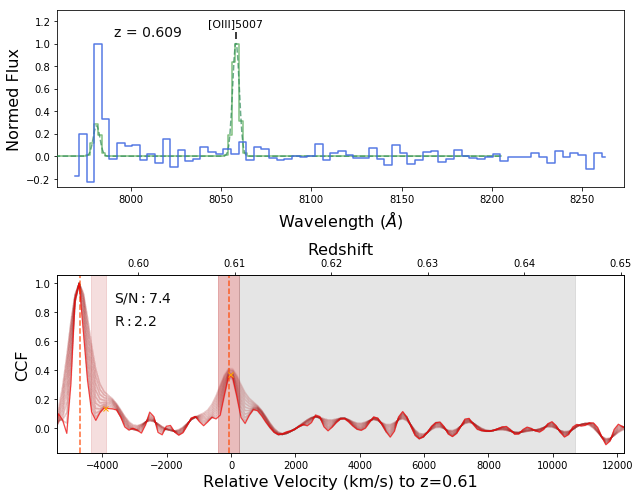

S/N Ha: 6.380108975610015
Best z: 0.6363907238697523 Best sigma: 2.1860619443572094
Peak wavl 8193.90989145545
SE Object #841  z: 0.636  Peak R: 3.056  Detction S/N: 6.600 Peak S/N: 6.600


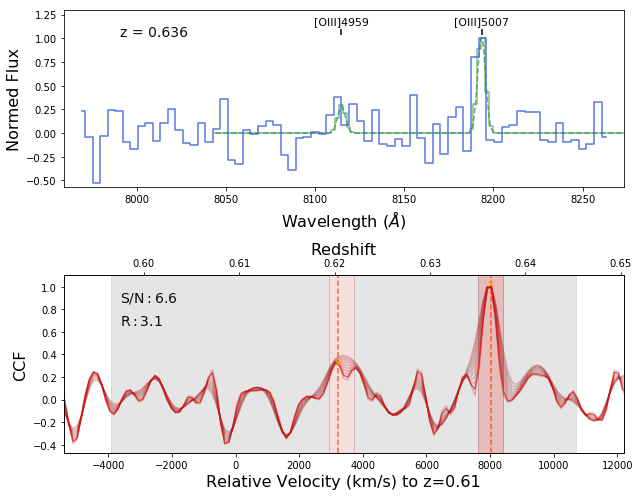

S/N Ha: 5.800101161893933
Best z: 0.644179399175149 Best sigma: 3.5937883639639687
Peak wavl 8232.683807881298
SE Object #847  z: 0.644  Peak R: 4.305  Detction S/N: 5.909 Peak S/N: 5.909


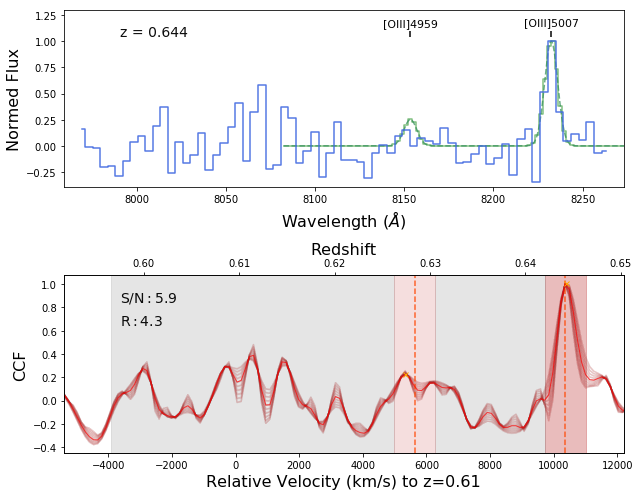

S/N Ha: 4.186413777852262
Best z: 0.6072334083412296 Best sigma: 1.8341303394555193
Peak wavl 8049.071529244185
SE Object #871  z: 0.607  Peak R: 1.000  Detction S/N: 5.115 Peak S/N: 5.115


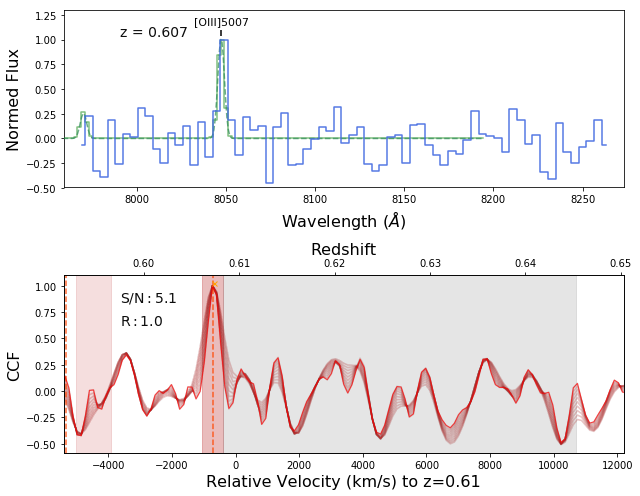

S/N Ha: 5.097175336198528
Best z: 0.6437493157694951 Best sigma: 3.5937883639639687
Peak wavl 8232.683807881298
SE Object #988  z: 0.644  Peak R: 2.862  Detction S/N: 5.477 Peak S/N: 5.477


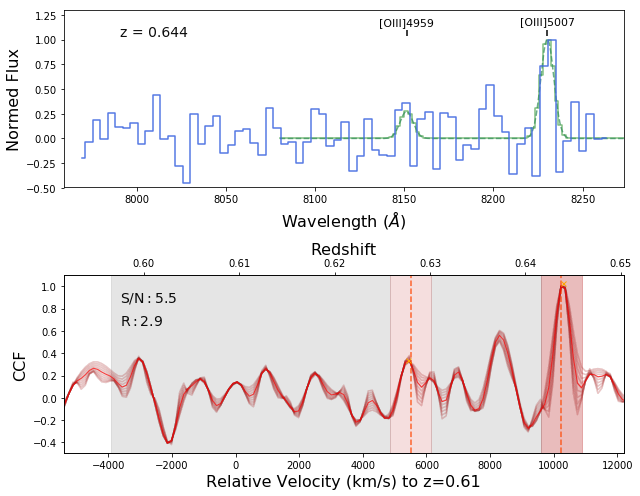

S/N Ha: 14.637839707556394
Best z: 0.6136799736991302 Best sigma: 2.889925154160589
Peak wavl 8078.680399604328
SE Object #1029  z: 0.614  Peak R: 1.000  Detction S/N: 15.103 Peak S/N: 15.103


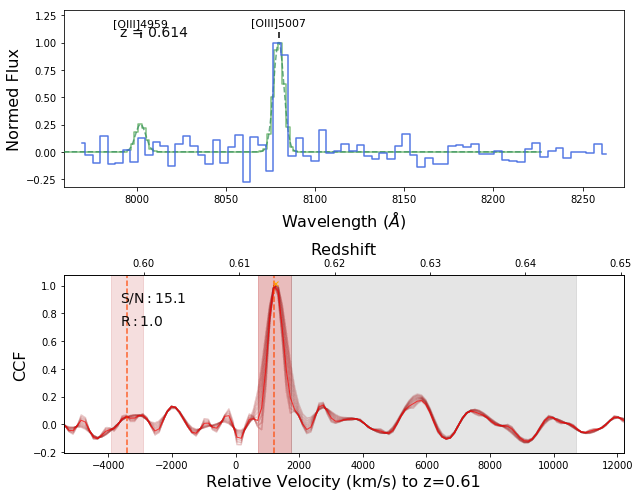

S/N Ha: 4.473960828284827
Best z: 0.6286548454402716 Best sigma: 4.6495831786690385
Peak wavl 8155.318590641972
SE Object #1107  z: 0.629  Peak R: 2.845  Detction S/N: 5.582 Peak S/N: 5.582


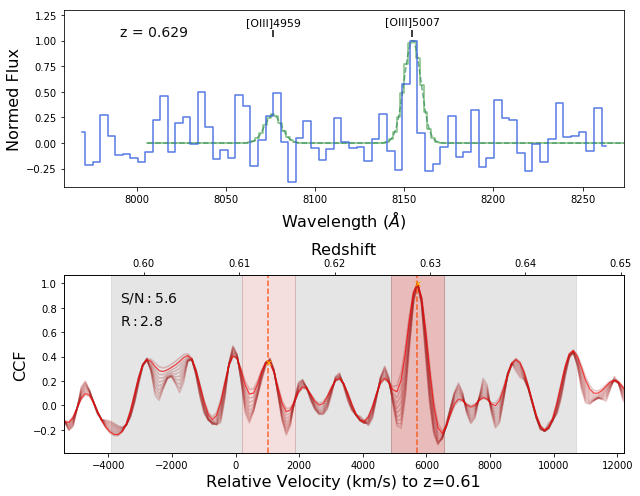

S/N Ha: 5.191596704988183
Best z: 0.6161914857483307 Best sigma: 4.6495831786690385
Peak wavl 8095.648630191456
SE Object #1120  z: 0.616  Peak R: 4.246  Detction S/N: 5.764 Peak S/N: 5.764


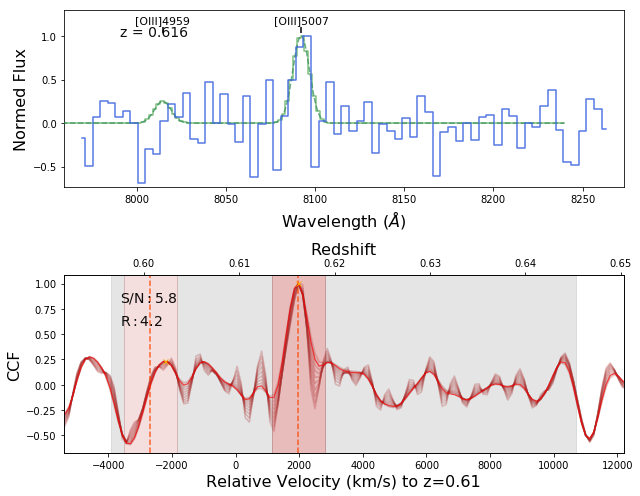

S/N Ha: 6.157597684126503
Best z: 0.6287219595342313 Best sigma: 5.0015147835707285
Peak wavl 8155.318590641972
SE Object #1149  z: 0.629  Peak R: 2.402  Detction S/N: 8.054 Peak S/N: 8.054


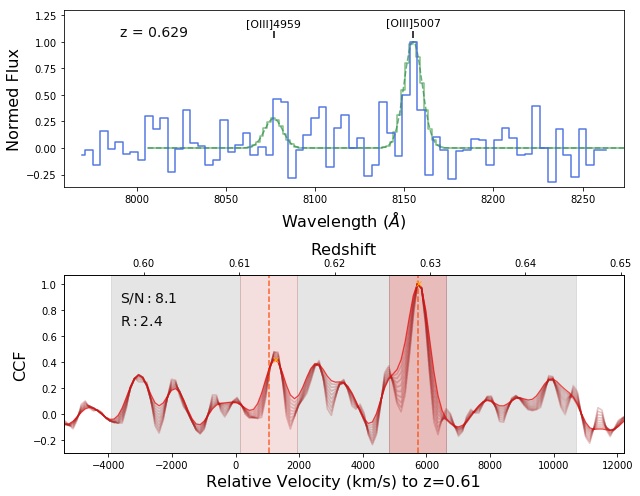

S/N Ha: 4.787120737612364
Best z: 0.5986319656603026 Best sigma: 1.8341303394555193
Peak wavl 8006.961290548477
SE Object #1368  z: 0.599  Peak R: 4.893  Detction S/N: 4.766 Peak S/N: 4.766


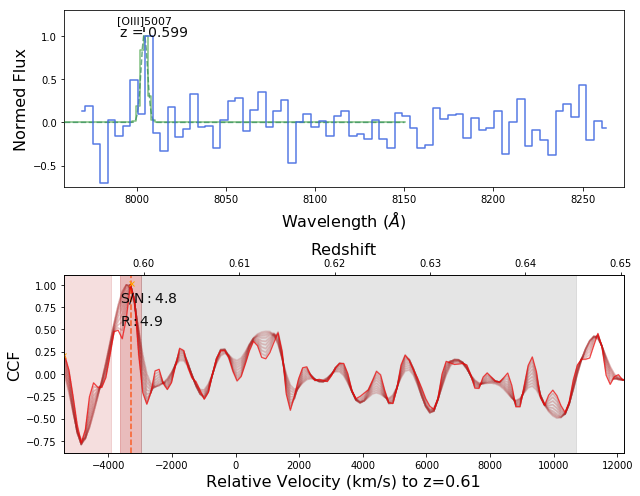

S/N Ha: 5.682559739189299
Best z: 0.6428502880682528 Best sigma: 5.0015147835707285
Peak wavl 8224.051556222292
SE Object #1571  z: 0.643  Peak R: 2.773  Detction S/N: 6.532 Peak S/N: 6.532


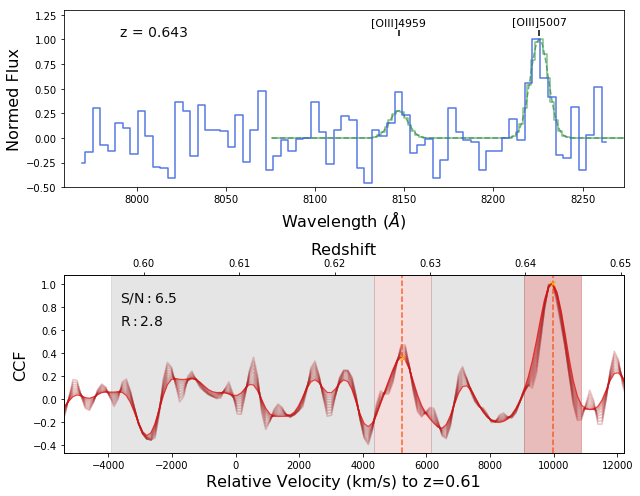

S/N Ha: 7.7397198482092024
Best z: 0.6313005856773916 Best sigma: 2.1860619443572094
Peak wavl 8168.162120130756
SE Object #1712  z: 0.631  Peak R: 2.070  Detction S/N: 9.519 Peak S/N: 9.519


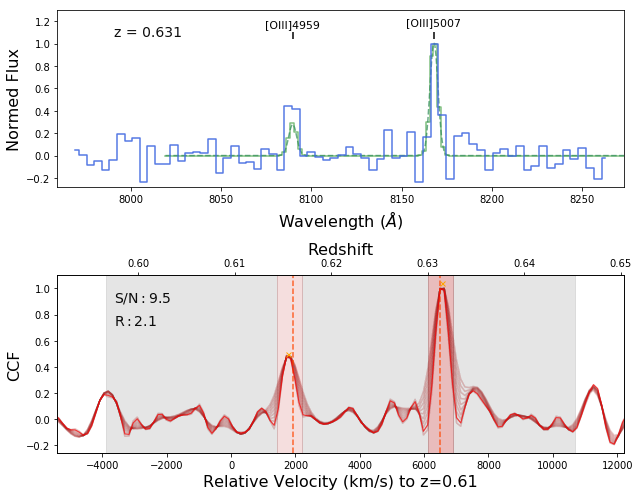

S/N Ha: 9.4176025982926
Best z: 0.637317380011432 Best sigma: 4.6495831786690385
Peak wavl 8198.209070566827
SE Object #1746  z: 0.637  Peak R: 4.705  Detction S/N: 9.348 Peak S/N: 9.348


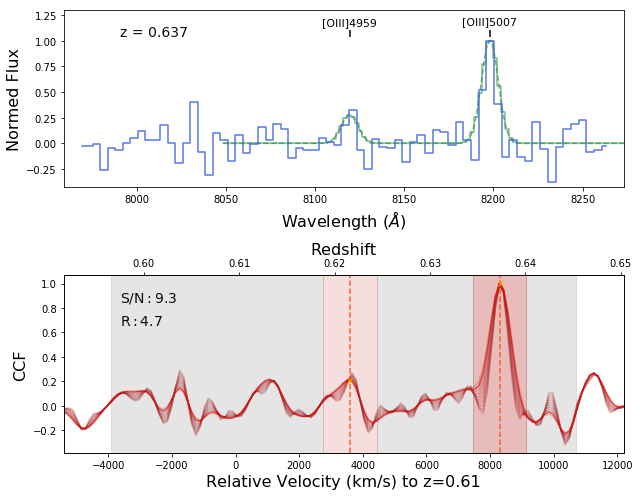

In [18]:
cond = cond_b
print(np.sum(cond))
for j, (cc_num) in enumerate(np.int64(Datacube.cc_nums[cond])):
    print("S/N Ha:",SNR_best_Ha[cc_num-1])
    ccs, rv, z_ccs, Rs, SNRs, SNR_ps, flage = Datacube.cross_correlation(cc_num,
                                                                            temp_type="Hb-OIII", temp_model="gauss")
    plt.savefig("./A2390SE/fig/xcorr_v4/SNc/CC#%d.png"%(cc_num), dpi=100)
    plt.show()
    plt.close()

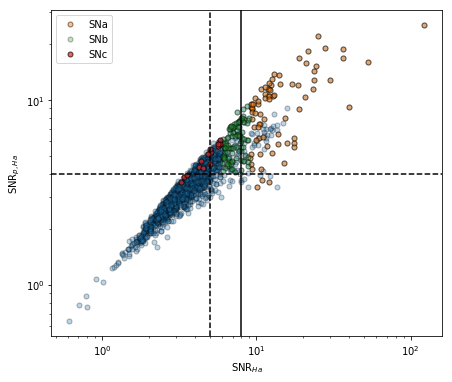

In [27]:
# Ha + Hb
plt.figure(figsize=(7,6))
plt.loglog(SNR_best_Ha, SNRp_best_Ha, ".", ms=10, mec='k', alpha=0.3)
plt.loglog(SNR_best_Ha[cond0], SNRp_best_Ha[cond0], ".", mec='k', ms=10, alpha=0.5, label="SNa")
plt.loglog(SNR_best_Ha[cond2], SNRp_best_Ha[cond2], ".", mec='k', ms=10, alpha=0.3, label="SNb")
plt.loglog(SNR_best_Ha[cond_b], SNRp_best_Ha[cond_b], ".", mec='k', ms=10, alpha=0.7, label="SNc")
plt.axvline(6, ls='-', color='k')
plt.axvline(5, ls='--', color='k')
plt.axhline(4, ls='--', color='k')
plt.xlabel("SNR$_{Ha}$")
plt.ylabel("SNR$_{p,Ha}$")
plt.legend(loc=2)

In [19]:
#Composite 
import re
import glob
el_ls = glob.glob("./A2390SE/fig/xcorr_v4/SNa/*.png")
for el in el_ls:
    img_cc = plt.imread(el)
    ind = re.compile(r'\d+').findall(el)[-1]
    img_confit = plt.imread("./A2390SE/fig/fit_cont_v2/SE#%s.png"%ind)
    img_spec = plt.imread("./A2390SE/fig/spec_v2/SE#%s.png"%ind)
    img_thumb = plt.imread("./A2390SE/fig/img_thumb_v2/SE#%s.png"%ind)
    plt.figure(figsize=(16,12))
    ax1 = plt.subplot2grid((3, 3), (0, 0), rowspan=1, colspan=2)
    ax2 = plt.subplot2grid((3, 3), (1, 0), rowspan=2, colspan=2)
    ax3 = plt.subplot2grid((3, 3), (0, 2), rowspan=1, colspan=1)
    ax4 = plt.subplot2grid((3, 3), (1, 2), rowspan=1, colspan=1)
    ax1.imshow(img_confit)
    ax2.imshow(img_cc)
    ax3.imshow(img_spec)
    ax4.imshow(img_thumb)
    for ax in (ax1,ax2,ax3,ax4):
        ax.axis("off")
#     plt.suptitle("Flag: 1",fontsize=18)
    plt.tight_layout()
    plt.savefig("./A2390SE/fig/candidate_v4/SNa/#EL-%s.png"%ind,dpi=100)
    plt.close()

In [20]:
#Composite 
import re
import glob
el_ls = glob.glob("./A2390SE/fig/xcorr_v4/SNb/*.png")
for el in el_ls:
    img_cc = plt.imread(el)
    ind = re.compile(r'\d+').findall(el)[-1]
    img_confit = plt.imread("./A2390SE/fig/fit_cont_v2/SE#%s.png"%ind)
    img_spec = plt.imread("./A2390SE/fig/spec_v2/SE#%s.png"%ind)
    img_thumb = plt.imread("./A2390SE/fig/img_thumb_v2/SE#%s.png"%ind)
    plt.figure(figsize=(16,12))
    ax1 = plt.subplot2grid((3, 3), (0, 0), rowspan=1, colspan=2)
    ax2 = plt.subplot2grid((3, 3), (1, 0), rowspan=2, colspan=2)
    ax3 = plt.subplot2grid((3, 3), (0, 2), rowspan=1, colspan=1)
    ax4 = plt.subplot2grid((3, 3), (1, 2), rowspan=1, colspan=1)
    ax1.imshow(img_confit)
    ax2.imshow(img_cc)
    ax3.imshow(img_spec)
    ax4.imshow(img_thumb)
    for ax in (ax1,ax2,ax3,ax4):
        ax.axis("off")
#     plt.suptitle("Flag: 1",fontsize=18)
    plt.tight_layout()
    plt.savefig("./A2390SE/fig/candidate_v4/SNb/#EL-%s.png"%ind,dpi=100)
    plt.close()

In [21]:
#Composite 
import re
import glob
el_ls = glob.glob("./A2390SE/fig/xcorr_v4/SNc/*.png")
for el in el_ls:
    img_cc = plt.imread(el)
    ind = re.compile(r'\d+').findall(el)[-1]
    img_confit = plt.imread("./A2390SE/fig/fit_cont_v2/SE#%s.png"%ind)
    img_spec = plt.imread("./A2390SE/fig/spec_v2/SE#%s.png"%ind)
    img_thumb = plt.imread("./A2390SE/fig/img_thumb_v2/SE#%s.png"%ind)
    plt.figure(figsize=(16,12))
    ax1 = plt.subplot2grid((3, 3), (0, 0), rowspan=1, colspan=2)
    ax2 = plt.subplot2grid((3, 3), (1, 0), rowspan=2, colspan=2)
    ax3 = plt.subplot2grid((3, 3), (0, 2), rowspan=1, colspan=1)
    ax4 = plt.subplot2grid((3, 3), (1, 2), rowspan=1, colspan=1)
    ax1.imshow(img_confit)
    ax2.imshow(img_cc)
    ax3.imshow(img_spec)
    ax4.imshow(img_thumb)
    for ax in (ax1,ax2,ax3,ax4):
        ax.axis("off")
#     plt.suptitle("Flag: 1",fontsize=18)
    plt.tight_layout()
    plt.savefig("./A2390SE/fig/candidate_v4/SNc/#EL-%s.png"%ind,dpi=100)
    plt.close()

## 5. Centroid Analysis

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from astropy.io import fits
import glob
import re
import warnings
warnings.filterwarnings('ignore')
from pipeline import *
from utils import *

Datacube = Read_Datacube("/home/qliu/data/A2390F/A2390SE_cube_v2.fits", name="A390SE", z0=0.228, 
                         SE_catalog="./A2390SE/SE_v2//A2390SE_run2.cat")
                         #deep_frame='/home/qliu/data/A2390F/A2390SE_deep.fits')
Datacube.read_mask('/home/qliu/data/A2390F/Raw_stack_A2390SE_mask.fits')
Datacube.read_seg('./A2390SE/SE_v2//segment_run2.fits')
Datacube.read_spec('./A2390SE/A2390SE-spec_v3.fits')

Datacube.generate_template(n_ratio=8, n_stddev=10, n_intp=2,
                           temp_type="OII", ratio_prior="uniform", temp_model='gauss')
Datacube.read_cc('./A2390SE/A2390SE-cc_OII_gauss_v4.fits')

Datacube.generate_template(n_ratio=8, n_stddev=10, n_intp=2, ratio_range = (2., 4.),
                           temp_type="Hb-OIII", ratio_prior="uniform", temp_model='gauss')
Datacube.read_cc('./A2390SE/A2390SE-cc_Hb-OIII_gauss_v4.fits')
el_ls_b = glob.glob("./A2390SE/fig/candidate_v4//SNc/#*.png")
Num_b = np.sort(np.array([re.compile(r'\d+').findall(el)[-1] for el in el_ls_b]).astype("int"))
z_b = Datacube.z_best[Num_b-1]

Datacube.generate_template(n_ratio=50, n_stddev=10, n_intp=2, ratio_range = (1., 8),
                           temp_type="Ha-NII", ratio_prior="uniform", temp_model='gauss')
Datacube.read_cc('./A2390SE/A2390SE-cc_Ha-NII_gauss_v4.fits')

# el_ls_v = glob.glob("./A2390SE/fig/candidate_v3/visual/#*.png")
el_ls_v = glob.glob("./A2390SE/fig/candidate_v4/visual/**/*.png", recursive=True)
Num_v = np.sort(np.array([re.compile(r'\d+').findall(el)[-1] for el in el_ls_v]).astype("int"))
ind_v = Num_v-1
print(Num_v)

Datacube.z_best[Num_b-1] = z_b

w = WCS(Datacube.hdu[0].header, naxis=2)
Datacube.assign_BCG_coordinate((328.40351201,17.69544013))
X_BCG, Y_BCG = Datacube.wcs.all_world2pix(Datacube.coord_BCG.ra, Datacube.coord_BCG.dec, 1)
Datacube.pos_BCG = (X_BCG, Y_BCG)

Template: OII_gauss  Total Number: 10
Read cross-correlation result... Template:OII_gauss
Template: Hb-OIII_gauss  Total Number: 80
Read cross-correlation result... Template:Hb-OIII_gauss
Template: Ha-NII_gauss  Total Number: 500
Read cross-correlation result... Template:Ha-NII_gauss
[   7   10   11   30   56   64   66   86   89  116  170  192  206  236
  245  251  286  303  349  351  355  381  410  435  443  451  469  516
  520  533  535  539  727  734  756  841  847  988 1028 1029 1107 1126
 1149 1252 1270 1281 1329 1371 1385 1437 1478 1499 1515 1543 1565 1571
 1707 1712 1716 1717 1738 1744 1746 1770]
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to app

In [2]:
for i in range(19):
    print("Catalog %d"%(i+1))
    generate_catalog('./A2390SE/centroid_catalog/centroid_analysis_A2390SE_m2aper_all_weight_med_v9.%d.csv'%(i+1),
                     Datacube, Num_v=Num_v, wcs=w, n_rand=99)

Catalog 1
Measuring Centroids for 64 candidates...
Isophotal area threshold:  10.0
Distance to field edge threshold:  50
Control Sample : n=993
Saving Catalog...
Catalog 2
Measuring Centroids for 64 candidates...
Isophotal area threshold:  10.0
Distance to field edge threshold:  50
Control Sample : n=993
Saving Catalog...
Catalog 3
Measuring Centroids for 64 candidates...
Isophotal area threshold:  10.0
Distance to field edge threshold:  50
Control Sample : n=993
Saving Catalog...
Catalog 4
Measuring Centroids for 64 candidates...
Isophotal area threshold:  10.0
Distance to field edge threshold:  50
Control Sample : n=993
Saving Catalog...
Catalog 5
Measuring Centroids for 64 candidates...
Isophotal area threshold:  10.0
Distance to field edge threshold:  50
Control Sample : n=993
Saving Catalog...
Catalog 6
Measuring Centroids for 64 candidates...
Isophotal area threshold:  10.0
Distance to field edge threshold:  50
Control Sample : n=993
Saving Catalog...
Catalog 7
Measuring Centroid

In [2]:
inds_best_Ha = np.argmax(Datacube.CC_Rs_Temps['Ha-NII_gauss'], axis=1)
SNR_best_Ha = np.array([Datacube.CC_SNRs_Temps['Ha-NII_gauss'][i,j] for i,j in enumerate(inds_best_Ha)])
inds_best_Hb = np.argmax(Datacube.CC_Rs_Temps['Hb-OIII_gauss'], axis=1)
SNR_best_Hb = np.array([Datacube.CC_SNRs_Temps['Hb-OIII_gauss'][i,j] for i,j in enumerate(inds_best_Hb)])

Num_va = np.setdiff1d(Num_v,Num_b)
ind_v = Num_va-1

Num_vp=Num_va[(Datacube.z_best[Num_va-1]<0.24) & (Datacube.z_best[Num_va-1]>0.216)]
ind_v = Num_vp-1
Num_vp

array([   7,   11,   30,   64,   66,   86,   89,  170,  192,  206,  245,
        251,  286,  303,  349,  355,  410,  435,  443,  451,  457,  469,
        516,  520,  535,  727,  734,  736,  756, 1028, 1029, 1126, 1281,
       1371, 1385, 1437, 1478, 1499, 1515, 1565])

54
47
40


Text(0.5,0,'A2390SE Candidate Redshift')

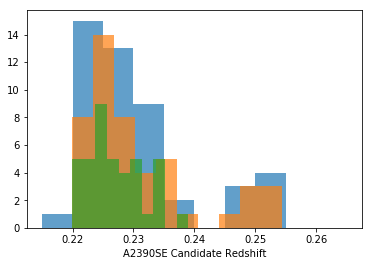

In [4]:
plt.hist(Datacube.z_best[Num_v-1],range=(0.215,0.265),bins=10,alpha=0.7)
plt.hist(Datacube.z_best[Num_va-1],bins=10,alpha=0.7)
plt.hist(Datacube.z_best[Num_vp-1],alpha=0.7)
print(len(Num_v))
print(len(Num_va))
print(len(Num_vp))
plt.xlabel("A2390SE Candidate Redshift")

optimal aperture:2.2
Aper (min,max): (1.54,2.20)


(114.12252272678467, 1.2125914113348493, 2854.350651269351, 0.7754872756718088)

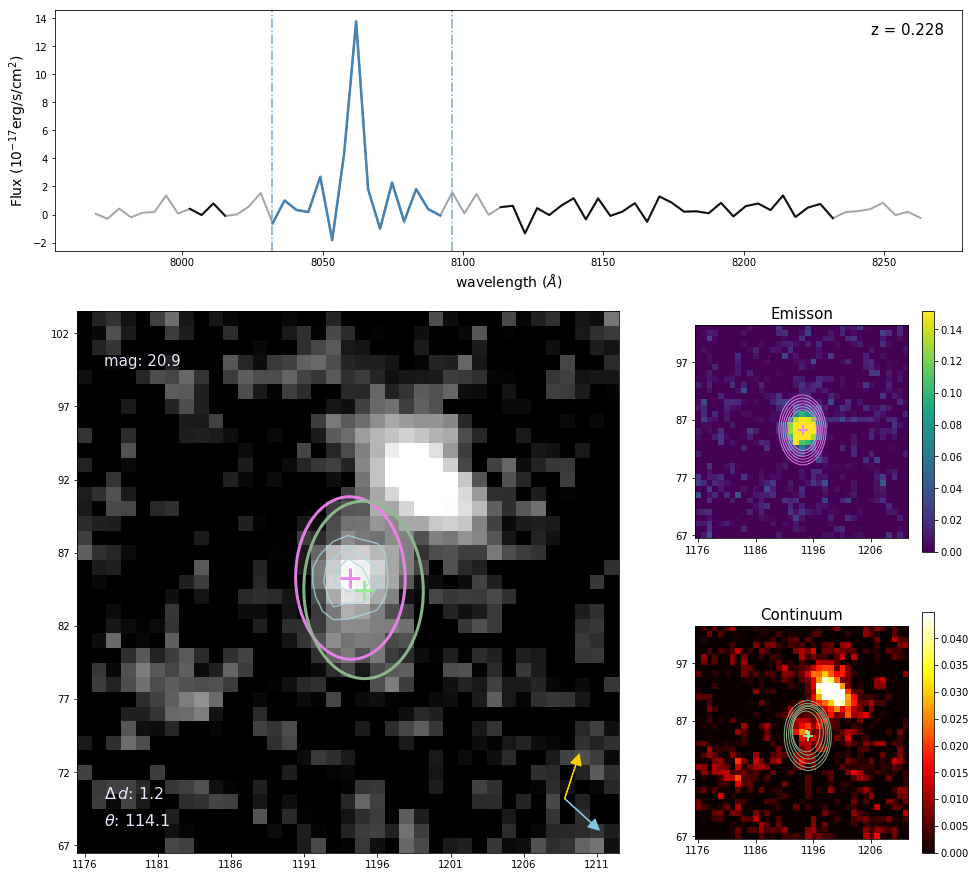

In [5]:
Datacube.centroid_analysis(num=64, centroid_type='APER')

optimal aperture:2.5
Aper (min,max): (1.75,2.50)


(36.86465201235478,
 1.3377769692908668,
 2542.105521023293,
 354.7871695510639,
 317.92251753870914,
 0.42676469296256786)

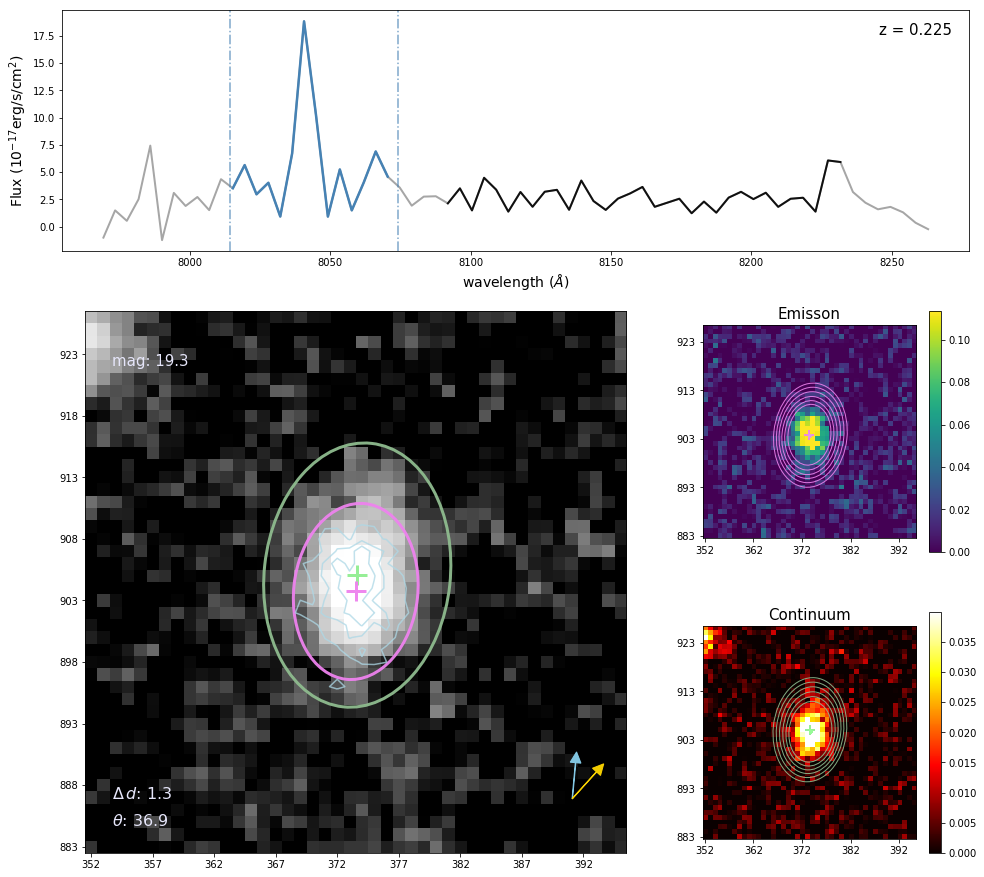

In [10]:
Datacube.centroid_analysis(num=756, centroid_type='APER')

optimal aperture:2.1
Aper (min,max): (1.47,2.10)


(35.49209224818554,
 2.0150283954563335,
 1667.4812915149166,
 345.18368444079397,
 309.6915921926084,
 0.5324174945735488)

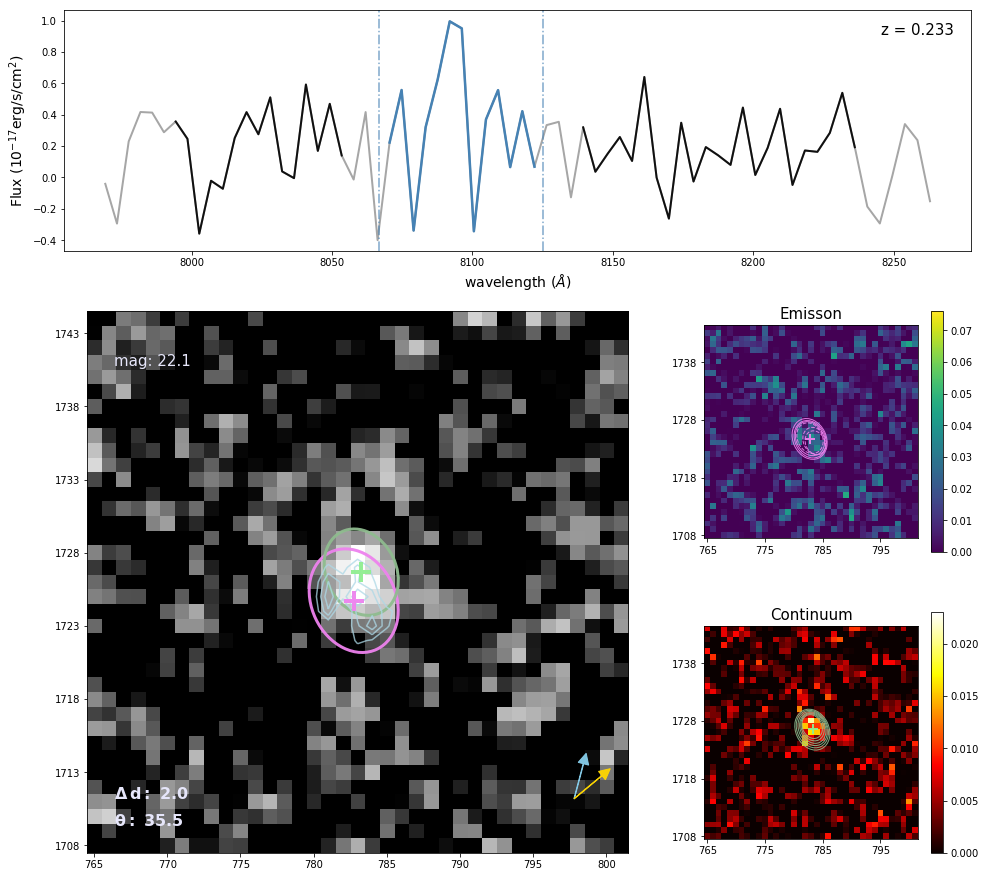

In [3]:
Datacube.centroid_analysis(num=1120, centroid_type='APER')

optimal aperture:2.2
Aper (min,max): (1.54,2.20)


(53.0980271114928,
 0.549523853688226,
 2636.415737609285,
 276.63043762761026,
 329.72846473910306,
 1.306692197507928)

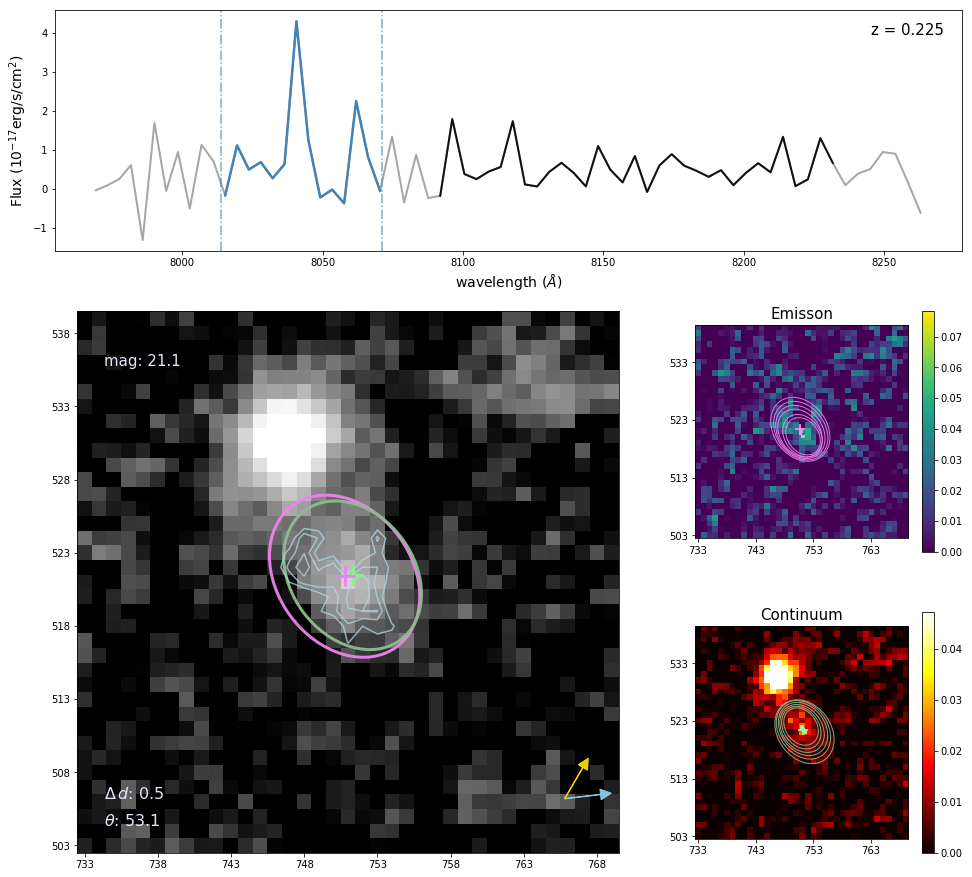

In [11]:
Datacube.centroid_analysis(num=443, centroid_type='APER')

optimal aperture:1.9
Aper (min,max): (1.33,1.90)


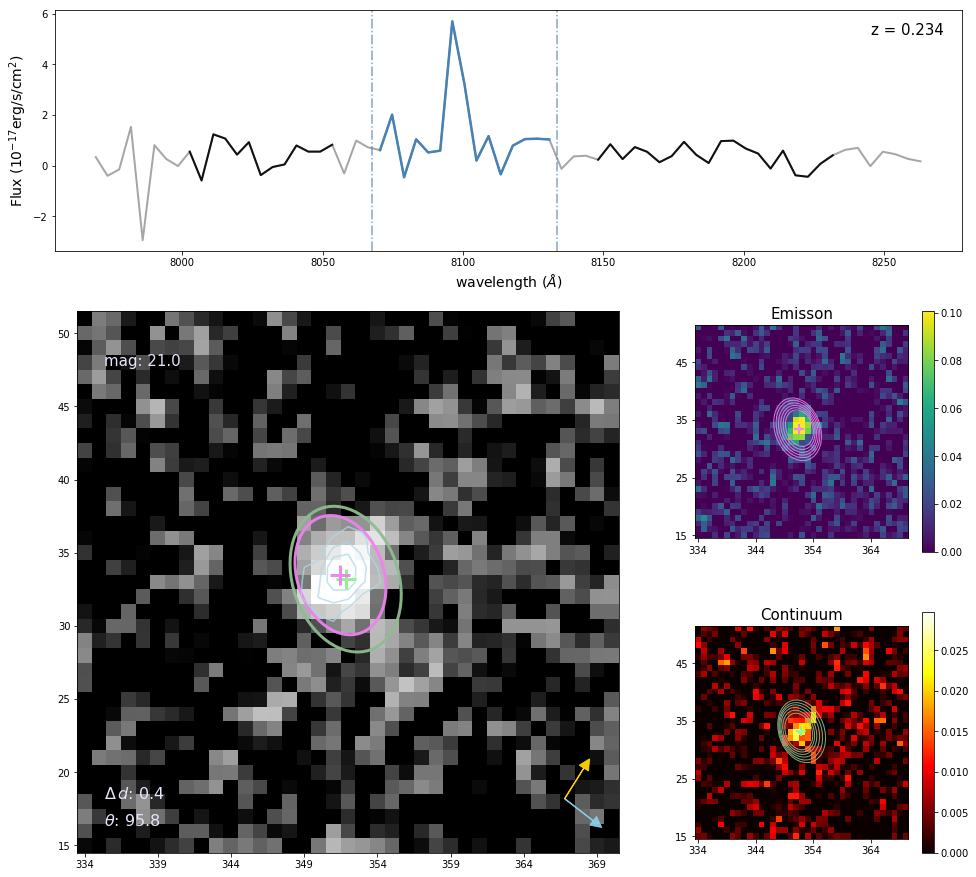

optimal aperture:2.3
Aper (min,max): (1.61,2.30)


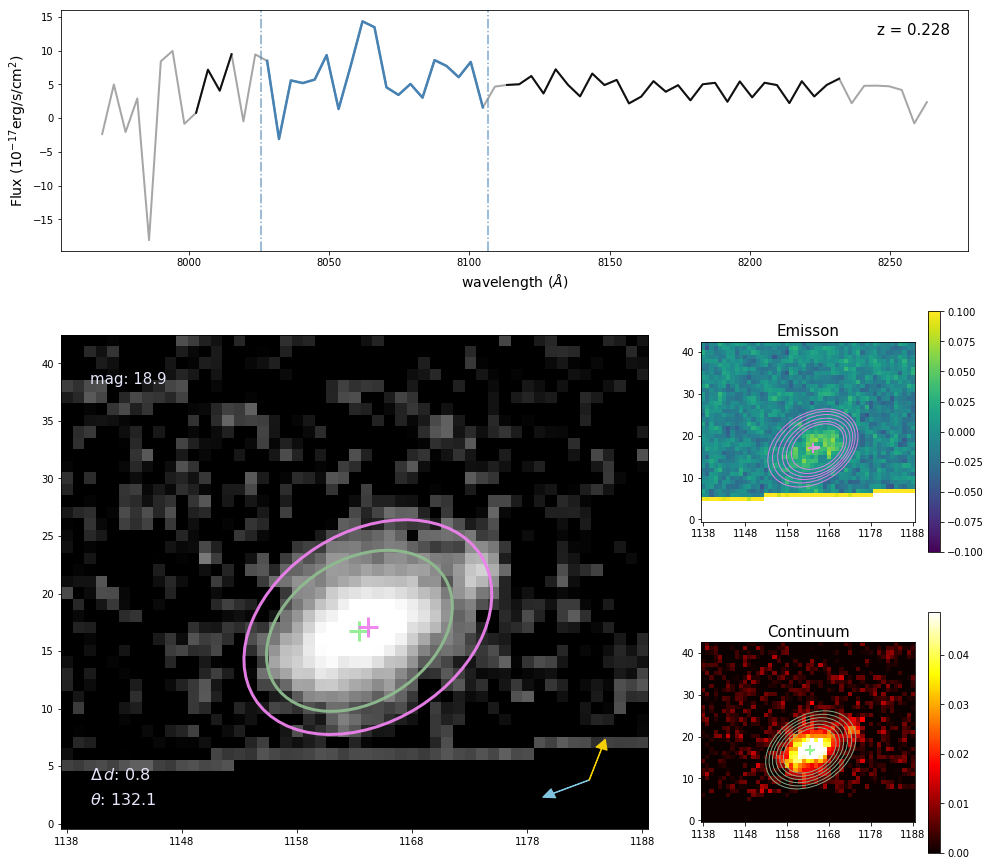

optimal aperture:2.3
Aper (min,max): (1.61,2.30)


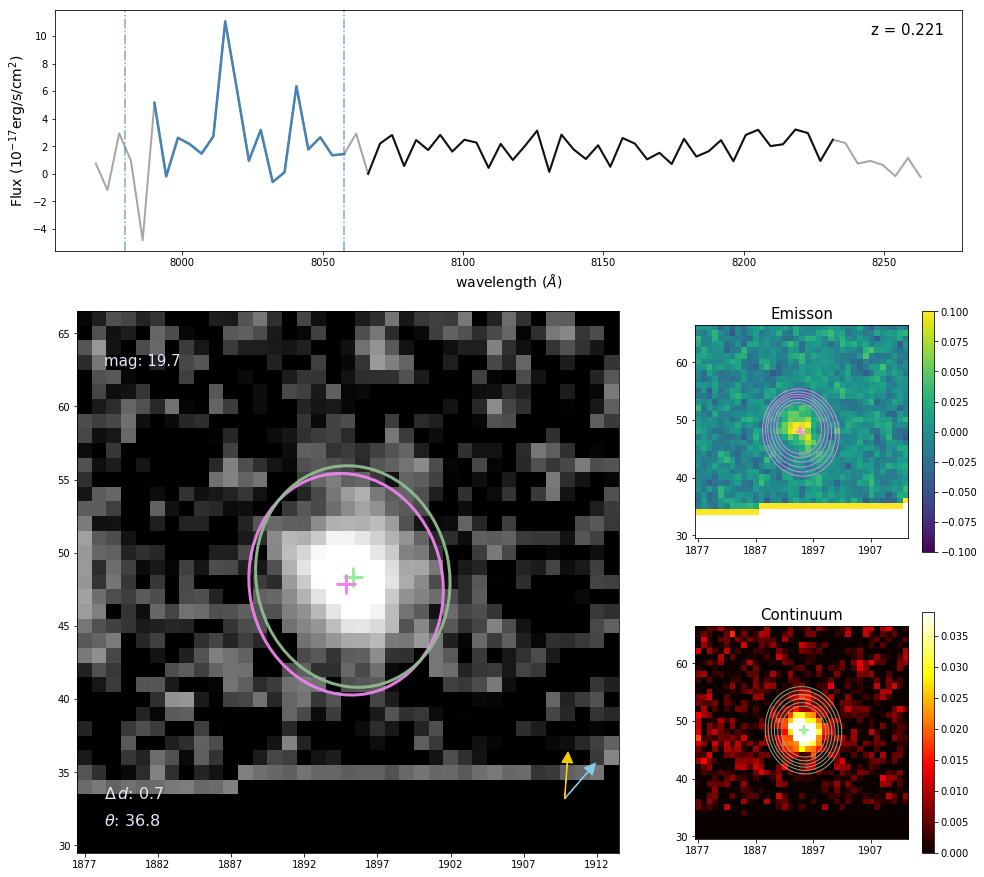

optimal aperture:2.2
Aper (min,max): (1.54,2.20)


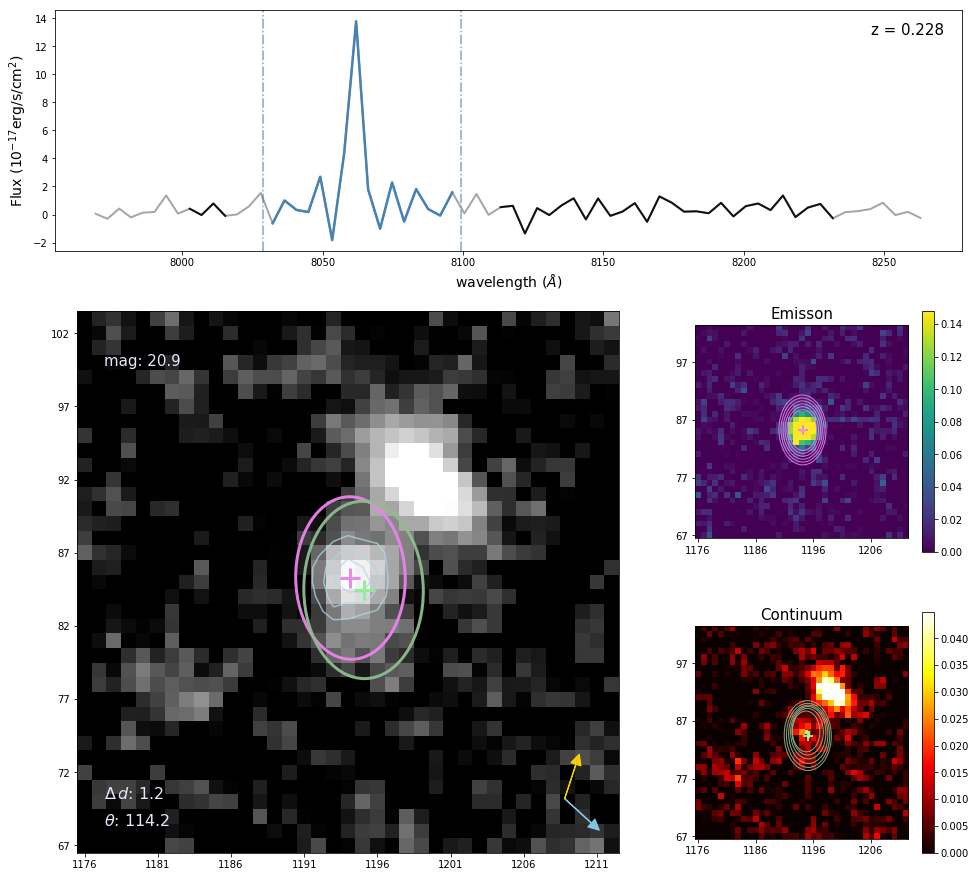

optimal aperture:2.2
Aper (min,max): (1.54,2.20)
Unable to compute centroid! Error raised.


<Figure size 432x288 with 0 Axes>

optimal aperture:2.0
Aper (min,max): (1.40,2.00)


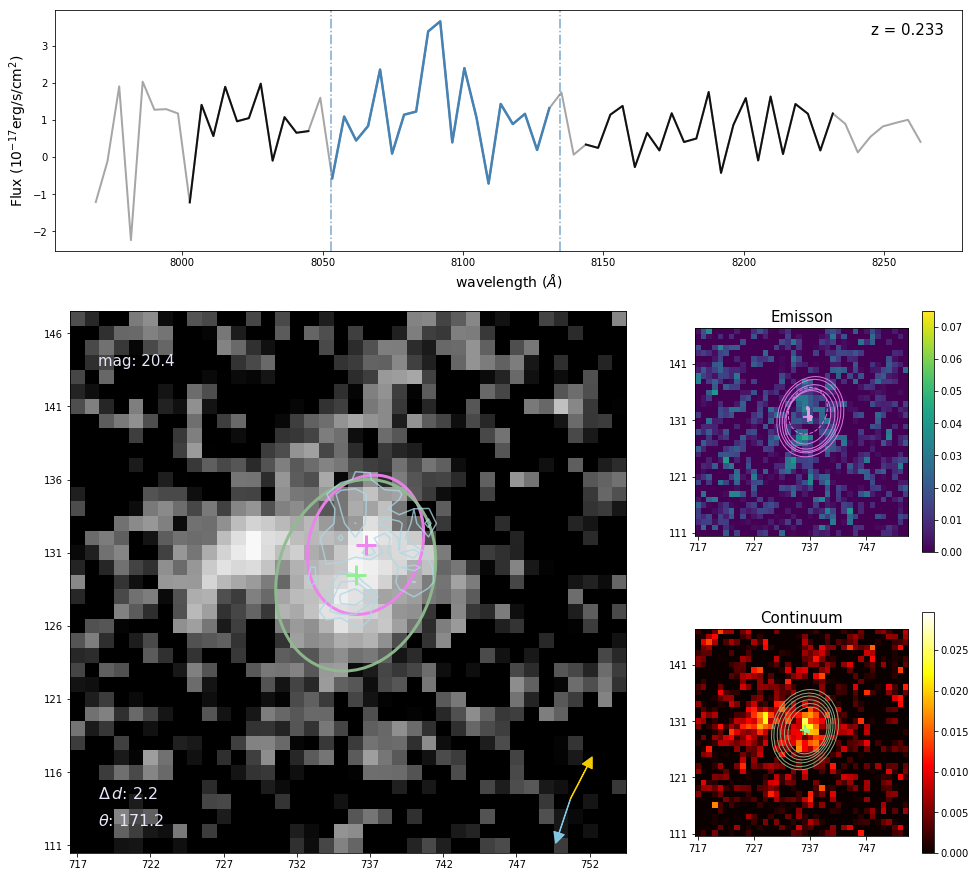

optimal aperture:2.3
Aper (min,max): (1.61,2.30)


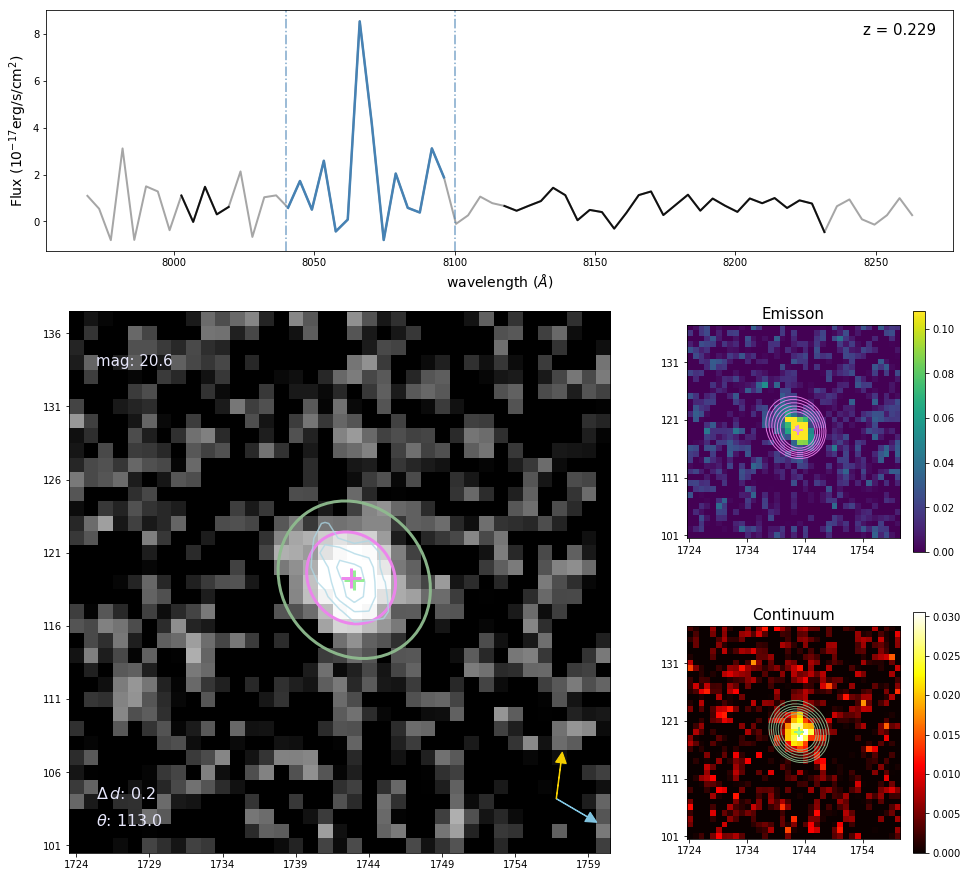

optimal aperture:2.3
Aper (min,max): (1.61,2.30)


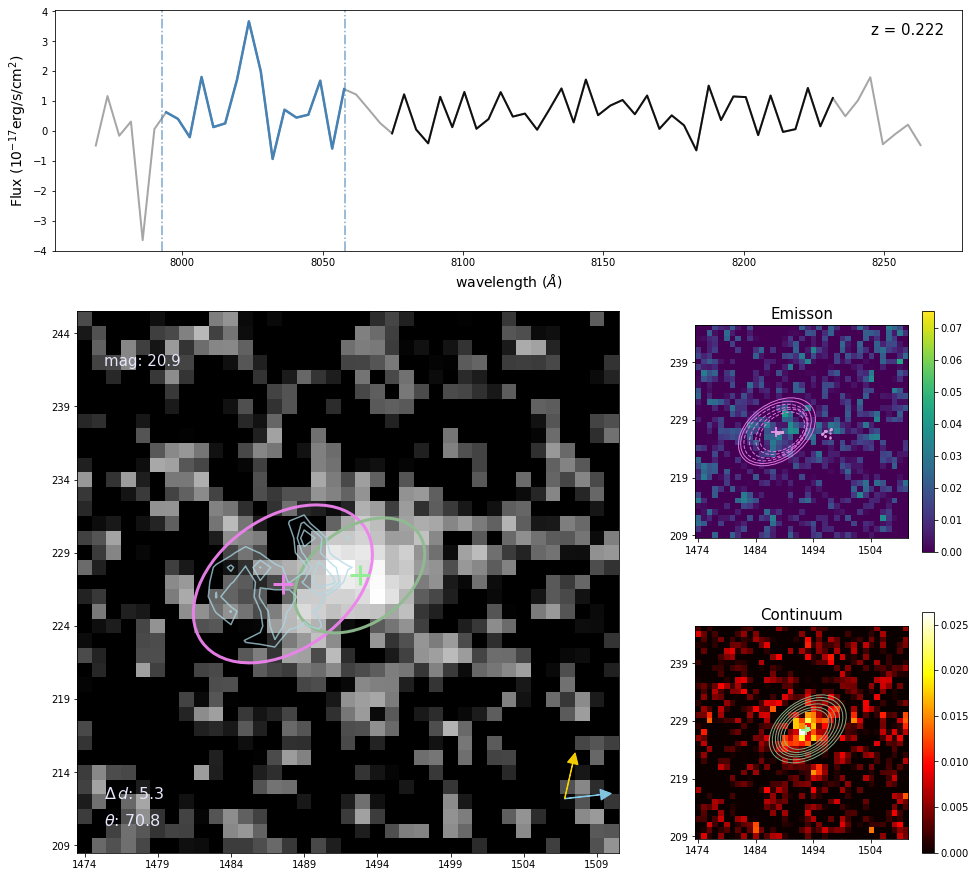

optimal aperture:2.3
Aper (min,max): (1.61,2.30)


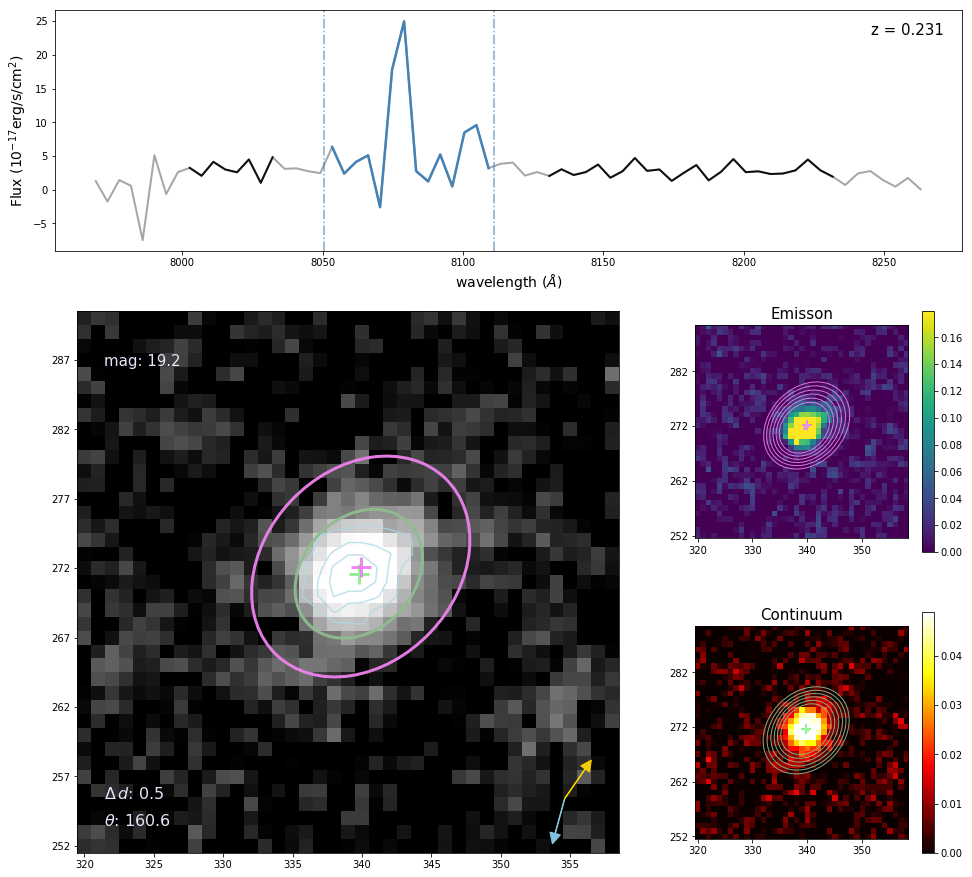

optimal aperture:2.0
Aper (min,max): (1.40,2.00)


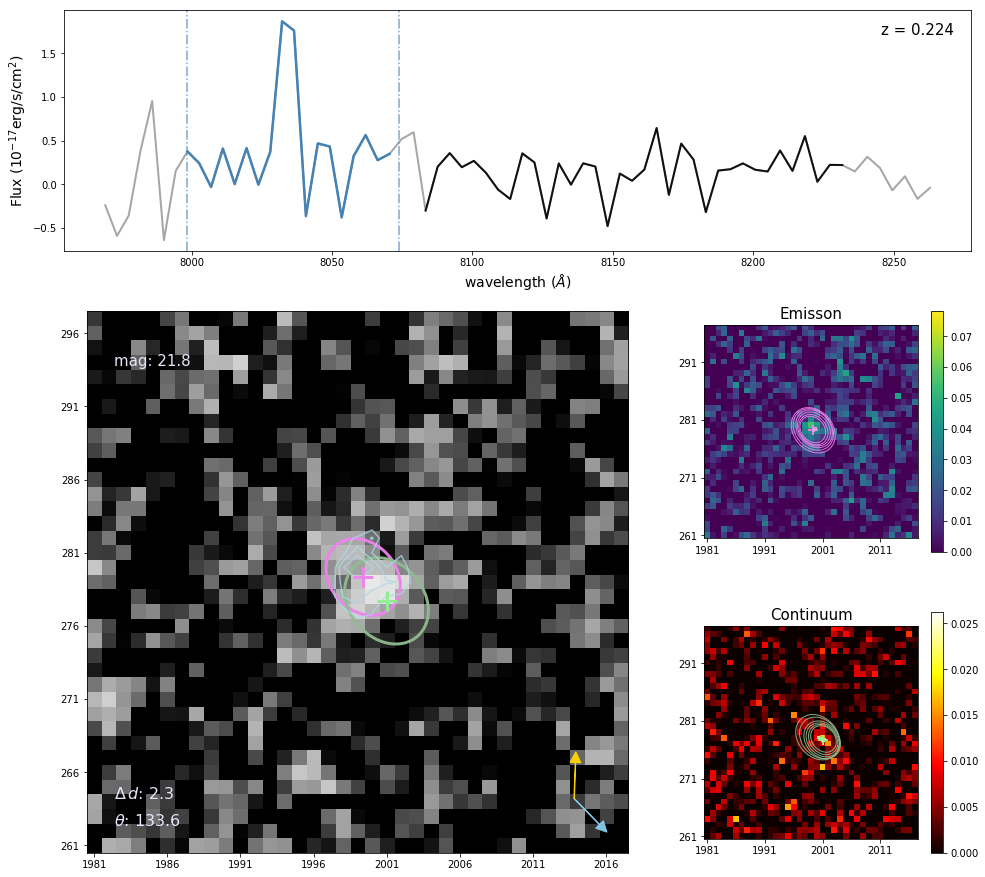

optimal aperture:2.2
Aper (min,max): (1.54,2.20)


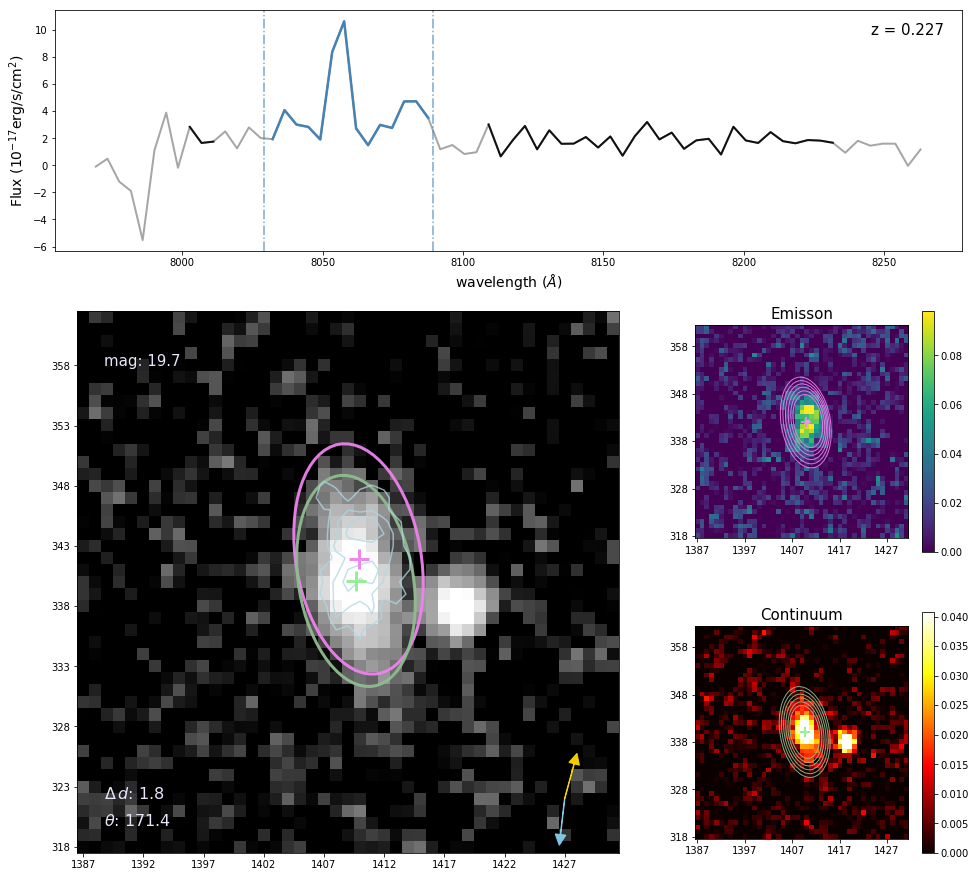

optimal aperture:2.0
Aper (min,max): (1.40,2.00)


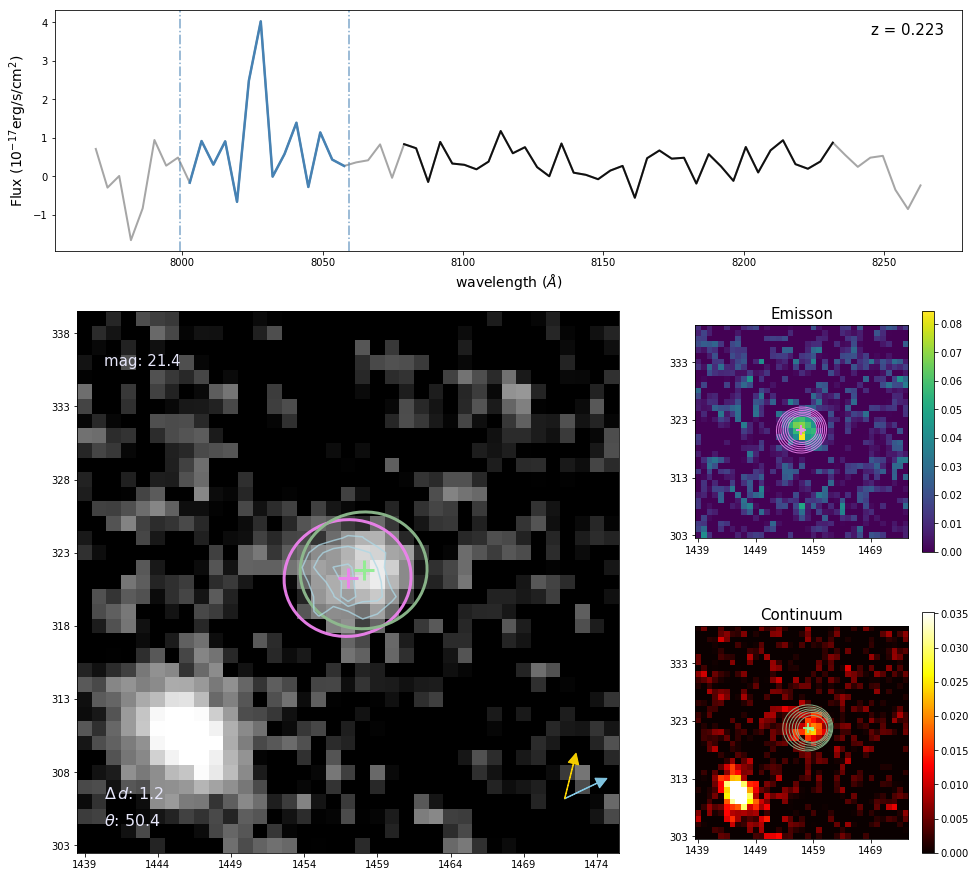

optimal aperture:2.1
Aper (min,max): (1.47,2.10)


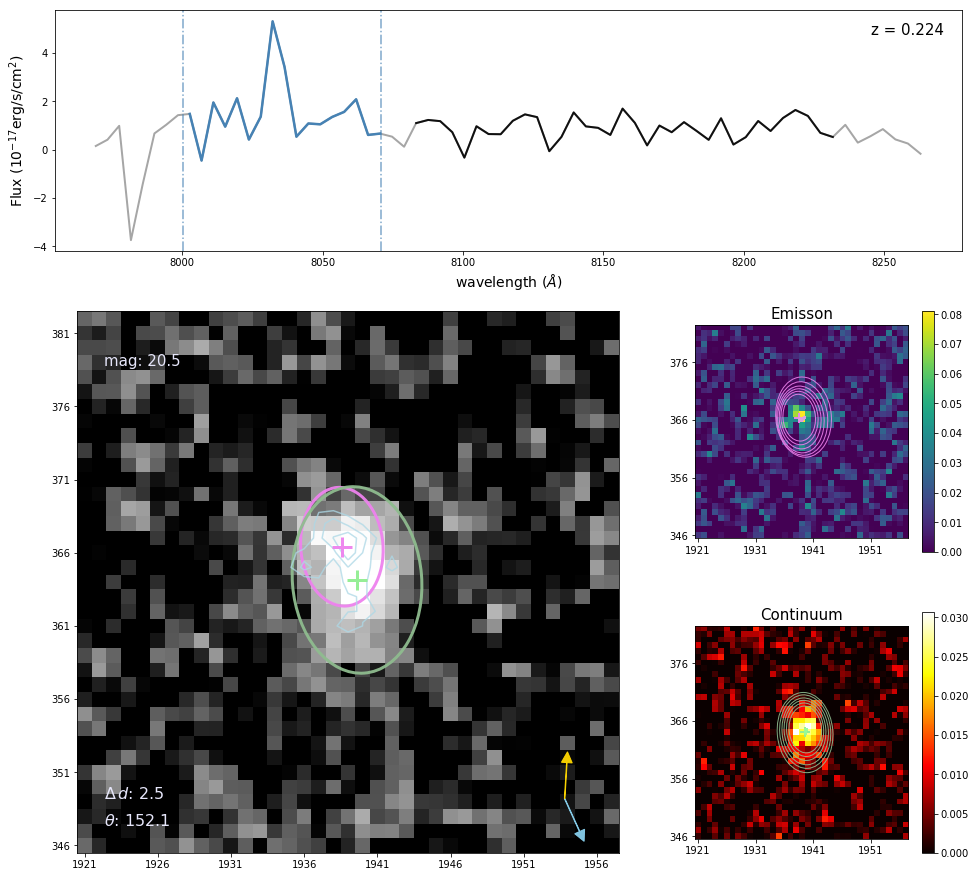

optimal aperture:2.2
Aper (min,max): (1.54,2.20)


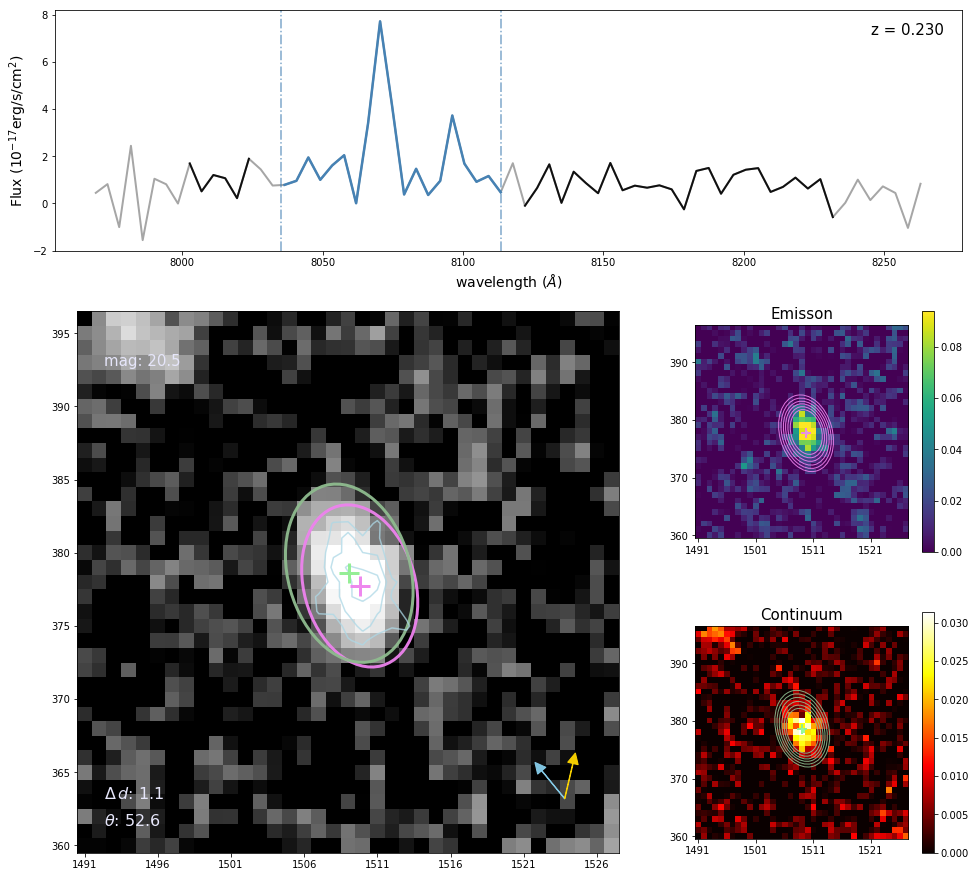

optimal aperture:2.1
Aper (min,max): (1.47,2.10)


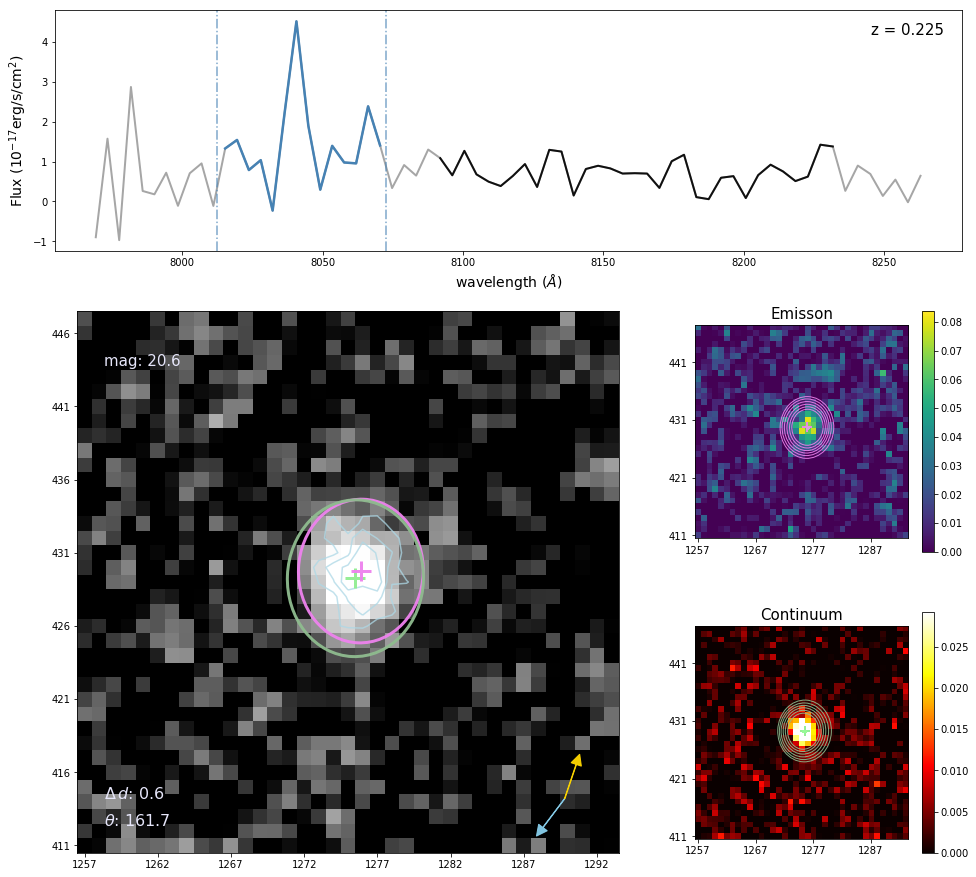

optimal aperture:2.2
Aper (min,max): (1.54,2.20)


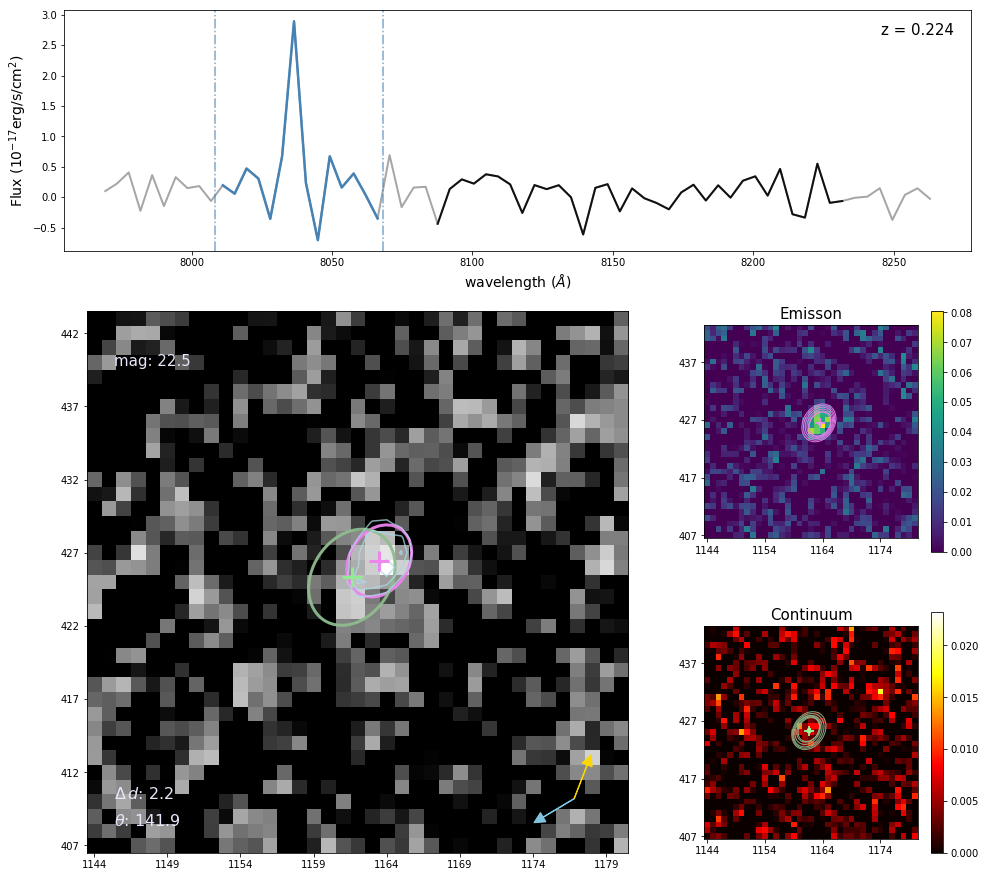

optimal aperture:2.3
Aper (min,max): (1.61,2.30)


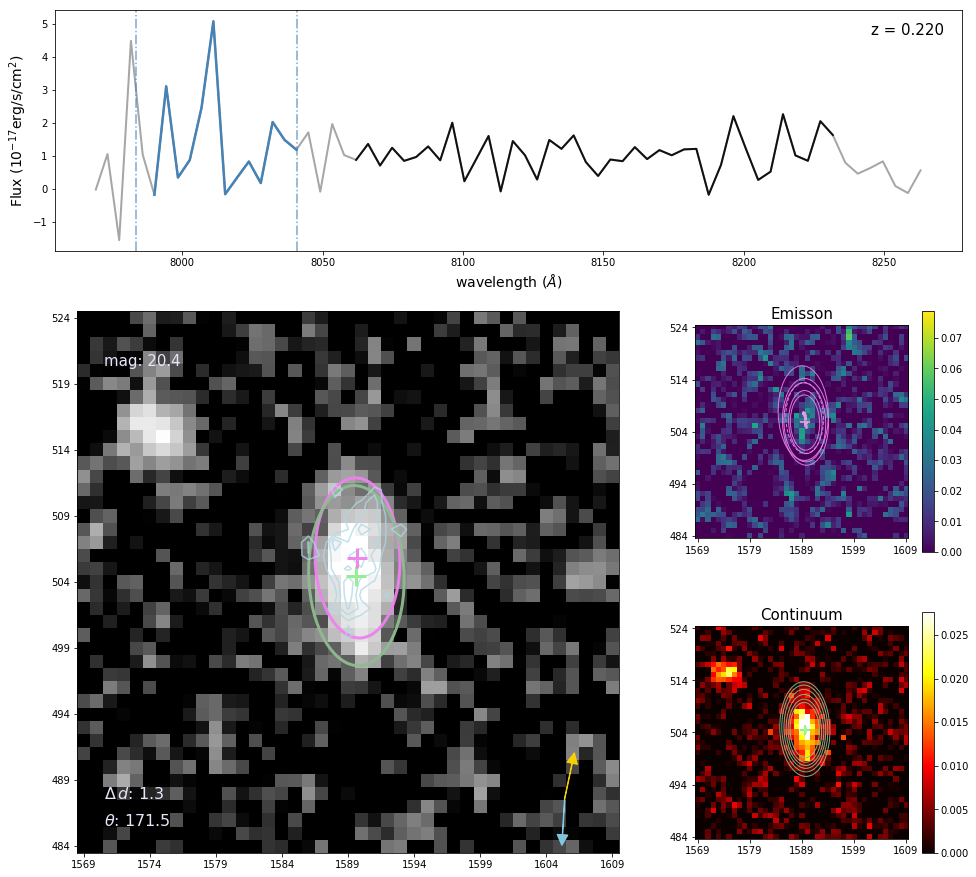

optimal aperture:2.1
Aper (min,max): (1.47,2.10)


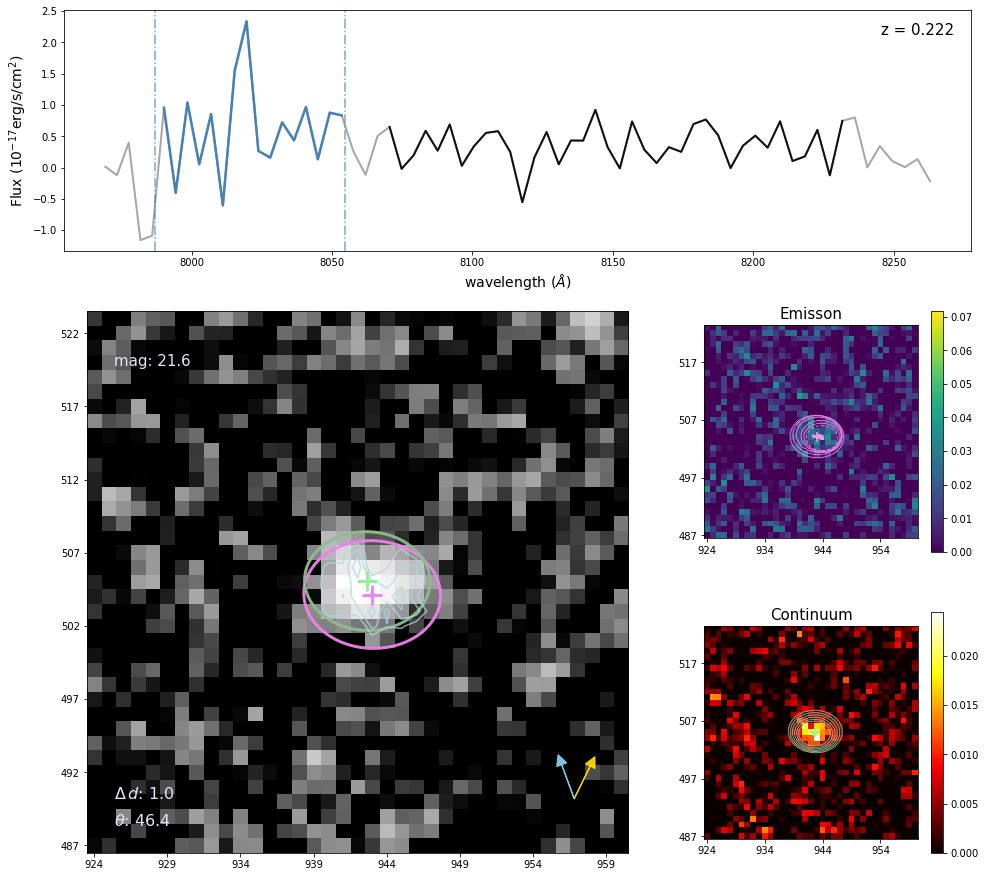

optimal aperture:2.2
Aper (min,max): (1.54,2.20)


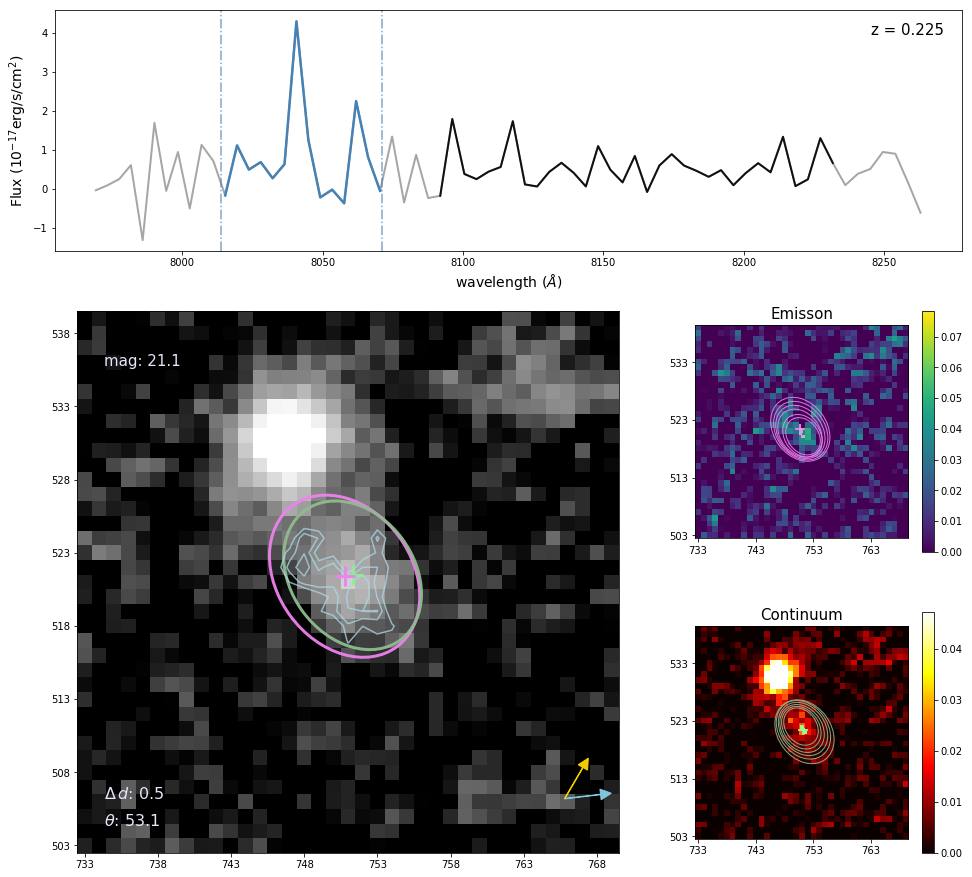

optimal aperture:2.2
Aper (min,max): (1.54,2.20)


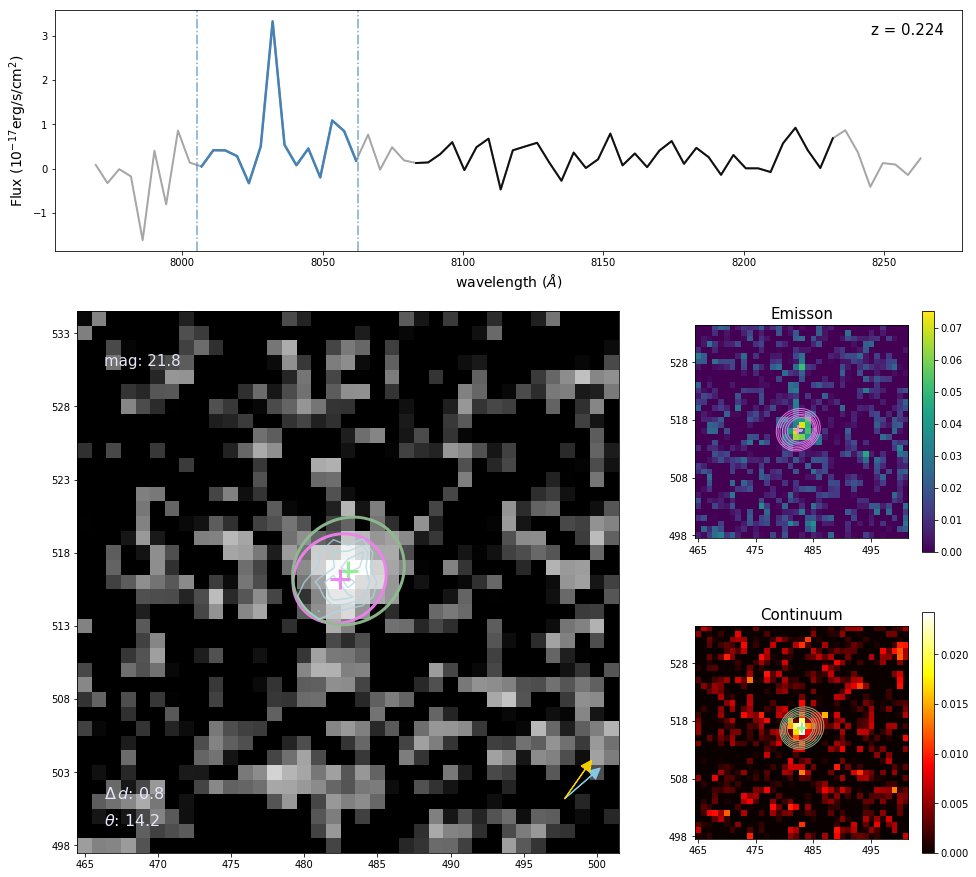

optimal aperture:2.1
Aper (min,max): (1.47,2.10)


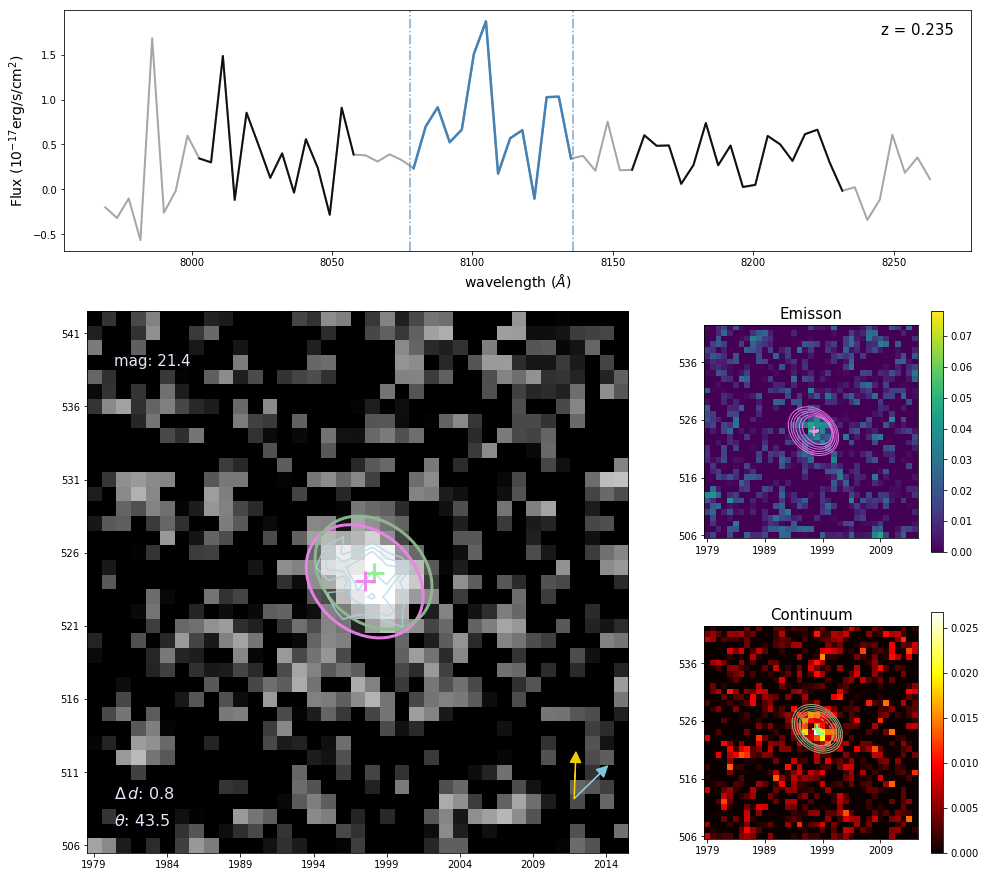

optimal aperture:2.2
Aper (min,max): (1.54,2.20)


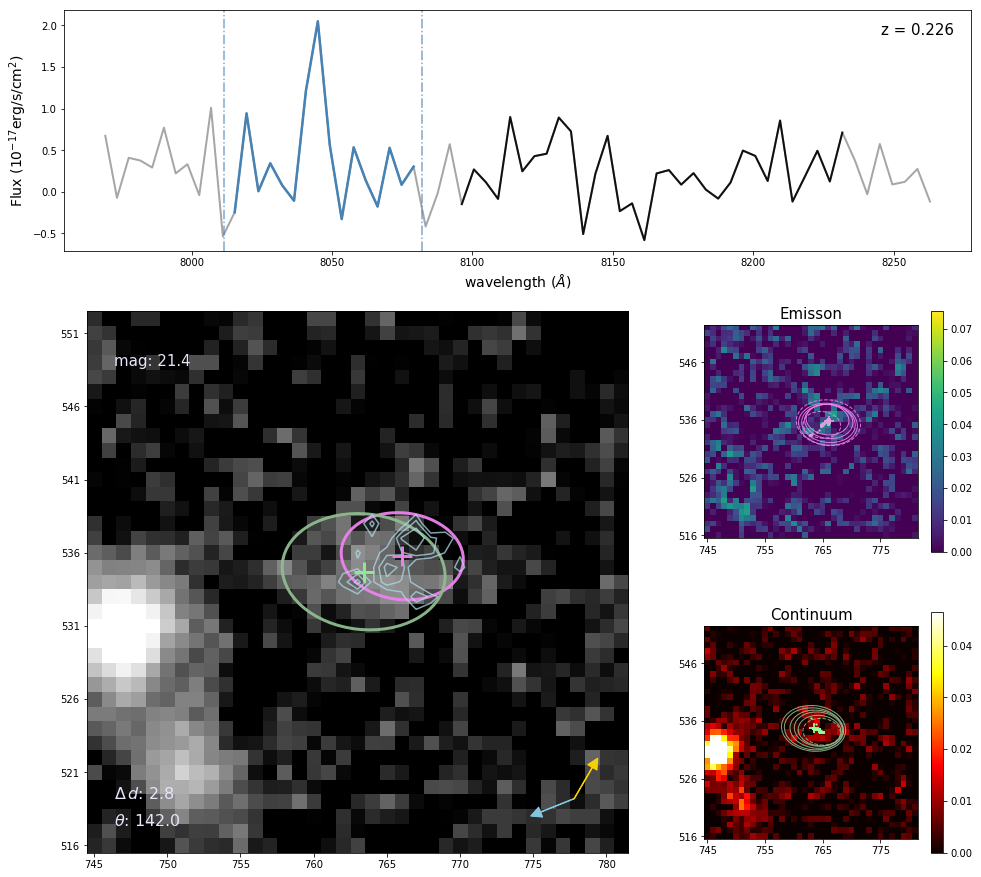

optimal aperture:2.9
Aper (min,max): (2.03,2.90)


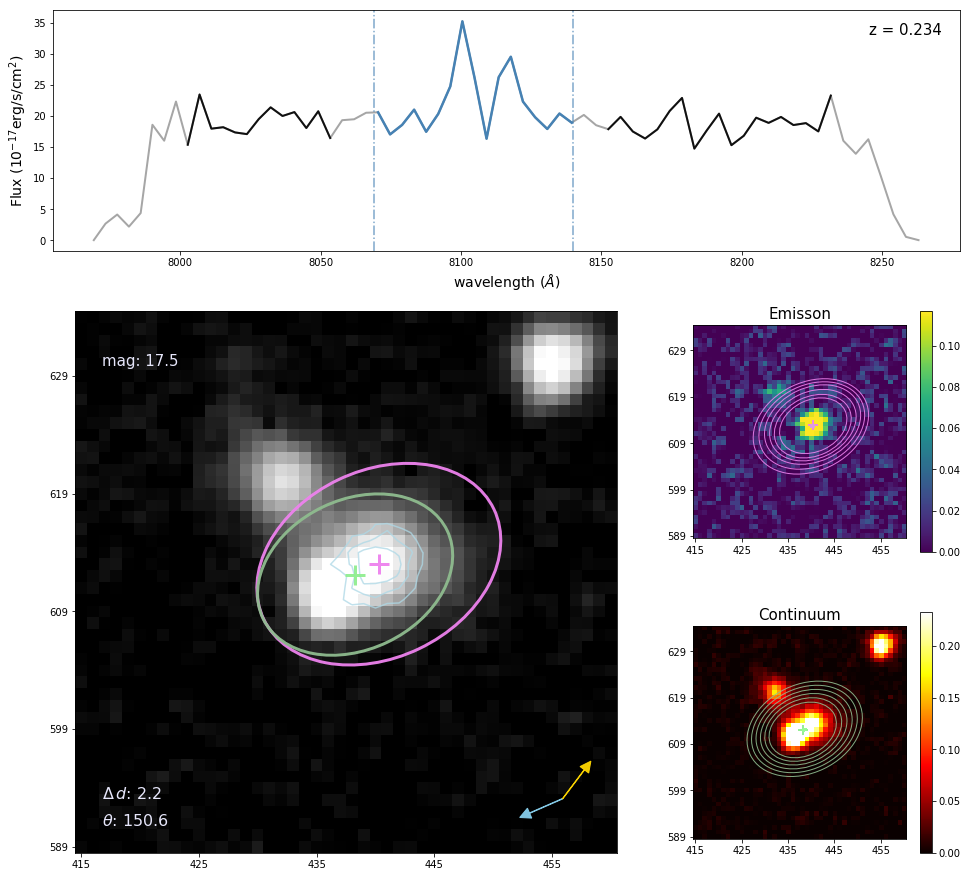

optimal aperture:2.5
Aper (min,max): (1.75,2.50)


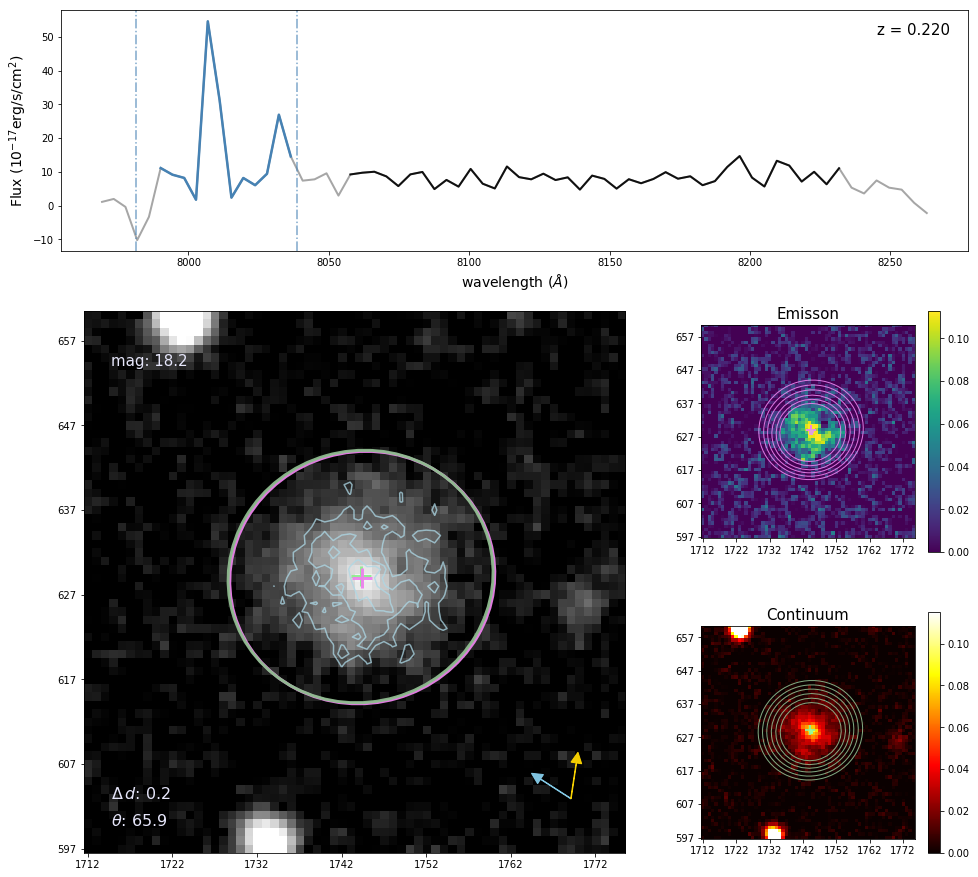

optimal aperture:2.9
Aper (min,max): (2.03,2.90)


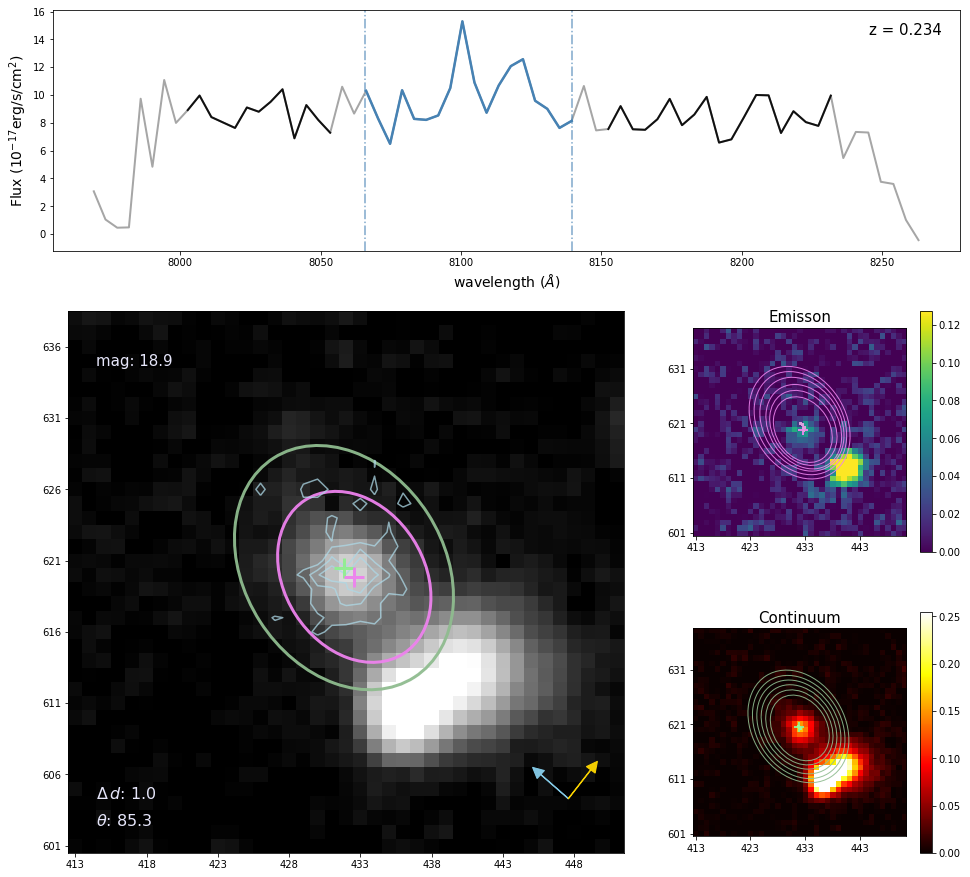

optimal aperture:2.2
Aper (min,max): (1.54,2.20)


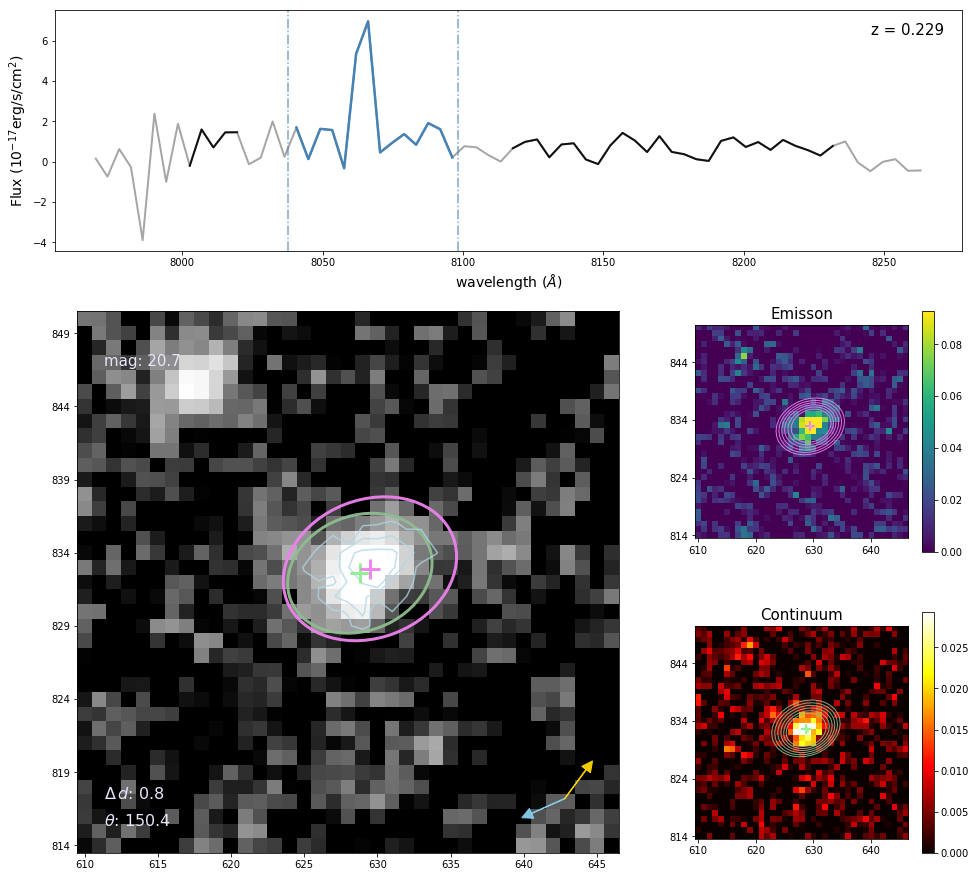

optimal aperture:2.1
Aper (min,max): (1.47,2.10)


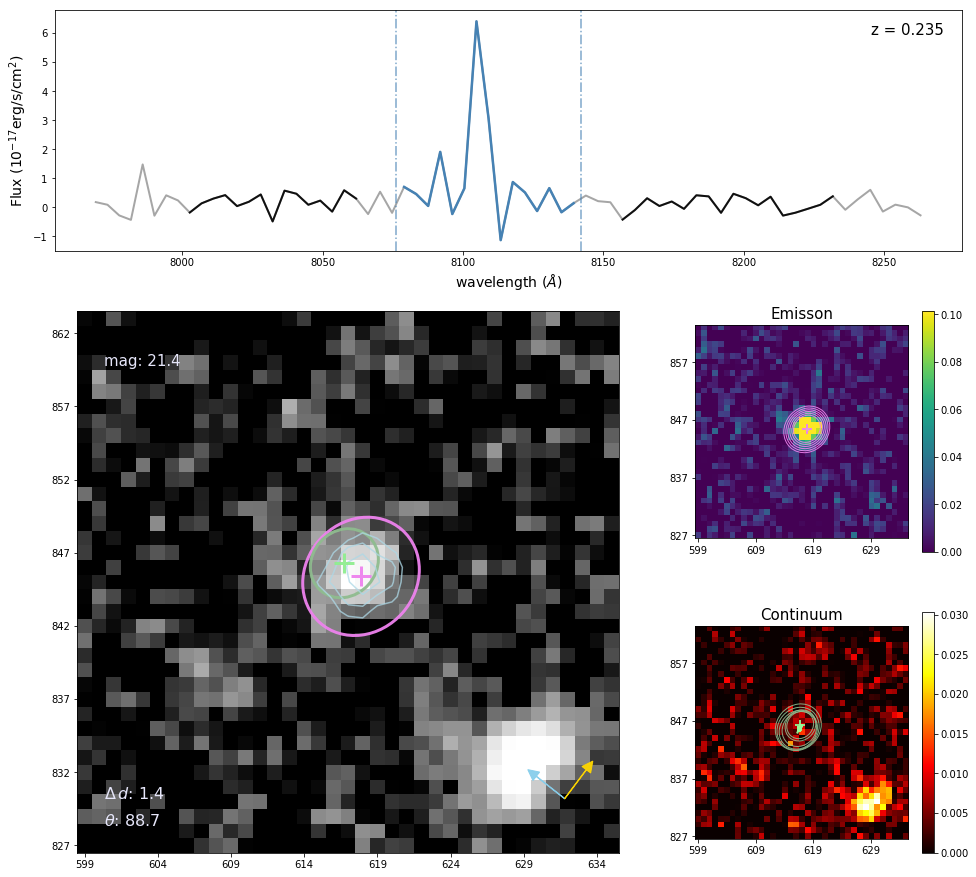

optimal aperture:2.0
Aper (min,max): (1.40,2.00)
Unable to compute centroid! Error raised.


<Figure size 432x288 with 0 Axes>

optimal aperture:2.5
Aper (min,max): (1.75,2.50)


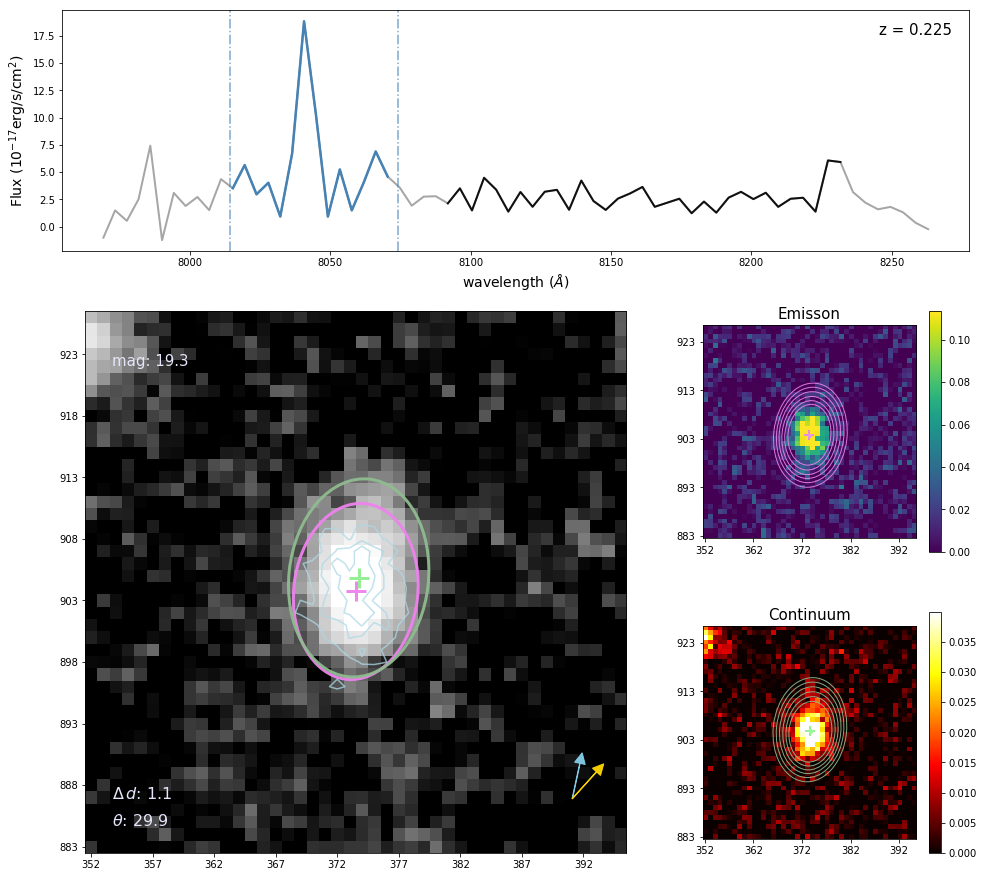

optimal aperture:2.5
Aper (min,max): (1.75,2.50)
Unable to compute centroid! Error raised.


<Figure size 432x288 with 0 Axes>

optimal aperture:1.9
Aper (min,max): (1.33,1.90)


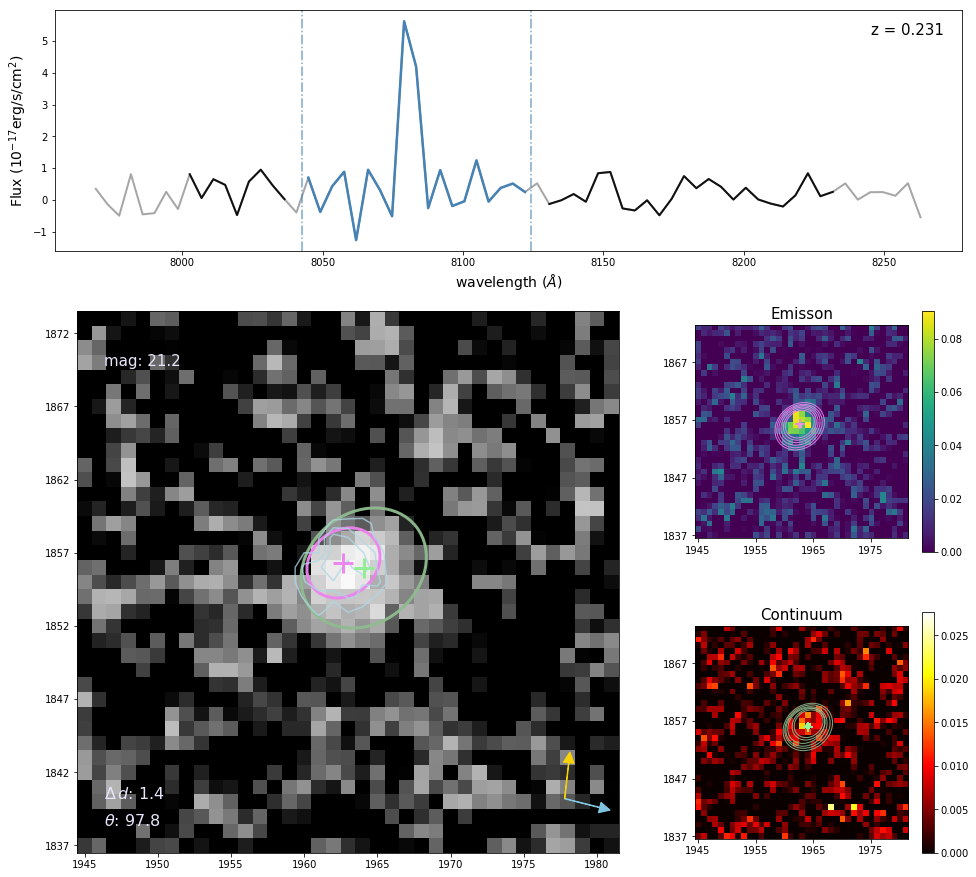

optimal aperture:2.2
Aper (min,max): (1.54,2.20)


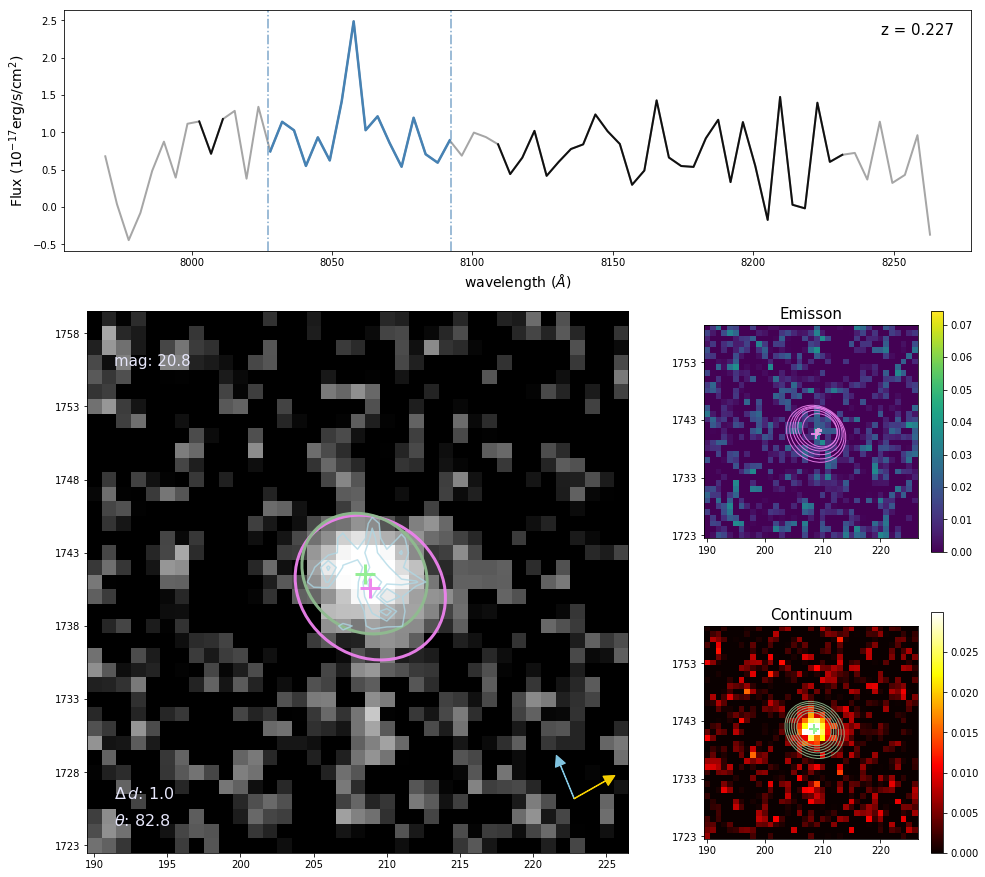

optimal aperture:2.3
Aper (min,max): (1.61,2.30)


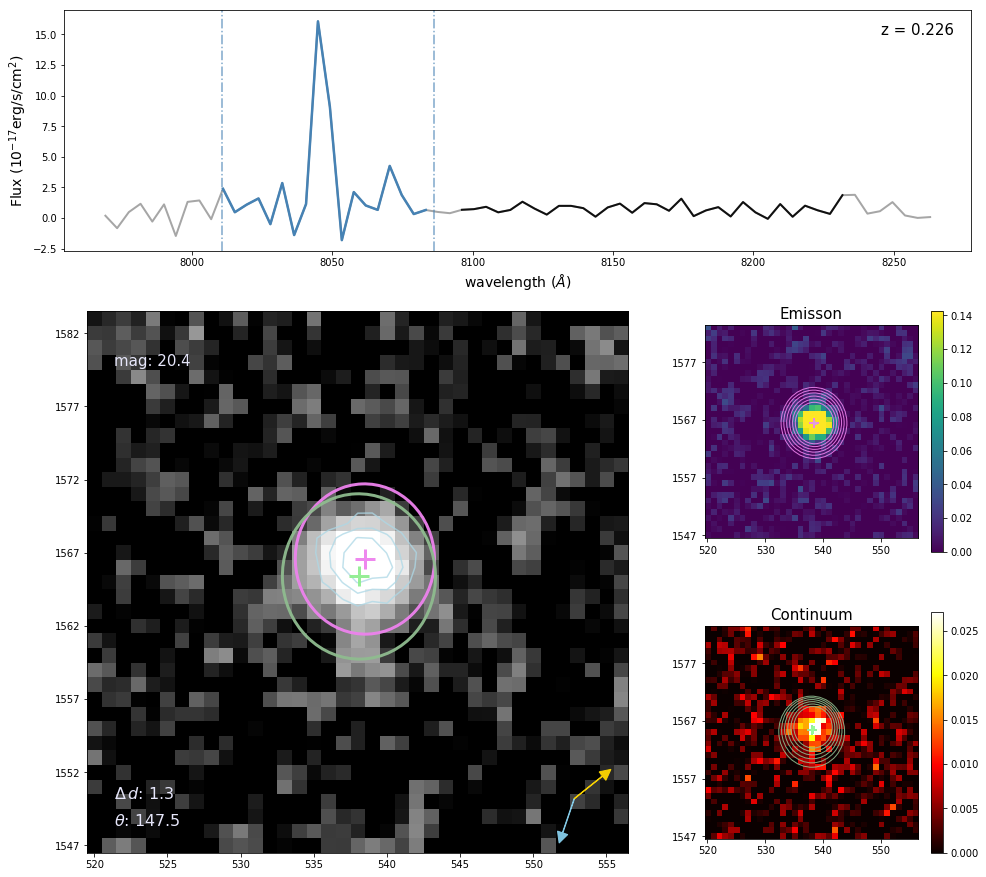

optimal aperture:2.0
Aper (min,max): (1.40,2.00)


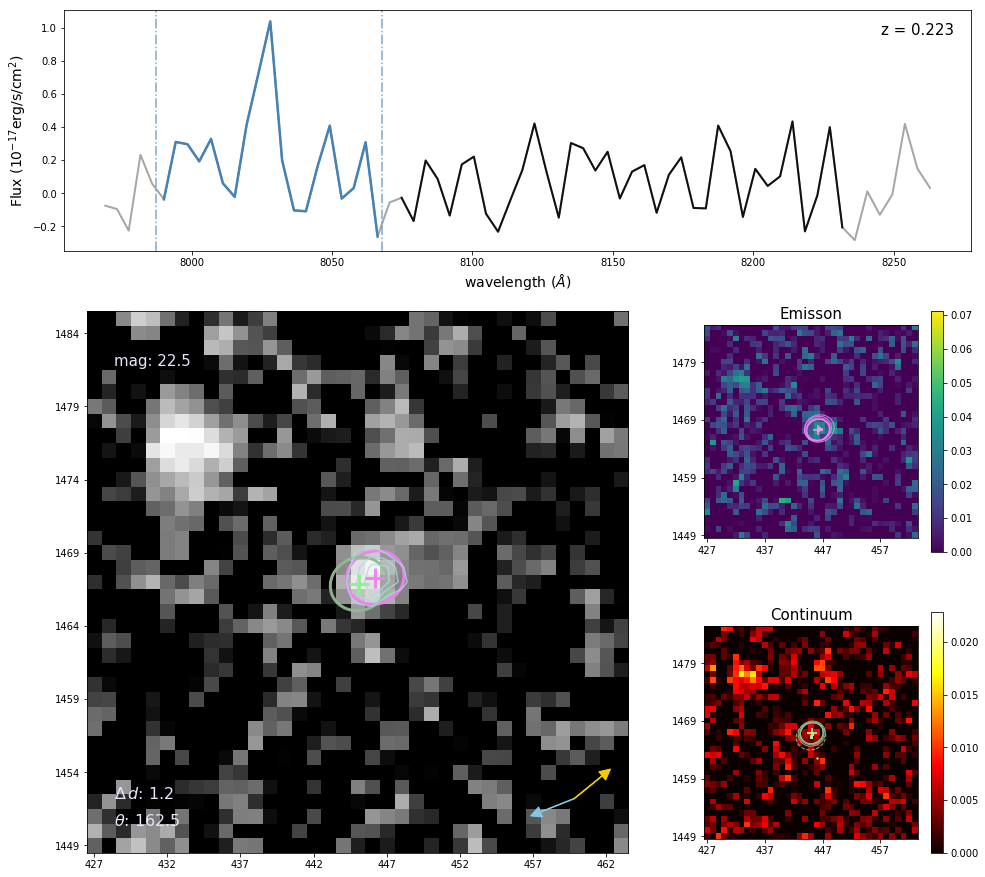

optimal aperture:2.2
Aper (min,max): (1.54,2.20)


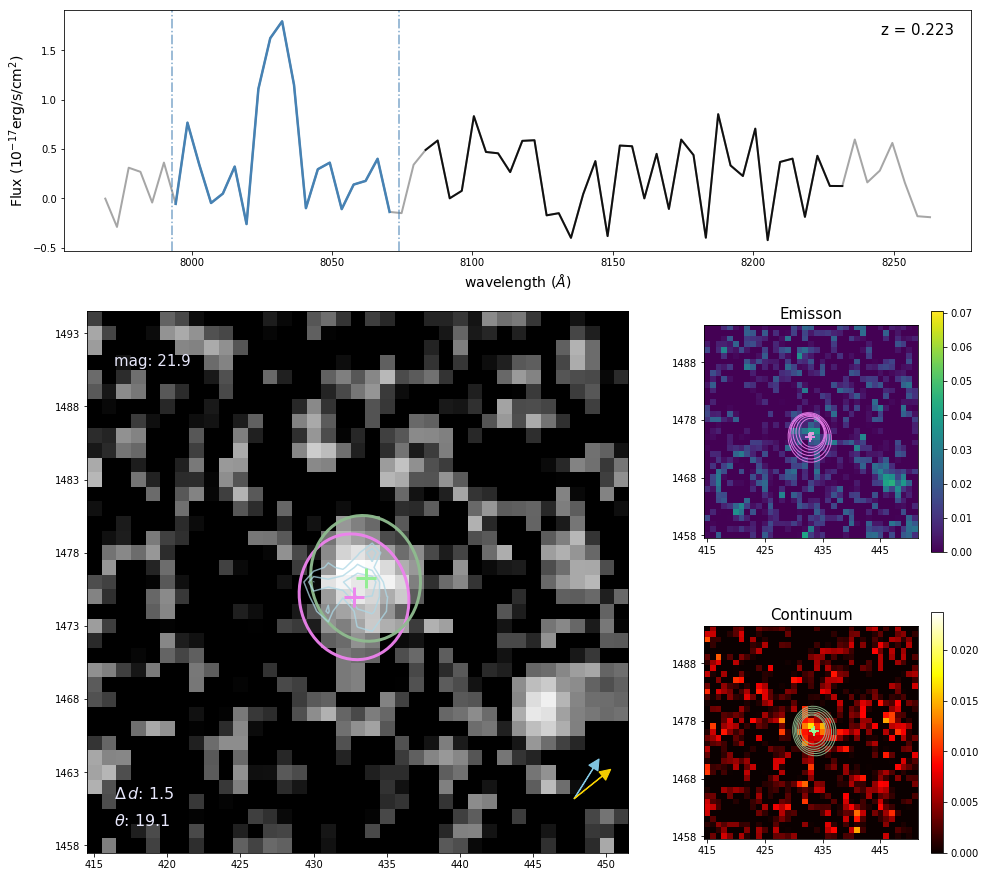

optimal aperture:2.6
Aper (min,max): (1.82,2.60)


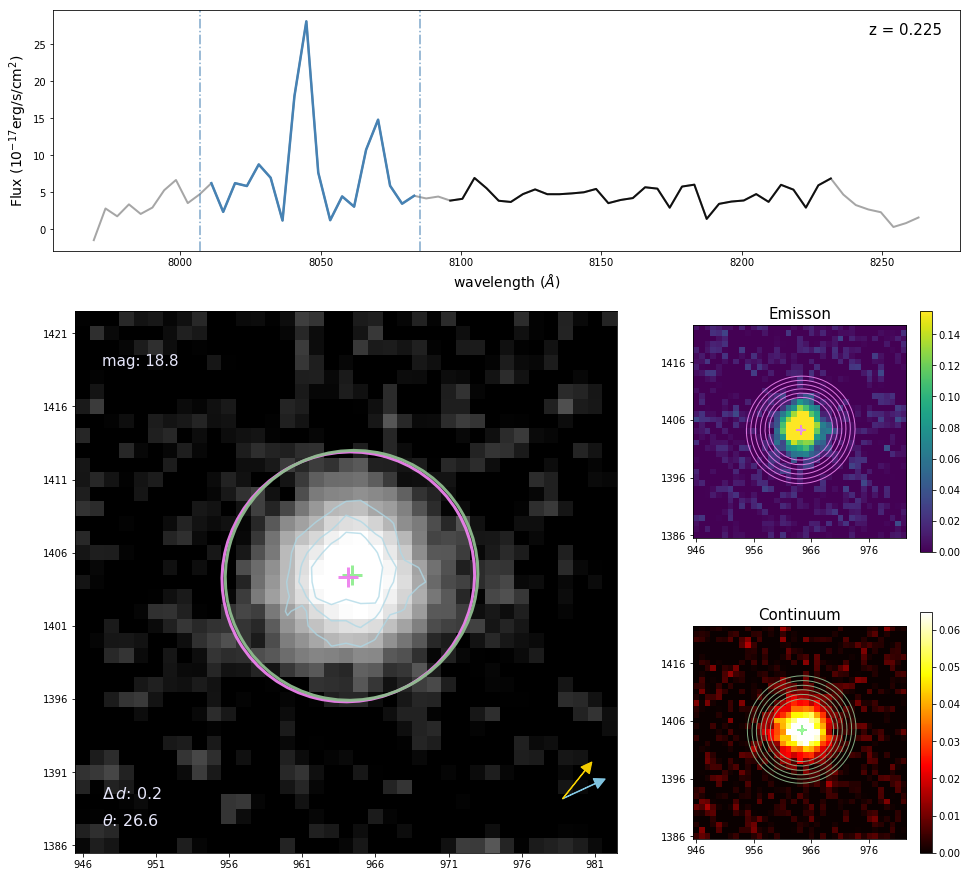

optimal aperture:2.2
Aper (min,max): (1.54,2.20)


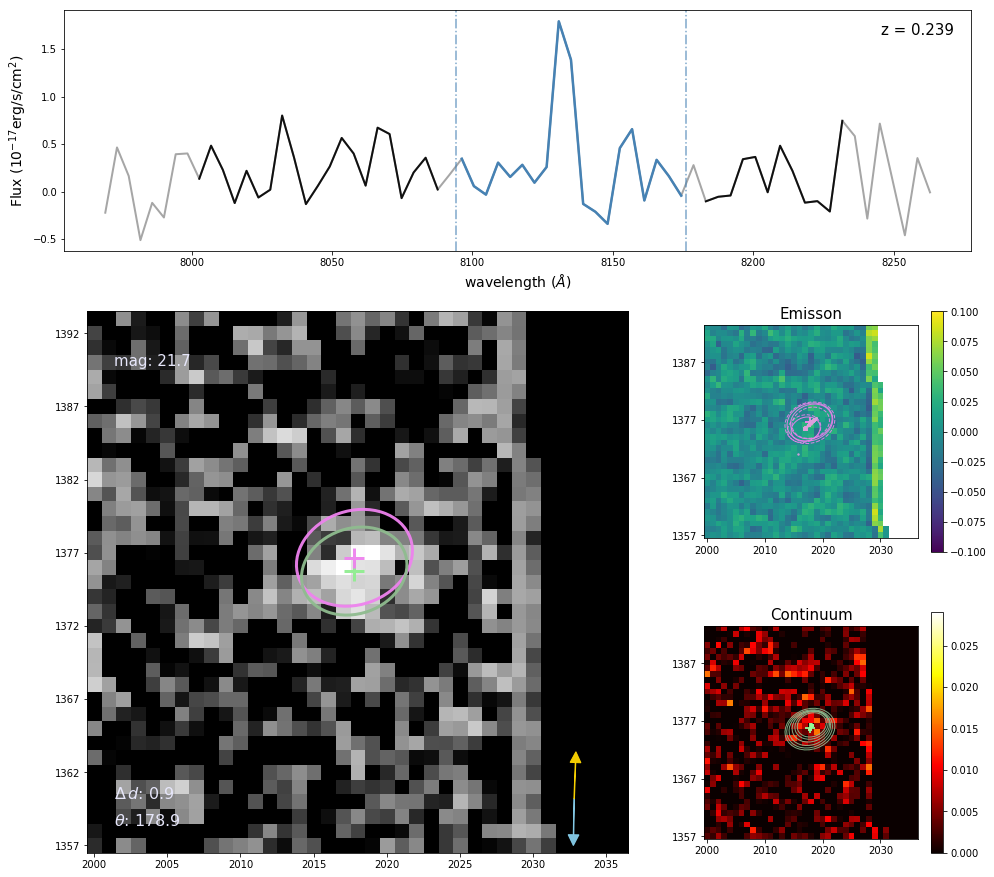

optimal aperture:2.3
Aper (min,max): (1.61,2.30)


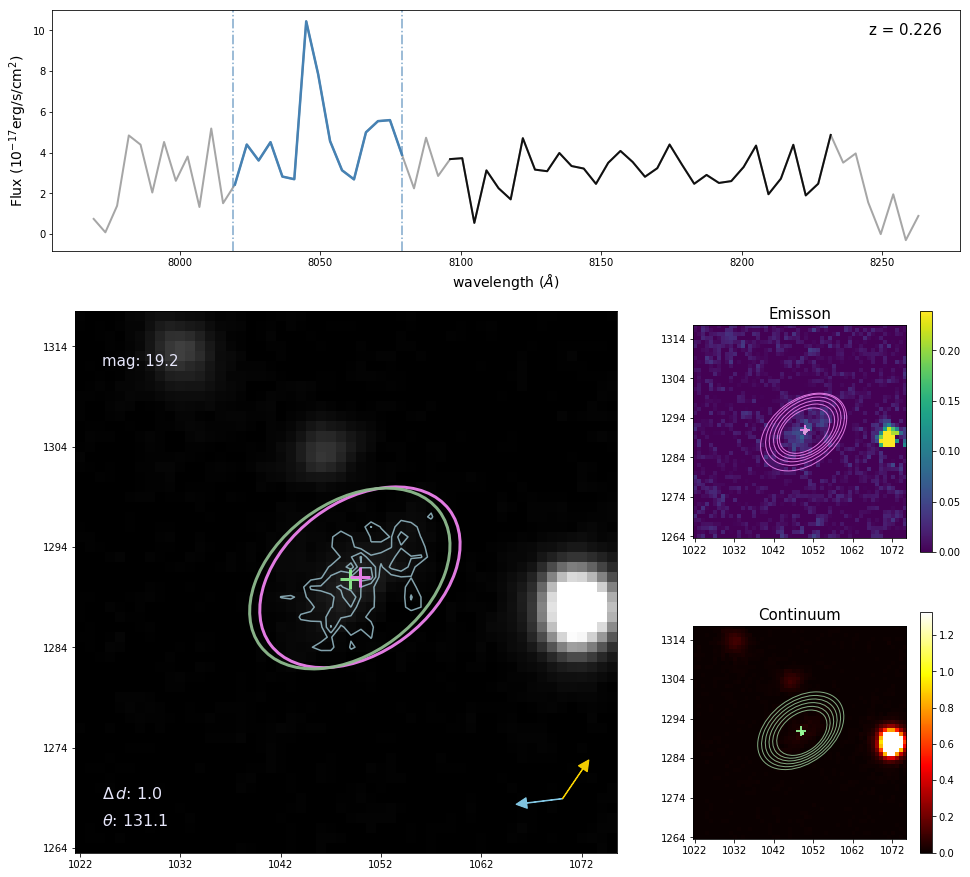

optimal aperture:2.1
Aper (min,max): (1.47,2.10)


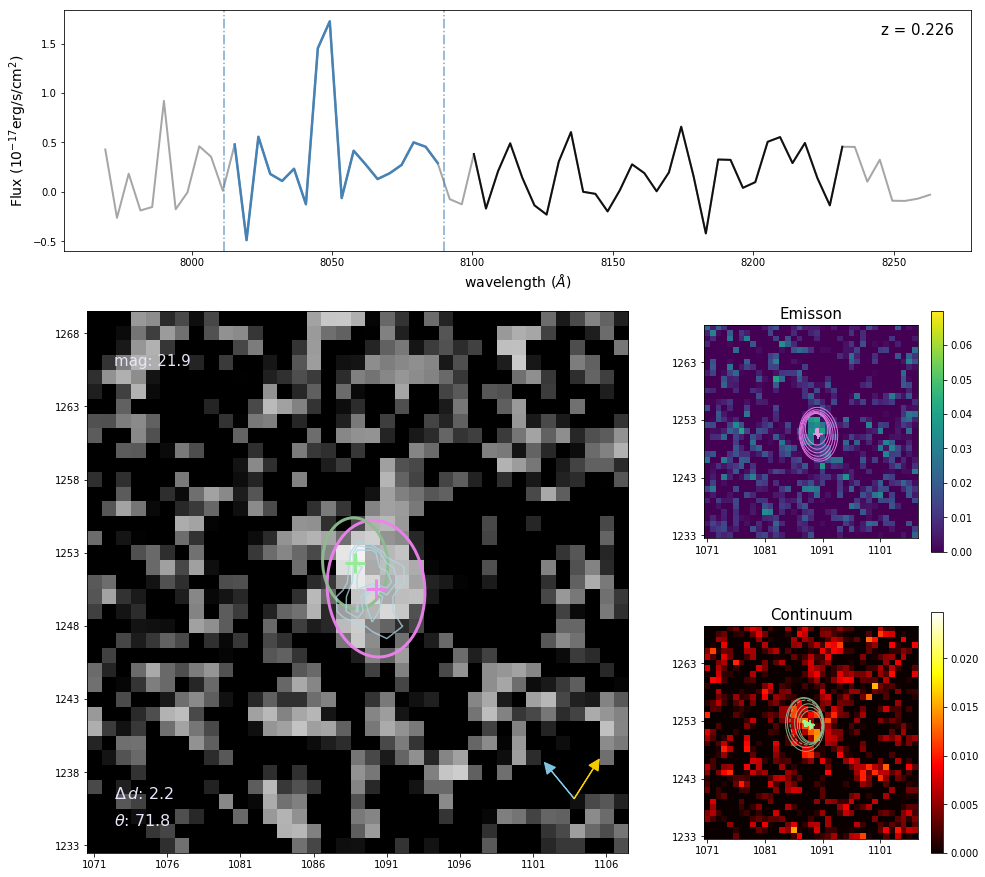

optimal aperture:2.2
Aper (min,max): (1.54,2.20)


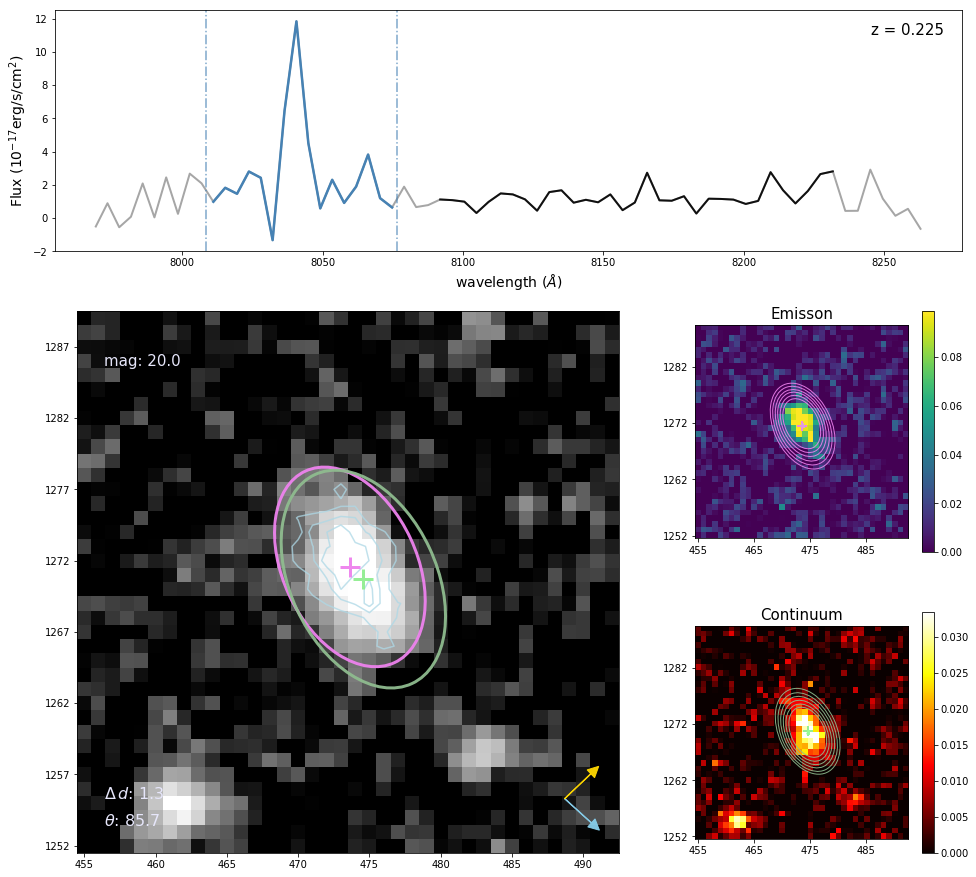

In [14]:
for num in Num_vp:
    Datacube.centroid_analysis(num=num, centroid_type='APER')
    plt.savefig("./A2390SE/fig/centroid_med_w_f//#EL-%s"%num,dpi=100)
    plt.show()
    plt.close()

In [12]:
Datacube.centroid_analysis_all(Num_v, centroid_type='APER')

Current Model:  Ha-NII_gauss
#EL-1
optimal aperture:3.8
Aper (min,max): (3.80,3.80)
#EL-2
optimal aperture:3.9
Aper (min,max): (3.90,3.90)
Unable to compute centroid! Error raised.
#EL-3
optimal aperture:3.9
Aper (min,max): (3.90,3.90)
#EL-4
optimal aperture:2.8
Aper (min,max): (2.80,2.80)
#EL-5
optimal aperture:3.9
Aper (min,max): (3.90,3.90)
#EL-6
optimal aperture:3.2
Aper (min,max): (3.20,3.20)
#EL-7
optimal aperture:1.9
Aper (min,max): (1.33,1.90)
Angle: 95.752  Offset: 0.447
#EL-8
optimal aperture:2.5
Aper (min,max): (2.50,2.50)
#EL-9
optimal aperture:2.3
Aper (min,max): (2.30,2.30)
#EL-10
optimal aperture:2.1
Aper (min,max): (2.10,2.10)
#EL-11
optimal aperture:2.3
Aper (min,max): (1.61,2.30)
Angle: 132.087  Offset: 0.801
#EL-12
optimal aperture:2.5
Aper (min,max): (2.50,2.50)
#EL-13
optimal aperture:2.0
Aper (min,max): (2.00,2.00)
#EL-14
optimal aperture:2.3
Aper (min,max): (2.30,2.30)
#EL-15
optimal aperture:2.1
Aper (min,max): (2.10,2.10)
#EL-16
optimal aperture:2.0
Aper (min,m

#EL-139
optimal aperture:1.2
Aper (min,max): (1.20,1.20)
#EL-140
optimal aperture:3.0
Aper (min,max): (3.00,3.00)
#EL-141
optimal aperture:2.6
Aper (min,max): (2.60,2.60)
#EL-142
optimal aperture:3.9
Aper (min,max): (3.90,3.90)
#EL-143
optimal aperture:2.2
Aper (min,max): (2.20,2.20)
#EL-144
optimal aperture:3.9
Aper (min,max): (3.90,3.90)
#EL-145
optimal aperture:3.2
Aper (min,max): (3.20,3.20)
#EL-146
optimal aperture:2.8
Aper (min,max): (2.80,2.80)
#EL-147
optimal aperture:2.6
Aper (min,max): (2.60,2.60)
#EL-148
optimal aperture:3.7
Aper (min,max): (3.70,3.70)
#EL-149
optimal aperture:2.1
Aper (min,max): (2.10,2.10)
#EL-150
optimal aperture:3.1
Aper (min,max): (3.10,3.10)
#EL-151
optimal aperture:3.6
Aper (min,max): (3.60,3.60)
#EL-152
optimal aperture:2.2
Aper (min,max): (2.20,2.20)
#EL-153
optimal aperture:2.7
Aper (min,max): (2.70,2.70)
#EL-154
optimal aperture:2.9
Aper (min,max): (2.90,2.90)
#EL-155
optimal aperture:1.8
Aper (min,max): (1.80,1.80)
#EL-156
optimal aperture:1.9
Ap

Angle: 152.074  Offset: 2.496
#EL-287
optimal aperture:2.0
Aper (min,max): (2.00,2.00)
#EL-288
optimal aperture:2.6
Aper (min,max): (2.60,2.60)
#EL-289
optimal aperture:2.2
Aper (min,max): (2.20,2.20)
#EL-290
optimal aperture:2.2
Aper (min,max): (2.20,2.20)
#EL-291
optimal aperture:2.1
Aper (min,max): (2.10,2.10)
#EL-292
optimal aperture:2.3
Aper (min,max): (2.30,2.30)
#EL-293
optimal aperture:2.2
Aper (min,max): (2.20,2.20)
#EL-294
optimal aperture:2.2
Aper (min,max): (2.20,2.20)
#EL-295
optimal aperture:1.9
Aper (min,max): (1.90,1.90)
#EL-296
optimal aperture:2.0
Aper (min,max): (2.00,2.00)
#EL-297
optimal aperture:2.4
Aper (min,max): (2.40,2.40)
#EL-298
optimal aperture:2.2
Aper (min,max): (2.20,2.20)
#EL-299
optimal aperture:2.5
Aper (min,max): (2.50,2.50)
#EL-300
optimal aperture:3.7
Aper (min,max): (3.70,3.70)
#EL-301
optimal aperture:2.7
Aper (min,max): (2.70,2.70)
#EL-302
optimal aperture:2.1
Aper (min,max): (2.10,2.10)
#EL-303
optimal aperture:2.2
Aper (min,max): (1.54,2.20)
A

#EL-428
optimal aperture:2.2
Aper (min,max): (2.20,2.20)
#EL-429
optimal aperture:2.0
Aper (min,max): (2.00,2.00)
#EL-430
optimal aperture:1.6
Aper (min,max): (1.60,1.60)
#EL-431
optimal aperture:2.4
Aper (min,max): (2.40,2.40)
#EL-432
optimal aperture:2.4
Aper (min,max): (2.40,2.40)
#EL-433
optimal aperture:2.3
Aper (min,max): (2.30,2.30)
#EL-434
optimal aperture:2.4
Aper (min,max): (2.40,2.40)
#EL-435
optimal aperture:2.1
Aper (min,max): (1.47,2.10)
Angle: 46.446  Offset: 0.978
#EL-436
optimal aperture:2.1
Aper (min,max): (2.10,2.10)
#EL-437
optimal aperture:2.1
Aper (min,max): (2.10,2.10)
#EL-438
optimal aperture:3.3
Aper (min,max): (3.30,3.30)
#EL-439
optimal aperture:3.4
Aper (min,max): (3.40,3.40)
#EL-440
optimal aperture:2.5
Aper (min,max): (2.50,2.50)
#EL-441
optimal aperture:1.6
Aper (min,max): (1.60,1.60)
#EL-442
optimal aperture:2.3
Aper (min,max): (2.30,2.30)
#EL-443
optimal aperture:2.2
Aper (min,max): (1.54,2.20)
Angle: 53.098  Offset: 0.550
#EL-444
optimal aperture:2.5
A

#EL-574
optimal aperture:3.2
Aper (min,max): (3.20,3.20)
#EL-575
optimal aperture:2.5
Aper (min,max): (2.50,2.50)
#EL-576
optimal aperture:2.2
Aper (min,max): (2.20,2.20)
#EL-577
optimal aperture:2.3
Aper (min,max): (2.30,2.30)
#EL-578
optimal aperture:2.4
Aper (min,max): (2.40,2.40)
#EL-579
optimal aperture:2.3
Aper (min,max): (2.30,2.30)
#EL-580
optimal aperture:2.2
Aper (min,max): (2.20,2.20)
#EL-581
optimal aperture:2.1
Aper (min,max): (2.10,2.10)
#EL-582
optimal aperture:3.9
Aper (min,max): (3.90,3.90)
#EL-583
optimal aperture:2.5
Aper (min,max): (2.50,2.50)
#EL-584
optimal aperture:2.4
Aper (min,max): (2.40,2.40)
#EL-585
optimal aperture:2.7
Aper (min,max): (2.70,2.70)
#EL-586
optimal aperture:2.5
Aper (min,max): (2.50,2.50)
#EL-587
optimal aperture:2.0
Aper (min,max): (2.00,2.00)
#EL-588
optimal aperture:1.9
Aper (min,max): (1.90,1.90)
#EL-589
optimal aperture:2.1
Aper (min,max): (2.10,2.10)
#EL-590
optimal aperture:2.0
Aper (min,max): (2.00,2.00)
#EL-591
optimal aperture:2.4
Ap

#EL-722
optimal aperture:2.9
Aper (min,max): (2.90,2.90)
#EL-723
optimal aperture:1.9
Aper (min,max): (1.90,1.90)
#EL-724
optimal aperture:3.9
Aper (min,max): (3.90,3.90)
#EL-725
optimal aperture:2.7
Aper (min,max): (2.70,2.70)
#EL-726
optimal aperture:2.3
Aper (min,max): (2.30,2.30)
#EL-727
optimal aperture:2.2
Aper (min,max): (1.54,2.20)
Angle: 150.420  Offset: 0.755
#EL-728
optimal aperture:2.4
Aper (min,max): (2.40,2.40)
#EL-729
optimal aperture:2.2
Aper (min,max): (2.20,2.20)
#EL-730
optimal aperture:2.3
Aper (min,max): (2.30,2.30)
#EL-731
optimal aperture:2.0
Aper (min,max): (2.00,2.00)
#EL-732
optimal aperture:2.4
Aper (min,max): (2.40,2.40)
#EL-733
optimal aperture:2.4
Aper (min,max): (2.40,2.40)
#EL-734
optimal aperture:2.1
Aper (min,max): (1.47,2.10)
Angle: 116.618  Offset: 1.530
#EL-735
optimal aperture:2.2
Aper (min,max): (2.20,2.20)
#EL-736
optimal aperture:2.0
Aper (min,max): (1.40,2.00)
Unable to compute centroid! Error raised.
Angle: nan  Offset: nan
#EL-737
optimal ape

#EL-867
optimal aperture:2.0
Aper (min,max): (2.00,2.00)
#EL-868
optimal aperture:2.5
Aper (min,max): (2.50,2.50)
#EL-869
optimal aperture:2.8
Aper (min,max): (2.80,2.80)
#EL-870
optimal aperture:2.2
Aper (min,max): (2.20,2.20)
#EL-871
optimal aperture:2.0
Aper (min,max): (2.00,2.00)
#EL-872
optimal aperture:3.7
Aper (min,max): (3.70,3.70)
#EL-873
optimal aperture:2.1
Aper (min,max): (2.10,2.10)
#EL-874
optimal aperture:2.5
Aper (min,max): (2.50,2.50)
#EL-875
optimal aperture:2.5
Aper (min,max): (2.50,2.50)
#EL-876
optimal aperture:2.2
Aper (min,max): (2.20,2.20)
#EL-877
optimal aperture:2.1
Aper (min,max): (2.10,2.10)
#EL-878
optimal aperture:2.6
Aper (min,max): (2.60,2.60)
#EL-879
optimal aperture:3.4
Aper (min,max): (3.40,3.40)
#EL-880
optimal aperture:2.3
Aper (min,max): (2.30,2.30)
#EL-881
optimal aperture:3.9
Aper (min,max): (3.90,3.90)
#EL-882
optimal aperture:2.3
Aper (min,max): (2.30,2.30)
#EL-883
optimal aperture:2.1
Aper (min,max): (2.10,2.10)
#EL-884
optimal aperture:3.9
Ap

#EL-1017
optimal aperture:2.0
Aper (min,max): (2.00,2.00)
#EL-1018
optimal aperture:2.0
Aper (min,max): (2.00,2.00)
#EL-1019
optimal aperture:3.9
Aper (min,max): (3.90,3.90)
#EL-1020
optimal aperture:2.9
Aper (min,max): (2.90,2.90)
#EL-1021
optimal aperture:2.8
Aper (min,max): (2.80,2.80)
#EL-1022
optimal aperture:3.4
Aper (min,max): (3.40,3.40)
#EL-1023
optimal aperture:2.5
Aper (min,max): (2.50,2.50)
#EL-1024
optimal aperture:1.8
Aper (min,max): (1.80,1.80)
#EL-1025
optimal aperture:2.9
Aper (min,max): (2.90,2.90)
#EL-1026
optimal aperture:2.5
Aper (min,max): (2.50,2.50)
#EL-1027
optimal aperture:3.0
Aper (min,max): (3.00,3.00)
#EL-1028
optimal aperture:2.5
Aper (min,max): (1.75,2.50)
Unable to compute centroid! Error raised.
Angle: nan  Offset: nan
#EL-1029
optimal aperture:1.9
Aper (min,max): (1.33,1.90)
Angle: 97.778  Offset: 1.423
#EL-1030
optimal aperture:2.4
Aper (min,max): (2.40,2.40)
#EL-1031
optimal aperture:3.0
Aper (min,max): (3.00,3.00)
#EL-1032
optimal aperture:2.3
Aper 

#EL-1168
optimal aperture:2.3
Aper (min,max): (2.30,2.30)
#EL-1169
optimal aperture:3.8
Aper (min,max): (3.80,3.80)
#EL-1170
optimal aperture:2.1
Aper (min,max): (2.10,2.10)
#EL-1171
optimal aperture:3.9
Aper (min,max): (3.90,3.90)
#EL-1172
optimal aperture:1.8
Aper (min,max): (1.80,1.80)
#EL-1173
optimal aperture:2.5
Aper (min,max): (2.50,2.50)
#EL-1174
optimal aperture:2.9
Aper (min,max): (2.90,2.90)
#EL-1175
optimal aperture:2.0
Aper (min,max): (2.00,2.00)
#EL-1176
optimal aperture:2.6
Aper (min,max): (2.60,2.60)
#EL-1177
optimal aperture:2.0
Aper (min,max): (2.00,2.00)
#EL-1178
optimal aperture:2.1
Aper (min,max): (2.10,2.10)
#EL-1179
optimal aperture:2.1
Aper (min,max): (2.10,2.10)
#EL-1180
optimal aperture:2.0
Aper (min,max): (2.00,2.00)
#EL-1181
optimal aperture:2.1
Aper (min,max): (2.10,2.10)
#EL-1182
optimal aperture:3.1
Aper (min,max): (3.10,3.10)
#EL-1183
optimal aperture:2.7
Aper (min,max): (2.70,2.70)
#EL-1184
optimal aperture:2.4
Aper (min,max): (2.40,2.40)
#EL-1185
optim

#EL-1319
optimal aperture:2.2
Aper (min,max): (2.20,2.20)
#EL-1320
optimal aperture:2.0
Aper (min,max): (2.00,2.00)
#EL-1321
optimal aperture:2.9
Aper (min,max): (2.90,2.90)
#EL-1322
optimal aperture:2.1
Aper (min,max): (2.10,2.10)
#EL-1323
optimal aperture:2.1
Aper (min,max): (2.10,2.10)
#EL-1324
optimal aperture:3.1
Aper (min,max): (3.10,3.10)
#EL-1325
optimal aperture:3.7
Aper (min,max): (3.70,3.70)
#EL-1326
optimal aperture:3.9
Aper (min,max): (3.90,3.90)
#EL-1327
optimal aperture:3.4
Aper (min,max): (3.40,3.40)
#EL-1328
optimal aperture:2.3
Aper (min,max): (2.30,2.30)
#EL-1329
optimal aperture:2.3
Aper (min,max): (1.61,2.30)
Angle: 135.072  Offset: 0.708
#EL-1330
optimal aperture:2.0
Aper (min,max): (2.00,2.00)
#EL-1331
optimal aperture:2.2
Aper (min,max): (2.20,2.20)
#EL-1332
optimal aperture:2.3
Aper (min,max): (2.30,2.30)
#EL-1333
optimal aperture:2.9
Aper (min,max): (2.90,2.90)
#EL-1334
optimal aperture:2.4
Aper (min,max): (2.40,2.40)
#EL-1335
optimal aperture:2.1
Aper (min,ma

Aper (min,max): (2.30,2.30)
#EL-1475
optimal aperture:2.5
Aper (min,max): (2.50,2.50)
#EL-1476
optimal aperture:3.1
Aper (min,max): (3.10,3.10)
#EL-1477
optimal aperture:2.2
Aper (min,max): (2.20,2.20)
#EL-1478
optimal aperture:2.2
Aper (min,max): (1.54,2.20)
Angle: 178.874  Offset: 0.909
#EL-1479
optimal aperture:2.5
Aper (min,max): (2.50,2.50)
#EL-1480
optimal aperture:1.9
Aper (min,max): (1.90,1.90)
#EL-1481
optimal aperture:2.1
Aper (min,max): (2.10,2.10)
#EL-1482
optimal aperture:2.5
Aper (min,max): (2.50,2.50)
#EL-1483
optimal aperture:2.1
Aper (min,max): (2.10,2.10)
#EL-1484
optimal aperture:2.4
Aper (min,max): (2.40,2.40)
#EL-1485
optimal aperture:2.1
Aper (min,max): (2.10,2.10)
#EL-1486
optimal aperture:2.3
Aper (min,max): (2.30,2.30)
#EL-1487
optimal aperture:3.2
Aper (min,max): (3.20,3.20)
#EL-1488
optimal aperture:3.9
Aper (min,max): (3.90,3.90)
#EL-1489
optimal aperture:2.4
Aper (min,max): (2.40,2.40)
#EL-1490
optimal aperture:2.4
Aper (min,max): (2.40,2.40)
#EL-1491
optim

optimal aperture:3.1
Aper (min,max): (3.10,3.10)
#EL-1626
optimal aperture:2.2
Aper (min,max): (2.20,2.20)
#EL-1627
optimal aperture:2.3
Aper (min,max): (2.30,2.30)
#EL-1628
optimal aperture:2.4
Aper (min,max): (2.40,2.40)
#EL-1629
optimal aperture:2.0
Aper (min,max): (2.00,2.00)
#EL-1630
optimal aperture:2.8
Aper (min,max): (2.80,2.80)
#EL-1631
optimal aperture:2.2
Aper (min,max): (2.20,2.20)
#EL-1632
optimal aperture:2.5
Aper (min,max): (2.50,2.50)
#EL-1633
optimal aperture:2.2
Aper (min,max): (2.20,2.20)
#EL-1634
optimal aperture:2.7
Aper (min,max): (2.70,2.70)
#EL-1635
optimal aperture:2.7
Aper (min,max): (2.70,2.70)
#EL-1636
optimal aperture:2.7
Aper (min,max): (2.70,2.70)
#EL-1637
optimal aperture:2.2
Aper (min,max): (2.20,2.20)
#EL-1638
optimal aperture:3.0
Aper (min,max): (3.00,3.00)
#EL-1639
optimal aperture:2.6
Aper (min,max): (2.60,2.60)
#EL-1640
optimal aperture:2.2
Aper (min,max): (2.20,2.20)
#EL-1641
optimal aperture:2.1
Aper (min,max): (2.10,2.10)
#EL-1642
optimal apertu

optimal aperture:2.0
Aper (min,max): (2.00,2.00)
#EL-1766
optimal aperture:3.0
Aper (min,max): (3.00,3.00)
#EL-1767
optimal aperture:3.0
Aper (min,max): (3.00,3.00)
#EL-1768
optimal aperture:3.9
Aper (min,max): (3.90,3.90)
#EL-1769
optimal aperture:3.3
Aper (min,max): (3.30,3.30)
#EL-1770
optimal aperture:2.6
Aper (min,max): (2.60,2.60)


(18.871948135430642, 21.917350049874074)
Isophotal area threshold:  10.0
Distance to field edge threshold:  50
Control Sample : n=749


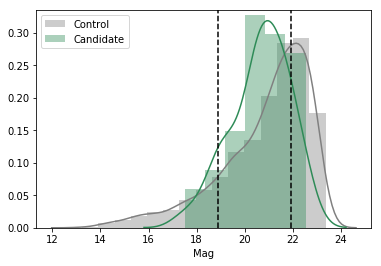

In [13]:
import seaborn as sns
import pandas as pd
import warnings
warnings.filterwarnings('ignore')

mag0 = 25.2
mag_all = -2.5*np.log10(Datacube.Tab_SE["FLUX_AUTO"]) + mag0
ind_notv = np.setdiff1d(Datacube.Tab_SE["NUMBER"]-1, ind_v)
mag_ctrl = pd.Series(mag_all[ind_notv]).dropna()

sns.distplot(mag_ctrl,label="Control",color="gray",bins=15)
mag_el = pd.Series(mag_all[ind_v])
mag_cut = (np.percentile(mag_el, 10), np.percentile(mag_el, 90))
print (mag_cut)
sns.distplot(mag_el,label="Candidate",color="seagreen")
plt.axvline(mag_cut[0],color='k',ls='--')
plt.axvline(mag_cut[1],color='k',ls='--')
plt.xlabel("Mag")
plt.legend()

Datacube.construct_control(Num_v=Num_v, mag_cut=(mag_cut[0],mag_cut[1]), dist_cut=50, bootstraped=False)

In [14]:
ind_v = Num_vp - 1
Datacube.diff_angles_v = Datacube.diff_angles[ind_v]
Datacube.diff_centroids_v = Datacube.diff_centroids[ind_v]
Datacube.dist_clus_cens_v = Datacube.dist_clus_cens[ind_v]
Datacube.max_devs_v = Datacube.max_devs[ind_v]
import warnings
warnings.filterwarnings('ignore')

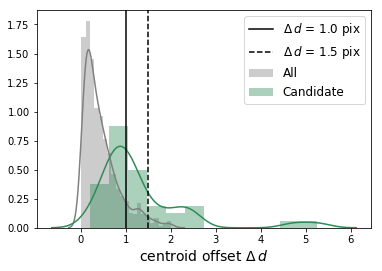

In [12]:
#APER p (2 aper)
draw_centroid_offset(Datacube.diff_centroids_v[Datacube.diff_centroids_v>0], 
                     Datacube.diff_centroids_c, crit=[1.,1.5])

# of offset > 50% : 37
# of offset > 150% : 14


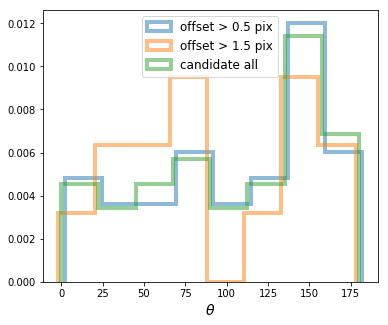

In [11]:
#APER p (1 aper)
plt.figure(figsize=(6,5))
draw_angle_candidate(Datacube.diff_angles_v, Datacube.diff_centroids_v, Datacube.diff_centroids_c, crit=[0.5, 1.5], b=9)

# of offset > 100% : 25
# of offset > 150% : 10


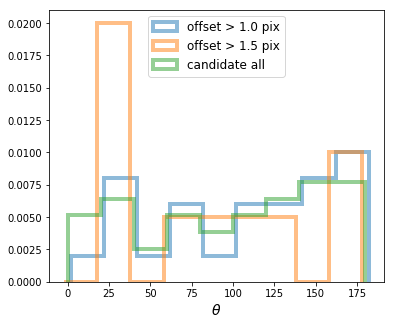

In [9]:
#APER p (2 aper)
plt.figure(figsize=(6,5))
draw_angle_candidate(Datacube.diff_angles_v, Datacube.diff_centroids_v, Datacube.diff_centroids_c, crit=[1., 1.5], b=10)

# of offset > 50% : 28
# of offset > 100% : 16


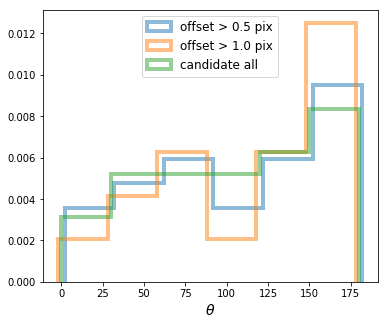

In [101]:
#APER p (2 aper)
plt.figure(figsize=(6,5))
cond = (Datacube.diff_centroids_v<10) & (mag_all[ind_v]<22.5)
draw_angle_candidate(Datacube.diff_angles_v[cond], Datacube.diff_centroids_v[cond], 
                     Datacube.diff_centroids_c, crit=[0.5, 1.], b=7)

(18.865377686561846, 22.27548729064474)
# of offset > 50 pix :29
# of offset > 100 pix :16


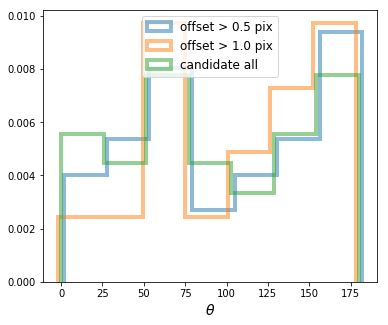

In [16]:
#APER p (2m aper) mean
plt.figure(figsize=(6,5))
print(mag_cut)
cond = (Datacube.diff_centroids_v<5) & (mag_all[ind_v]<22.5) & (mag_all[ind_v]>18.5)
draw_angle_candidate(Datacube.diff_angles_v[cond], Datacube.diff_centroids_v[cond], 
                     Datacube.diff_centroids_c, crit=[0.5, 1.], b=8)

# of offset > 50 pix :31
# of offset > 100 pix :18


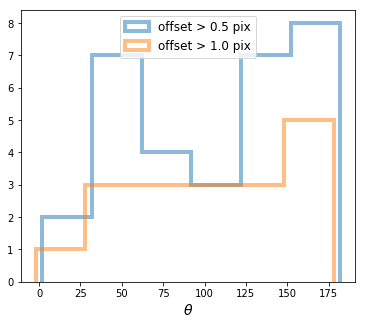

In [19]:
#APER p (2m aper med weight)
plt.figure(figsize=(6,5))
cond = (Datacube.diff_centroids_v<5) & (mag_all[ind_v]<22.5) & (mag_all[ind_v]>18.5) #& (Datacube.max_devs_v<2)
draw_angle_candidate(Datacube.diff_angles_v[cond], Datacube.diff_centroids_v[cond], 
                     Datacube.diff_centroids_c, crit=[0.5, 1.], b=7)

# of offset > 50 pix :29
# of offset > 100 pix :16


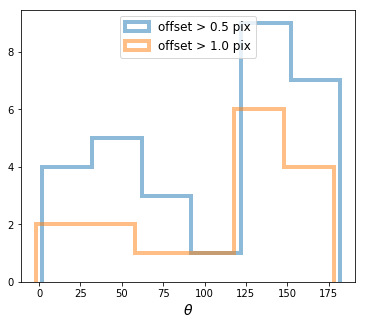

In [9]:
#APER p (2m aper med mean)
plt.figure(figsize=(6,5))
cond = (Datacube.diff_centroids_v<5) & (mag_all[ind_v]<22.5) & (mag_all[ind_v]>18.5) #& (Datacube.max_devs_v<2)
draw_angle_candidate(Datacube.diff_angles_v[cond], Datacube.diff_centroids_v[cond], 
                     Datacube.diff_centroids_c, crit=[0.5, 1.], b=7)

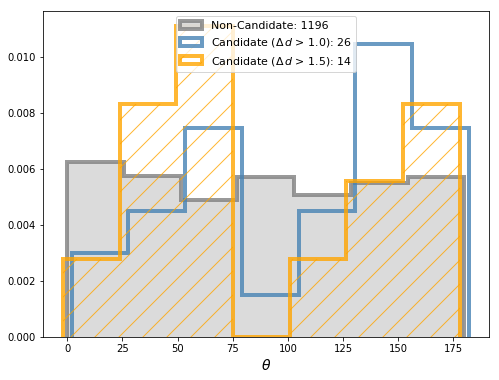

In [17]:
#APER p (2 aper)
plt.figure(figsize=(8,6))
draw_angle_compare(Datacube.diff_angles_v, Datacube.diff_centroids_v, 
                   Datacube.diff_angles_c, Datacube.diff_centroids_c, crit=[1.,1.5], b=8)
plt.savefig("/home/qliu/Pictures/20190312/A2390SE.pdf",dpi=100)

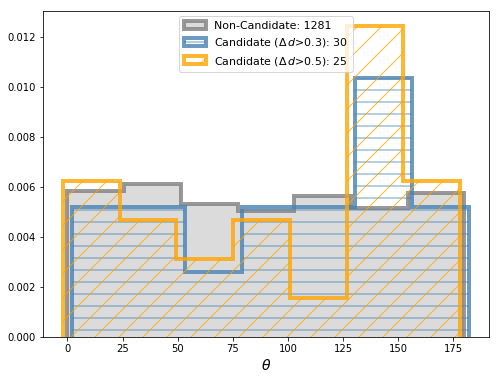

In [29]:
#APER p (2 aper scaled)
plt.figure(figsize=(8,6))
draw_angle_compare(Datacube.diff_angles_v, Datacube.diff_centroids_v, 
                   Datacube.diff_angles_c, Datacube.diff_centroids_c, crit=[0.3,.5], b=8)

In [17]:
from scipy.stats import kstest,ks_2samp,norm, anderson_ksamp
#ISO iter p (new CC)
p = np.percentile(Datacube.diff_centroids_c,50)
q = np.percentile(Datacube.diff_centroids_c,75)
print("K-S: p-value=%.3f"%ks_2samp(Datacube.diff_angles_v[Datacube.diff_centroids_v>p], Datacube.diff_angles_c[Datacube.diff_centroids_c>p]).pvalue)
print("K-S: p-value=%.3f"%ks_2samp(Datacube.diff_angles_v[Datacube.diff_centroids_v>q], Datacube.diff_angles_c[Datacube.diff_centroids_c>q]).pvalue)
print("K-S: p-value=%.3f"%ks_2samp(Datacube.diff_angles_v[Datacube.diff_centroids_v>p], Datacube.diff_angles_c).pvalue)
print("K-S: p-value=%.3f"%ks_2samp(Datacube.diff_angles_v[Datacube.diff_centroids_v>q], Datacube.diff_angles_c).pvalue)

print(anderson_ksamp([Datacube.diff_angles_v[Datacube.diff_centroids_v>p],Datacube.diff_angles_c[Datacube.diff_centroids_c>p]]))
print(anderson_ksamp([Datacube.diff_angles_v[Datacube.diff_centroids_v>q],Datacube.diff_angles_c[Datacube.diff_centroids_c>q]]))
print(anderson_ksamp([Datacube.diff_angles_v[Datacube.diff_centroids_v>p],Datacube.diff_angles_c]))
print(anderson_ksamp([Datacube.diff_angles_v[Datacube.diff_centroids_v>q],Datacube.diff_angles_c]))

K-S: p-value=0.551
K-S: p-value=0.619
K-S: p-value=0.512
K-S: p-value=0.499
Anderson_ksampResult(statistic=-0.23851566968889742, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752]), significance_level=0.44680815904120597)
Anderson_ksampResult(statistic=-0.42697254691306324, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752]), significance_level=0.5453035431800698)
Anderson_ksampResult(statistic=-0.019939238376678933, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752]), significance_level=0.3554298397018989)
Anderson_ksampResult(statistic=0.18535832202427127, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752]), significance_level=0.2873289393369083)


In [14]:
from scipy.stats import kstest,ks_2samp,norm, anderson_ksamp
#APER iter p (new CC)
p = np.percentile(Datacube.diff_centroids_c,50)
q = np.percentile(Datacube.diff_centroids_c,75)
print("K-S: p-value=%.3f"%ks_2samp(Datacube.diff_angles_v[Datacube.diff_centroids_v>p], Datacube.diff_angles_c[Datacube.diff_centroids_c>p]).pvalue)
print("K-S: p-value=%.3f"%ks_2samp(Datacube.diff_angles_v[Datacube.diff_centroids_v>q], Datacube.diff_angles_c[Datacube.diff_centroids_c>q]).pvalue)
print("K-S: p-value=%.3f"%ks_2samp(Datacube.diff_angles_v[Datacube.diff_centroids_v>p], Datacube.diff_angles_c).pvalue)
print("K-S: p-value=%.3f"%ks_2samp(Datacube.diff_angles_v[Datacube.diff_centroids_v>q], Datacube.diff_angles_c).pvalue)

print(anderson_ksamp([Datacube.diff_angles_v[Datacube.diff_centroids_v>p],Datacube.diff_angles_c[Datacube.diff_centroids_c>p]]))
print(anderson_ksamp([Datacube.diff_angles_v[Datacube.diff_centroids_v>q],Datacube.diff_angles_c[Datacube.diff_centroids_c>q]]))
print(anderson_ksamp([Datacube.diff_angles_v[Datacube.diff_centroids_v>p],Datacube.diff_angles_c]))
print(anderson_ksamp([Datacube.diff_angles_v[Datacube.diff_centroids_v>q],Datacube.diff_angles_c]))

K-S: p-value=0.156
K-S: p-value=0.091
K-S: p-value=0.223
K-S: p-value=0.085
Anderson_ksampResult(statistic=0.04278155963816326, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752]), significance_level=0.3329922720021404)
Anderson_ksampResult(statistic=0.6661024186611936, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752]), significance_level=0.17607175379608234)
Anderson_ksampResult(statistic=-0.2986743231460777, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752]), significance_level=0.47605165632915436)
Anderson_ksampResult(statistic=0.8295595014999784, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752]), significance_level=0.1494617871367127)


In [20]:
import pandas as pd
coords = w.pixel_to_world(Datacube.Tab_SE["X_IMAGE"], Datacube.Tab_SE["Y_IMAGE"])
ind_v = Num_v-1
Datacube.diff_angles_v = Datacube.diff_angles[ind_v]
Datacube.diff_centroids_v = Datacube.diff_centroids[ind_v]
Datacube.dist_clus_cens_v = Datacube.dist_clus_cens[ind_v]
Datacube.PAs_v = Datacube.PAs[ind_v]
Datacube.clus_cen_angles_v = Datacube.clus_cen_angles[ind_v]

ind_c = Datacube.Num_c-1

inds_best_Ha = np.argmax(Datacube.CC_Rs_Temps['Ha-NII_gauss'], axis=1)
SNR_best_Ha = np.array([Datacube.CC_SNRs_Temps['Ha-NII_gauss'][i,j] for i,j in enumerate(inds_best_Ha)])
R_best_Ha = np.array([Datacube.CC_Rs_Temps['Ha-NII_gauss'][i,j] for i,j in enumerate(inds_best_Ha)])
inds_best_Hb = np.argmax(Datacube.CC_Rs_Temps['Hb-OIII_gauss'], axis=1)
SNR_best_Hb = np.array([Datacube.CC_SNRs_Temps['Hb-OIII_gauss'][i,j] for i,j in enumerate(inds_best_Hb)])
inds_best_OII = np.argmax(Datacube.CC_Rs_Temps['OII_gauss'], axis=1)
SNR_best_OII = np.array([Datacube.CC_SNRs_Temps['OII_gauss'][i,j] for i,j in enumerate(inds_best_OII)])

df = pd.DataFrame({"ID":np.concatenate([ind_v + 1, Datacube.Num_c]),
                   "ra":np.concatenate([coords.ra[ind_v], coords.ra[ind_c]]),
                   "dec":np.concatenate([coords.dec[ind_v], coords.dec[ind_c]]),
                   "redshift":np.concatenate([Datacube.z_best[ind_v], Datacube.z_best[ind_c]]),
                   "SNR_Ha": np.concatenate([SNR_best_Ha[ind_v], SNR_best_Ha[ind_c]]),
                   "R_Ha": np.concatenate([R_best_Ha[ind_v], R_best_Ha[ind_c]]),
                   "SNR_OIII": np.concatenate([SNR_best_Hb[ind_v], SNR_best_Hb[ind_c]]),
                   "SNR_OII": np.concatenate([SNR_best_OII[ind_v], SNR_best_OII[ind_c]]),
                   "mag_auto": np.concatenate([mag_all[ind_v], mag_all[ind_c]]),
                   "R_petro": np.concatenate([Datacube.Tab_SE['PETRO_RADIUS'][ind_v], Datacube.Tab_SE['PETRO_RADIUS'][ind_c]]),
                   "dist_edge": np.concatenate([Datacube.dist_edge[ind_v], Datacube.dist_edge[ind_c]]),
                   "dist_cen": np.concatenate([Datacube.dist_clus_cens[ind_v], Datacube.dist_clus_cens[ind_c]]),
                   "diff_centroid":np.concatenate([Datacube.diff_centroids_v, Datacube.diff_centroids_c]),
                   "diff_angle":np.concatenate([Datacube.diff_angles_v, Datacube.diff_angles_c]),
                   "PA_emission":np.concatenate([Datacube.PAs_v, Datacube.PAs_c]),
                   "cluster_center_angle":np.concatenate([Datacube.clus_cen_angles_v, Datacube.clus_cen_angles_c]),
                   "type":np.concatenate([['v']*len(Datacube.diff_centroids_v), ['c']*len(Datacube.diff_centroids_c)])})


df.to_csv('./A2390SE/centroid_analysis_A2390SE_m2aper_all_weight_med_v3.csv',sep=',',index=None)
# df.to_csv('./A2390SE/centroid_analysis_A2390SE_m2aper_all_med_v1.csv',sep=',',index=None)

### Cross-match with Central Field

In [72]:
# Read flanking field
Datacube = Read_Datacube("/home/qliu/data/A2390F/A2390SE_cube.fits", name="A2390SE", z0=0.228, 
                         SE_catalog="./A2390SE/SE/A2390SE_run2.cat")

Datacube.pos_BCG = (2104.09836227, 2906.58511366)

w = WCS(Datacube.hdu[0].header, naxis=2)
Datacube.assign_BCG_coordinate((328.40351201,17.69544013))

INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

In [73]:
# Convert pix to world for SE field
RAs, DECs = w.all_pix2world(Datacube.Tab_SE["X_IMAGE"], Datacube.Tab_SE["Y_IMAGE"], 1)
Coords = SkyCoord(RAs, DECs, frame='icrs', unit="deg")
Coords

<SkyCoord (ICRS): (ra, dec) in deg
    [(328.47188012, 17.46668761), (328.47074739, 17.46671921),
     (328.50147387, 17.45528587), ..., (328.53343407, 17.62480058),
     (328.46989142, 17.62292777), (328.42048388, 17.62165862)]>

In [74]:
# Read central field
Datacube_C = Read_Datacube("/home/qliu/data/A2390C_cube.fits", name="A390C", z0=0.228, 
                           SE_catalog="./A2390C/SE/A2390C_run3.cat")

id_BCG_C = np.argmin((Datacube_C.Tab_SE["X_IMAGE"]-980)**2 + (Datacube_C.Tab_SE["Y_IMAGE"]-1315)**2)
Datacube_C.assign_BCG_position(id_BCG=id_BCG_C)

w_C = WCS(Datacube_C.hdu[0].header, naxis=2)
ra_BCG_C, dec_BCG_C = w_C.all_pix2world(Datacube_C.pos_BCG[0], Datacube_C.pos_BCG[1], 1)
Datacube_C.assign_BCG_coordinate((ra_BCG_C,dec_BCG_C))

INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

In [119]:
RAs_C, DECs_C = w_C.all_pix2world(Datacube_C.Tab_SE["X_IMAGE"], Datacube_C.Tab_SE["Y_IMAGE"], 1)
Coords_C = SkyCoord(RAs_C, DECs_C, frame='icrs', unit="deg")
Coords_C

<SkyCoord (ICRS): (ra, dec) in deg
    [(328.42967535, 17.64398462), (328.39814878, 17.59551301),
     (328.39921577, 17.59424771), ..., (328.39642645, 17.71354617),
     (328.43121103, 17.67202567), (328.4844344 , 17.75326277)]>

NUMBER,EXT_NUMBER,FLUX_ISO,FLUXERR_ISO,FLUX_AUTO,FLUXERR_AUTO,FLUX_PETRO,FLUXERR_PETRO,KRON_RADIUS,PETRO_RADIUS,BACKGROUND,THRESHOLD,ISOAREA_IMAGE,XMIN_IMAGE,YMIN_IMAGE,XMAX_IMAGE,YMAX_IMAGE,XPEAK_IMAGE,YPEAK_IMAGE,X_IMAGE,Y_IMAGE,X_WORLD,Y_WORLD,ALPHA_J2000,DELTA_J2000,A_IMAGE,B_IMAGE,THETA_IMAGE,MU_MAX,FLAGS,ELONGATION,CLASS_STAR
,,ct,ct,ct,ct,ct,ct,,,ct,ct,pix2,pix,pix,pix,pix,pix,pix,pix,pix,deg,deg,deg,deg,pix,pix,deg,mag / arcsec2,,,
int64,int64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,int64,int64,int64,int64,int64,int64,int64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,int64,float64,float64
14,1,63.32879,10.83447,74.56306,12.82958,78.934,14.2583,4.57,5.94,-0.004040207,0.1817739,109,616,11,653,44,623,16,623.1535,16.0258,328.43799298,17.578534372,328.437993,17.5785344,3.191,2.289,34.48,-2.906,16,1.394,0.013
100,1,13.47228,5.012318,20.86597,7.711917,22.93036,13.30846,5.45,8.58,0.005028068,0.1817739,32,679,99,687,105,682,102,682.684,102.1479,328.43229487,17.586237585,328.4322949,17.5862376,1.871,1.468,0.6,-2.1299,0,1.274,0.014
114,1,19.82572,6.067539,22.342,6.948608,22.3193,8.278355,3.5,5.28,-0.001061543,0.1817739,41,101,114,109,121,103,116,104.4858,117.2557,328.48688788,17.588078002,328.4868879,17.588078,2.269,1.436,42.07,-2.6264,0,1.58,0.295
167,1,25.72945,6.930779,33.85564,8.476075,23.7404,10.99029,3.5,6.6,-0.008660941,0.1817739,56,618,188,625,198,621,194,621.2778,192.5289,328.43801445,17.594426084,328.4380144,17.5944261,2.623,1.858,-85.34,-2.2363,0,1.412,0.003
325,1,27.8835,7.192838,35.76336,9.110491,38.00058,9.687766,4.66,5.28,-0.01536572,0.1817739,46,873,358,880,367,876,362,876.5436,361.9268,328.41375422,17.609460429,328.4137542,17.6094604,2.043,1.67,-72.69,-2.7906,0,1.224,0.02
375,1,224.5494,20.26513,232.1132,21.04517,238.9126,22.95638,3.5,5.28,-0.01910129,0.1817739,230,386,437,406,455,399,446,398.4308,445.3962,328.45884099,17.617377409,328.458841,17.6173774,4.369,2.786,45.09,-4.3485,0,1.568,0.029
397,1,421.2461,27.70772,430.1199,28.40993,435.2655,29.42126,3.5,4.62,-0.01749248,0.1817739,318,410,476,449,503,435,493,437.0475,492.6559,328.45515205,17.62159996,328.4551521,17.6216,4.9,3.148,-4.97,-4.7094,0,1.556,0.029


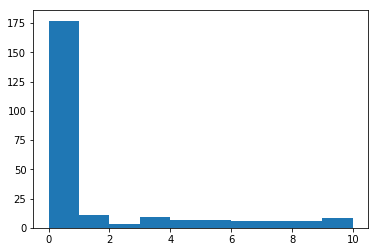

In [164]:
el_ls_C_v = glob.glob("./A2390C/fig/candidate_v3/visual/*.png")
Num_C_v = np.sort(np.array([re.compile(r'\d+').findall(el)[-1] for el in el_ls_C_v]).astype("int"))

# Match two catalogs
idx, d2d, d3d = Coords.match_to_catalog_sky(Coords_C)
plt.hist(d2d.to(u.arcsec).value, range=[0,10])

Num_C_match = Datacube_C.Tab_SE["NUMBER"][idx[d2d<2*u.arcsec]]
Num_C_v_match = np.intersect1d(Num_C_match, Num_C_v)
Tab_match_C = Datacube_C.Tab_SE[Num_C_match-1]
Tab_match_C_v = Datacube_C.Tab_SE[Num_C_v_match-1]
Tab_match_C_v

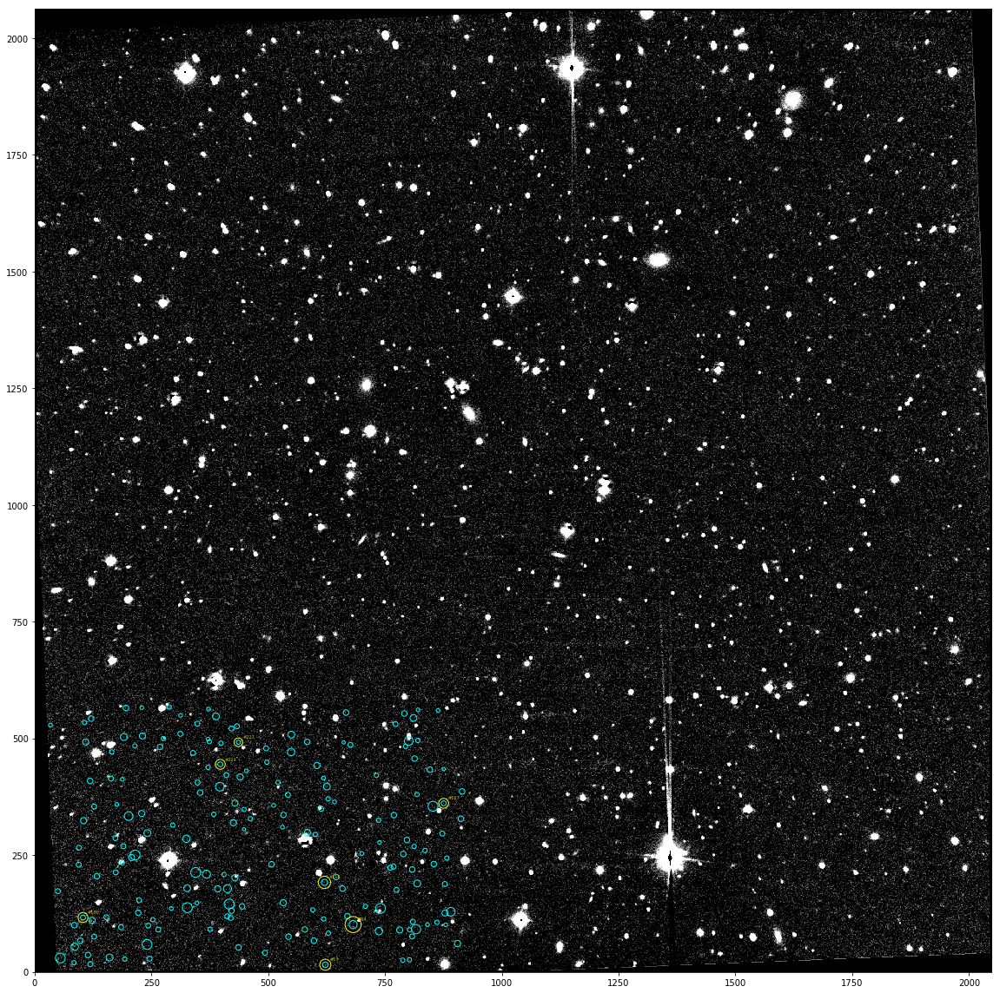

In [165]:
import pyregion
region_str = "\n".join(["circle(%.4f,%.4f,%.1f)"%(gal["X_IMAGE"],gal["Y_IMAGE"], gal["PETRO_RADIUS"]) for gal in Tab_match_C])
region_str = "# Region file format: DS9 version 4.1\nglobal color=cyan dashlist=8 3 width=1\nimage\n"+region_str
regs = pyregion.parse(region_str)


region_str_v = "\n".join(["circle(%.4f,%.4f,%.1f)"%(gal["X_IMAGE"],gal["Y_IMAGE"], 2*gal["PETRO_RADIUS"]) for gal in Tab_match_C_v])
region_str_v = "# Region file format: DS9 version 4.1\nglobal color=yellow dashlist=8 3 width=1\nimage\n"+region_str_v
regs_v = pyregion.parse(region_str_v)

hdu_field = fits.open('/home/qliu/Desktop/Cluster/A2390C/SE/A2390C_stack.fits')
stack_field = hdu_field[0].data
plt.figure(figsize=(16,16))
ax = plt.subplot(111)
ax.imshow(stack_field,vmin=0.001,vmax=1,origin="lower",cmap="gray")

patch_list, artist_list = regs.get_mpl_patches_texts()
for p in patch_list:
    ax.add_patch(p)
    
patch_list, artist_list = regs_v.get_mpl_patches_texts()
for p in patch_list:
    ax.add_patch(p)

Pos_C_v = np.array([(x,y) for (x,y) in zip(Tab_match_C_v["X_IMAGE"], Tab_match_C_v["Y_IMAGE"])])
for num, pos in zip(Num_C_v, Pos_C_v):
    ax.text(pos[0]+8, pos[1]+8, "#%d"%num, color="y", fontsize=5, alpha=1.0, zorder=3)
    
plt.tight_layout()
plt.savefig("/home/qliu/Pictures/cross_match-C.pdf",dpi=250)

##### Find Number in SE field that appeared in C field

NUMBER,EXT_NUMBER,FLUX_ISO,FLUXERR_ISO,FLUX_AUTO,FLUXERR_AUTO,FLUX_PETRO,FLUXERR_PETRO,KRON_RADIUS,PETRO_RADIUS,BACKGROUND,THRESHOLD,ISOAREA_IMAGE,XMIN_IMAGE,YMIN_IMAGE,XMAX_IMAGE,YMAX_IMAGE,XPEAK_IMAGE,YPEAK_IMAGE,X_IMAGE,Y_IMAGE,X_WORLD,Y_WORLD,ALPHA_J2000,DELTA_J2000,A_IMAGE,B_IMAGE,THETA_IMAGE,MU_MAX,FLAGS,ELONGATION,CLASS_STAR
,,ct,ct,ct,ct,ct,ct,,,ct,ct,pix2,pix,pix,pix,pix,pix,pix,pix,pix,deg,deg,deg,deg,pix,pix,deg,mag / arcsec2,,,
int64,int64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,int64,int64,int64,int64,int64,int64,int64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,int64,float64,float64
1175,1,726.6119,36.39463,735.5836,36.69098,763.41,37.57259,3.58,4.62,0.04048707,0.2114516,497,1169,1995,1229,2056,1190,2028,1190.6116,2027.2799,123.62723346,74.373952264,123.6272335,74.3739523,5.076,3.966,76.01,-5.2371,2,1.28,0.029
1243,1,31.84675,7.693866,33.72276,8.239672,38.24712,8.874006,4.5,5.28,-0.002432985,0.2114516,55,1959,1853,1971,1867,1964,1857,1964.3234,1856.2211,70.791600499,41.45112847,70.7916005,41.4511285,2.188,1.822,21.22,-2.4843,0,1.201,0.03
1400,1,28.48849,7.292747,30.74405,7.78389,19.90501,6.913053,3.5,5.28,-0.009450418,0.2114516,58,1698,1678,1705,1688,1701,1681,1701.5206,1682.8763,71.232330121,44.844526799,71.2323301,44.8445268,2.81,1.694,84.69,-2.209,0,1.659,0.001
1602,1,77.1268,11.90831,82.03937,12.41393,83.31561,12.83688,3.5,5.28,-0.01162441,0.2114516,89,1698,1505,1709,1515,1704,1510,1703.5918,1509.771,66.579087803,36.699505172,66.5790878,36.6995052,2.855,2.084,28.87,-3.2709,0,1.37,0.019
2130,1,566.0417,32.09708,582.1569,32.68277,574.8786,32.71888,3.5,4.62,-0.006488536,0.2114516,391,1504,1972,1528,1994,1515,1985,1516.1245,1983.0472,86.307110301,61.728014032,86.3071103,61.728014,5.012,3.803,-5.28,-4.8022,0,1.318,0.029


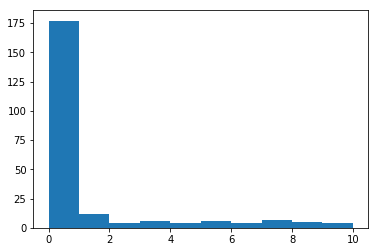

In [159]:
# Match two catalogs
idx, d2d, d3d = Coords_C.match_to_catalog_sky(Coords)
plt.hist(d2d.to(u.arcsec).value, range=[0,10],bins=10)

Num_match = Datacube.Tab_SE["NUMBER"][idx]
Num_v_match = np.intersect1d(Num_match[d2d<2*u.arcsec], Num_v)
Tab_v = Datacube.Tab_SE[Num_v-1]

ind_match = Num_v_match-1
Tab_match = Datacube.Tab_SE[ind_match]
Tab_match

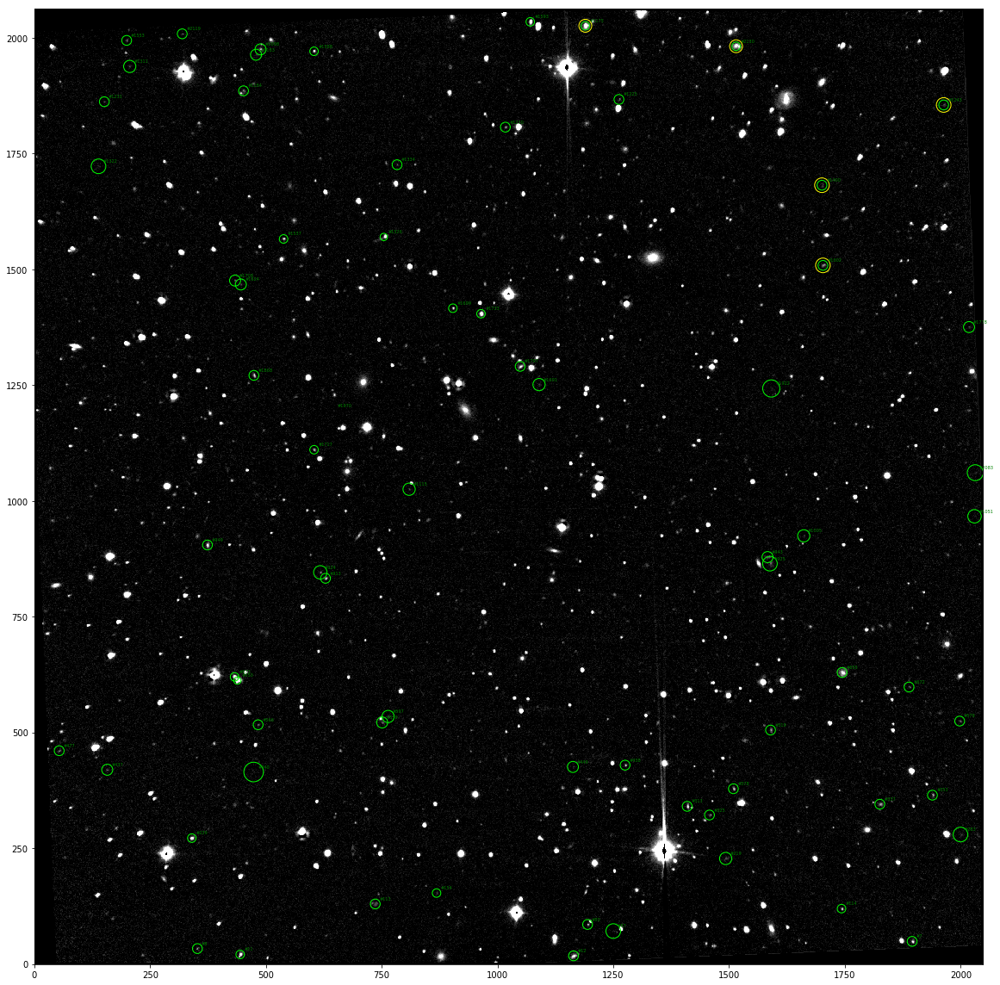

In [163]:
import pyregion
region_str = "\n".join(["circle(%.4f,%.4f,%.1f)"%(gal["X_IMAGE"],gal["Y_IMAGE"], 3*gal["PETRO_RADIUS"]) for gal in Tab_match])
region_str = "# Region file format: DS9 version 4.1\nglobal color=yellow dashlist=8 3 width=1\nimage\n"+region_str
regs = pyregion.parse(region_str)


region_str_v = "\n".join(["circle(%.4f,%.4f,%.1f)"%(gal["X_IMAGE"],gal["Y_IMAGE"], 2*gal["PETRO_RADIUS"]) for gal in Tab_v])
region_str_v = "# Region file format: DS9 version 4.1\nglobal color=green dashlist=8 3 width=1\nimage\n"+region_str_v
regs_v = pyregion.parse(region_str_v)

hdu_field = fits.open('/home/qliu/Desktop/Cluster/A2390SE/SE/A2390SE_stack.fits')
stack_field = hdu_field[0].data

plt.figure(figsize=(16,16))
ax = plt.subplot(111)
ax.imshow(stack_field,vmin=0.001,vmax=3,origin="lower",cmap="gray")

patch_list, artist_list = regs.get_mpl_patches_texts()
for p in patch_list:
    ax.add_patch(p)
    
patch_list, artist_list = regs_v.get_mpl_patches_texts()
for p in patch_list:
    ax.add_patch(p)
    
Pos_v = np.array([(x,y) for (x,y) in zip(Tab_v["X_IMAGE"], Tab_v["Y_IMAGE"])])
for num, pos in zip(Num_v, Pos_v):
    ax.text(pos[0]+8, pos[1]+8, "#%d"%num, color="green", fontsize=5, alpha=1.0, zorder=3)
    
plt.tight_layout()
plt.savefig("/home/qliu/Pictures/cross_match-SE.pdf",dpi=250)